In [1]:
import os,scipy
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import numpy as np
import seaborn as sns
import scanpy as sc
import gseapy
from datetime import datetime
from lifelines.utils import restricted_mean_survival_time
from lifelines.statistics import logrank_test,multivariate_logrank_test
from lifelines import KaplanMeierFitter
import lifelines 
import statsmodels
from scipy.stats import rankdata
import math
from sklearn.preprocessing import scale

from combat.pycombat import pycombat
from matplotlib.gridspec import GridSpec
import matplotlib.patches as mpatches
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import matplotlib.pyplot as plt
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import roc_auc_score
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()

from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV, RepeatedKFold, cross_val_score, RepeatedStratifiedKFold, StratifiedKFold, cross_val_predict
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet, LogisticRegression
from sklearn.svm import LinearSVR, SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import average_precision_score, roc_auc_score, precision_recall_fscore_support
from sklearn.metrics import confusion_matrix, auc, plot_roc_curve
from sklearn import svm
from mycolorpy import colorlist as mcp
scaler = StandardScaler()

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.metrics import homogeneity_score, completeness_score, v_measure_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.mixture import GaussianMixture
from scipy.stats import multivariate_normal as mvn

def get_km(k, X):
    km = KMeans(n_clusters=k, random_state=37)
    km.fit(X)
    return km

def get_bic_aic(k, X):
    gmm = GaussianMixture(n_components=k, init_params='kmeans')
    gmm.fit(X)
    return gmm.bic(X), gmm.aic(X)

def get_score(k, X, y):
    km = get_km(k, X)
    y_pred = km.predict(X)
    bic, aic = get_bic_aic(k, X)
    sil = silhouette_score(X, y_pred)
    db = davies_bouldin_score(X, y_pred)
    hom = homogeneity_score(y, y_pred)
    com = completeness_score(y, y_pred)
    vms = v_measure_score(y, y_pred)
    cal = calinski_harabasz_score(X, y_pred)
    return k, bic, aic, sil, db, hom, com, vms, cal


import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

plt.style.use('ggplot')

def plot_compare(df, y1, y2, x, fig, ax1):
    ax1.plot(df[x], df[y1], color='tab:red')
    ax1.set_title(f'{y1} and {y2}')
    ax1.set_xlabel(x)
    ax1.set_ylabel(y1, color='tab:red')
    ax1.tick_params(axis='y', labelcolor='tab:red')

    ax2 = ax1.twinx()
    ax2.plot(df[x], df[y2], color='tab:blue')
    ax2.set_ylabel(y2, color='tab:blue')
    ax2.tick_params(axis='y', labelcolor='tab:blue')

def plot_contrast(df, y1, y2, x, fig, ax):
    a = np.array(df[y1])
    b = np.array(df[y2])

    r_min, r_max = df[y1].min(), df[y1].max()
    scaler = MinMaxScaler(feature_range=(r_min, r_max))
    b = scaler.fit_transform(b.reshape(-1, 1))[:,0]

    diff = np.abs(a - b)
    ax.plot(df[x], diff)
    ax.set_title('Scaled Absolute Difference')
    ax.set_xlabel(x)
    ax.set_ylabel('absolute difference')

def plot_result(df, y1, y2, x):
    fig, axes = plt.subplots(1, 1, figsize=(10, 3))
    plot_compare(df, y1, y2, x, fig, axes)
    #plot_contrast(df, y1, y2, x, fig, axes[1])
    plt.tight_layout()
    
# def plot_result(df, y1, y2, x):
#     fig, axes = plt.subplots(1, 2, figsize=(10, 3))
#     plot_compare(df, y1, y2, x, fig, axes[0])
#     plot_contrast(df, y1, y2, x, fig, axes[1])
#     plt.tight_layout()

In [2]:
def multiclass_scorer(y_true, y_pred):
    score = np.nan
    try:
        score = roc_auc_score(y_true, y_pred, multi_class='ovr')
    except Exception: 
        pass

    return score
multi_auc = make_scorer(multiclass_scorer,needs_proba=True)


roc_auc_scoring = make_scorer(roc_auc_score, needs_proba=True, multiclass='ovr')

def classification_model_training(model, param_grid, X, y, title, n_splits=5, n_reapts=1, scoring=roc_auc_scoring):
    
    rkfold = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_reapts, random_state=123)
    gsearch = GridSearchCV(model, param_grid, cv=rkfold, scoring=multi_auc, verbose=True, 
                           return_train_score=True, n_jobs=4)
    gsearch.fit(X,y)
    print('Best Estimator')
    print(gsearch.best_estimator_)

    classifier = gsearch.best_estimator_        
    best_idx = gsearch.best_index_
    grid_results = pd.DataFrame(gsearch.cv_results_)
    print('cv score mean: {}'.format(grid_results.loc[best_idx,'mean_test_score']))
    print('=========================================')
    
    coef_df = pd.DataFrame(classifier.coef_, columns=X.columns)
    coef_df = coef_df == 0

    coeff_sum = coef_df.sum(axis=0)

    m = coeff_sum == 3
    selected_genes = coeff_sum[~m]
    print('selected_genes')
    print(selected_genes.sort_values(ascending=False))
    

    return gsearch.best_estimator_

sc.settings.set_figure_params(dpi=100)
sns.set_style("whitegrid", {'axes.grid' : False})

def km_plot_multi(df_info, category, os, event, title=''):
    
    kmf = lifelines.KaplanMeierFitter()
    plt.figure(figsize=(8,4))
    ax = plt.gca()
    category_vals = sorted(list(df_info[category].unique()))
    #val_str = '/'.join(category_vals)
    
    
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        ax = kmf.plot_survival_function(ci_show=False, linewidth=3,)
        

    result = multivariate_logrank_test(df_info[os], df_info[category], df_info[event])
    p_val="{:.2e}".format(result.p_value)
    plt.text(0, 0.01, 'p-value: {}'.format(p_val), fontsize=15)
    if title=='':
        title = 'KM Plot - {}'.format(category)
        
    plt.title(title, fontsize=20)
    plt.xlabel('OS(month)',fontsize=15)
    plt.ylabel('Overall Survival',fontsize=15)
    plt.ylim(-0.1,1.1)
    plt.legend(fontsize=15)
    plt.grid()
    plt.show()
    return p_val



    

def km_plot_bi(df_info, category, os, event):
    category_vals = list(df_info[category].unique())
    
    for val in category_vals:
        kmf = lifelines.KaplanMeierFitter()
        plt.figure(figsize=(8,4))
        ax = plt.gca()
        
        m = df_info[category] == val
        T_test, E_test = df_info.loc[m,'OS'], df_info.loc[m,'death2']
        t_count = T_test.shape[0]
        T_control, E_control = df_info.loc[~m, 'OS'], df_info.loc[~m, 'death2']
        c_count = T_control.shape[0]
        
        kmf.fit(T_test, E_test, label='{} (n={})'.format(val, t_count))
        ax = kmf.plot_survival_function(ci_show=False, linewidth=3,)
        
        kmf.fit(T_control, E_control, label='Rest (n={})'.format(c_count))
        ax = kmf.plot_survival_function(ax=ax,ci_show=False, linewidth=3,)
        
        plt.legend(loc='upper right')
        t_res = logrank_test(T_test, T_control, event_observed_A=E_test, event_observed_B=E_control, alpha=.95)
        p_val="{:.2e}".format(t_res.p_value)
        
        
        plt.text(0, 0.01, 'p-value: {}'.format(p_val),fontsize=15)
        title = 'KM Plot - {} vs Rest'.format(val)
        plt.title(title, fontsize=20)
        plt.xlabel('OS(month)',fontsize=15)
        plt.ylabel('Overall Survival',fontsize=15)
        plt.legend(fontsize=15)
        plt.ylim(-0.1,1.1)
        plt.grid()
        plt.show()

def category_count_plot(df_mg,col_sel):
    val_counts_dict = dict()
    PC_clinical_data_sel = df_mg.loc[:,col_sel]
    for col in col_sel:
        counter = dict(Counter(PC_clinical_data_sel[col]).most_common())
        val_counts_dict[col] = counter
    
    print(val_counts_dict)
    
    sns.set(rc={'figure.figsize':(4,3), "figure.dpi":100, 'savefig.dpi':100})
    sns.set_style("ticks")

    titles = list(val_counts_dict.keys())
    

    for title in titles:
        labels = list(val_counts_dict[title].keys())
        fracs = list(val_counts_dict[title].values())
        
        
        #print(labels)
        
        if np.nan in labels:
            h_size = (len(labels)-1)*0.5
        else:
            h_size = len(labels)*0.5
        

        sns.set(rc={'figure.figsize':(4,h_size)})
        sns.set_style("ticks")
        sns.barplot(x=fracs,y=labels,palette=sns.color_palette("hls", 8))
        plt.title(title,fontsize=18)
        plt.yticks(fontsize=15)
        plt.xticks(fontsize=12)
        plt.show()
        
def scatter_plot(df, x, y, hue=None):
    pearsonr_res = scipy.stats.pearsonr(df[x], df[y])
    p_r,p_p = pearsonr_res[0],pearsonr_res[1]
    
    spearmanr_res = scipy.stats.spearmanr(df[x], df[y])
    s_r,s_p = spearmanr_res[0],spearmanr_res[1]
    
    text1 = 'Pearson:\n R={:.4f}, p-val={:.2e}'.format(p_r,p_p)
    text2 = 'Spearman:\n R={:.4f}, p-val={:.2e}'.format(s_r,s_p)
    
    sns.set(rc={'figure.figsize':(3,3), "figure.dpi":100, 'savefig.dpi':100})
    sns.set_style("ticks")
    sns.scatterplot(data=df, x=x, y=y, hue=hue, alpha=0.5, color='red')
    
    title = '{} and {}'.format(x, y)
    plt.title(title)
    diff = (df[x].max()-df[x].min())/10
    x_pos = df[x].min()+diff
    y_pos = df[y].min()
    plt.text(x_pos, y_pos, text1,fontsize=10)
    #plt.text(8, 0.7, text2,fontsize=10)
    
    plt.show()


def Count2TPM(df):
    all_sum = df.sum()
    multi = 1000000/all_sum
    return df*multi
def idx_mapping(x):
    return 'Patient{}'.format(x)
def str_replace(x):
    return x.replace('_',' ')


def km_plot_multi_p(df_info, category, os, event, title=''):
    
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    category_vals = sorted(list(df_info[category].unique()))
    #val_str = '/'.join(category_vals)
        

    result = multivariate_logrank_test(df_info[os], df_info[category], df_info[event])
    return result.p_value

def add_suffx(x):
    return 'Subtype_'+str(x)

def get_medtime(df_info, category, os, event):
    i=0
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    m = ~df_info[category].isna()
    df_info = df_info[m]
    category_vals = list(df_info[category].unique())
    
    if len(category_vals) > 6:
        colormap=mcp.gen_color(cmap="Set2",n=len(category_vals))
    else:
        colormap=mcp.gen_color(cmap="Set2",n=6)
    
    
    median_os = df_info[os].median()
    group_os = dict()
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        time = kmf.predict(median_os)
        group_os[val]=time

    m_survival = pd.DataFrame.from_dict(group_os, orient='index', columns=['m_survival']).sort_values(by='m_survival', ascending=False)
    return m_survival

def km_plot(df_info, category, os, event, title='', order=None, Pos=None):
    i=0
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    m = ~df_info[category].isna()
    df_info = df_info[m]
    category_vals = list(df_info[category].unique())
    
    if len(category_vals) > 6:
        colormap=mcp.gen_color(cmap="Set2",n=len(category_vals))
    else:
        colormap=mcp.gen_color(cmap="Set2",n=6)
    
    
    median_os = df_info[os].median()
    group_os = dict()
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        time = kmf.predict(median_os)
        group_os[val]=time

    m_survival = pd.DataFrame.from_dict(group_os, orient='index', columns=['m_survival']).sort_values(by='m_survival', ascending=True)
    sorted_category = list(m_survival.index)
    
    if order:
        sorted_category = order
    
    for val in sorted_category:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        kmf.plot_survival_function(ci_show=False, linewidth=3, show_censors=False, color=colormap[i])
        i+=1
        

    result = multivariate_logrank_test(df_info[os], df_info[category], df_info[event])
    p_val="{:.2e}".format(result.p_value)
    if Pos:
        plt.text(Pos[0], Pos[1], 'p-value: {}'.format(p_val), fontsize=15)
    else:
        plt.text(0, 0.05, 'p-value: {}'.format(p_val), fontsize=15)
    
    if title=='':
        title = 'KM Plot - {}'.format(category)
    plt.title(title, fontsize=20)
    plt.xlabel('Time (month)',fontsize=15)
    plt.ylabel('Overall Survival',fontsize=15)
    plt.ylim((0,1.03))
    plt.show()
    return p_val


def get_medtime(df_info, category, os, event):
    i=0
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    m = ~df_info[category].isna()
    df_info = df_info[m]
    category_vals = list(df_info[category].unique())
    
    if len(category_vals) > 6:
        colormap=mcp.gen_color(cmap="Set2",n=len(category_vals))
    else:
        colormap=mcp.gen_color(cmap="Set2",n=6)
    
    
    median_os = df_info[os].median()
    group_os = dict()
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        time = kmf.predict(median_os)
        group_os[val]=time

    m_survival = pd.DataFrame.from_dict(group_os, orient='index', columns=['m_survival']).sort_values(by='m_survival', ascending=True)
    return m_survival

def survival_order(df_info, category, os, event):
    i=0
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    m = ~df_info[category].isna()
    df_info = df_info[m]
    category_vals = list(df_info[category].unique())
    
    if len(category_vals) > 6:
        colormap=mcp.gen_color(cmap="Set2",n=len(category_vals))
    else:
        colormap=mcp.gen_color(cmap="Set2",n=6)
    
    
    median_os = df_info[os].median()
    group_os = dict()
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        time = kmf.predict(median_os)
        group_os[val]=time

    m_survival = pd.DataFrame.from_dict(group_os, orient='index', columns=['m_survival']).sort_values(by='m_survival', ascending=False)
    return '-'.join(list(m_survival.index))

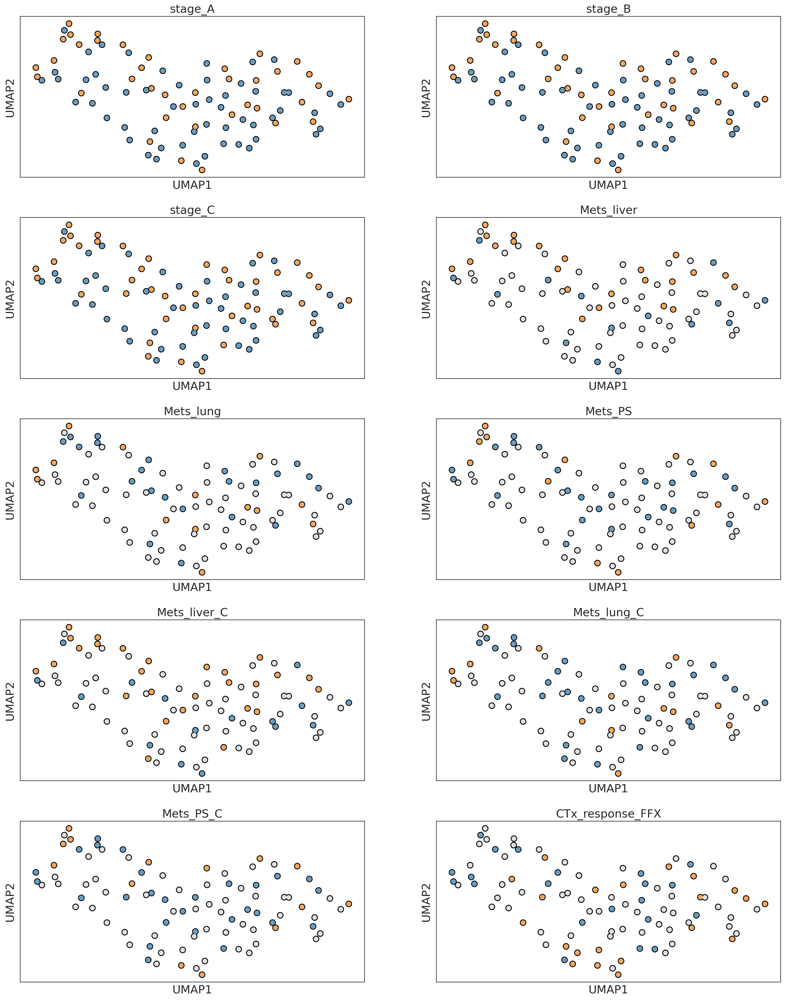

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


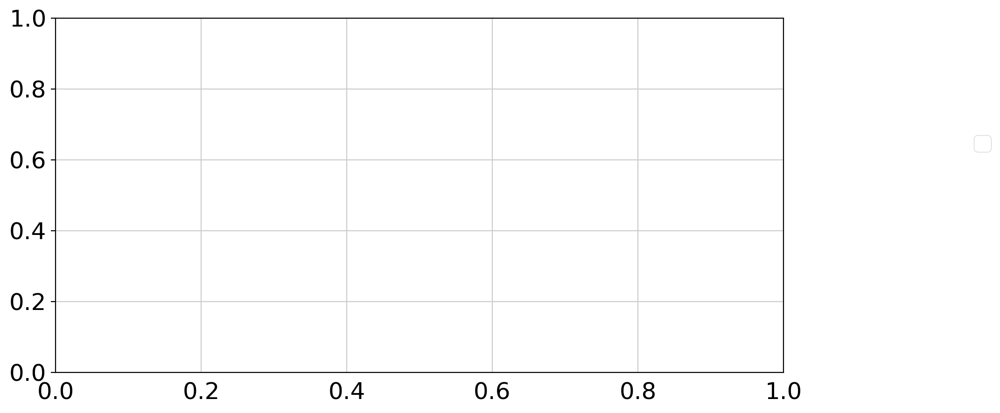

In [169]:
# feature = ['stage_A', 'stage_B', 'stage_C', 'Mets_liver', 'Mets_lung', 'Mets_PS', 
#            'Mets_liver_C','Mets_lung_C','Mets_PS_C','CTx_response_FFX']

# SNU_adata = sc.read_h5ad('SNU_AnnDataForm_20220814.h5ad')
# sc.pp.log1p(SNU_adata)

# sc.pp.highly_variable_genes(SNU_adata,n_top_genes=5000)
# SNU_adata_HVG = SNU_adata[:,SNU_adata.var.highly_variable]

# sc.tl.pca(SNU_adata_HVG, svd_solver='arpack', n_comps = 20)
# sc.pp.neighbors(SNU_adata_HVG, n_neighbors=5)

# #print(mg_adata_bec_HVG.obs['leiden'].value_counts())

# sc.settings.set_figure_params(dpi=100, figsize=(10,5), fontsize=18)
# sc.tl.umap(SNU_adata_HVG)
# sc.pl.umap(SNU_adata_HVG, color=feature, s=200, ncols=2, wspace=0.1, add_outline=True, outline_width=(0.2, 0.03),legend_loc='inside')
# plt.legend(bbox_to_anchor=(1.3,0.7))

In [267]:
# tumor_dict = {'S0':'C1', 'S1':'C2'}
# tme_dict = {'S0':'E1', 'S1':'E2'}

# SNU_adata = sc.read_h5ad('SNU_AnnDataForm.h5ad')
# TCGA_adata = sc.read_h5ad('TCGA_AnnDataForm.h5ad')
# Bailey_adata = sc.read_h5ad('Bailey_AnnDataForm.h5ad')

# SNU_adata.obs['Tumor Subtype'] = SNU_adata.obs['Tumor Subtype'].map(tumor_dict)
# SNU_adata.obs['TME Subtype'] = SNU_adata.obs['TME Subtype'].map(tme_dict)


# TCGA_adata.obs['Tumor Subtype'] = TCGA_adata.obs['Tumor Subtype'].map(tumor_dict)
# TCGA_adata.obs['TME Subtype'] = TCGA_adata.obs['TME Subtype'].map(tme_dict)

# Bailey_adata.obs['Tumor Subtype'] = Bailey_adata.obs['Tumor Subtype'].map(tumor_dict)
# Bailey_adata.obs['TME Subtype'] = Bailey_adata.obs['TME Subtype'].map(tme_dict)

# SNU_adata.obs['Final Subtype'] = SNU_adata.obs['Tumor Subtype'].astype(str)+'-'+SNU_adata.obs['TME Subtype'].astype(str)
# print(SNU_adata.obs['Final Subtype'].value_counts())
# TCGA_adata.obs['Final Subtype'] = TCGA_adata.obs['Tumor Subtype'].astype(str)+'-'+TCGA_adata.obs['TME Subtype'].astype(str)
# print(TCGA_adata.obs['Final Subtype'].value_counts())
# Bailey_adata.obs['Final Subtype'] = Bailey_adata.obs['Tumor Subtype'].astype(str)+'-'+Bailey_adata.obs['TME Subtype'].astype(str)
# print(Bailey_adata.obs['Final Subtype'].value_counts())


# SNU_adata.write('SNU_AnnDataForm.h5ad')
# TCGA_adata.write('TCGA_AnnDataForm.h5ad')
# Bailey_adata.write('Bailey_AnnDataForm.h5ad')

In [ ]:

# print(SNU_adata.obs['Final Subtype'].value_counts())

In [268]:
# SNU_adata = sc.read_h5ad('SNU_AnnDataForm.h5ad')
# TCGA_adata = sc.read_h5ad('TCGA_AnnDataForm.h5ad')
# Bailey_adata = sc.read_h5ad('Bailey_AnnDataForm.h5ad')

# print(SNU_adata.obs['Final Subtype'].value_counts())
# print(TCGA_adata.obs['Final Subtype'].value_counts())
# print(Bailey_adata.obs['Final Subtype'].value_counts())

In [3]:
SNU_adata = sc.read_h5ad('SNU_AnnDataForm.h5ad')
SNU_adata.obs['Dataset'] = 'SNUBH'
sc.pp.log1p(SNU_adata)

TCGA_adata = sc.read_h5ad('TCGA_AnnDataForm.h5ad')
TCGA_adata.obs['Dataset'] = 'TCGA'
OS_STATUS_dict = dict()
OS_STATUS_dict['0:LIVING']=0
OS_STATUS_dict['1:DECEASED']=1
TCGA_adata.obs['OS_event'] = TCGA_adata.obs['OS_STATUS'].map(OS_STATUS_dict)
TCGA_adata.obs['OS_F'] = TCGA_adata.obs['OS_MONTHS']
sc.pp.log1p(TCGA_adata)

Bailey_adata = sc.read_h5ad('Bailey_AnnDataForm.h5ad')
Bailey_adata.obs['Dataset'] = 'Bailey'
Bailey_STATUS_dict = dict()
Bailey_STATUS_dict['Deceased - Of Disease']=1
Bailey_STATUS_dict['Alive - Without Disease']=0
Bailey_STATUS_dict['Alive - With Disease']=0
Bailey_STATUS_dict['Deceased - Of Other Cause']=1
Bailey_STATUS_dict['Deceased - Of Unknown Cause']=1
Bailey_adata.obs['OS_event'] = Bailey_adata.obs['Status'].map(Bailey_STATUS_dict)
Bailey_adata.obs['OS_F'] = Bailey_adata.obs['Length of Follow Up (months)']






In [9]:
TCGA_adata.obs['OS_event'].value_counts()

1    93
0    82
Name: OS_event, dtype: int64

In [1017]:
# c_list = ['Sample type','qpure_score','qpure >40%','Ethnicity','Gender','Age at Diagnosis in Years',
#           'Tumour Grade','HistoSubtype','Tumour Location','AJCC Pathology Stage','OS_event','OS_F']
# b_obs = Bailey_adata.obs.loc[:,c_list]
# b_obs.columns = ['Sample type','tumor_purity','tumor_purity >40%','Ethnicity','Gender','Age at Diagnosis in Years',
#           'Tumour Grade','HistoSubtype','Tumour Location','AJCC Pathology Stage','OS_event','OS_F']
# b_obs.to_csv('Bailey_OBS.csv')

In [1018]:
# c_list = ['SAMPLE_TYPE','RACE','SEX','AGE','GRADE','HISTOLOGICAL_DIAGNOSIS','PRIMARY_SITE_PATIENT',
#           'AJCC_PATHOLOGIC_TUMOR_STAGE','OS_event','OS_F']
# t_obs = TCGA_adata.obs.loc[:,c_list]
# t_obs.to_csv('TCGA_OBS.csv')

In [1021]:
def rm_p(x):
    return x.replace(' of Pancreas','')
def rm_s(x):
    return x.replace('Stage ','')
def rm_d(x):
    return x.replace(' Type ','')
t_obs['PRIMARY_SITE_PATIENT'] = t_obs['PRIMARY_SITE_PATIENT'].map(rm_p)
t_obs['AJCC_PATHOLOGIC_TUMOR_STAGE'] = t_obs['AJCC_PATHOLOGIC_TUMOR_STAGE'].map(rm_s)
t_obs

,SAMPLE_TYPE,RACE,SEX,AGE,GRADE,HISTOLOGICAL_DIAGNOSIS,PRIMARY_SITE_PATIENT,AJCC_PATHOLOGIC_TUMOR_STAGE,OS_event,OS_F
SAMPLE_ID,,,,,,,,,,
TCGA-IB-AAUU-01,Primary,WHITE,Male,35.0,G3,Pancreas-Adenocarcinoma Ductal Type,Head,IIB,0,8.05
TCGA-IB-A5ST-01,Primary,WHITE,Female,64.0,G2,Pancreas-Adenocarcinoma Ductal Type,Head,IIB,0,20.86
TCGA-XD-AAUL-01,Primary,WHITE,Male,56.0,G2,Pancreas-Adenocarcinoma Ductal Type,Head,IIA,0,16.36
TCGA-IB-A5SS-01,Primary,WHITE,Female,64.0,G3,Pancreas-Adenocarcinoma Ductal Type,Tail,IIB,1,15.11
TCGA-HZ-A77Q-01,Primary,WHITE,Female,55.0,G2,Pancreas-Adenocarcinoma-Other Subtype,Head,IIB,0,1.08
...,...,...,...,...,...,...,...,...,...,...
TCGA-IB-7654-01,Primary,WHITE,Male,80.0,G2,Pancreas-Adenocarcinoma Ductal Type,Head,IIB,1,15.64
TCGA-2L-AAQJ-01,Primary,WHITE,Female,49.0,G2,Pancreas-Adenocarcinoma Ductal Type,Head,III,1,12.94
TCGA-2L-AAQL-01,Primary,WHITE,Male,82.0,G3,Pancreas-Adenocarcinoma Ductal Type,Head,IIB,1,9.59


In [1022]:
t_obs.to_csv('TCGA_OBS.csv')

In [281]:
SNU_annot = SNU_adata.obs.copy()
TCGA_annot = TCGA_adata.obs.copy()
Bailey_annot = Bailey_adata.obs.copy()

In [282]:
# TCGA_adata = sc.read_h5ad('TCGA_TPM_AnnDataForm.h5ad')
# Bailey_adata = sc.read_h5ad('Bailey_TPM_norm_AnnDataForm.h5ad')
# SNU_adata = sc.read_h5ad('SNU_AnnDataForm_20220814.h5ad')

# SNU_other = pd.read_csv('ALL_TYPE2.csv',index_col=0).loc[:,['MoffittType','BaileyType','Bailey2type','Bailey2type2','MichelleType','CE']]

# SNU_adata.obs['Tumor Subtype'] = SNU_annot['Tumor2Type_2nd']
# SNU_adata.obs['TME Subtype'] = SNU_annot['TME2Type_2nd']

# SNU_adata.obs['Moffitt Subtype'] = SNU_other['MoffittType']
# SNU_adata.obs['Bailey Subtype'] = SNU_other['BaileyType']
# SNU_adata.obs['Chan-Seng-Yue Subtype'] = SNU_other['MichelleType']
# SNU_adata.obs['Bailey P/S'] = SNU_other['Bailey2type']
# SNU_adata.obs['Bailey A/I'] = SNU_other['Bailey2type2']

# SNU_adata.write('SNU_AnnDataForm.h5ad')

# TCGA_adata.obs['SNUBH_Tumor subtype'] = TCGA_annot['Tumor2Type_2nd']
# TCGA_adata.obs['SNUBH_TME subtype'] = TCGA_annot['TME2Type_2nd']
# TCGA_adata.write('TCGA_AnnDataForm.h5ad')


# Bailey_adata.obs['SNUBH_Tumor subtype'] = Bailey_annot['Tumor2Type_2nd']
# Bailey_adata.obs['SNUBH_TME subtype'] = Bailey_annot['TME2Type_2nd']
# Bailey_adata.write('Bailey_AnnDataForm.h5ad')

In [283]:
table_genes = pd.read_csv('Gene_table.csv',index_col=0)
table_genes

,Type,Gene
0,Tumor_Pos,TST
1,Tumor_Pos,SULT1B1
2,Tumor_Pos,GPR160
3,Tumor_Pos,CAPN6
4,Tumor_Pos,AHCYL2
...,...,...
46,TME_Neg,PTPRC
47,TME_Neg,HLA-DPA1
48,TME_Neg,FAP
49,TME_Neg,TLR1


# Tumor Subtype

In [684]:
umap_color = [sns.color_palette('pastel')[1], sns.color_palette('pastel')[2]]

m = table_genes['Type'].isin(['Tumor_Pos','Tumor_Neg'])
features = list(table_genes.loc[m,'Gene'])
len(features)

110

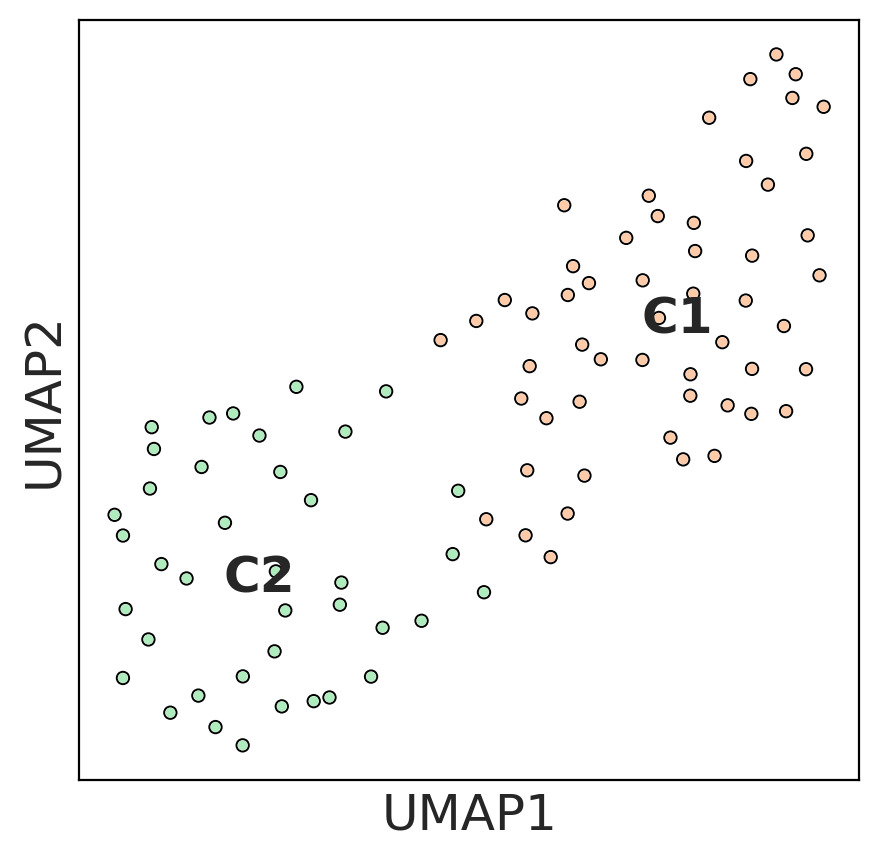

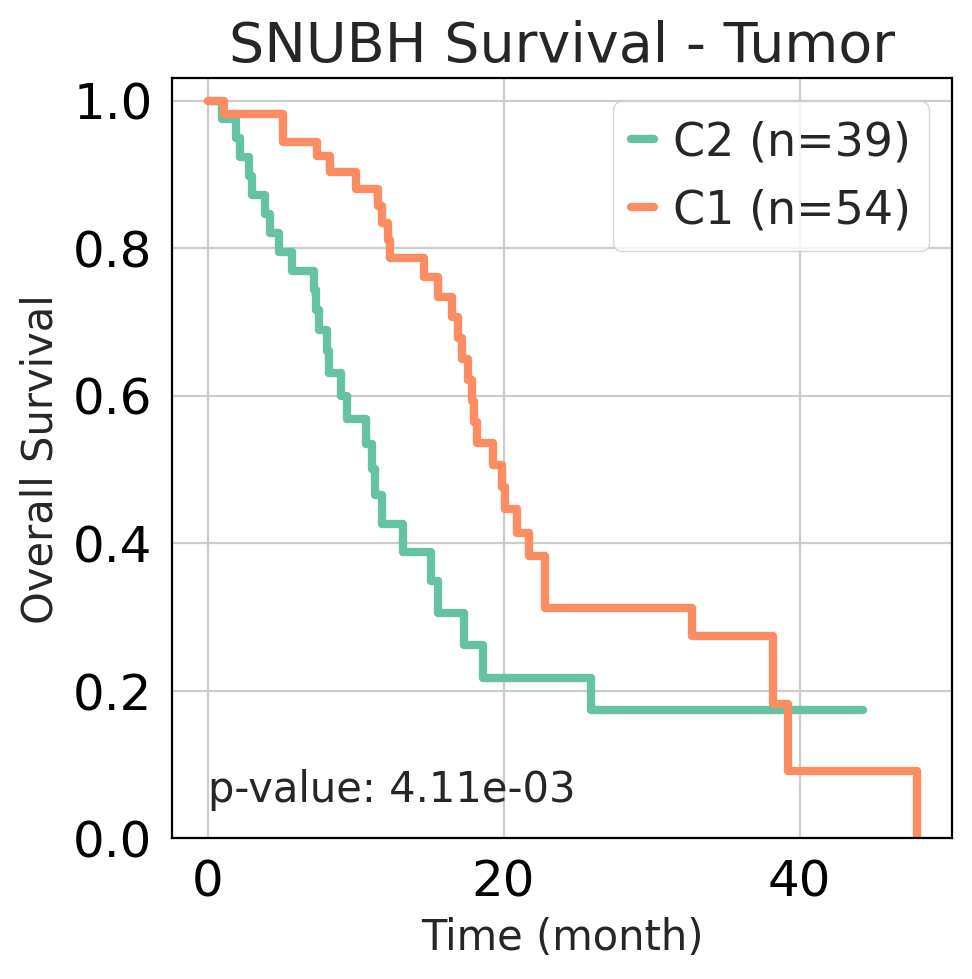

In [685]:
SNU_adata_tmp = SNU_adata[:,features]
sc.pp.highly_variable_genes(SNU_adata_tmp,n_top_genes=110)
SNU_adata_HVG = SNU_adata_tmp[:,SNU_adata_tmp.var.highly_variable]

sc.tl.pca(SNU_adata_HVG, svd_solver='arpack', n_comps = 16)
sc.pp.neighbors(SNU_adata_HVG, n_neighbors=10)

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(SNU_adata_HVG)
sc.pl.umap(SNU_adata_HVG, color=['Tumor Subtype'], s=50, wspace=0.4, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
#sc.pl.umap(SNU_adata_HVG, color=['MoffittType'], s=50, wspace=0.4, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03))
df_clinical = SNU_adata_HVG.obs.copy()

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
snu_p = km_plot(df_info=df_clinical, category='Tumor Subtype', os='OS_F', event='OS_event', title='SNUBH Survival - Tumor')


In [686]:
# import plotly.express as px

# umap = SNU_adata_HVG.obsm['X_umap']
# conf = pd.DataFrame(umap, columns=['UMAP1', 'UMAP2'], index=SNU_adata_HVG.obs.index)
# conf.loc[:,['Tumor Subtype','TME Subtype','OS_F','CTx_response_FFX','stage_C']] =SNU_adata_HVG.obs.loc[:,['Tumor Subtype','TME Subtype', 'OS_F','CTx_response_FFX','stage_C']]
# conf['Patient'] = list(conf.index)
# conf


# fig = px.scatter(conf, x="UMAP1", y="UMAP2", color="Tumor Subtype", hover_data=['OS_F','TME Subtype','Patient','stage_C', 'CTx_response_FFX']
#                 ,width=800, height=600)
# fig.show()



In [11]:
exp = SNU_adata.to_df().loc[:,features]
#annot = pd.read_csv('Bailey_TumorType.csv',index_col=0).sort_values(by='Tumor2Type_1st')
annot = SNU_annot.sort_values(by='Tumor Subtype')
annot
order = list(annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

Annot_lut = dict()
Annot_int_map = dict(zip(annot['Tumor Subtype'].unique(),range(annot['Tumor Subtype'].nunique())))
Annot_lut['C1']='#fc6058'
Annot_lut['C2']='#fcc558'
Annot = annot['Tumor Subtype'].map(Annot_int_map).to_frame('TumorSubtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

NameError: name 'features' is not defined

In [10]:
Annot

NameError: name 'Annot' is not defined

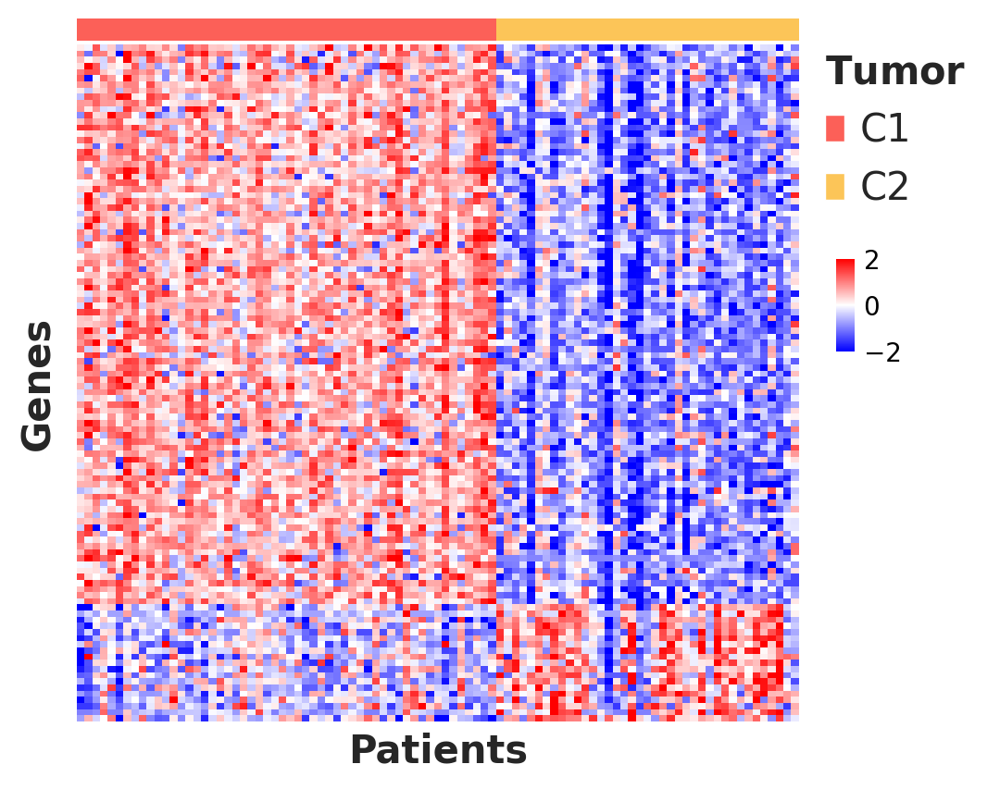

In [516]:
sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)
#plt.subplots_adjust(wspace = 0.2, hspace = 0.05)
widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.28, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{Tumor}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0, )

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()

In [517]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)

ct_table_ind=pd.crosstab(SNU_annot['Tumor Subtype'],SNU_annot['stage_A'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()

ct_table_ind=pd.crosstab(SNU_annot['Tumor Subtype'],SNU_annot['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(SNU_annot['TME Subtype'],SNU_annot['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(SNU_annot['Tumor Subtype'],SNU_annot['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(SNU_annot['TME Subtype'],SNU_annot['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)


stage_A        Localized  Metastatic
Tumor Subtype                       
C1                    37          17
C2                    18          21
0.051025216324111146

stage_C        Localized  Metastatic
Tumor Subtype                       
C1                    35          19
C2                    15          24
0.021192418798151473

stage_C      Localized  Metastatic
TME Subtype                       
E1                  36          35
E2                  14           8
0.4131863667710439

CTx_response_FFX  non-responder  responder
Tumor Subtype                             
C1                            9         15
C2                           12          6
0.1189907208931241

CTx_response_FFX  non-responder  responder
TME Subtype                               
E1                           19         13
E2                            2          8
0.07007553859334138


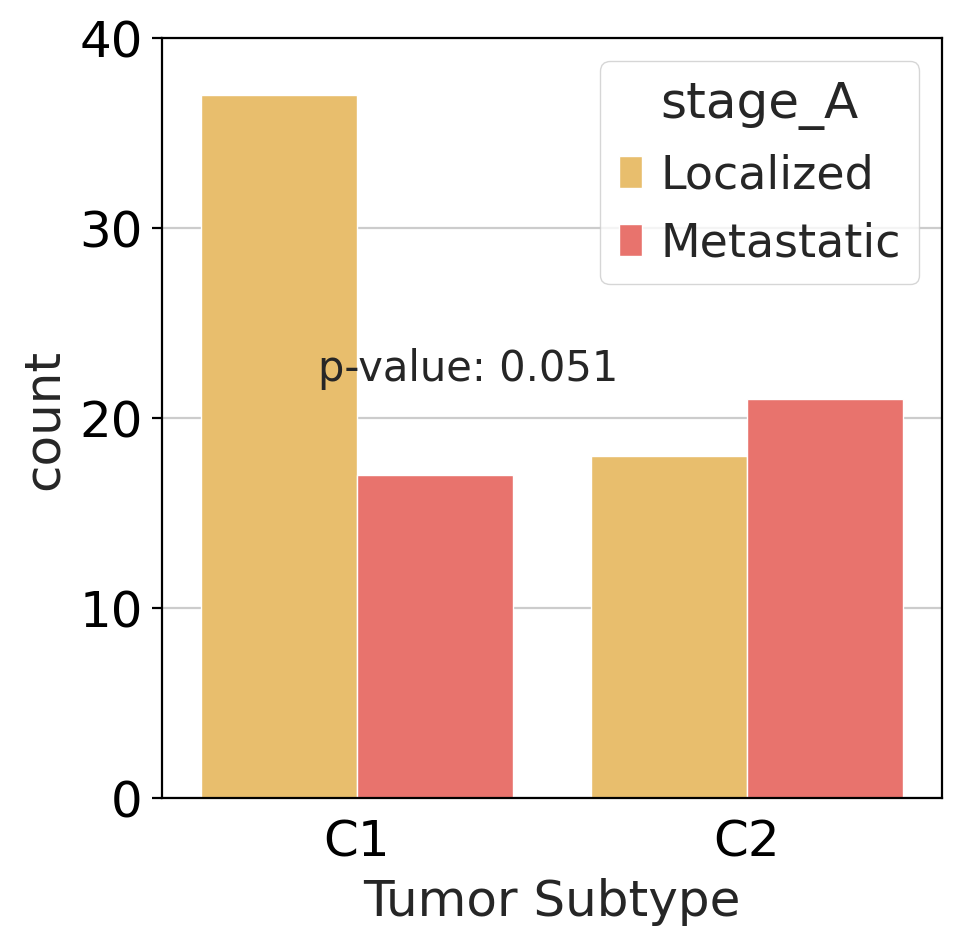

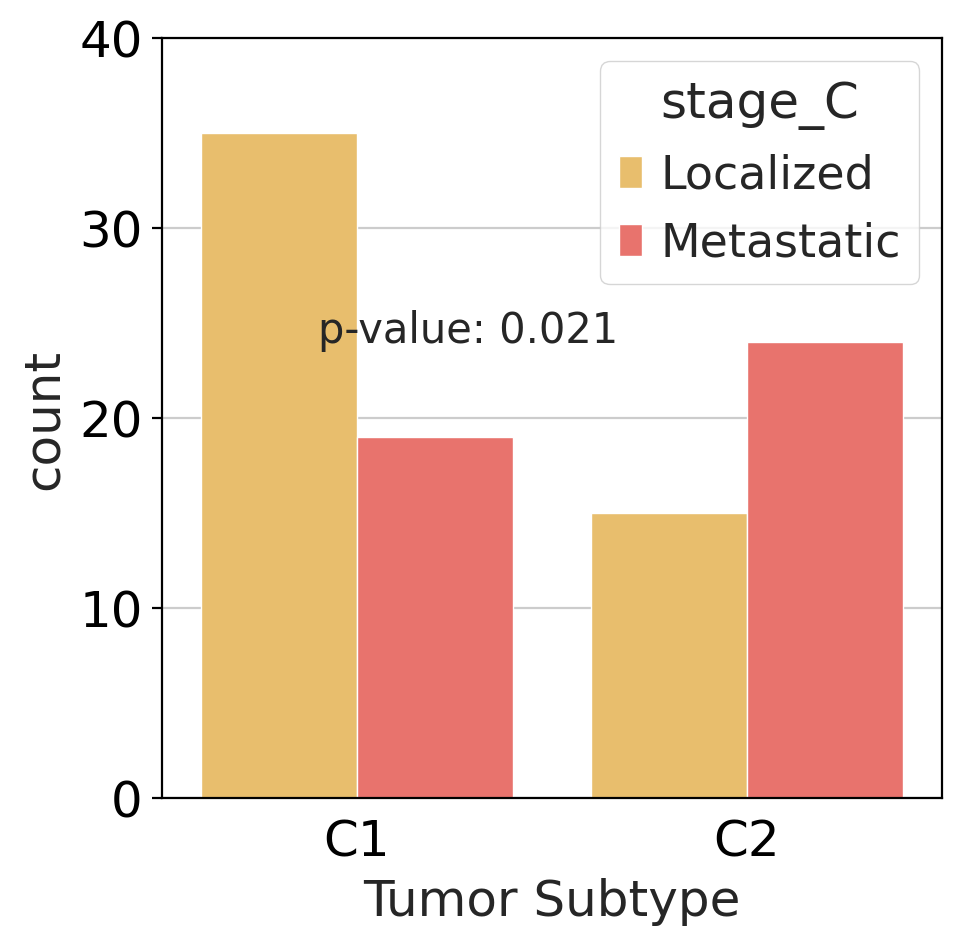

In [492]:
stage_palette = dict()
stage_palette['Localized']='#fcc558'
stage_palette['Metastatic']='#fc6058'

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
stage_a = SNU_annot.loc[:,['stage_A','Tumor Subtype']]
stage_c = SNU_annot.loc[:,['stage_C','Tumor Subtype']]
g = sns.countplot(x="Tumor Subtype",  hue="stage_A", data=stage_a, palette=stage_palette)
ct_table_ind=pd.crosstab(SNU_annot['Tumor Subtype'],SNU_annot['stage_A'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p = np.round(p,3)
plt.text(-0.1, 22, 'p-value: {}'.format(p), fontsize=15)
plt.ylim((0,40))
#plt.title('Stage_A')
plt.show()

g = sns.countplot(x="Tumor Subtype",  hue="stage_C", data=stage_c, palette=stage_palette)
ct_table_ind=pd.crosstab(SNU_annot['Tumor Subtype'],SNU_annot['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p = np.round(p,3)
plt.text(-0.1, 24, 'p-value: {}'.format(p), fontsize=15)
#plt.title('Stage_C')
plt.ylim((0,40))
plt.show()


Localized     35
Metastatic    19
Name: stage_C, dtype: int64
Metastatic    24
Localized     15
Name: stage_C, dtype: int64


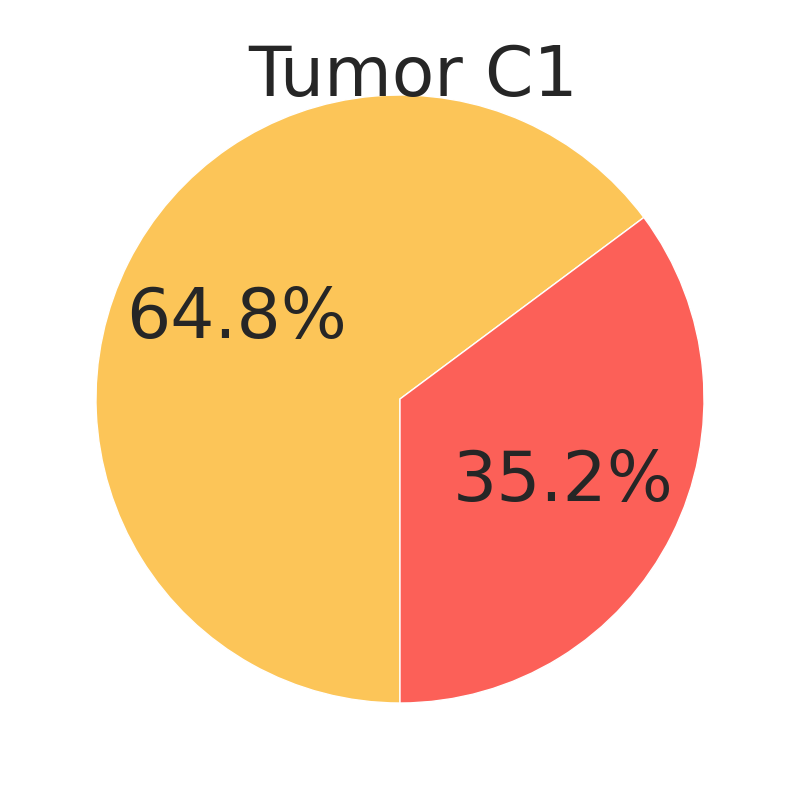

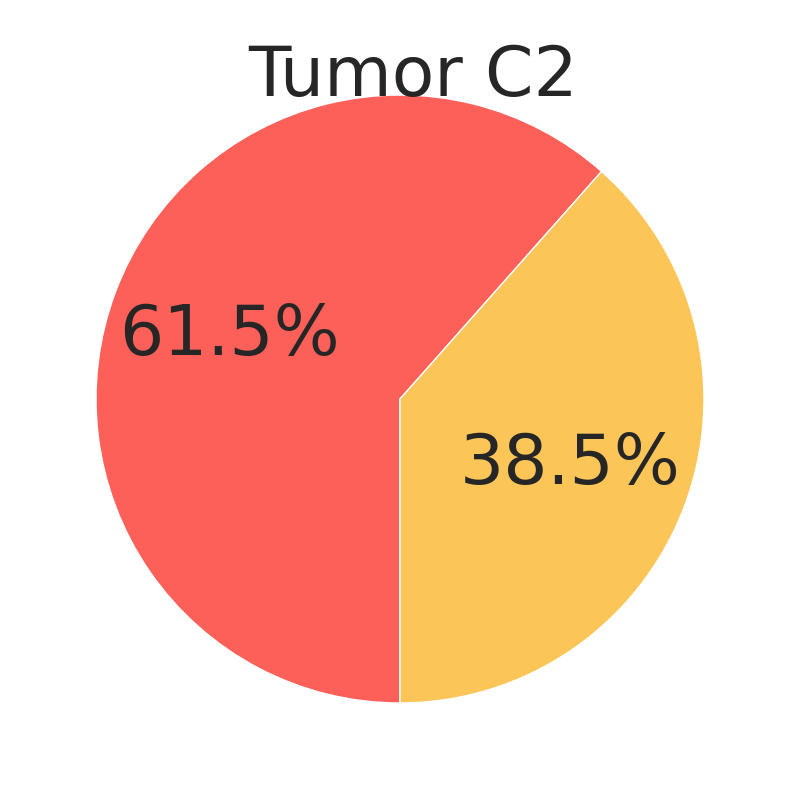

yes    10
no      9
Name: Mets_liver_C, dtype: int64
no     11
yes     8
Name: Mets_lung_C, dtype: int64
no     15
yes     4
Name: Mets_PS_C, dtype: int64


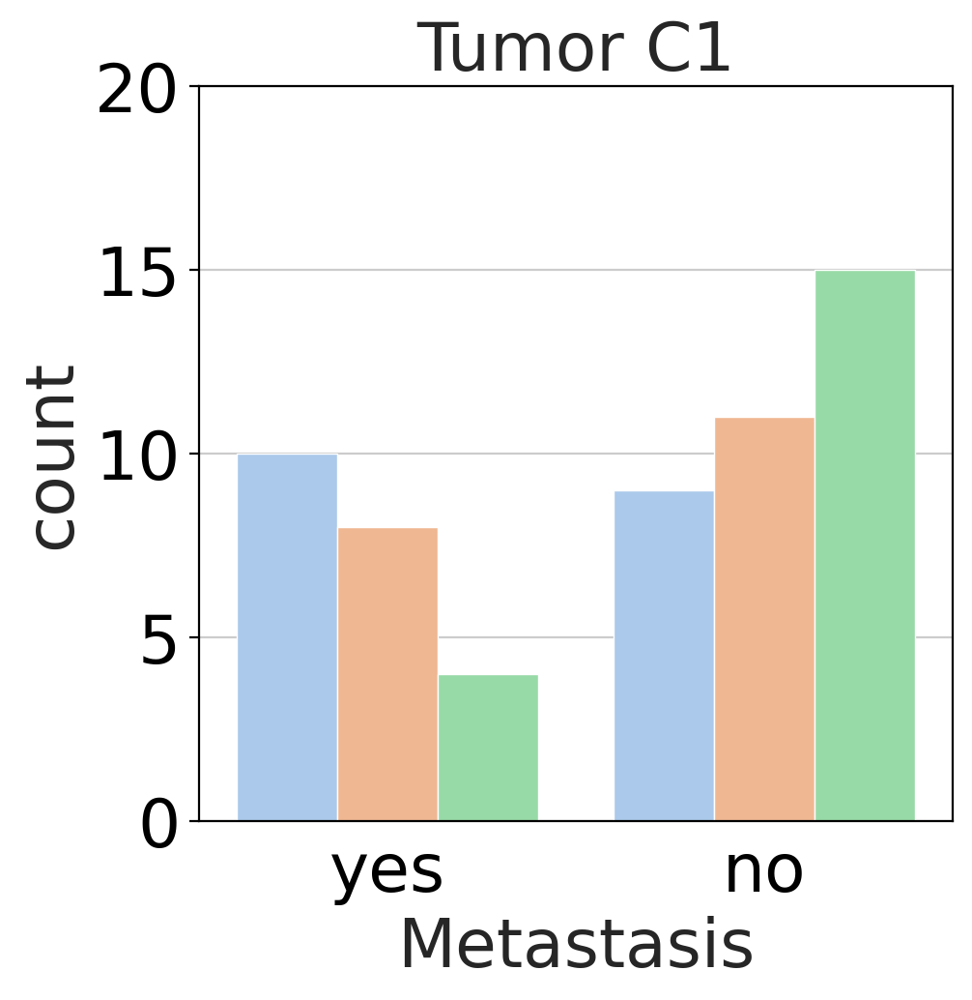

yes    17
no      7
Name: Mets_liver_C, dtype: int64
no     18
yes     6
Name: Mets_lung_C, dtype: int64
no     13
yes    10
Name: Mets_PS_C, dtype: int64


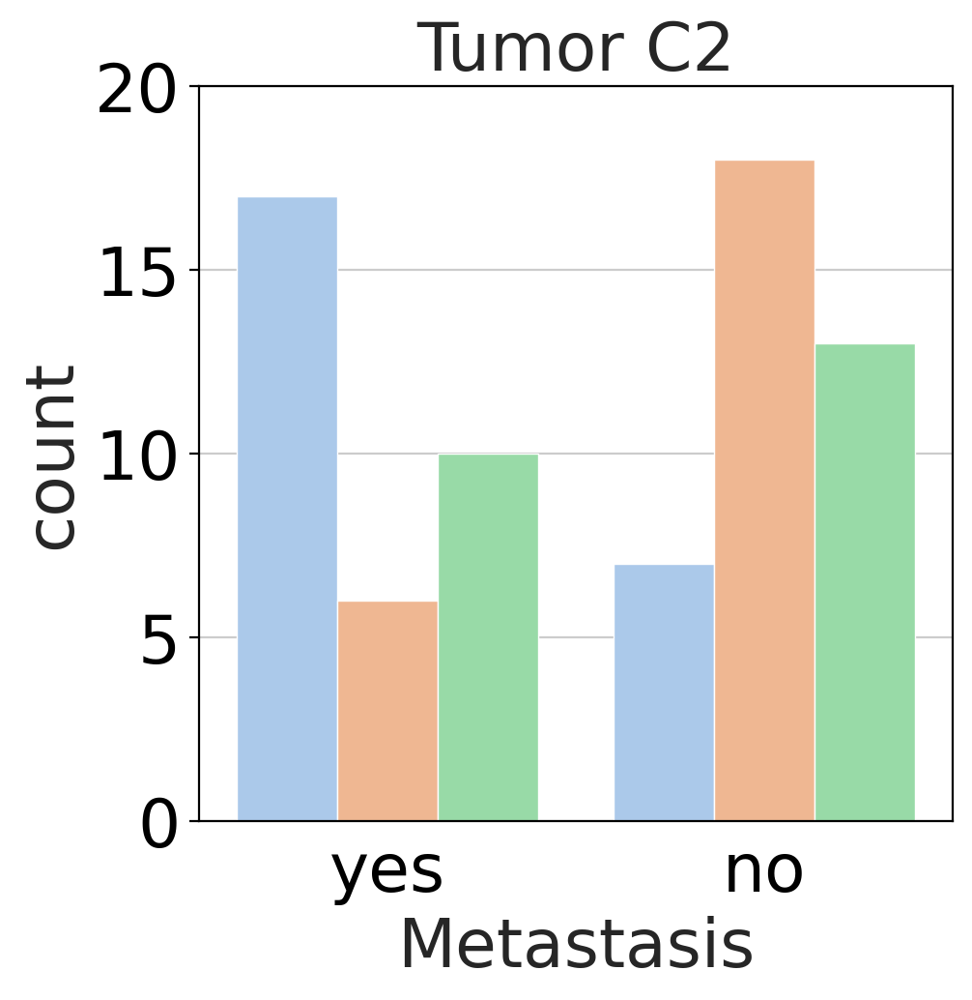

yes    17
no      7
Name: Mets_liver_C, dtype: int64
no     18
yes     6
Name: Mets_lung_C, dtype: int64
no     13
yes    10
Name: Mets_PS_C, dtype: int64


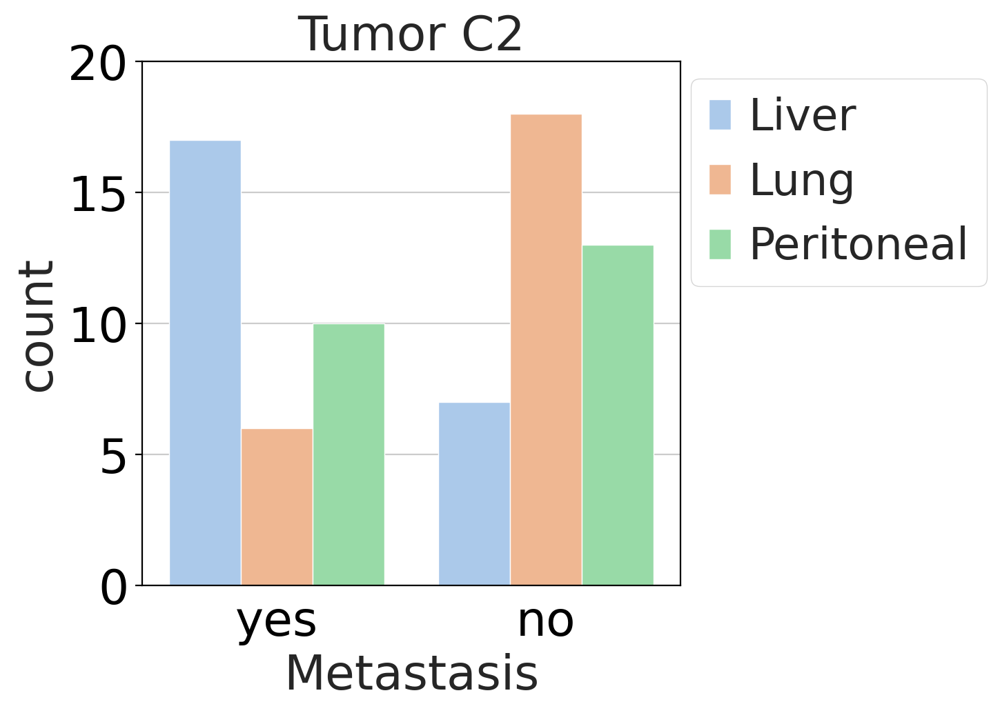

In [665]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=25)

mets_dict = dict()
mets_dict['Mets_liver_C']='Liver'
mets_dict['Mets_lung_C']='Lung'
mets_dict['Mets_PS_C']='Peritoneal'


m1 = SNU_annot['Tumor Subtype'] == 'C1'
m2 = SNU_annot['Tumor Subtype'] == 'C2'

with_stage_sel1 = SNU_annot[m1]
print(with_stage_sel1['stage_C'].value_counts())
with_stage_sel2 = SNU_annot[m2]
print(with_stage_sel2['stage_C'].value_counts())

stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
#plt.title('Tumor C1',position=(0.5, 0))
plt.text(-0.5, 1,'Tumor C1')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fc6058', '#fcc558'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.text(-0.5, 1,'Tumor C2')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
legend = g.get_legend()
legend.remove()
plt.title('Tumor C1')

plt.ylim((0,20))
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
legend = g.get_legend()
legend.remove()
plt.title('Tumor C2')
plt.ylim((0,20))
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.11, .51, 0.5, 0.5))
plt.title('Tumor C2')
plt.ylim((0,20))
plt.show()

# Bailey - Tumor

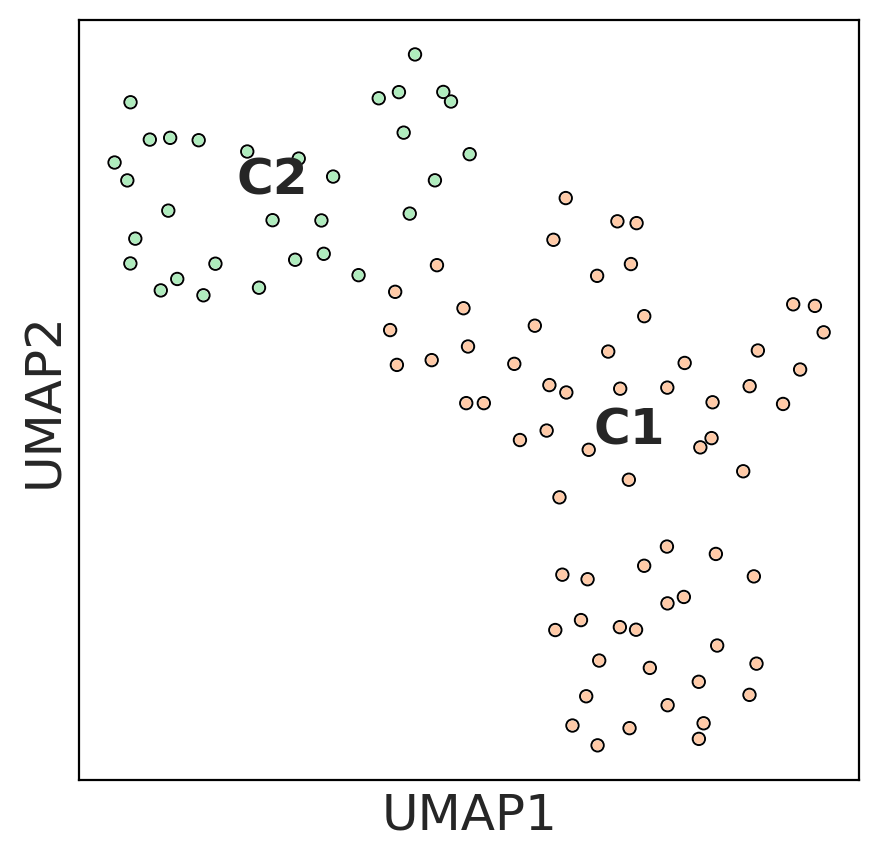

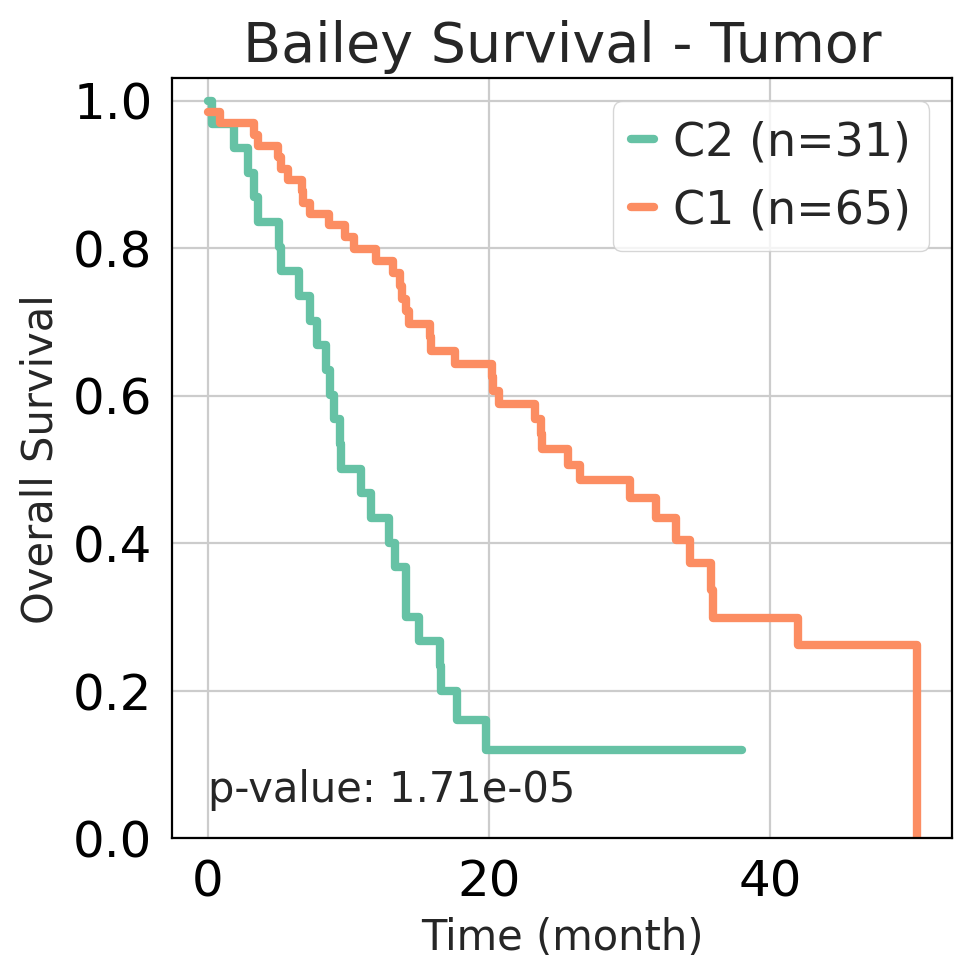

In [688]:
Bailey_adata_HVG = Bailey_adata[:,features]

sc.tl.pca(Bailey_adata_HVG, svd_solver='arpack', n_comps = 10)
sc.pp.neighbors(Bailey_adata_HVG, n_neighbors=6)

#Bailey_adata_HVG.obs['Tumor2Type_2nd'] = Bailey_annot['Tumor2Type_2nd']

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(Bailey_adata_HVG)
sc.pl.umap(Bailey_adata_HVG, color=['Tumor Subtype'], s=50, wspace=0.4, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
df_clinical = Bailey_adata_HVG.obs.copy()
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
bailey_p = km_plot(df_info=df_clinical, category='Tumor Subtype', os='OS_F', event='OS_event', title='Bailey Survival - Tumor')

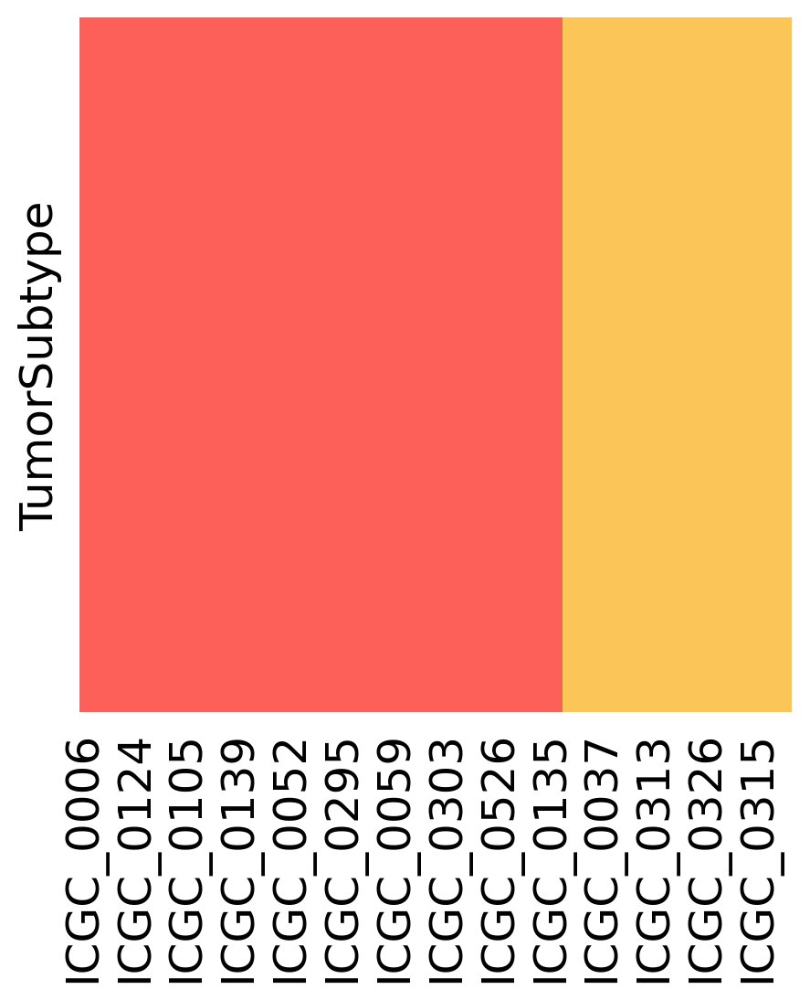

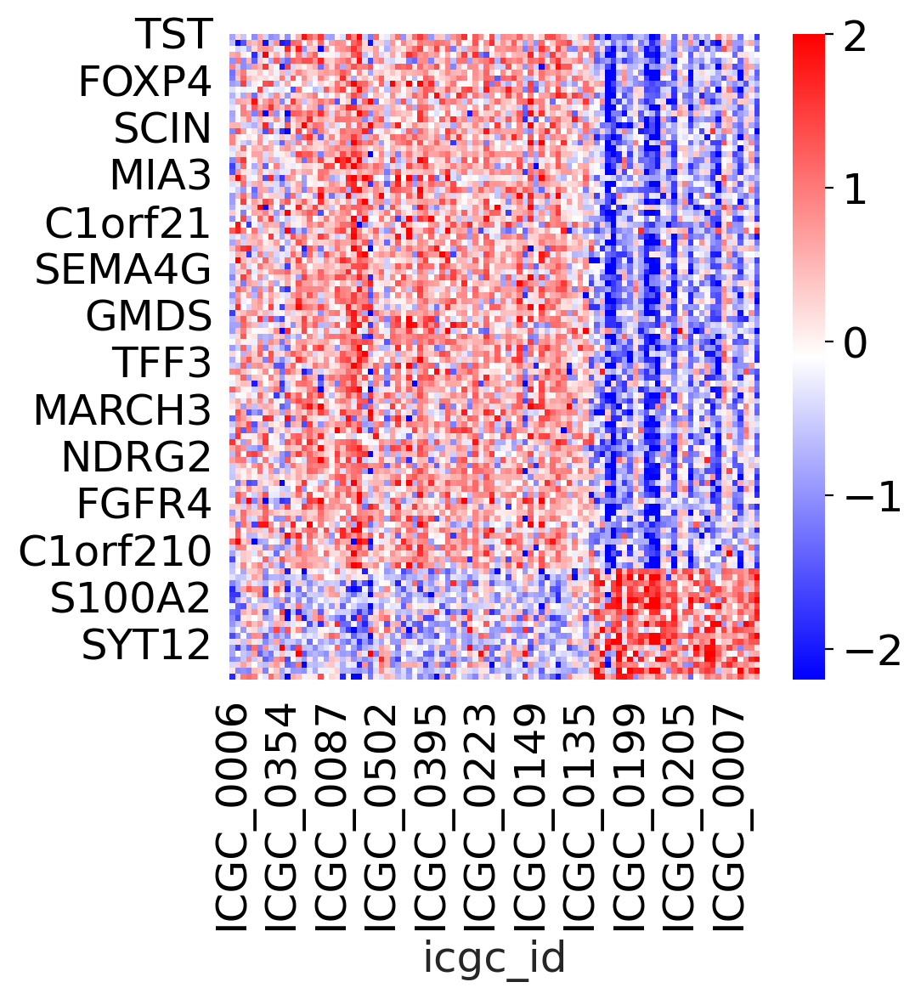

In [689]:
exp = Bailey_adata_HVG.to_df()
#annot = pd.read_csv('Bailey_TumorType.csv',index_col=0).sort_values(by='Tumor2Type_1st')
Bailey_annot = Bailey_annot.sort_values(by='Tumor Subtype')
Bailey_annot
order = list(Bailey_annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

Annot_lut = dict()
Annot_int_map = dict(zip(Bailey_annot['Tumor Subtype'].unique(),range(Bailey_annot['Tumor Subtype'].nunique())))
Annot_lut['C1']='#fc6058'
Annot_lut['C2']='#fcc558'
Annot = Bailey_annot['Tumor Subtype'].map(Annot_int_map).to_frame('TumorSubtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

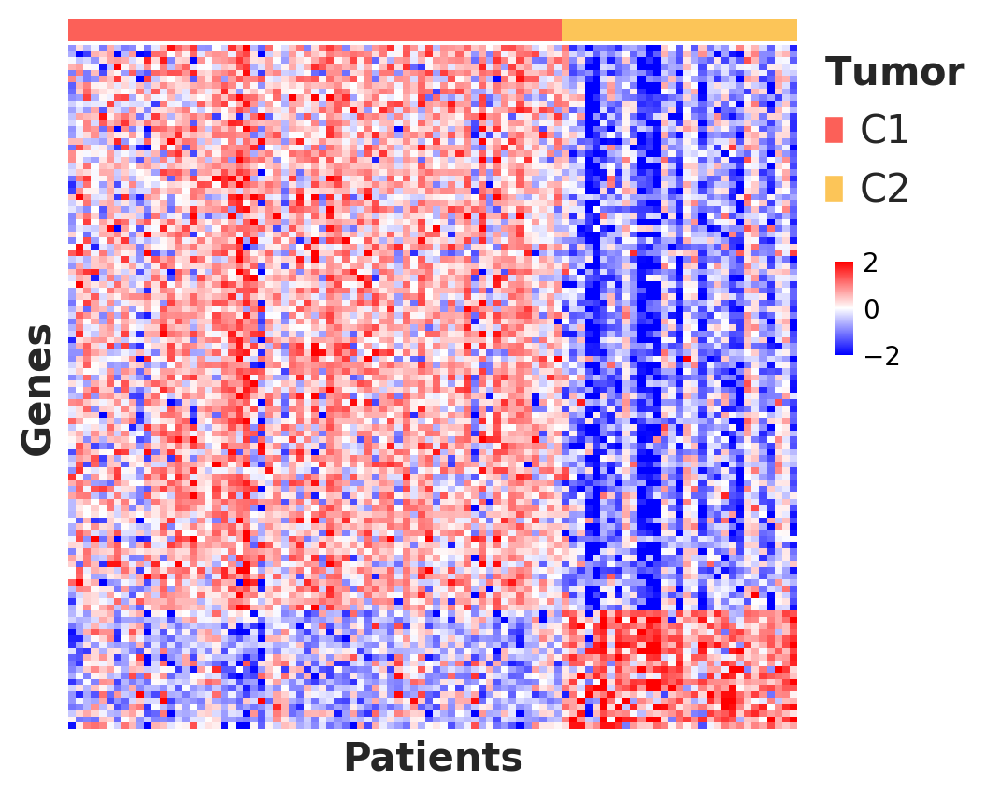

In [690]:
from matplotlib.gridspec import GridSpec
import matplotlib.patches as mpatches

sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)

widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.28, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{Tumor}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()


# TCGA - Tumor

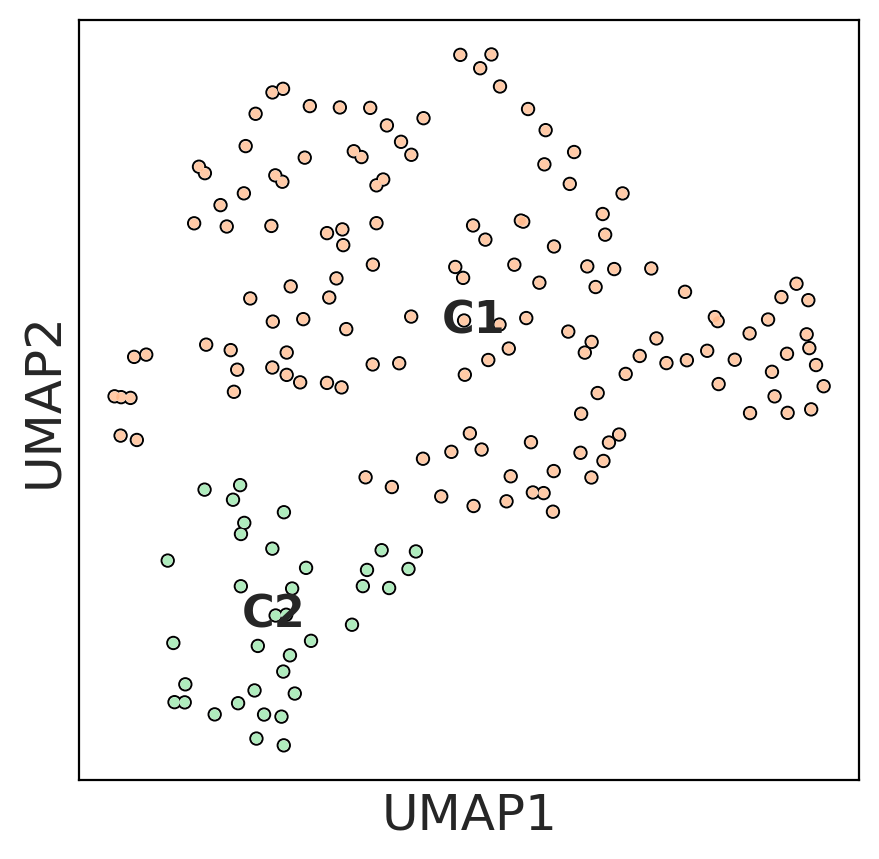

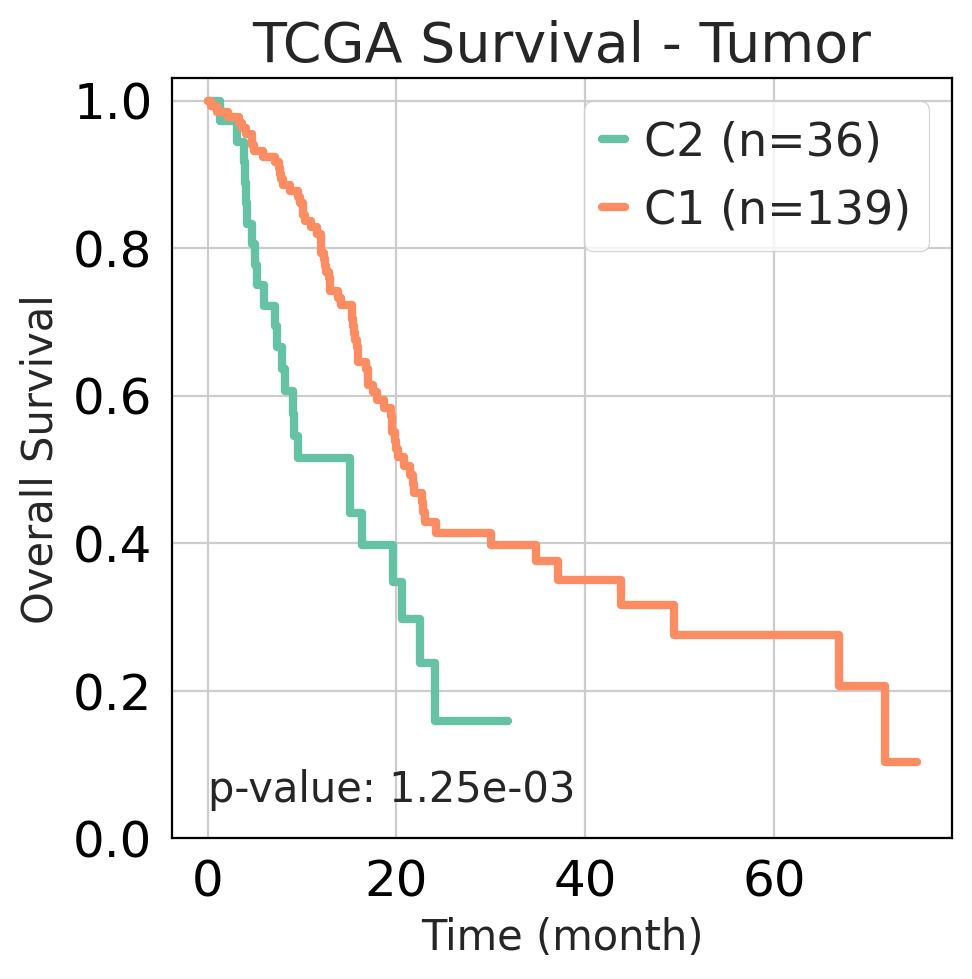

In [691]:
"""
5-9
"""

TCGA_adata_HVG = TCGA_adata[:,features]

sc.tl.pca(TCGA_adata_HVG, svd_solver='arpack', n_comps = 4)
sc.pp.neighbors(TCGA_adata_HVG, n_neighbors=10)

TCGA_adata_HVG.obs['Tumor Subtype'] = TCGA_annot['Tumor Subtype']


sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(TCGA_adata_HVG)
sc.pl.umap(TCGA_adata_HVG, color=['Tumor Subtype'], s=50, wspace=0.4, legend_fontsize = 16, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
df_clinical = TCGA_adata_HVG.obs.copy()
sc.settings.set_figure_params(figsize=(6, 6), facecolor='white')
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
tcga_p = km_plot(df_info=df_clinical, category='Tumor Subtype', os='OS_F', event='OS_event', title='TCGA Survival - Tumor')


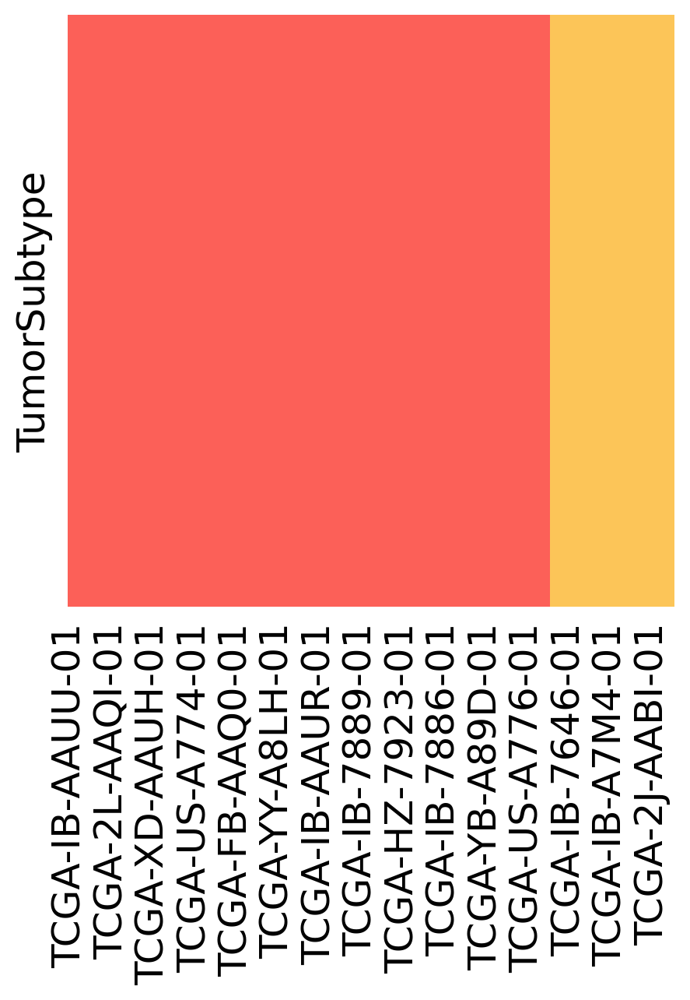

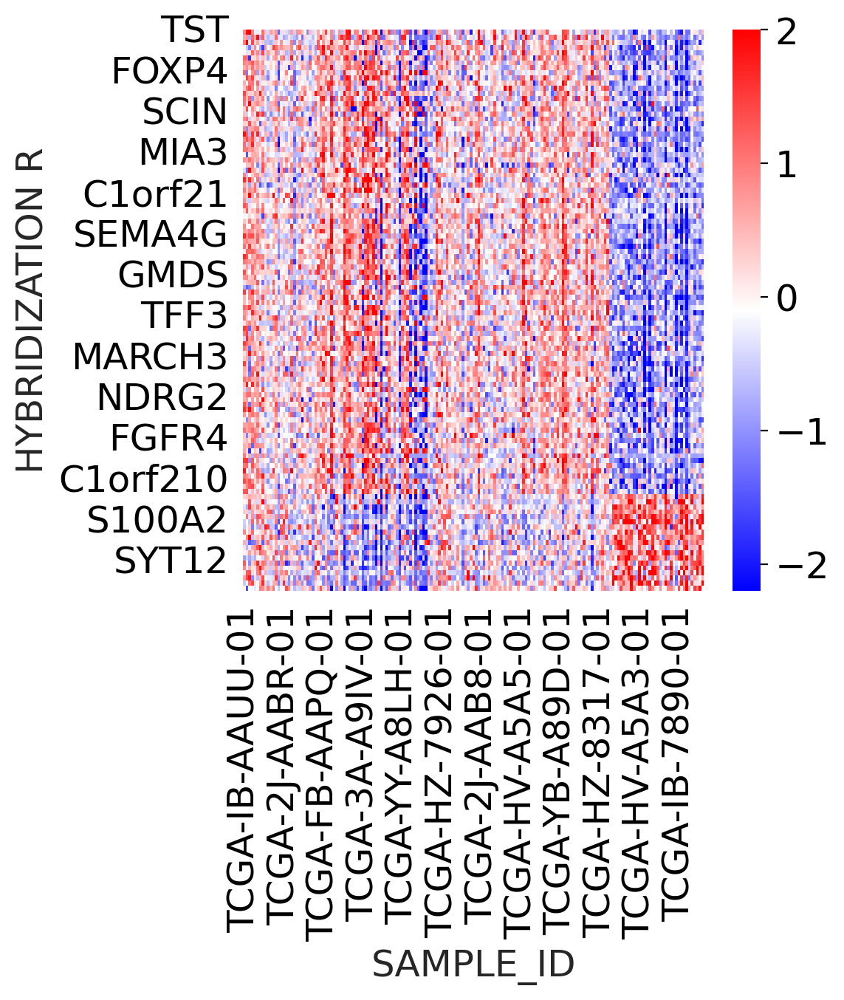

In [692]:
exp = TCGA_adata_HVG.to_df().loc[:,features]
#annot = pd.read_csv('Bailey_TumorType.csv',index_col=0).sort_values(by='Tumor2Type_1st')
TCGA_annot = TCGA_annot.sort_values(by='Tumor Subtype')
TCGA_annot
order = list(TCGA_annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T


Annot_lut = dict()
Annot_int_map = dict(zip(TCGA_annot['Tumor Subtype'].unique(),range(TCGA_annot['Tumor Subtype'].nunique())))
Annot_lut['C1']='#fc6058'
Annot_lut['C2']='#fcc558'
Annot = TCGA_annot['Tumor Subtype'].map(Annot_int_map).to_frame('TumorSubtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

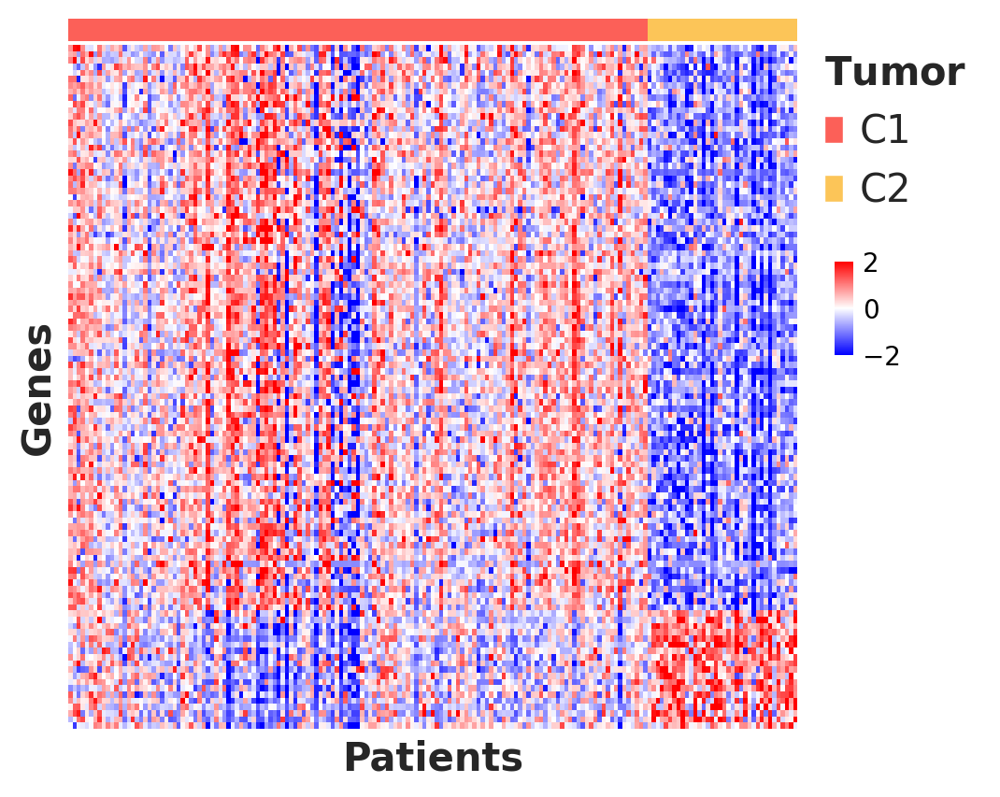

In [693]:

sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)
widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.28, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{Tumor}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()

# TME Subtype

In [672]:
umap_color2 = [sns.color_palette('pastel')[1], sns.color_palette('pastel')[2]]
umap_color = dict()
umap_color['E1'] = umap_color2[1]
umap_color['E2'] = umap_color2[0]

m = table_genes['Type'].isin(['TME_Neg'])
features = list(table_genes.loc[m,'Gene'])
len(features)

51

# SNU - TME

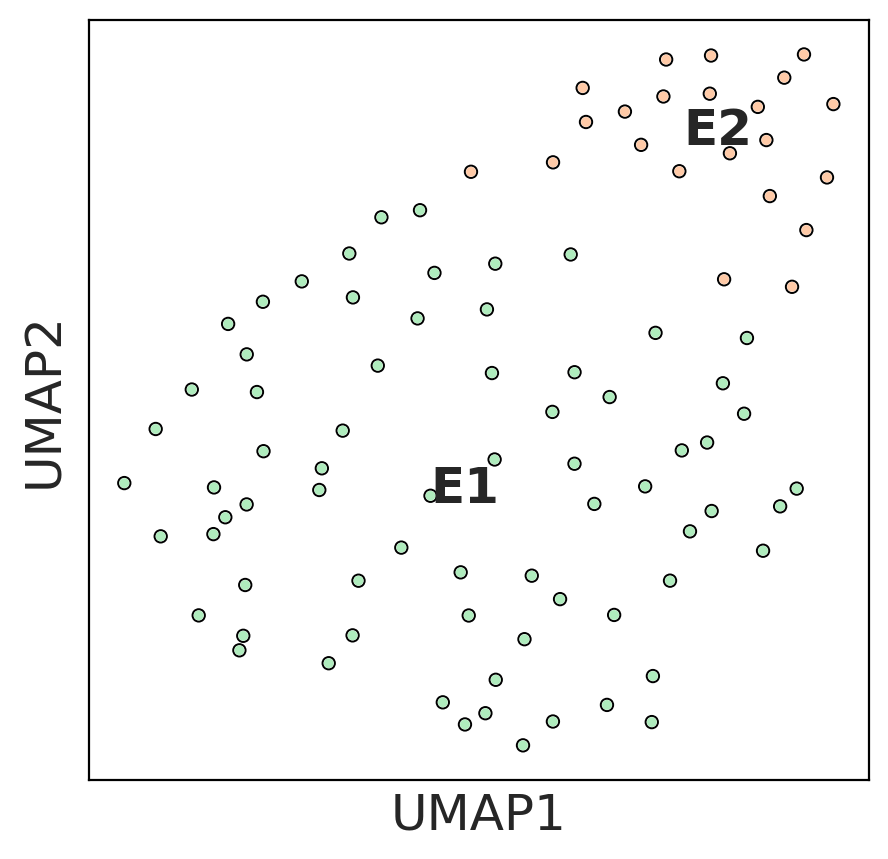

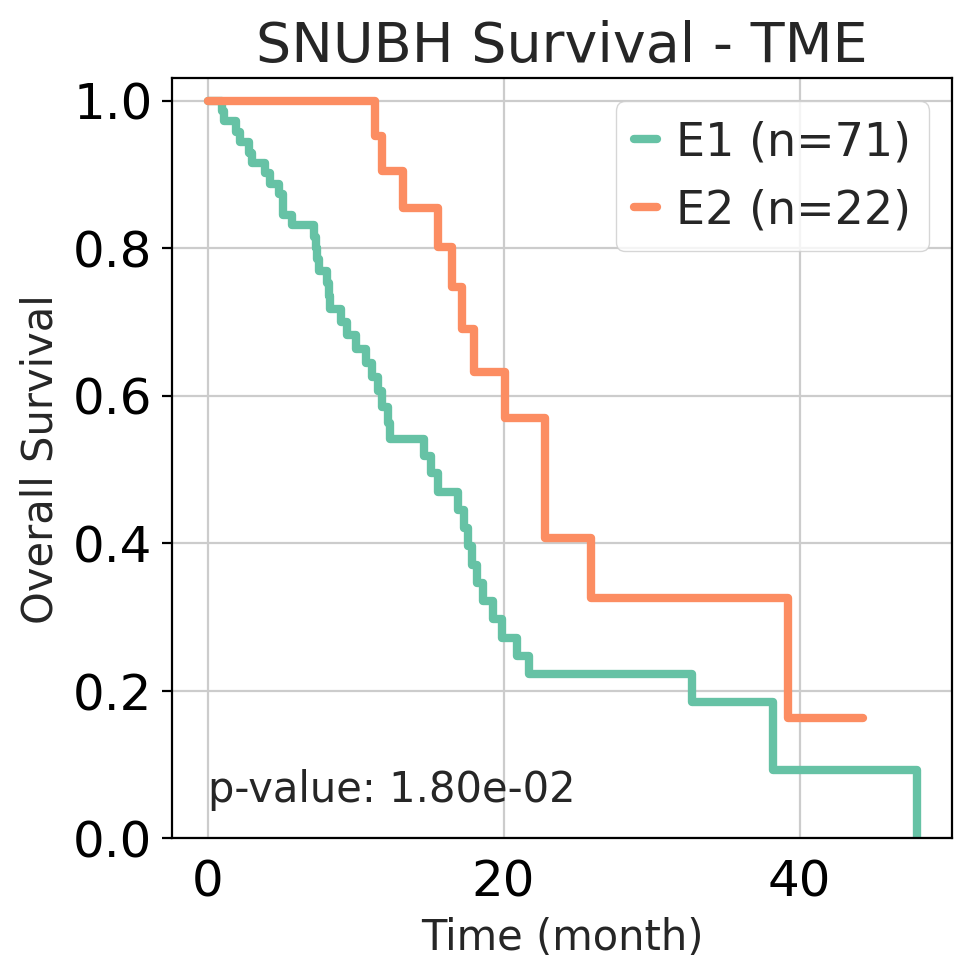

In [519]:

n_comps = 2
n_neighbors = 13


# n_comps = 2
# n_neighbors = 5
# resolution = 0.07
#n_top_genes=45
SNU_adata_HVG = SNU_adata[:,features]
# sc.pp.highly_variable_genes(SNU_adata_HVG,n_top_genes=n_top_genes)
# SNU_adata_HVG = SNU_adata_HVG[:,SNU_adata_HVG.var.highly_variable]

sc.tl.pca(SNU_adata_HVG, svd_solver='arpack', n_comps = n_comps)
sc.pp.neighbors(SNU_adata_HVG, n_neighbors=n_neighbors)



sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(SNU_adata_HVG)
sc.pl.umap(SNU_adata_HVG, color=['TME Subtype'], s=50, wspace=0.4, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
df_clinical = SNU_adata_HVG.obs.copy()
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
SNU_p = km_plot(df_info=df_clinical, category='TME Subtype', os='OS_F', event='OS_event', title='SNUBH Survival - TME')



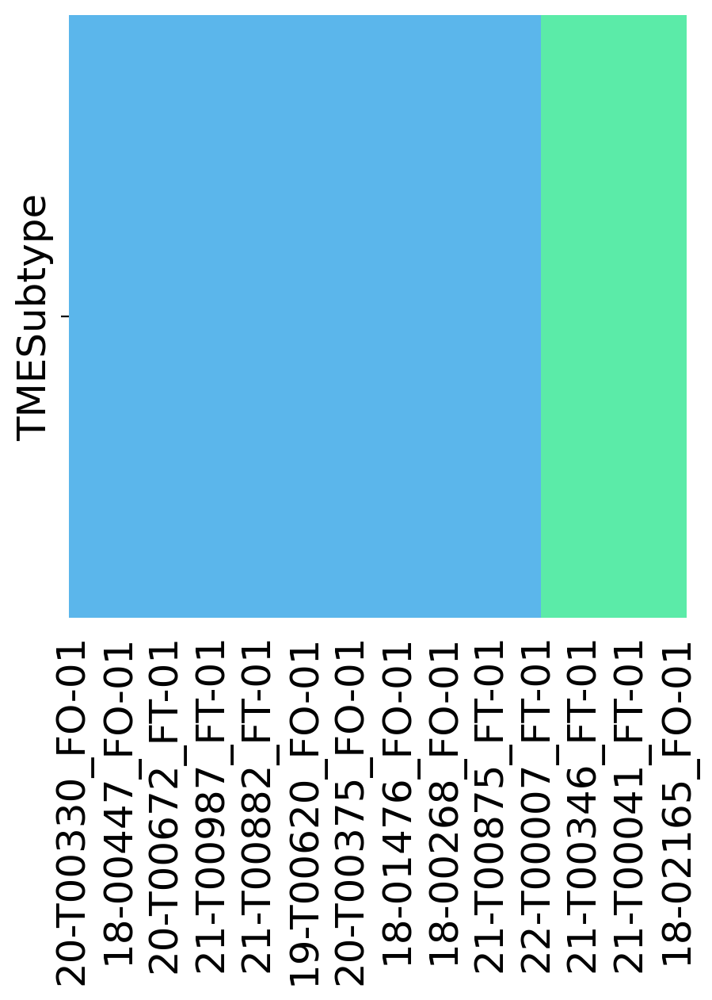

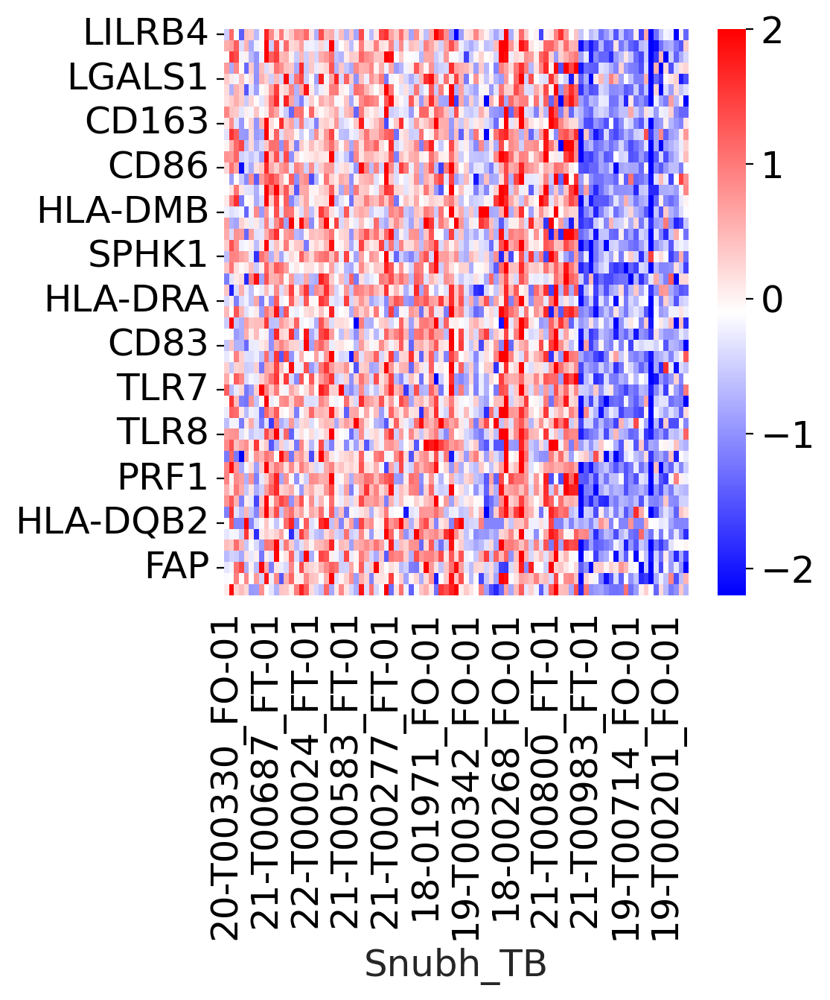

In [520]:
exp = SNU_adata_HVG.to_df()
SNU_annot = SNU_annot.sort_values(by='TME Subtype')
SNU_annot
order = list(SNU_annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T


Annot_lut = dict()
Annot_int_map = dict(zip(SNU_annot['TME Subtype'].unique(),range(SNU_annot['TME Subtype'].nunique())))
Annot_lut['E1']='#5bb6eb'
Annot_lut['E2']='#5beba8'
Annot = SNU_annot['TME Subtype'].map(Annot_int_map).to_frame('TMESubtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

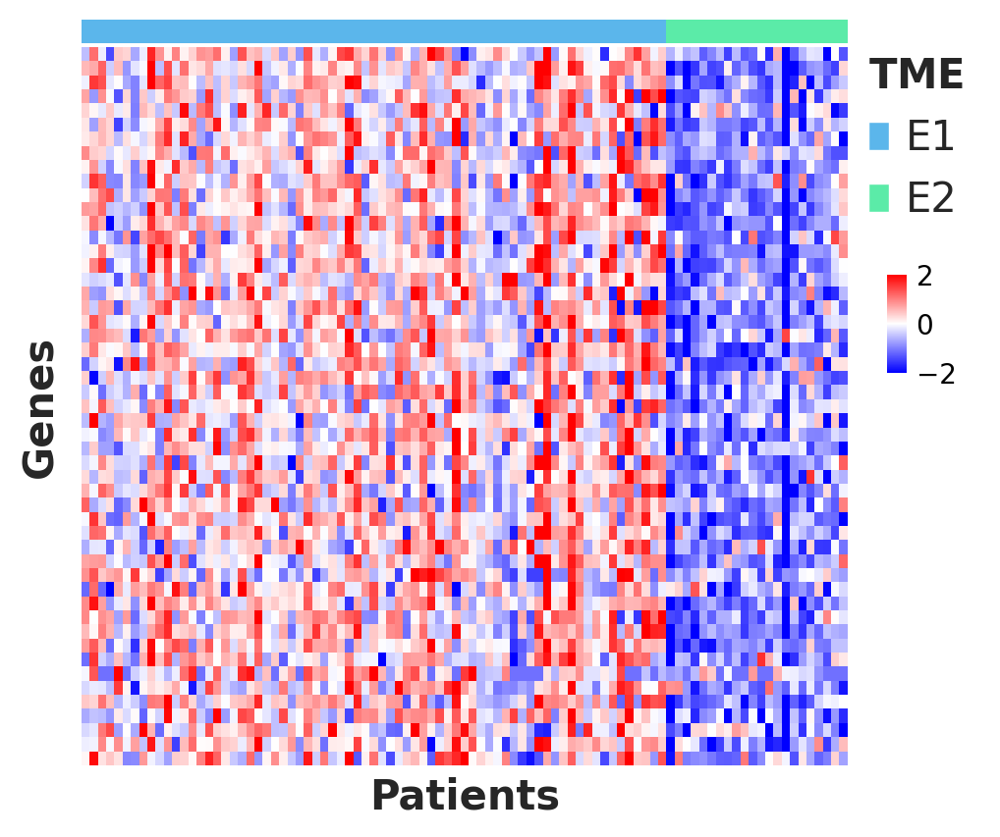

In [521]:
sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)
#plt.subplots_adjust(wspace = 0.2, hspace = 0.05)
widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.2, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{TME}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()

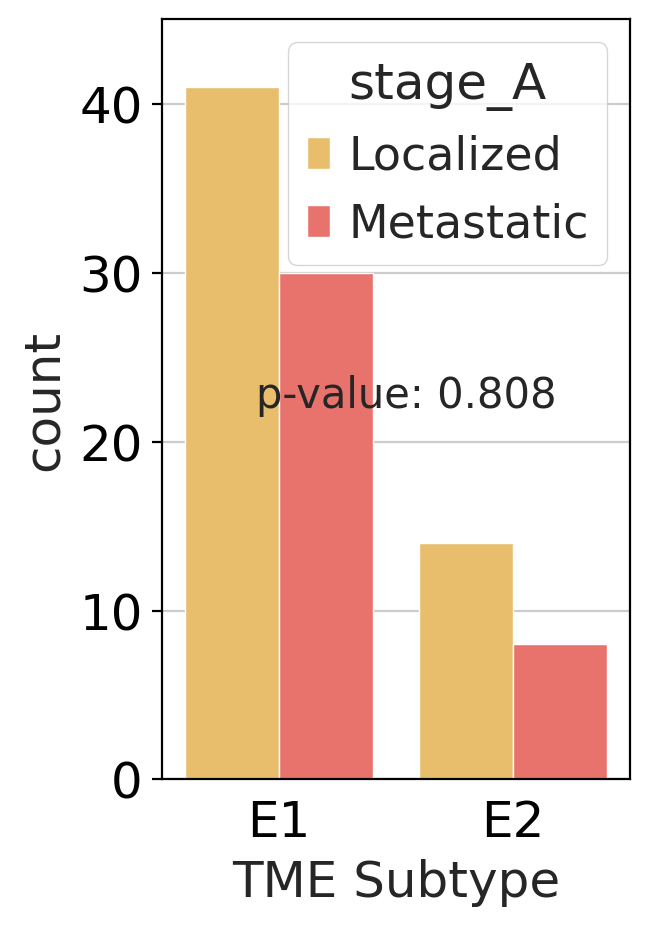

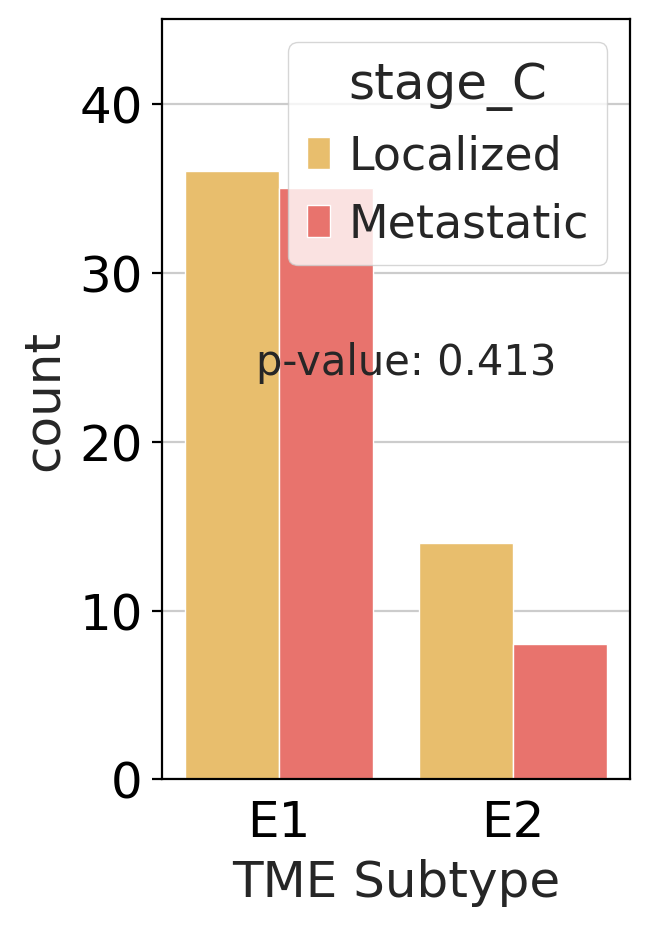

In [522]:

stage_palette = dict()
stage_palette['Localized']='#fcc558'
stage_palette['Metastatic']='#fc6058'

sc.settings.set_figure_params(dpi=100, figsize=(3,5), fontsize=18)
stage_a = SNU_annot.loc[:,['stage_A','TME Subtype']]
stage_c = SNU_annot.loc[:,['stage_C','TME Subtype']]
g = sns.countplot(x="TME Subtype",  hue="stage_A", data=stage_a, palette=stage_palette)
ct_table_ind=pd.crosstab(SNU_annot['TME Subtype'],SNU_annot['stage_A'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p = np.round(p,3)
plt.text(-0.1, 22, 'p-value: {}'.format(p), fontsize=15)
plt.ylim((0,45))
#plt.title('Stage_A')
plt.show()

g = sns.countplot(x="TME Subtype",  hue="stage_C", data=stage_c, palette=stage_palette)
ct_table_ind=pd.crosstab(SNU_annot['TME Subtype'],SNU_annot['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p = np.round(p,3)
plt.text(-0.1, 24, 'p-value: {}'.format(p), fontsize=15)
#plt.title('Stage_C')
plt.ylim((0,45))
plt.show()


Localized     36
Metastatic    35
Name: stage_C, dtype: int64
Localized     14
Metastatic     8
Name: stage_C, dtype: int64


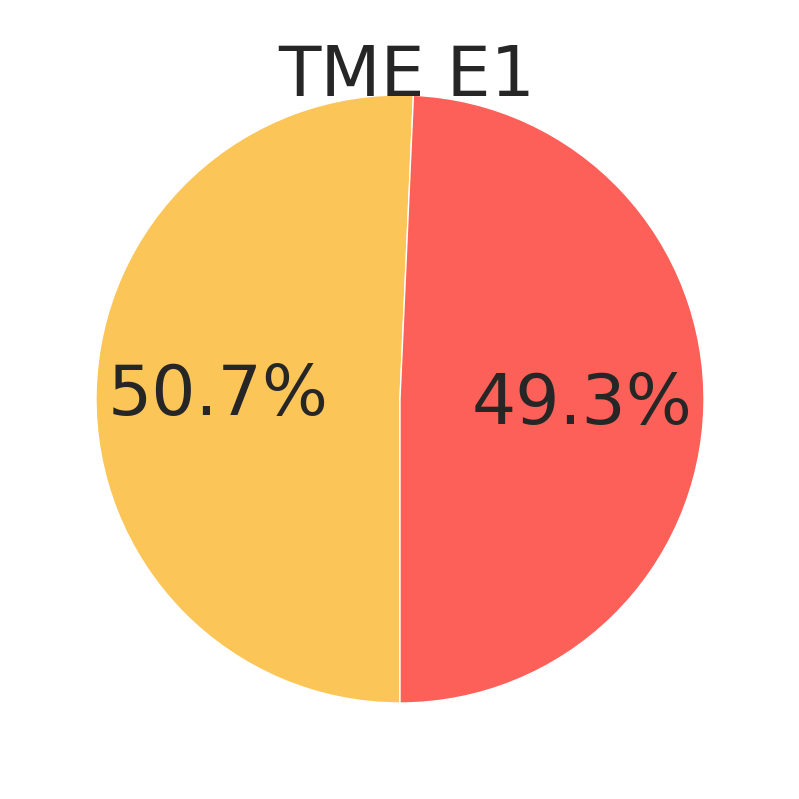

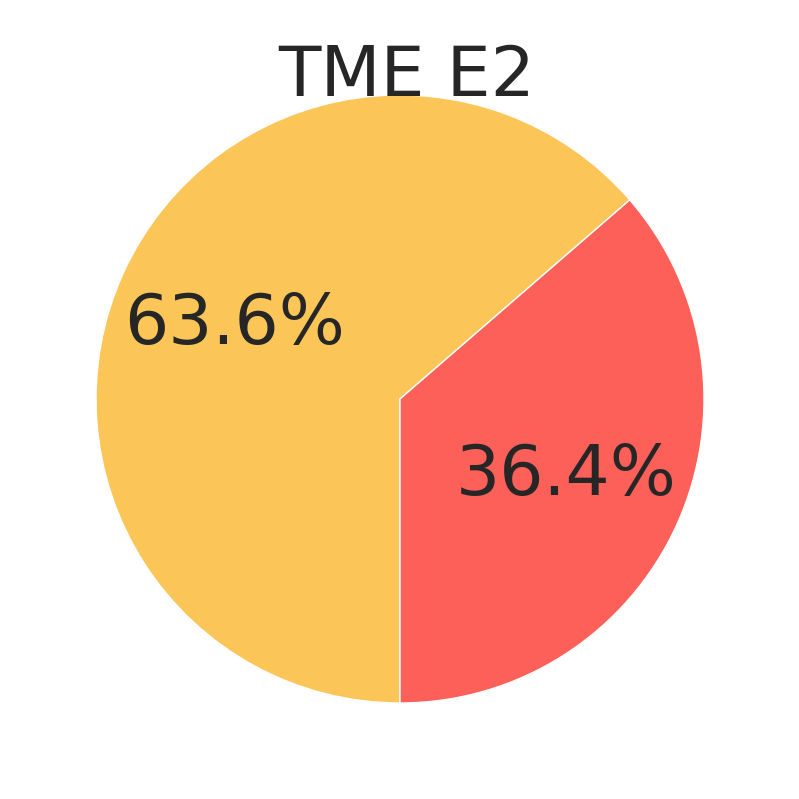

yes    23
no     12
Name: Mets_liver_C, dtype: int64
no     24
yes    11
Name: Mets_lung_C, dtype: int64
no     22
yes    12
Name: Mets_PS_C, dtype: int64


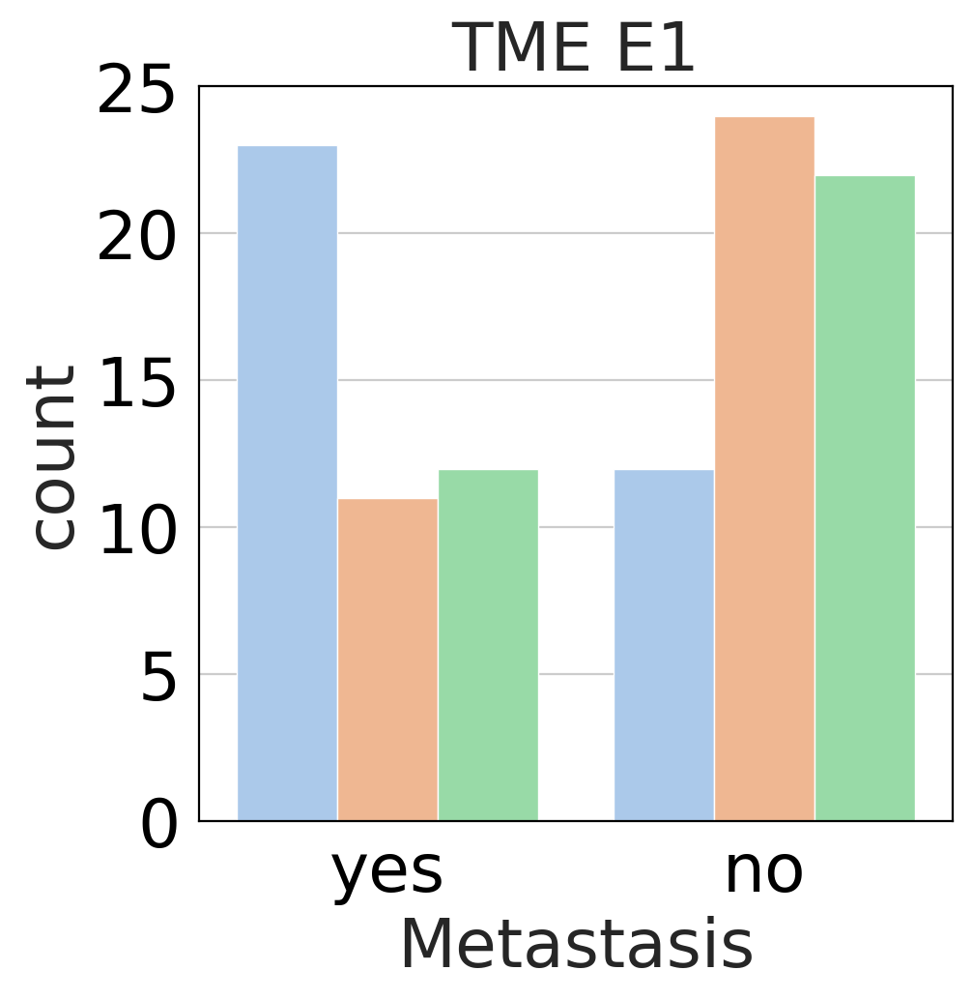

yes    4
no     4
Name: Mets_liver_C, dtype: int64
no     5
yes    3
Name: Mets_lung_C, dtype: int64
no     6
yes    2
Name: Mets_PS_C, dtype: int64


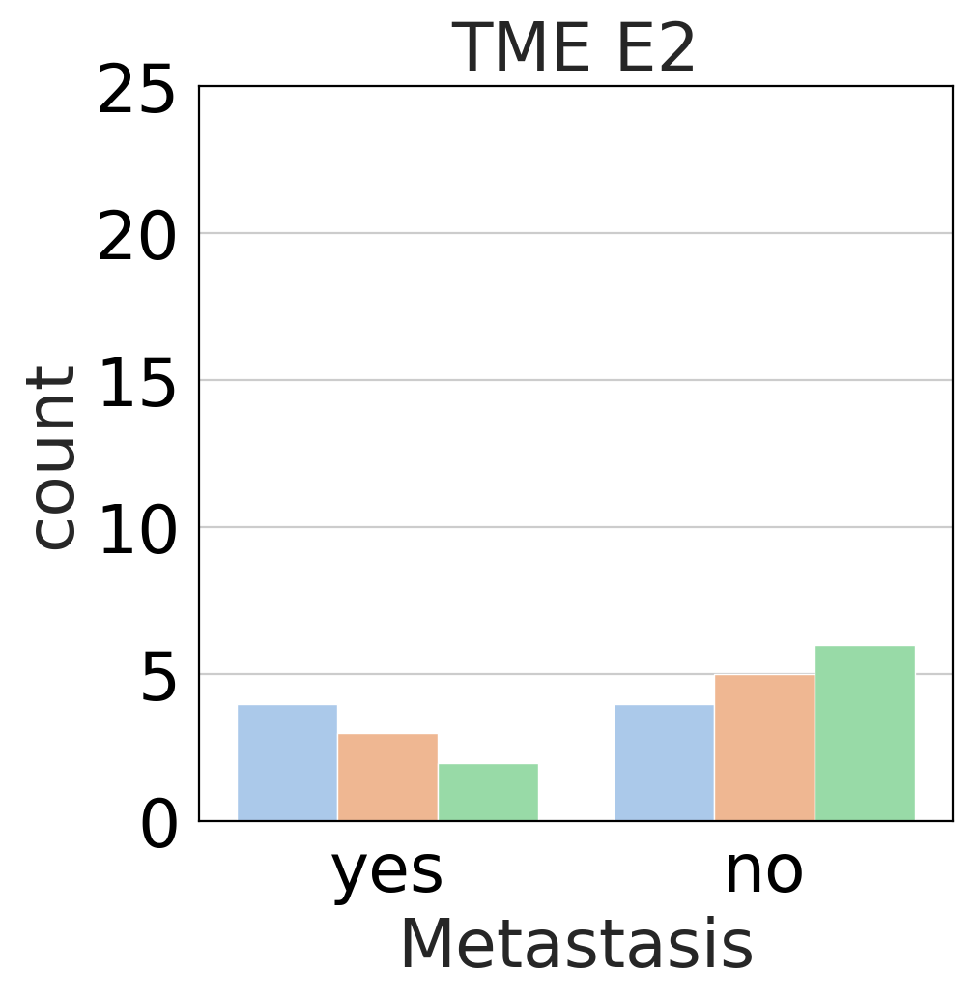

In [697]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=25)

mets_dict = dict()
mets_dict['Mets_liver_C']='Liver'
mets_dict['Mets_lung_C']='Lung'
mets_dict['Mets_PS_C']='Peritoneal'


m1 = SNU_annot['TME Subtype'] == 'E1'
m2 = SNU_annot['TME Subtype'] == 'E2'

with_stage_sel1 = SNU_annot[m1]
print(with_stage_sel1['stage_C'].value_counts())
with_stage_sel2 = SNU_annot[m2]
print(with_stage_sel2['stage_C'].value_counts())

stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)

plt.text(-0.4, 1,'TME E1')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.text(-0.4, 1,'TME E2')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
legend = g.get_legend()
legend.remove()
plt.title('TME E1')
plt.ylim((0,25))
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel', order=['yes','no'])
legend = g.get_legend()
legend.remove()
plt.title('TME E2')
plt.ylim((0,25))
plt.show()

# Bailey - TME

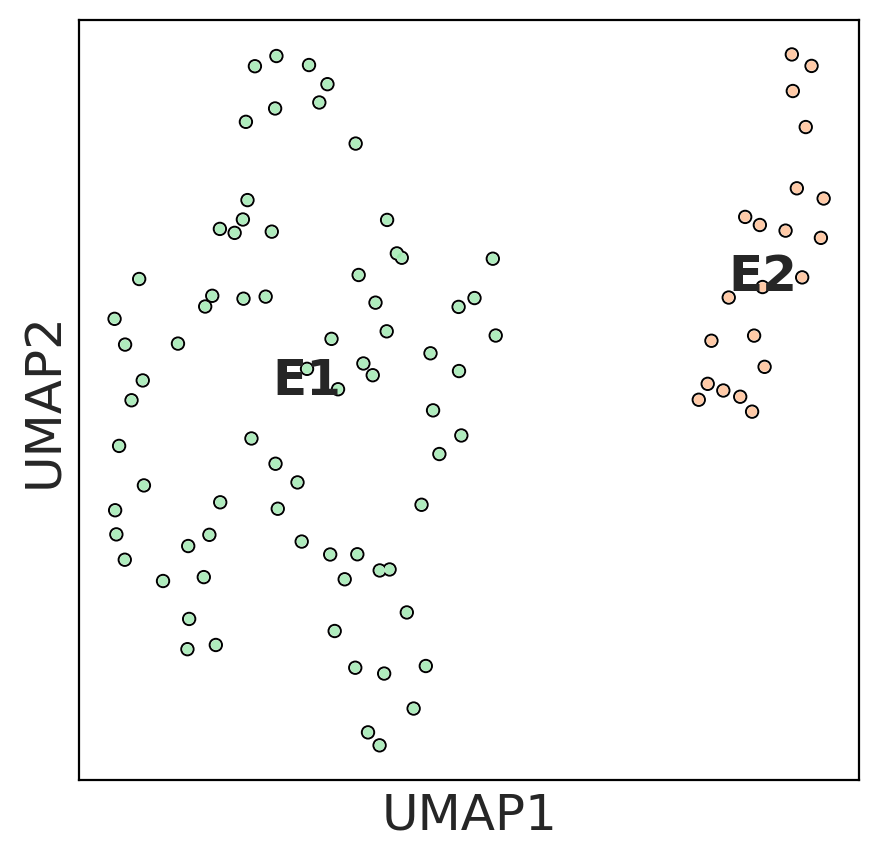

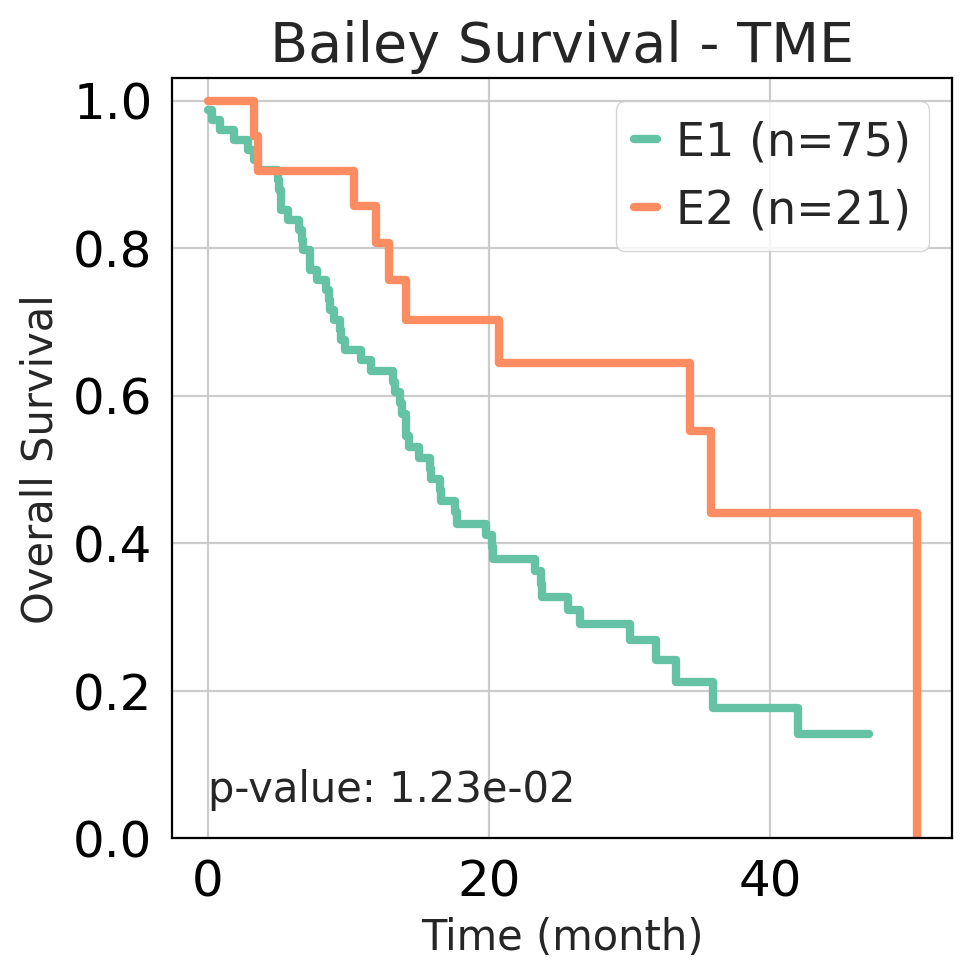

In [675]:
Bailey_adata_HVG = Bailey_adata[:,features]

sc.tl.pca(Bailey_adata_HVG, svd_solver='arpack', n_comps = 3)
sc.pp.neighbors(Bailey_adata_HVG, n_neighbors=6)

Bailey_adata_HVG.obs['TME Subtype'] = Bailey_annot['TME Subtype']
#print(mg_adata_bec_HVG.obs['leiden'].value_counts())

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(Bailey_adata_HVG)
sc.pl.umap(Bailey_adata_HVG, color=['TME Subtype'], s=50, wspace=0.4, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
df_clinical = Bailey_adata_HVG.obs.copy()
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
bailey_p = km_plot(df_info=df_clinical, category='TME Subtype', os='OS_F', event='OS_event', title='Bailey Survival - TME')

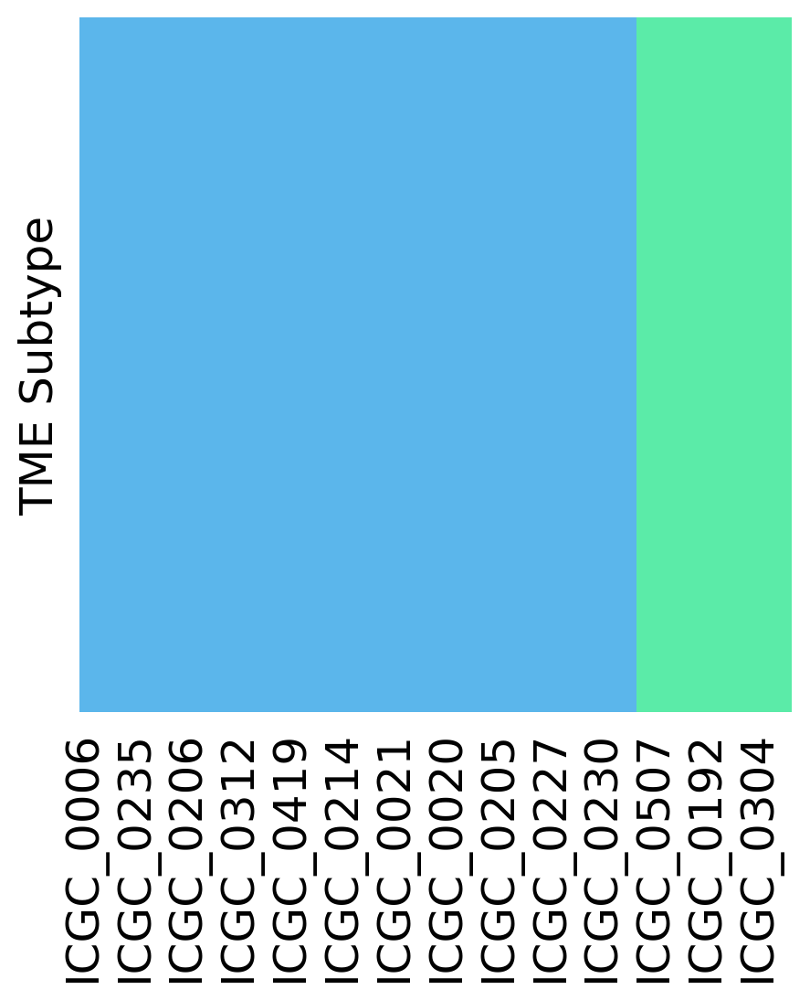

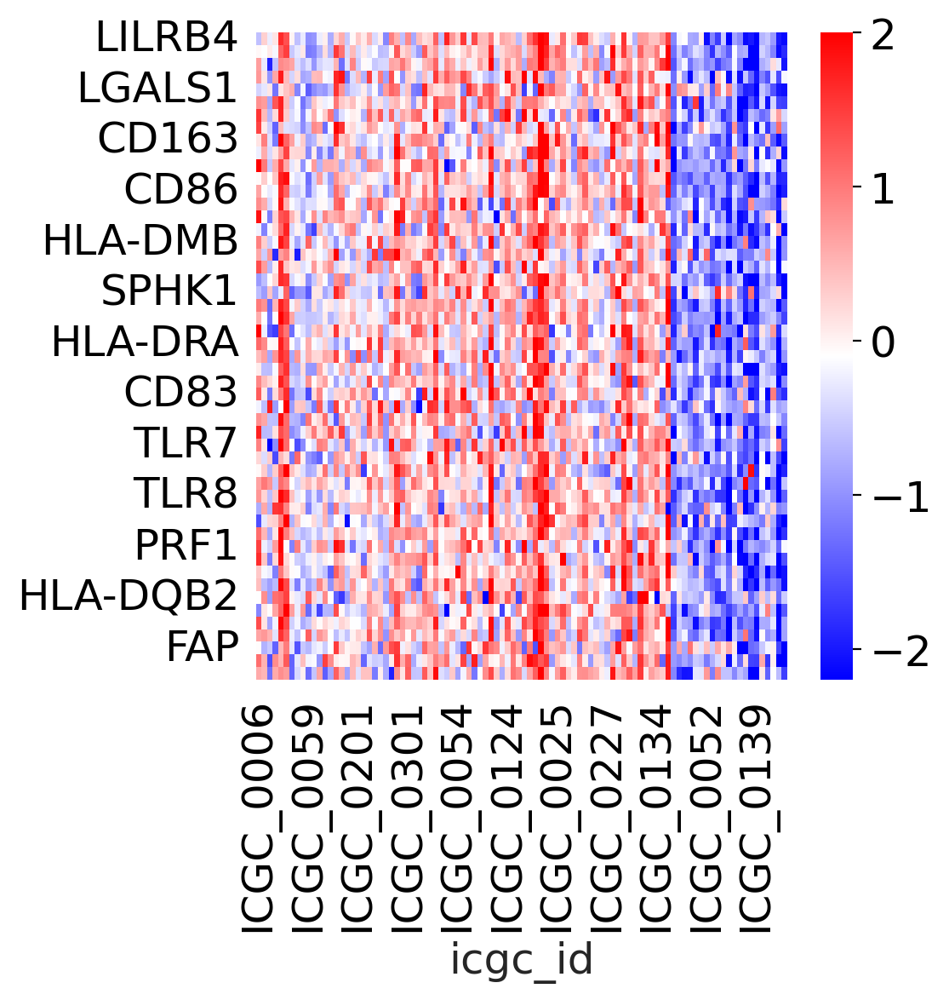

In [676]:
exp = Bailey_adata_HVG.to_df()
#annot = pd.read_csv('Bailey_TumorType.csv',index_col=0).sort_values(by='Tumor2Type_1st')
Bailey_annot = Bailey_annot.sort_values(by='TME Subtype')
Bailey_annot
order = list(Bailey_annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

Annot_lut = dict()
Annot_int_map = dict(zip(Bailey_annot['TME Subtype'].unique(),range(Bailey_annot['TME Subtype'].nunique())))
Annot_lut['E1']='#5bb6eb'
Annot_lut['E2']='#5beba8'
Annot = Bailey_annot['TME Subtype'].map(Annot_int_map).to_frame('TME Subtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

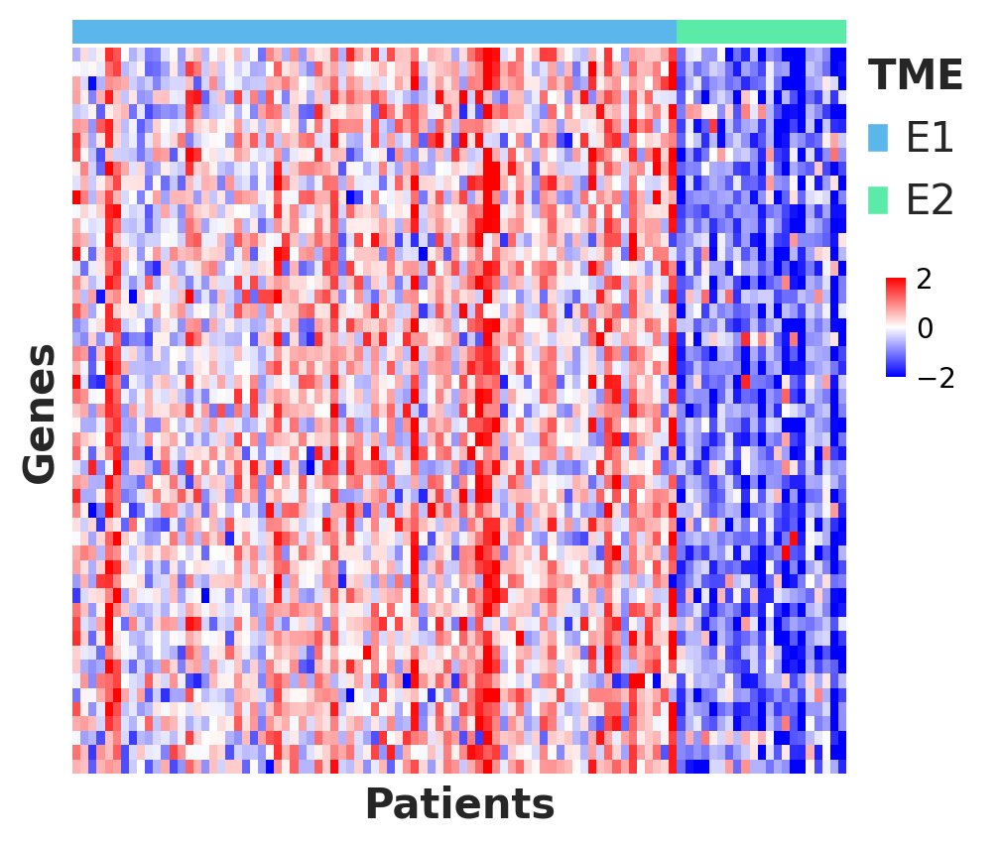

In [680]:
sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)
widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.2, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{TME}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()

# TCGA - TME

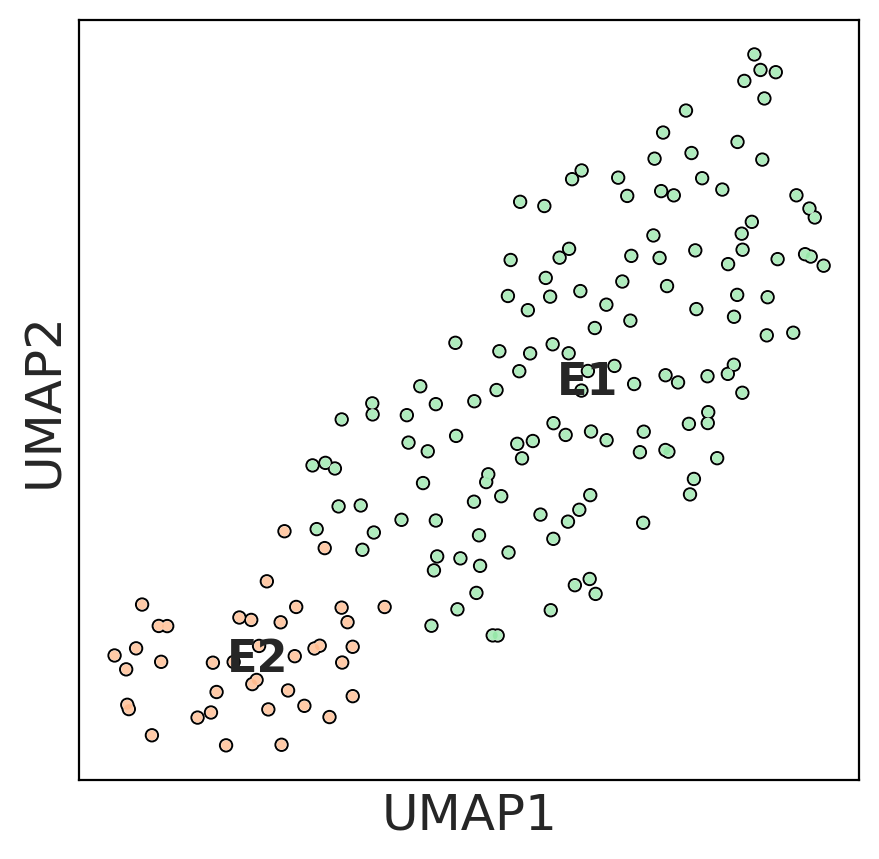

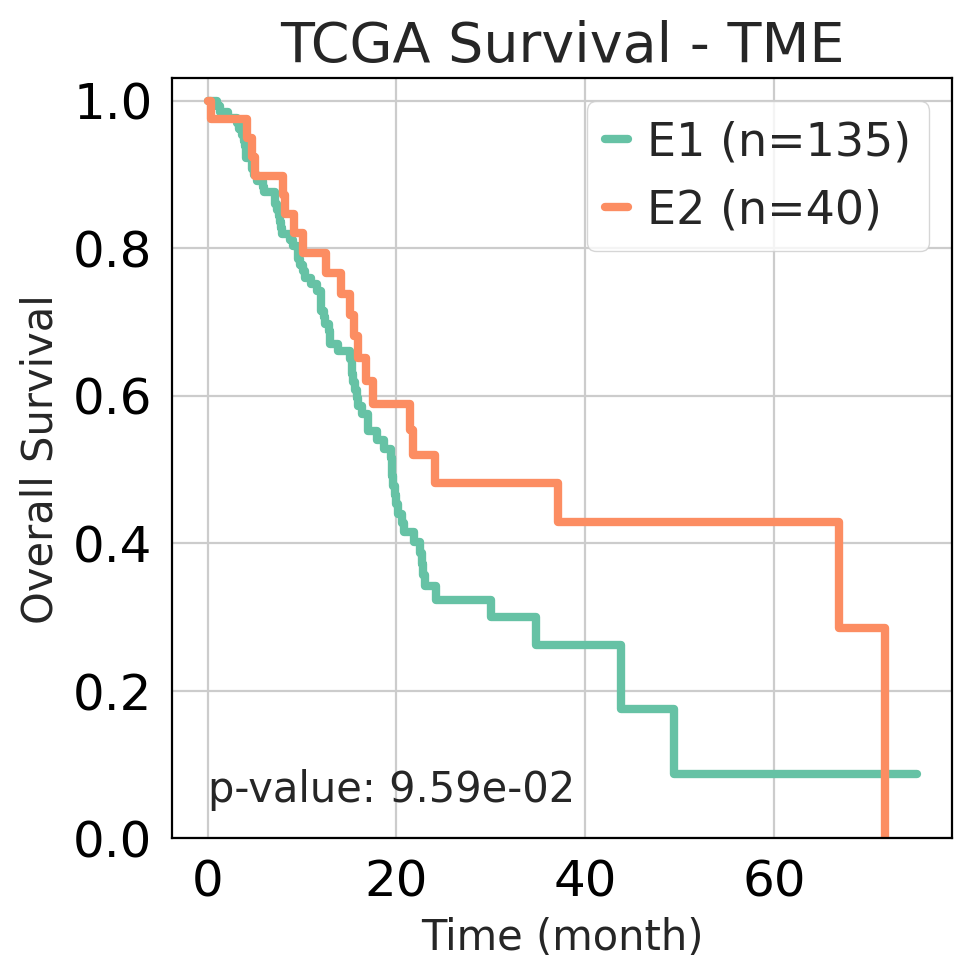

In [681]:
TCGA_adata_HVG = TCGA_adata[:,features]
sc.tl.pca(TCGA_adata_HVG, svd_solver='arpack', n_comps = 8)
sc.pp.neighbors(TCGA_adata_HVG, n_neighbors=10)
TCGA_adata_HVG.obs['TME Subtype']=TCGA_annot['TME Subtype']

sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
sc.tl.umap(TCGA_adata_HVG)
sc.pl.umap(TCGA_adata_HVG, color=['TME Subtype'], s=50, wspace=0.4, legend_fontsize = 16, title='', palette = umap_color, add_outline=True, outline_width=(0.2, 0.03)
          ,legend_loc='on data')
df_clinical = TCGA_adata_HVG.obs.copy()
sc.settings.set_figure_params(figsize=(6, 6), facecolor='white')
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
tcga_p = km_plot(df_info=df_clinical, category='TME Subtype', os='OS_F', event='OS_event', title='TCGA Survival - TME')

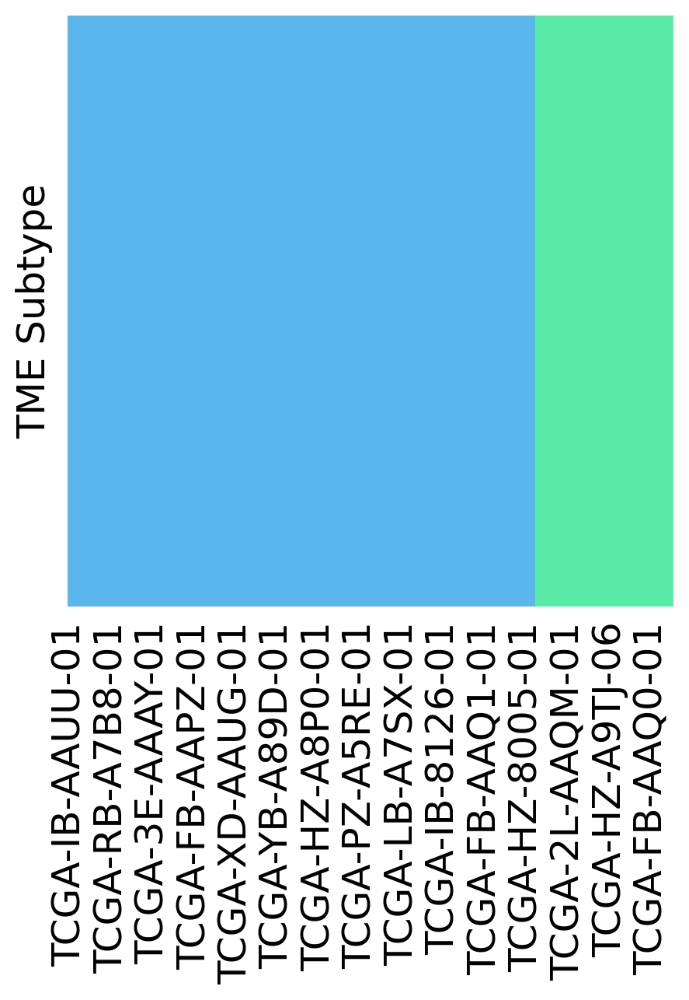

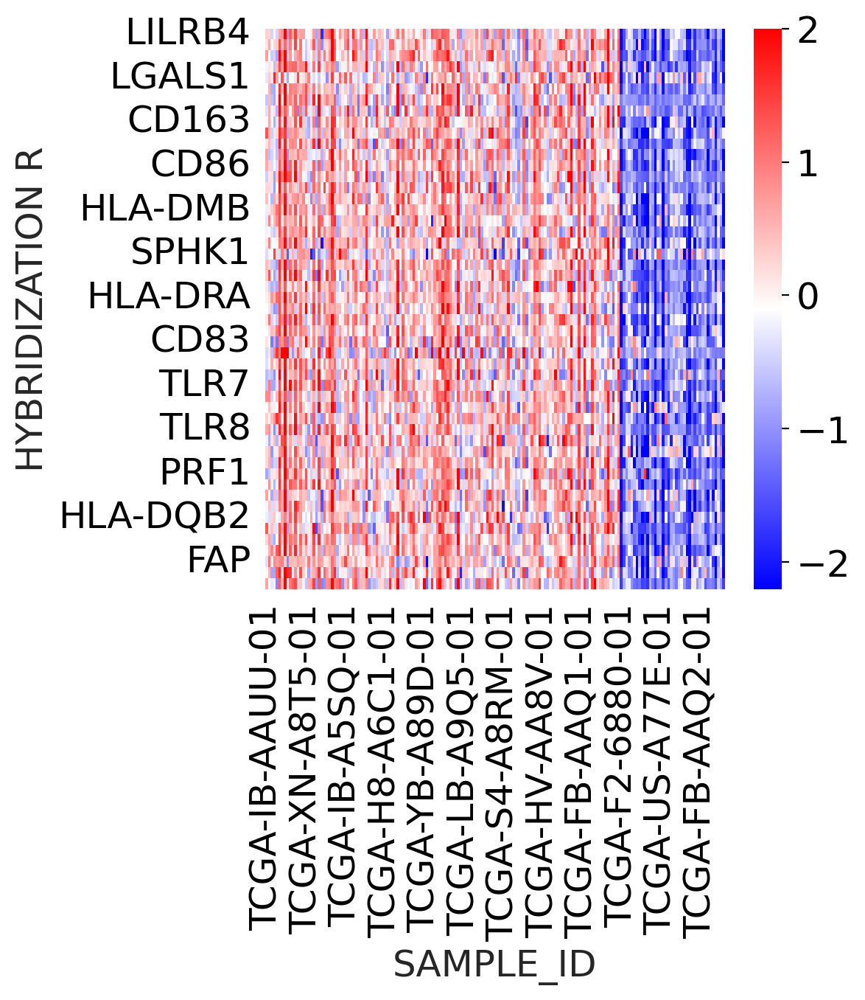

In [682]:
exp = TCGA_adata_HVG.to_df()
#annot = pd.read_csv('Bailey_TumorType.csv',index_col=0).sort_values(by='Tumor2Type_1st')
#TCGA_annot = TCGA_annot.loc[m,:]
TCGA_annot = TCGA_annot.sort_values(by='TME Subtype')
TCGA_annot
order = list(TCGA_annot.index)
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T


Annot_lut = dict()
Annot_int_map = dict(zip(TCGA_annot['TME Subtype'].unique(),range(TCGA_annot['TME Subtype'].nunique())))
Annot_lut['E1']='#5bb6eb'
Annot_lut['E2']='#5beba8'
Annot = TCGA_annot['TME Subtype'].map(Annot_int_map).to_frame('TME Subtype').T.astype(float)
Annot
ax=sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False)
plt.show()
sns.heatmap(scaled_df, cmap='bwr', vmin=2, vmax=-2)
plt.show()

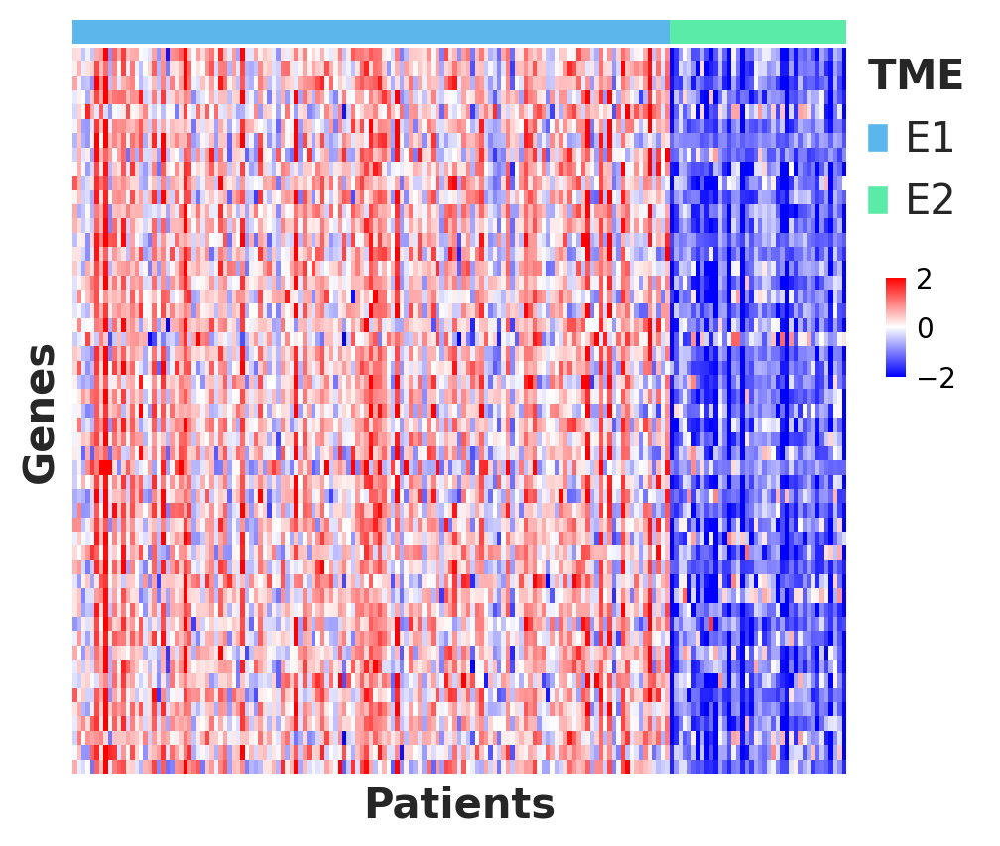

In [683]:

sc.settings.set_figure_params(fontsize=10)
fig = plt.figure(figsize=(5, 5), dpi= 100)
widths = [1]
heights = [1,30]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.01, wspace=0.15, width_ratios=widths, height_ratios=heights)

ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(Annot, cmap=list(Annot_lut.values()), cbar=False, ax=ax0)
handles = [mpatches.Patch(facecolor=Annot_lut[name]) for name in Annot_lut]
ax0_legend = ax0.legend(handles, Annot_lut, bbox_to_anchor=(1.2, 1), frameon=False, 
                              fontsize=15, markerscale=4)
ax0_legend.set_title('$\\bf{TME}$',prop={'size':15})
ax0_legend._legend_box.align = "left"
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_yticklabels('')
ax0.margins(0)

cbar_ax = fig.add_axes([1.0, 0.55, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax1 = fig.add_subplot(gs[1, 0])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax1, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax1.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax1.set_xticks([])
ax1.set_xlabel('Patients', fontsize=15, fontdict=dict(weight='bold'))
ax1.set_ylabel('Genes', fontsize=15, fontdict=dict(weight='bold'))
plt.show()

# Tumor/TME Relation

TME Type    E1  E2
Tumor Type        
C1          37  17
C2          34   5
0.06542218679825419


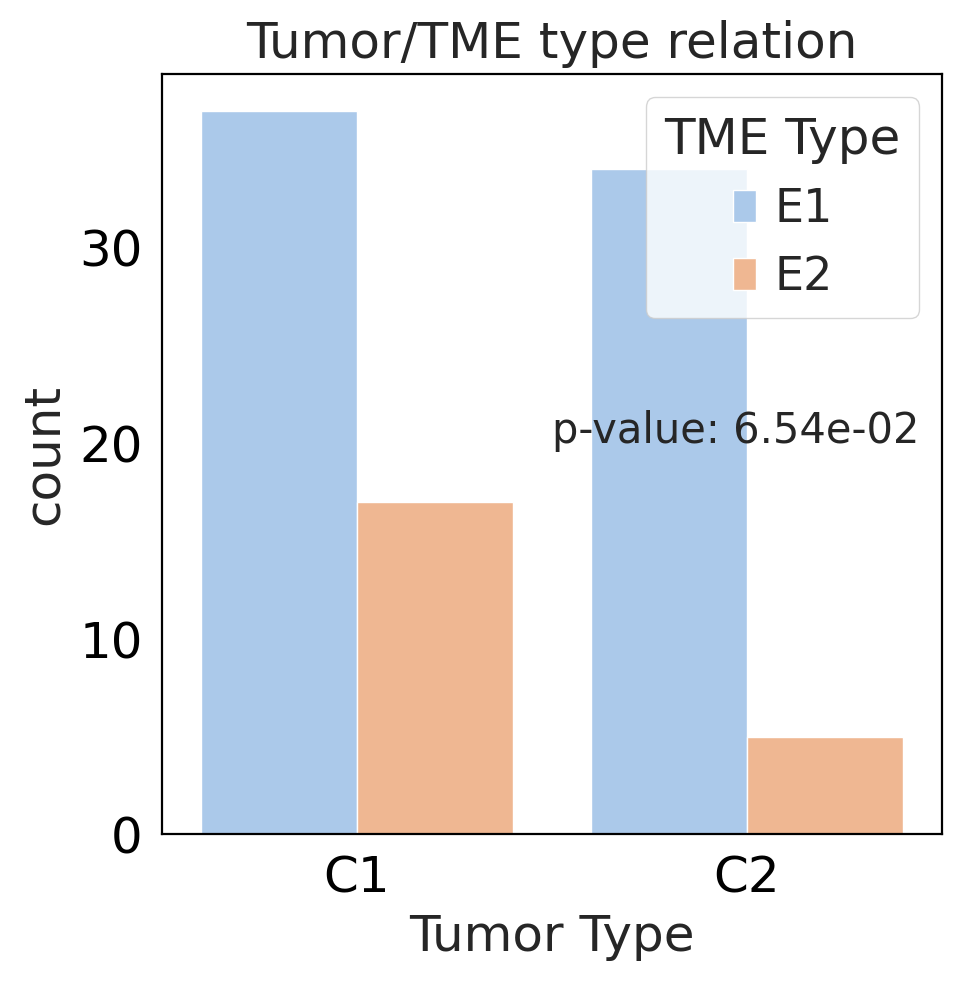

In [562]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
tmp = SNU_annot.loc[:,['Tumor Subtype','TME Subtype']]
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(0.5, 20, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('Tumor/TME type relation')
plt.grid(False)
plt.show()


TME Type    E1  E2
Tumor Type        
C1          47  18
C2          28   3
0.08318803833006078


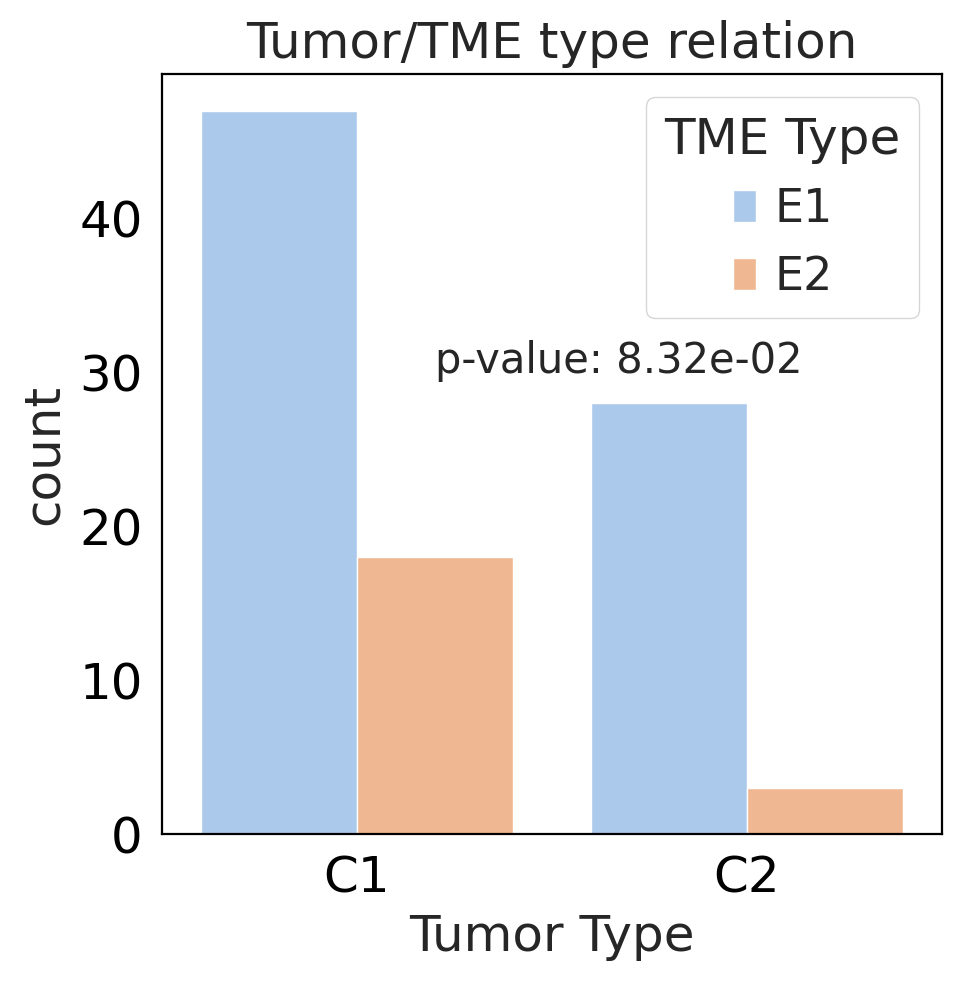

In [563]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
tmp = Bailey_annot.loc[:,['Tumor Subtype','TME Subtype']]
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(0.2, 30, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('Tumor/TME type relation')
plt.grid(False)
plt.show()


TME Type     E1  E2
Tumor Type         
C1          107  32
C2           28   8
1.0


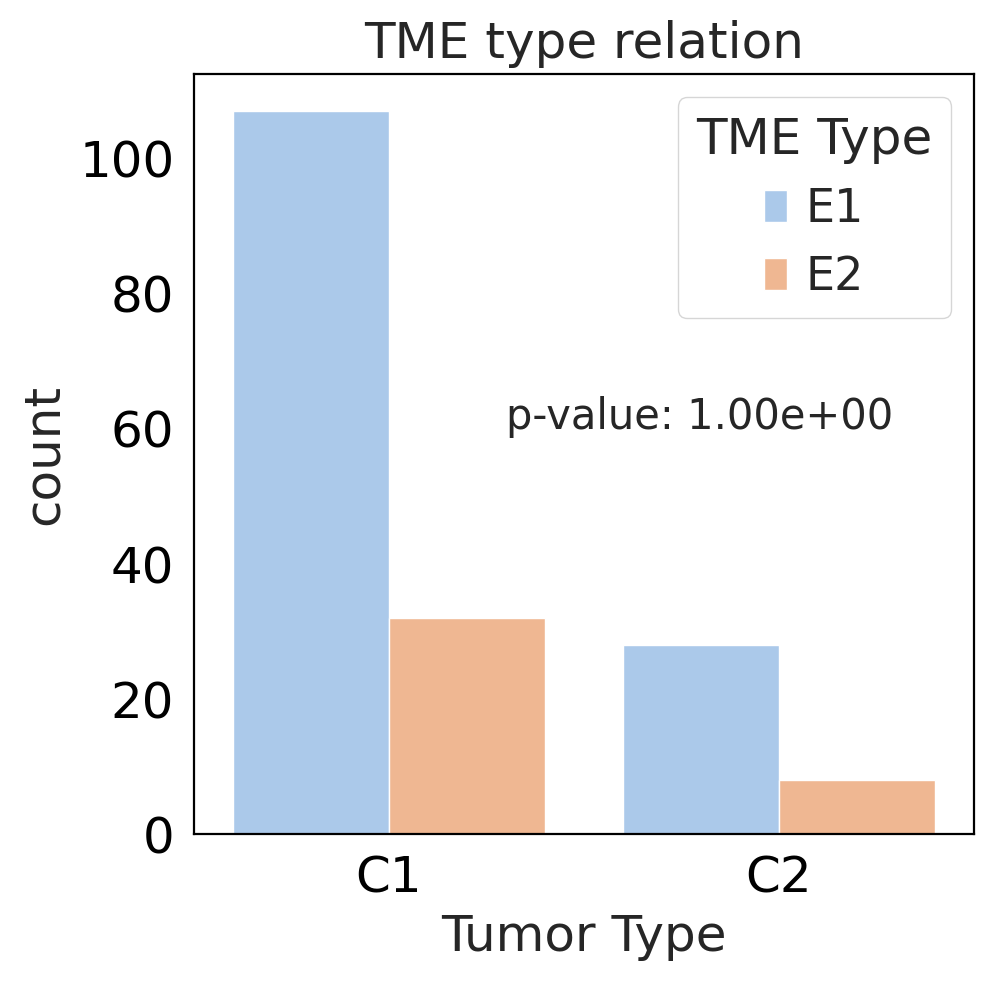

In [564]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
tmp = TCGA_annot.loc[:,['Tumor Subtype','TME Subtype']]
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(0.3, 60, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('TME type relation')
plt.grid(False)
plt.show()


# Final Subtype

C1-E1    37
C2-E1    34
C1-E2    17
C2-E2     5
Name: Final Subtype, dtype: int64
C1-E1    107
C1-E2     32
C2-E1     28
C2-E2      8
Name: Final Subtype, dtype: int64
C1-E1    47
C2-E1    28
C1-E2    18
C2-E2     3
Name: Final Subtype, dtype: int64


Text(0.5, 1.0, 'PDAC Final Subtype')

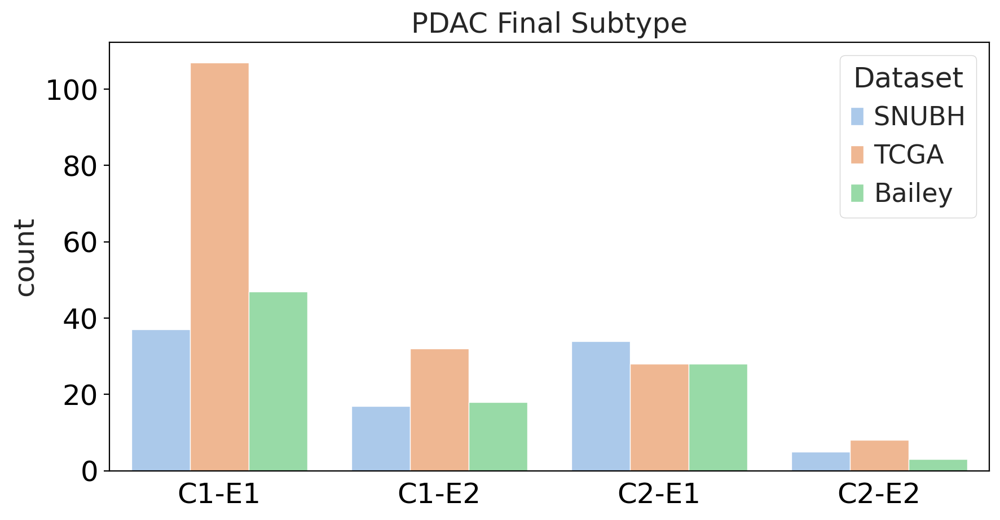

In [525]:
sc.settings.set_figure_params(dpi=100, figsize=(10,5), fontsize=18)
SNU_annot['Dataset']='SNUBH'
print(SNU_annot['Final Subtype'].value_counts())
TCGA_annot['Dataset']='TCGA'
print(TCGA_annot['Final Subtype'].value_counts())
Bailey_annot['Dataset']='Bailey'
print(Bailey_annot['Final Subtype'].value_counts())

mg_annot = pd.concat([SNU_annot, TCGA_annot, Bailey_annot],axis=0)
mg_annot = mg_annot.loc[:,['Final Subtype','Dataset']]

sns.countplot(x='Final Subtype', hue='Dataset', order=['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2'], data=mg_annot, palette='pastel')
plt.grid(False)
plt.xlabel('')
plt.title('PDAC Final Subtype')

['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']


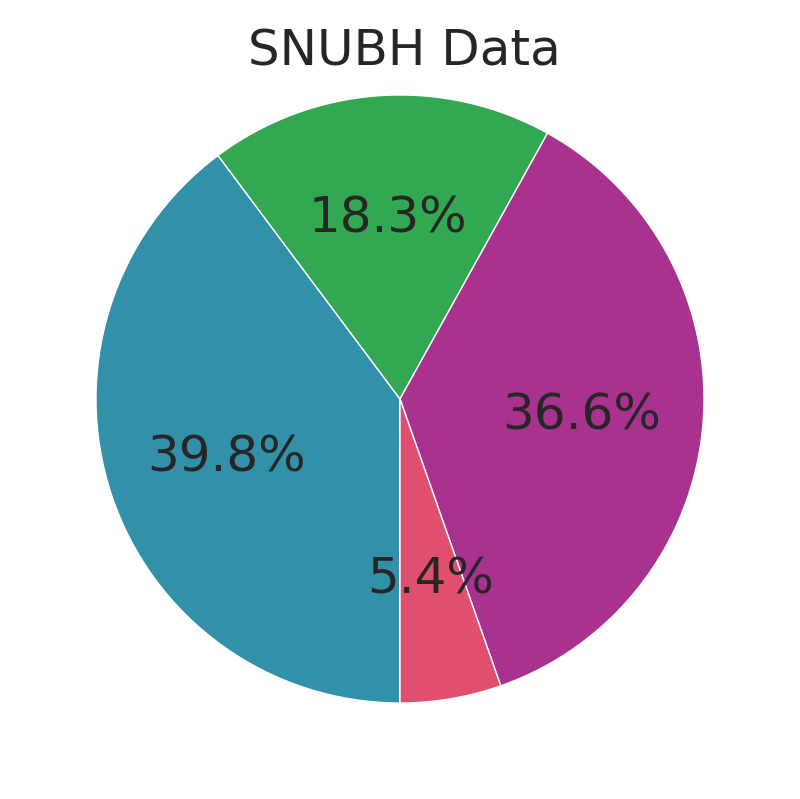

['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']


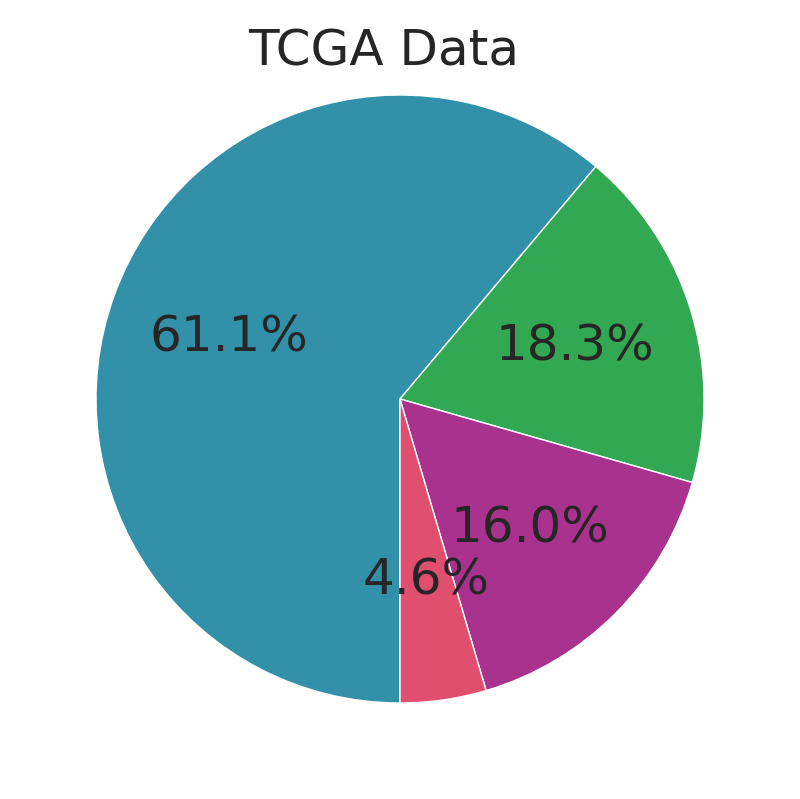

['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']


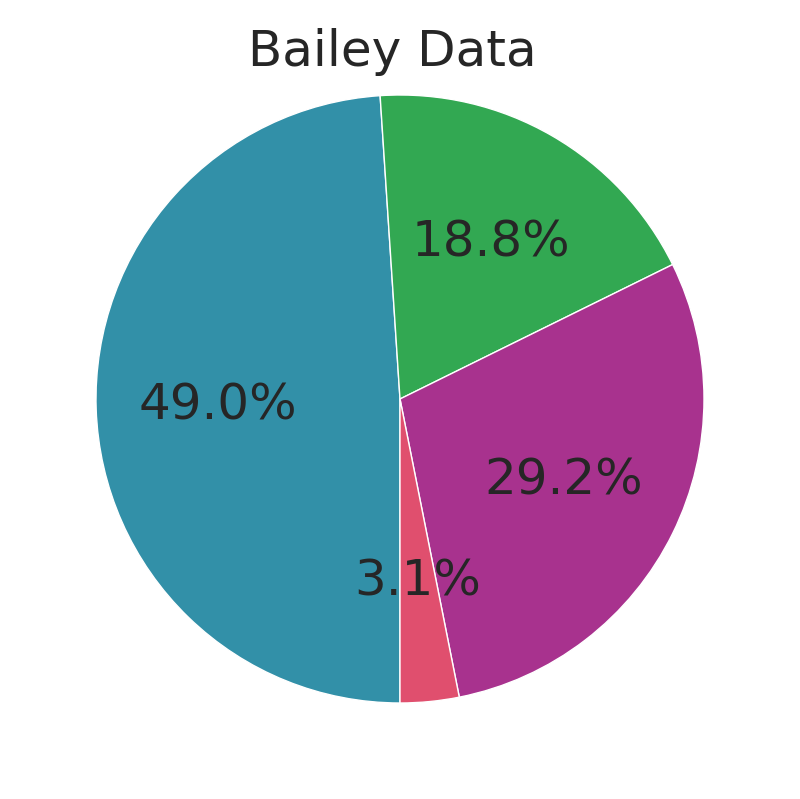

['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']


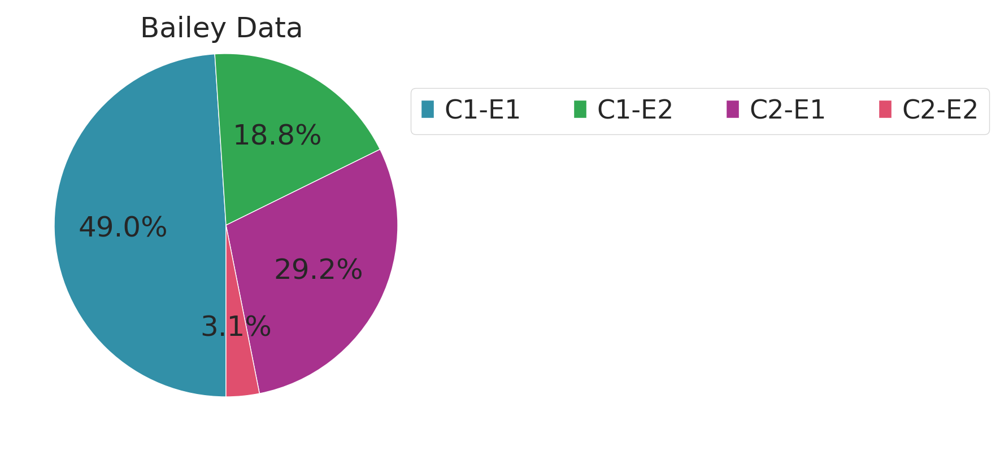

In [533]:
subtype = SNU_annot['Final Subtype'].value_counts().to_frame('Final Subtype')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['Final Subtype'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
#plt.title('SNUBH Data')
plt.text(-0.5,1.1,'SNUBH Data')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = TCGA_annot['Final Subtype'].value_counts().to_frame('Final Subtype')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['Final Subtype'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.text(-0.5,1.1,'TCGA Data')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = Bailey_annot['Final Subtype'].value_counts().to_frame('Final Subtype')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['Final Subtype'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.text(-0.5,1.1,'Bailey Data')
#plt.legend(bbox_to_anchor=(0.9, .85),ncol=4)
plt.show()

subtype = Bailey_annot['Final Subtype'].value_counts().to_frame('Final Subtype')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['Final Subtype'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.text(-0.5,1.1,'Bailey Data')
plt.legend(bbox_to_anchor=(0.9, .85),ncol=4)
plt.show()

# SNUBH - Final type

C1-E1
            stage
Localized      23
Metastatic     14


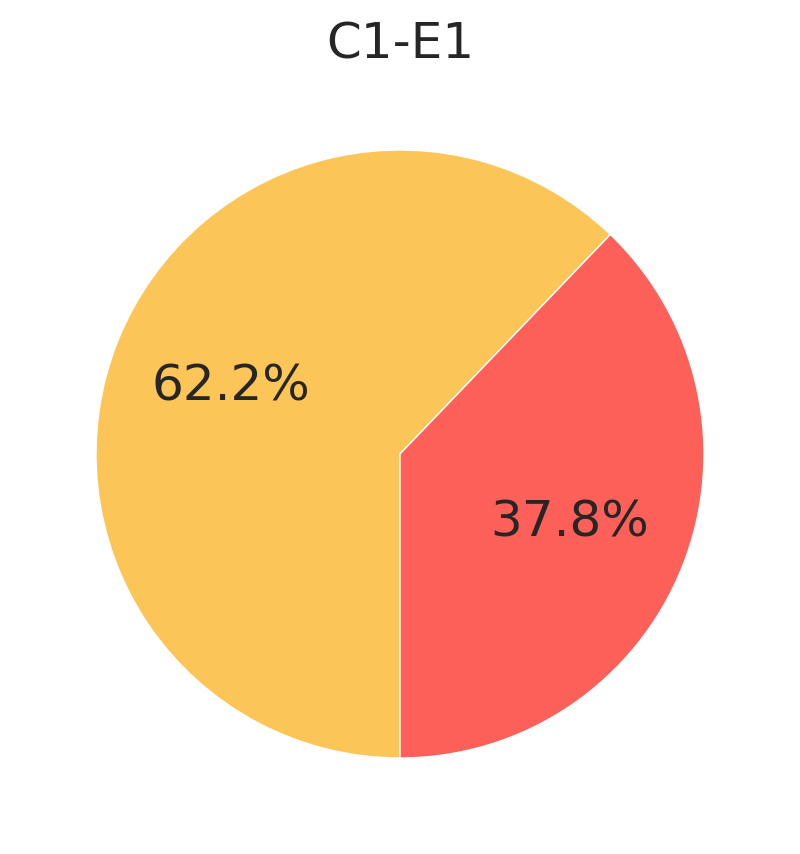

C1-E2
            stage
Localized      12
Metastatic      5


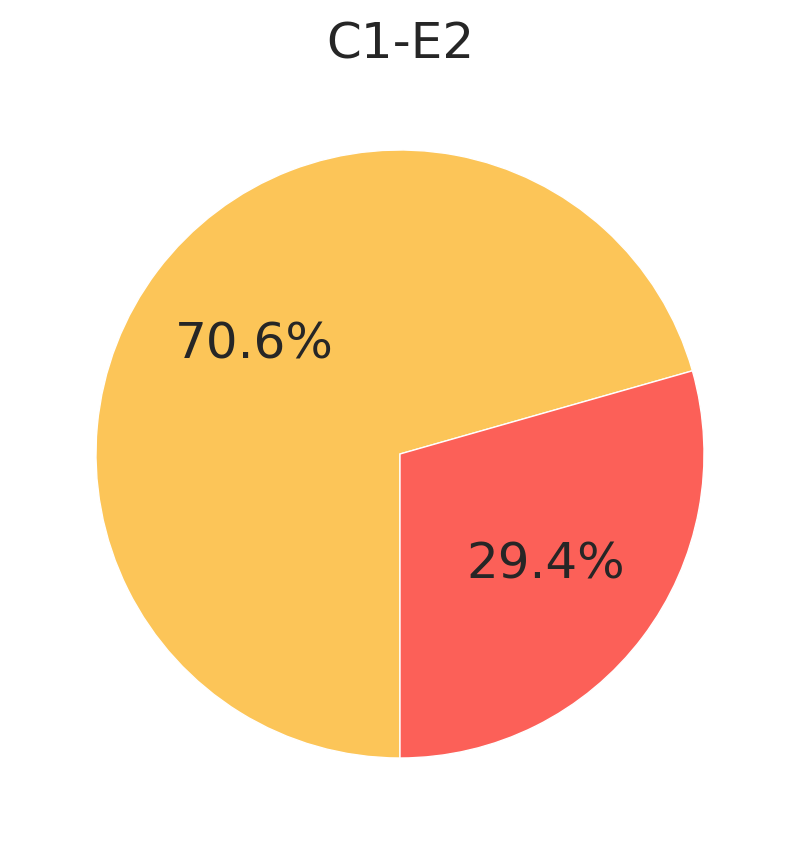

C2-E1
            stage
Metastatic     21
Localized      13


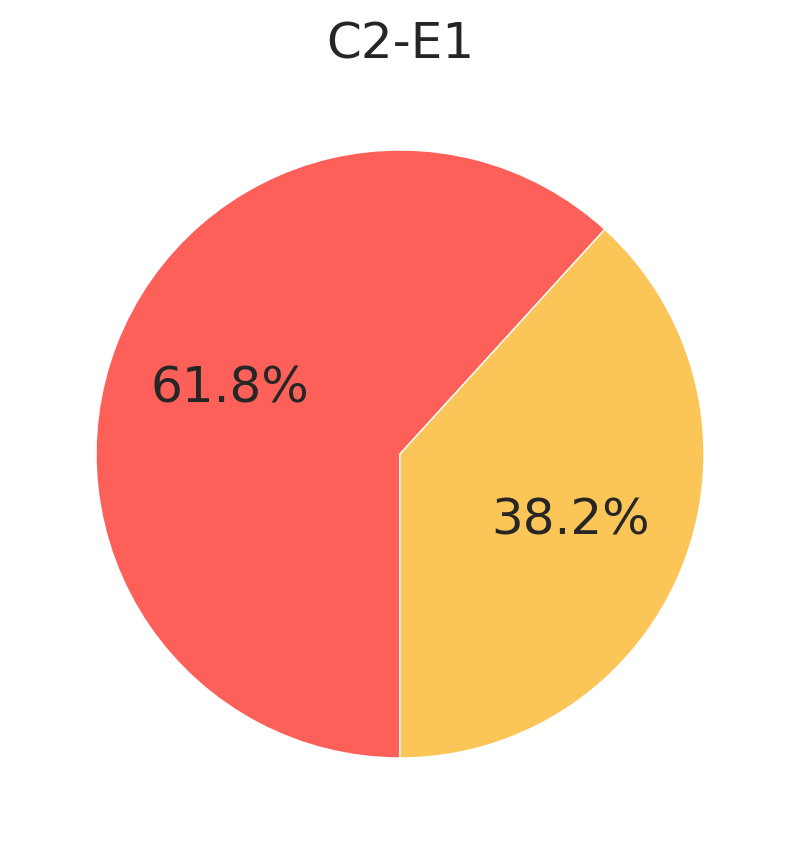

C2-E2
            stage
Metastatic      3
Localized       2


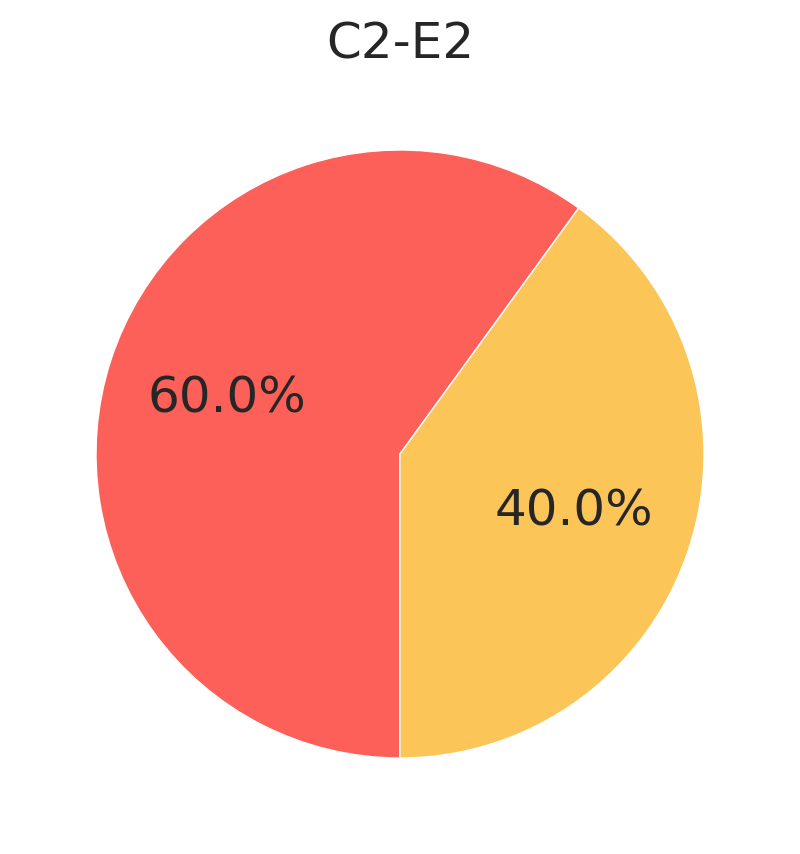

In [537]:
with_stage = SNU_annot.copy()

m1 = with_stage['Final Subtype'] == 'C1-E1'
m2 = with_stage['Final Subtype'] == 'C1-E2'
m3 = with_stage['Final Subtype'] == 'C2-E1'
m4 = with_stage['Final Subtype'] == 'C2-E2'

with_stage_sel1 = with_stage[m1]
with_stage_sel2 = with_stage[m2]
with_stage_sel3 = with_stage[m3]
with_stage_sel4 = with_stage[m4]


stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
print('C1-E1')
print(stage)
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('C1-E1')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
print('C1-E2')
print(stage)
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('C1-E2')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel3['stage_C'].value_counts().to_frame('stage')
print('C2-E1')
print(stage)
stage = stage/with_stage_sel3['stage_C'].value_counts().sum() *100
colors =['#fc6058','#fcc558',] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('C2-E1')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel4['stage_C'].value_counts().to_frame('stage')
print('C2-E2')
print(stage)
stage = stage/with_stage_sel4['stage_C'].value_counts().sum() *100
colors =['#fc6058','#fcc558',] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
#plt.title('C2-E2')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

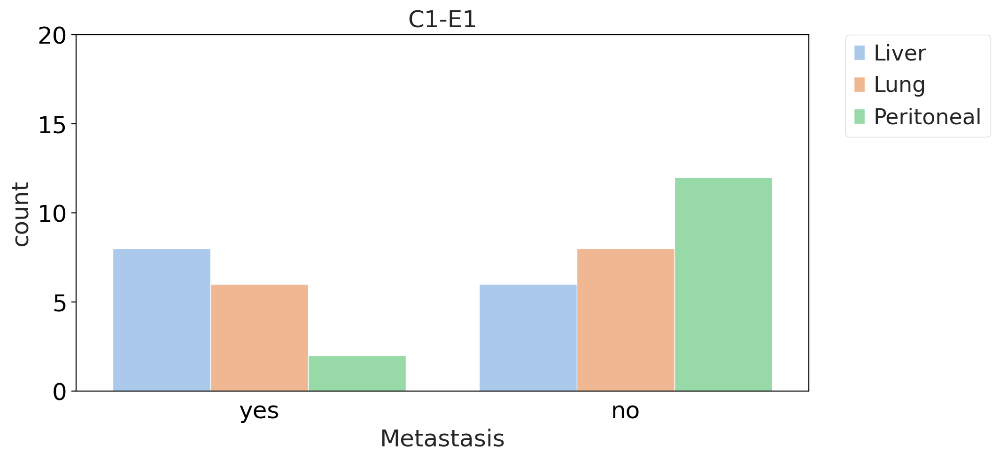

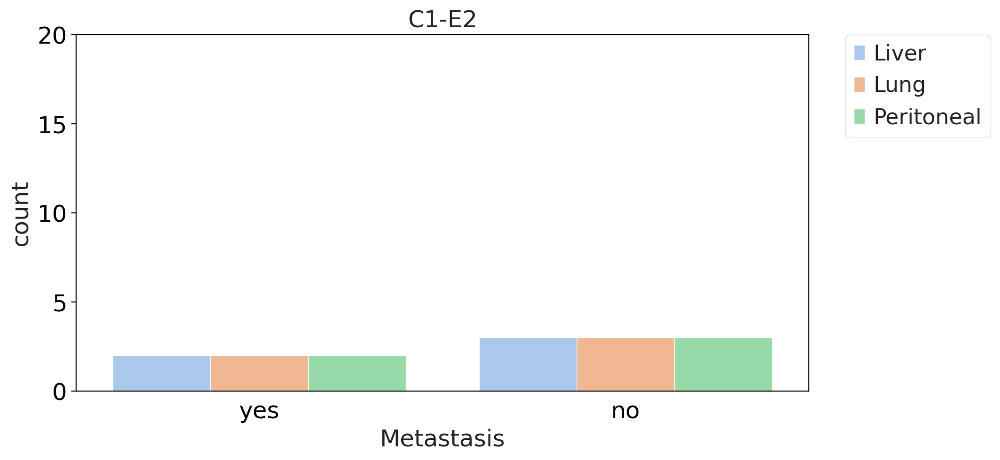

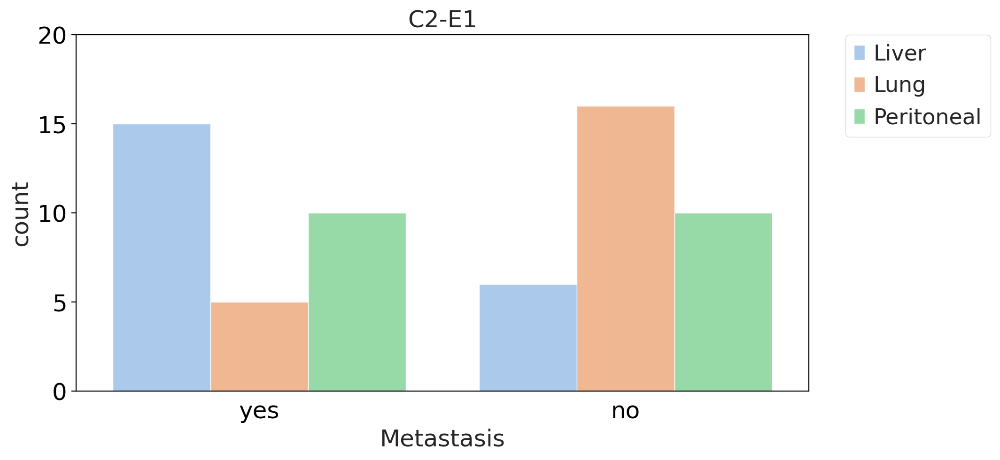

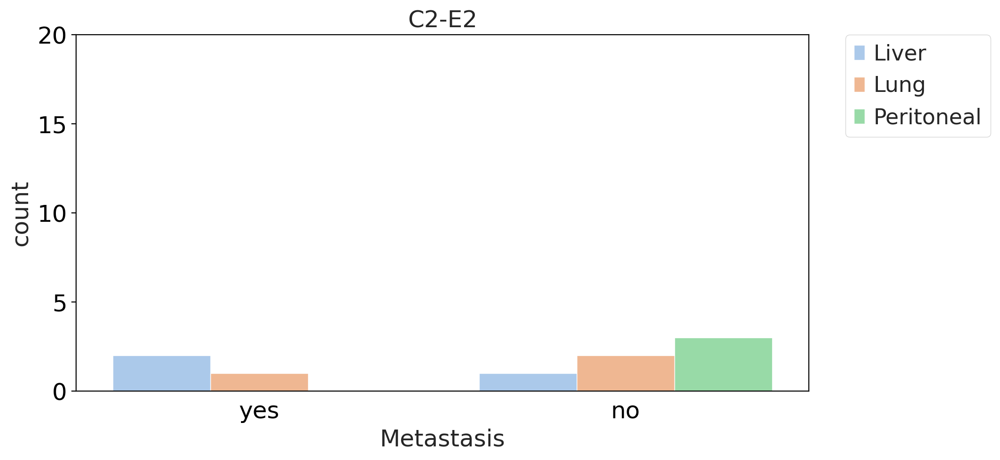

In [536]:

met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('C1-E1')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('C1-E2')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel3.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('C2-E1')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel4.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('C2-E2')
plt.ylim((0,20))
plt.grid(False)
plt.show()

In [598]:
features = list(table_genes['Gene'])

In [323]:
final_lut = dict()
final_lut['C1-E1']='#3290a8'
final_lut['C1-E2']='#32a852'
final_lut['C2-E1']='#a8328e'
final_lut['C2-E2']='#e04f6e'


tumor_lut = dict()
tumor_lut['C1']='#fc6058'
tumor_lut['C2']='#fcc558'

tme_lut = dict()
tme_lut['E1']='#5bb6eb'
tme_lut['E2']='#5beba8'

genetype_lut = dict()
genetype_lut['Tumor_Pos']='#93c4f5'
genetype_lut['Tumor_Neg']='#f59393'
genetype_lut['TME_Neg']='#f5c693'

In [324]:
annotation['Bailey P/S']

Snubh_TB
21-T00054_FT-01    Pancreatic Progenitor
21-T00875_FT-01                 Squamous
21-T01039_FT-01    Pancreatic Progenitor
21-T00511_FT-01    Pancreatic Progenitor
19-T00776_FO-01    Pancreatic Progenitor
                           ...          
18-02904_FO-01                  Squamous
20-T00360_FO-01                 Squamous
19-T00668_FO-01                 Squamous
21-T00346_FT-01    Pancreatic Progenitor
19-T00201_FO-01                 Squamous
Name: Bailey P/S, Length: 93, dtype: category
Categories (2, object): ['Pancreatic Progenitor', 'Squamous']

[]

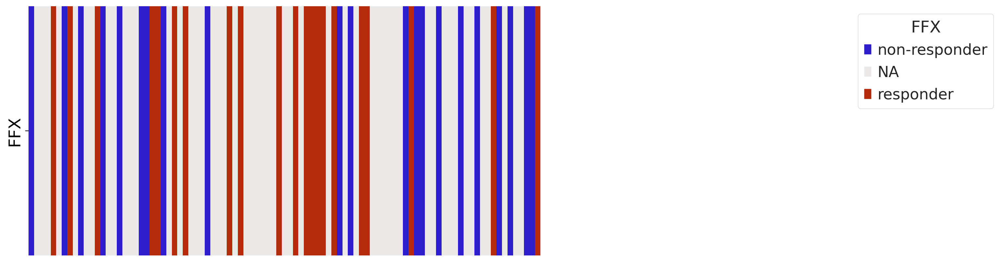

In [325]:
annotation = SNU_annot.sort_values(by='Final Subtype')
annotation['Bailey_Mixed'] = annotation['Bailey P/S'].astype(str)+'-'+annotation['Bailey A/I'].astype(str)

order = list(annotation.index)
snu_obs = SNU_annot.copy().loc[order,:]
snu_obs['CTx_response_FFX'] = snu_obs['CTx_response_FFX'].cat.add_categories('NA')
snu_obs['CTx_response_FFX'] = snu_obs['CTx_response_FFX'].fillna('NA')
snu_obs['CTx_response_FFX'].value_counts()

FFX_map = dict(zip(snu_obs['CTx_response_FFX'].unique(),range(snu_obs['CTx_response_FFX'].nunique())))
FFX_color = ['#2e1dcc','#ebe8e8','#b52b0b']
FFX_lut = dict(zip(snu_obs['CTx_response_FFX'].unique(), FFX_color))
FFX = snu_obs['CTx_response_FFX'].map(FFX_map).to_frame('FFX').T.astype(float)
FFX
ax=sns.heatmap(FFX, cmap=FFX_color, cbar=False)
FFX_lut

handles4 = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
ax.legend(handles4, FFX_lut, title='FFX',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

In [415]:
Bailey_type

Snubh_TB,21-T00054_FT-01,21-T00875_FT-01,21-T01039_FT-01,21-T00511_FT-01,19-T00776_FO-01,19-T00506_FO-01,20-T00672_FT-01,22-T00038_FT-01,21-T00500_FT-01,20-T00503_FO-01,...,19-T00545_FO-01,19-T00073_FO-01,19-T00501_FO-01,21-T00611_FT-01,21-T00687_FT-01,18-02904_FO-01,20-T00360_FO-01,19-T00668_FO-01,21-T00346_FT-01,19-T00201_FO-01
Bailey_type,0,1,0,0,0,0,2,0,1,2,...,3,2,3,1,3,3,0,3,2,3


[]

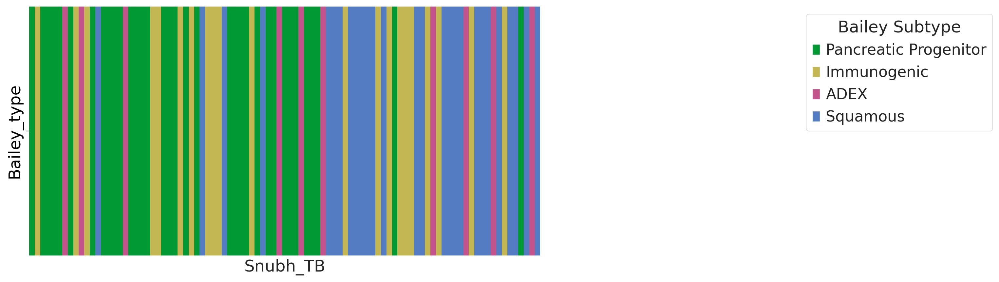

In [326]:
Bailey_map = dict(zip(annotation['Bailey Subtype'].unique(),range(annotation['Bailey Subtype'].nunique())))
Bailey_color = ['#009933','#c2b753','#c2538b', '#537cc2']
lut2 = dict(zip(annotation['Bailey Subtype'].unique(), Bailey_color))
Bailey_type = annotation['Bailey Subtype'].map(Bailey_map).astype(int).to_frame('Bailey_type').T


ax=sns.heatmap(Bailey_type, cmap=Bailey_color, cbar=False)


handles2 = [mpatches.Patch(facecolor=lut2[name]) for name in lut2]
ax.legend(handles2, lut2, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

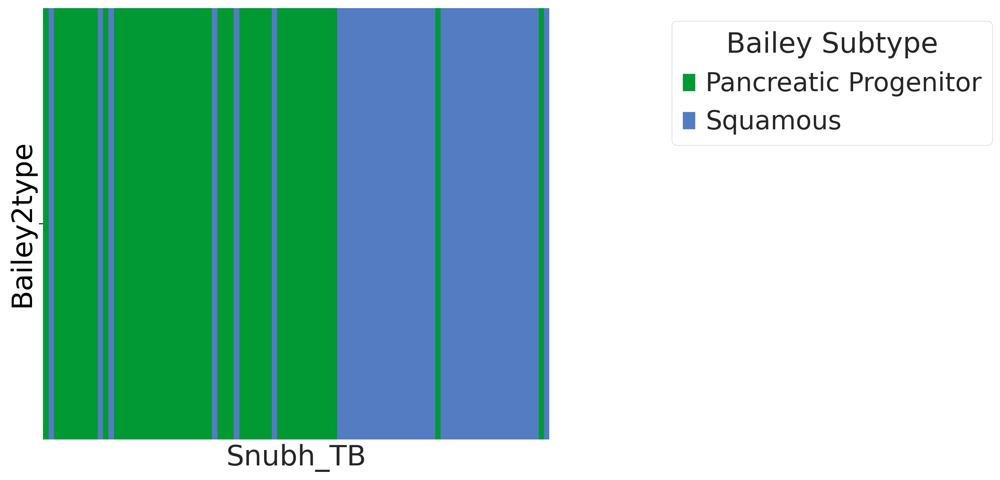

In [416]:
BaileyPS_map = dict(zip(annotation['Bailey P/S'].unique(),range(annotation['Bailey P/S'].nunique())))
BaileyPS_color = ['#009933','#537cc2']
BaileyPS_lut = dict(zip(annotation['Bailey P/S'].unique(), BaileyPS_color))
BaileyPS_type = annotation['Bailey P/S'].map(BaileyPS_map).astype(int).to_frame('Bailey2type').T
ax=sns.heatmap(BaileyPS_type, cmap=BaileyPS_color, cbar=False)

BaileyPS_handles = [mpatches.Patch(facecolor=BaileyPS_lut[name]) for name in BaileyPS_lut]
ax.legend(BaileyPS_handles, BaileyPS_lut, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

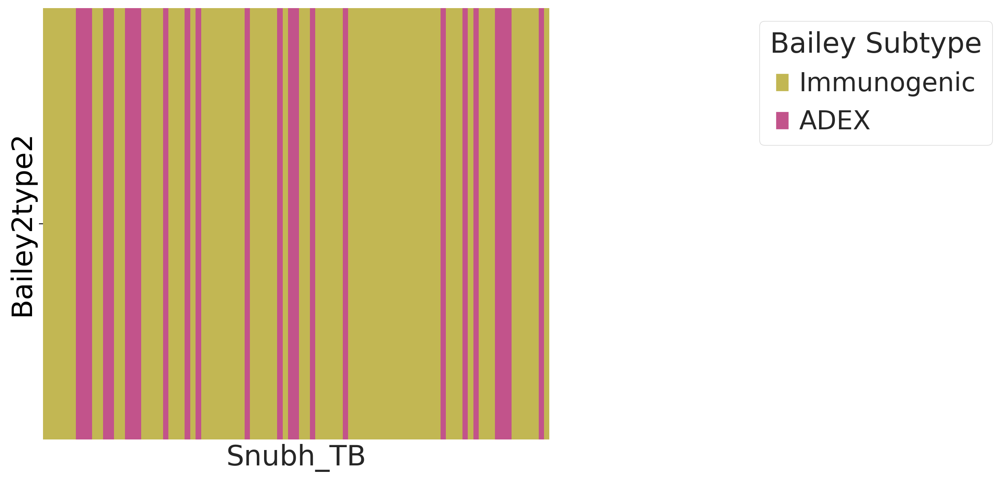

In [417]:
BaileyAI_map = dict(zip(annotation['Bailey A/I'].unique(),range(annotation['Bailey A/I'].nunique())))
BaileyAI_color = ['#c2b753','#c2538b']
BaileyAI_lut = dict(zip(annotation['Bailey A/I'].unique(), BaileyAI_color))
BaileyAI_type = annotation['Bailey A/I'].map(BaileyAI_map).astype(int).to_frame('Bailey2type2').T
ax=sns.heatmap(BaileyAI_type, cmap=BaileyAI_color, cbar=False)

BaileyAI_handles = [mpatches.Patch(facecolor=BaileyAI_lut[name]) for name in BaileyAI_lut]
ax.legend(BaileyAI_handles, BaileyAI_lut, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

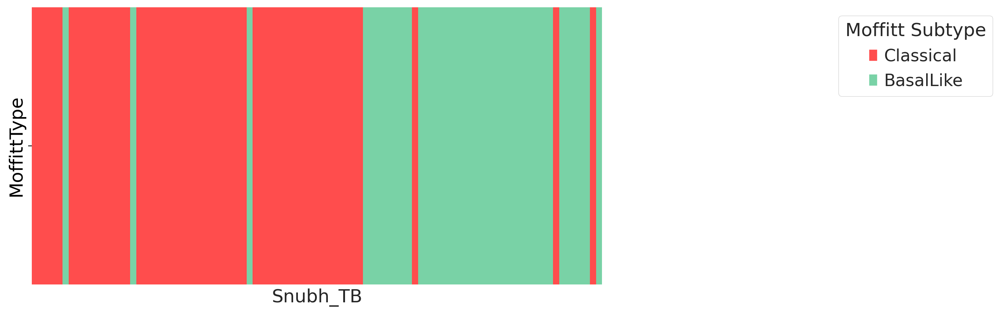

In [329]:
Moffitt_map = dict(zip(annotation['Moffitt Subtype'].unique(),range(annotation['Moffitt Subtype'].nunique())))
Moffitt_color = ['#ff4d4d','#79d2a6']
lut3 = dict(zip(annotation['Moffitt Subtype'].unique(), Moffitt_color))
Moffitt_type = annotation['Moffitt Subtype'].map(Moffitt_map).astype(int).to_frame('MoffittType').T
ax=sns.heatmap(Moffitt_type, cmap=Moffitt_color, cbar=False)


handles3 = [mpatches.Patch(facecolor=lut3[name]) for name in lut3]
ax.legend(handles3, lut3, title='Moffitt Subtype',
           bbox_to_anchor=(1.7, 1))
ax.set_xticks([])

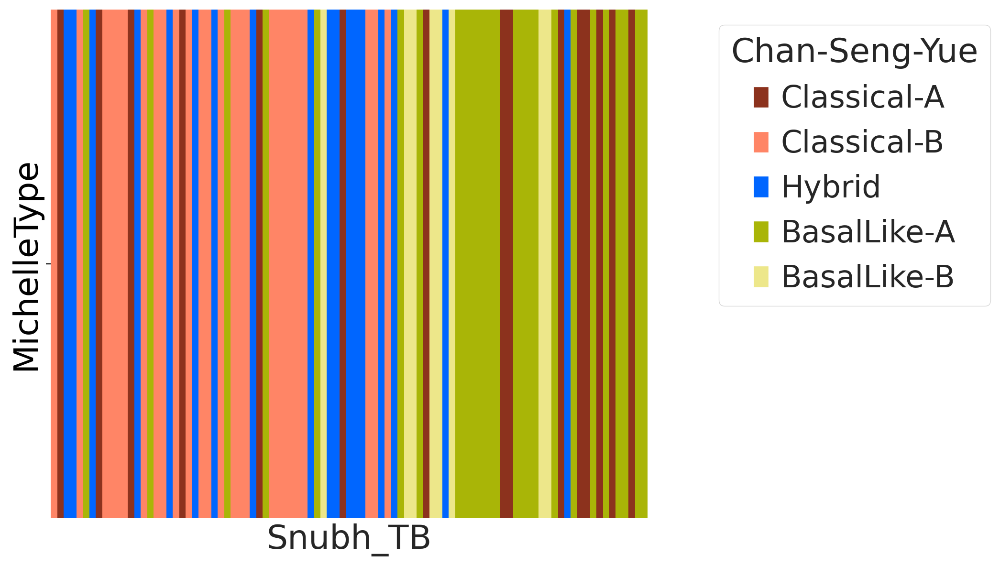

In [419]:
MichelleType_map = dict(zip(annotation['Chan-Seng-Yue Subtype'].unique(),range(5)))
MichelleType_map
MichelleType_color = ['#ff8566','#8c321d','#0066ff','#a9b507','#ede78a']
lut4 = dict(zip(annotation['Chan-Seng-Yue Subtype'].unique(), MichelleType_color))
lut4 = {'Classical-A': '#8c321d',
     'Classical-B': '#ff8566',
     'Hybrid': '#0066ff',
     'BasalLike-A': '#a9b507',
     'BasalLike-B': '#ede78a'}

MichelleType = annotation['Chan-Seng-Yue Subtype'].map(MichelleType_map).astype(int).to_frame('MichelleType').T
ax=sns.heatmap(MichelleType, cmap=MichelleType_color, cbar=False)


handles4 = [mpatches.Patch(facecolor=lut4[name]) for name in lut4]
ax.legend(handles4, lut4, title='Chan-Seng-Yue',bbox_to_anchor=(1.6, 1))
ax.set_xticks([])
plt.show()

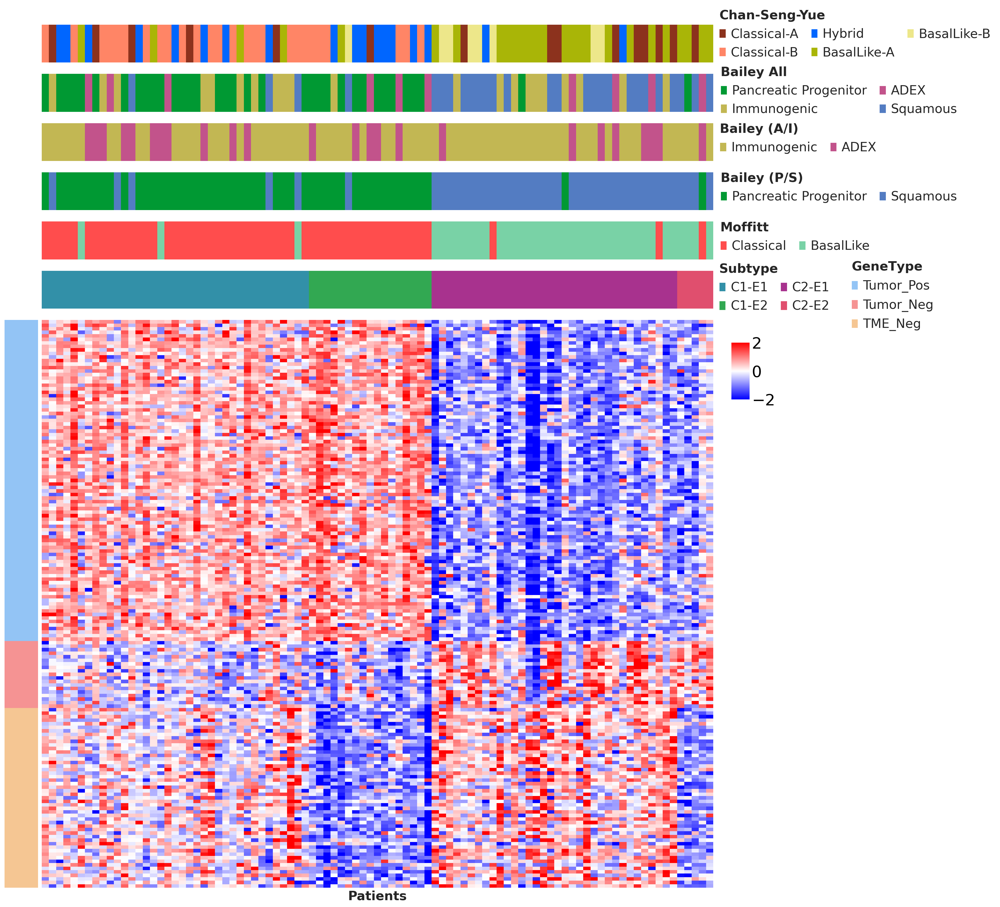

In [421]:
# final_lut['C1-E1']='#3290a8'
# final_lut['C1-E2']='#32a852'
# final_lut['C2-E1']='#a8328e'
# final_lut['C2-E2']='#e04f6e'


#annot = SNU_annot.sort_values(by='FinalType')
order = list(annotation.index)
exp = SNU_adata[:,features].to_df()
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

final_int_map = dict(zip(annotation['Final Subtype'].unique(),range(annotation['Final Subtype'].nunique())))
genetype_int_map = dict(zip(table_genes['Type'].unique(),range(table_genes['Type'].nunique())))


final = annotation['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
genetype = table_genes['Type'].map(genetype_int_map).to_frame('GeneType')


fig = plt.figure(figsize=(20, 25), dpi= 80)
widths = [1,20]
heights = [1,1,1,1,1,1,15]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.1, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[6, 0])
sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(28, 1.125), frameon=False, 
                              fontsize=20, markerscale=2)
ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_yticks([])
ax.margins(0)


ax = fig.add_subplot(gs[0, 1])
sns.heatmap(MichelleType, ax=ax, cmap=MichelleType_color, cbar=False)
#ax0.set_ylabel('Michelle', fontsize=18, fontdict=dict(weight='bold'))
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles4, lut4, bbox_to_anchor=(1.43, 1.7), 
                      frameon=False, fontsize=20, ncol=3, columnspacing=1)
ax_legend.set_title('Chan-Seng-Yue',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[1, 1])
sns.heatmap(Bailey_type, ax=ax, cmap=Bailey_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles2, lut2, bbox_to_anchor=(1.38, 1.5), 
                      frameon=False, fontsize=20,ncol=2, columnspacing=1)
ax_legend.set_title('Bailey All',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[2, 1])
sns.heatmap(BaileyAI_type, ax=ax, cmap=BaileyAI_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(BaileyAI_handles, BaileyAI_lut, bbox_to_anchor=(1.26, 1.3), 
                      frameon=False,fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Bailey (A/I)',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[3, 1])
sns.heatmap(BaileyPS_type, ax=ax, cmap=BaileyPS_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(BaileyPS_handles, BaileyPS_lut, bbox_to_anchor=(1.38, 1.3), 
                      frameon=False, fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Bailey (P/S)',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[4, 1])
sns.heatmap(Moffitt_type, ax=ax, cmap=Moffitt_color, cbar=False, )
#ax2.set_ylabel('Moffitt', fontsize=18, fontdict=dict(weight='bold'))
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles3, lut3, bbox_to_anchor=(1.25, 1.3), 
                      frameon=False, fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Moffitt',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[5, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.19, 1.5),
                    fontsize=20, markerscale=2.5, frameon=False, ncol=2, columnspacing=1)
ax_legend.set_title('Subtype',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_yticks([])
ax.margins(0)


cbar_ax = fig.add_axes([0.98, 0.58, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax = fig.add_subplot(gs[6, 1])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax.set_xticks([])
ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax.set_ylabel('')
plt.show()


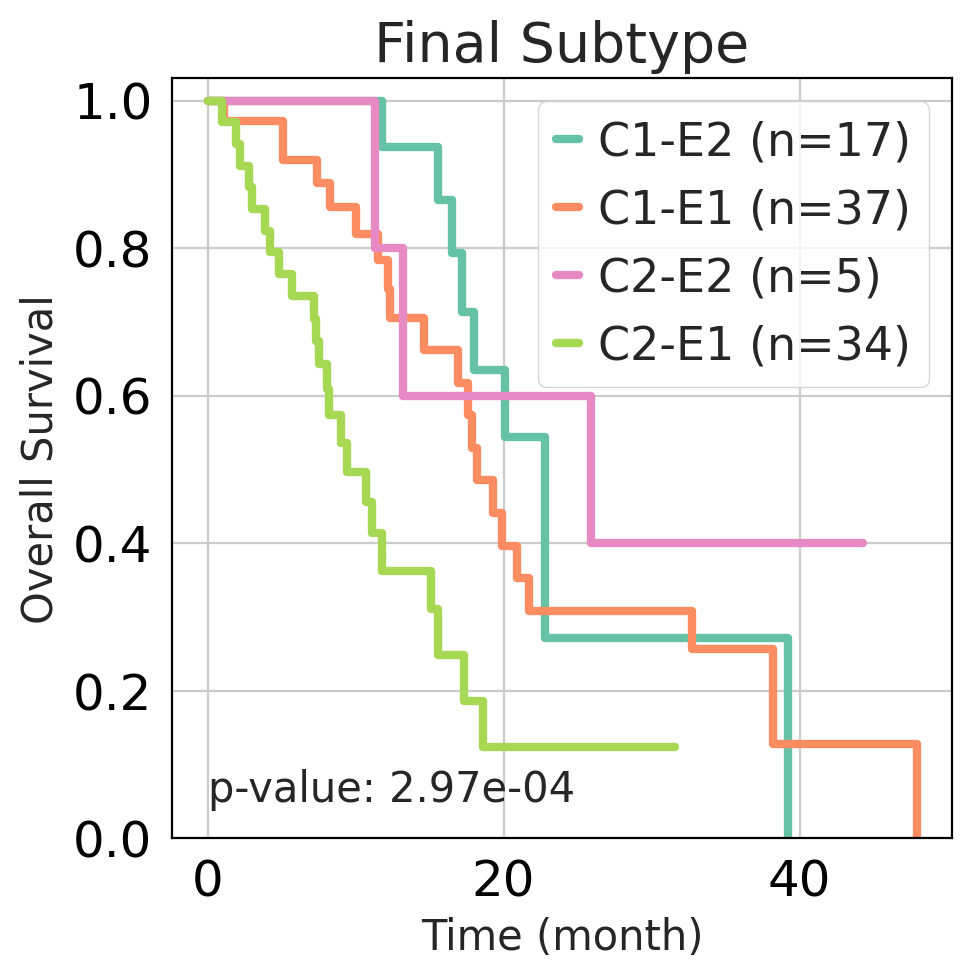

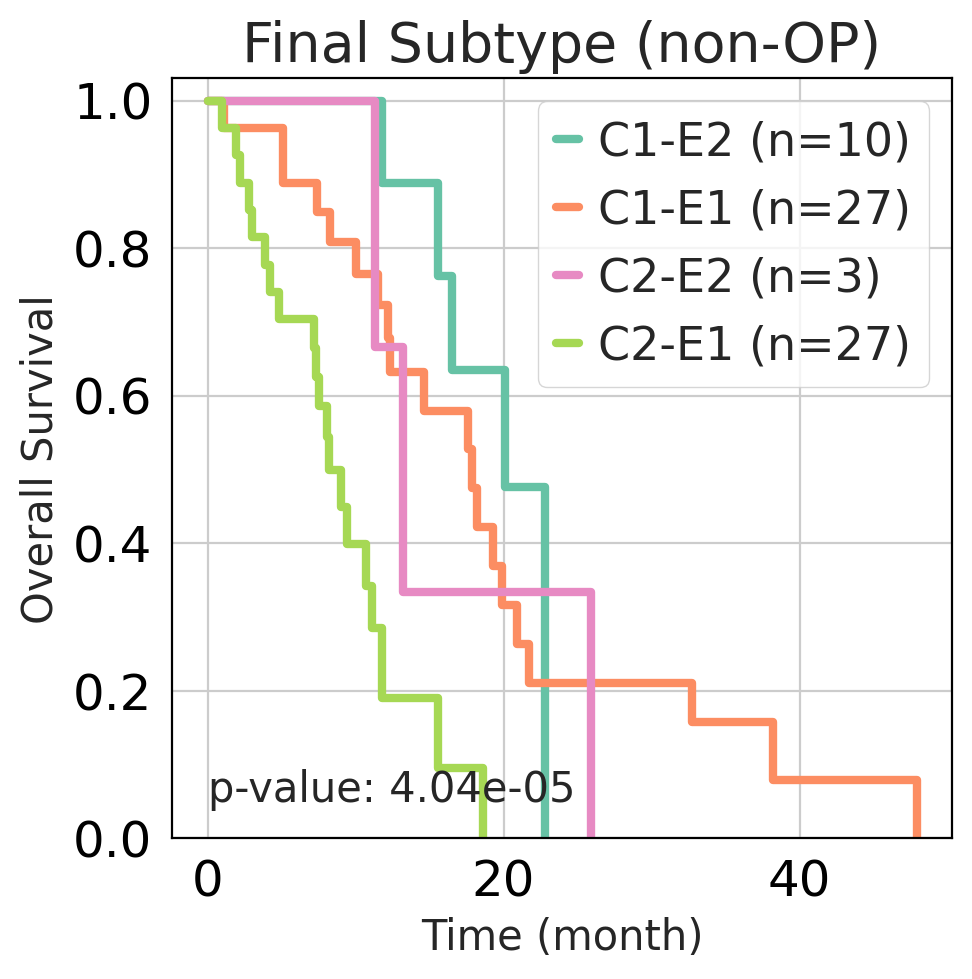

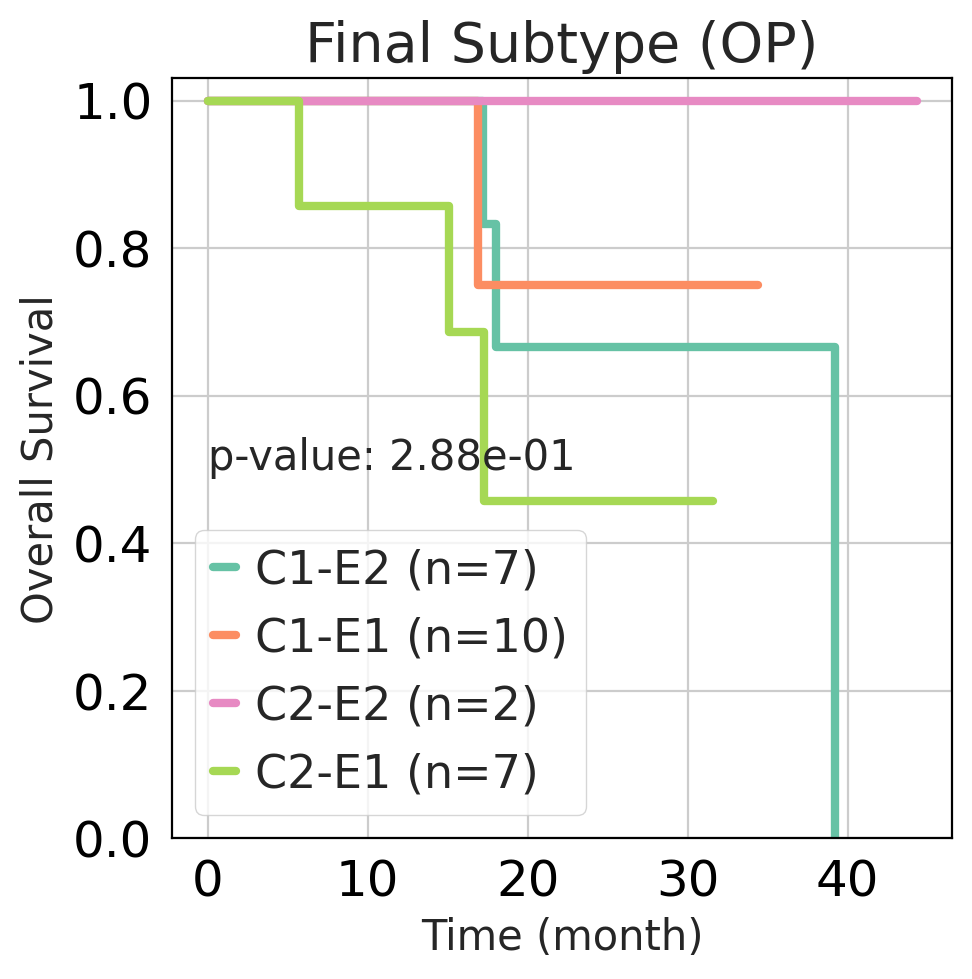

'2.88e-01'

In [578]:
SNU_annot['Bailey_Mixed'] = SNU_annot['Bailey P/S'].astype(str) + '-' + SNU_annot['Bailey A/I'].astype(str)
m = SNU_annot['clinical_setting'] == 'OP'
SNU_annot_OP = SNU_annot[m]
SNU_annot_non_OP = SNU_annot[~m]
order=['C1-E2','C1-E1','C2-E2','C2-E1']
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
km_plot(df_info=SNU_annot, category='Final Subtype', os='OS_F', event='OS_event', title='Final Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Final Subtype', os='OS_F', event='OS_event', title='Final Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Final Subtype', os='OS_F', event='OS_event', title='Final Subtype (OP)', order=order, Pos=[0,0.5])


In [565]:
SNU_annot

,N0,PID,dateA,Snubh_BB,pathology_number,tumorcellularity(pathology),DNA_RNA,methylSeq,metagenomic,liquid_number,...,stage_2,Tumor Subtype,TME Subtype,Moffitt Subtype,Bailey Subtype,Chan-Seng-Yue Subtype,Bailey P/S,Bailey A/I,Final Subtype,Dataset
Snubh_TB,,,,,,,,,,,,,,,,,,,,,
20-T00330_FO-01,sb2441,32644755,2020-05-15,20-B01156_EB-03,S 200019390,25,DNA+RNA,NaN,NaN,R167,...,NaN,C2,E1,BasalLike,Squamous,BasalLike-B,Squamous,Immunogenic,C2-E1,SNUBH
19-T00506_FO-01,sb2302,31662990,2019-09-09,19-B02082_EB-03,S 190043899,10,DNA+RNA,NaN,NaN,R075,...,NaN,C1,E1,BasalLike,Pancreatic Progenitor,Hybrid,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH
21-T00771_FT-01,NaN,10306990,2021-09-23,NaN,S 210042993,NaN,RNA,NaN,NaN,NaN,...,NaN,C2,E1,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,C2-E1,SNUBH
19-T00062_FO-01,sb1947,10108754,2019-03-18,19-B00635_EB-03,S 190013089,45,DNA+RNA,NaN,NaN,NaN,...,NaN,C2,E1,BasalLike,ADEX,BasalLike-A,Squamous,ADEX,C2-E1,SNUBH
20-T00814_FT-01,sb2669,33563897,2020-12-16,20-B04522_EB-04,S 200053444,35,DNA+RNA,NaN,NaN,R201,...,NaN,C1,E1,BasalLike,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,ADEX,C1-E1,SNUBH
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19-T00201_FO-01,sb2097,24118798,2019-05-27,NaN,S 190025387,40,RNA,NaN,NaN,R017,...,NaN,C2,E2,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH
20-T00577_FT-01,sb2582,33167509,2020-09-21,20-B03125_EB-04,S 200039363,60,DNA+RNA,NaN,NaN,NaN,...,NaN,C1,E2,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,C1-E2,SNUBH
18-02904_FO-01,sb1904,30311136,2018-12-19,18-02904_EB-02,S 180058106,35,DNA+RNA,NaN,NaN,NaN,...,NaN,C2,E2,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH


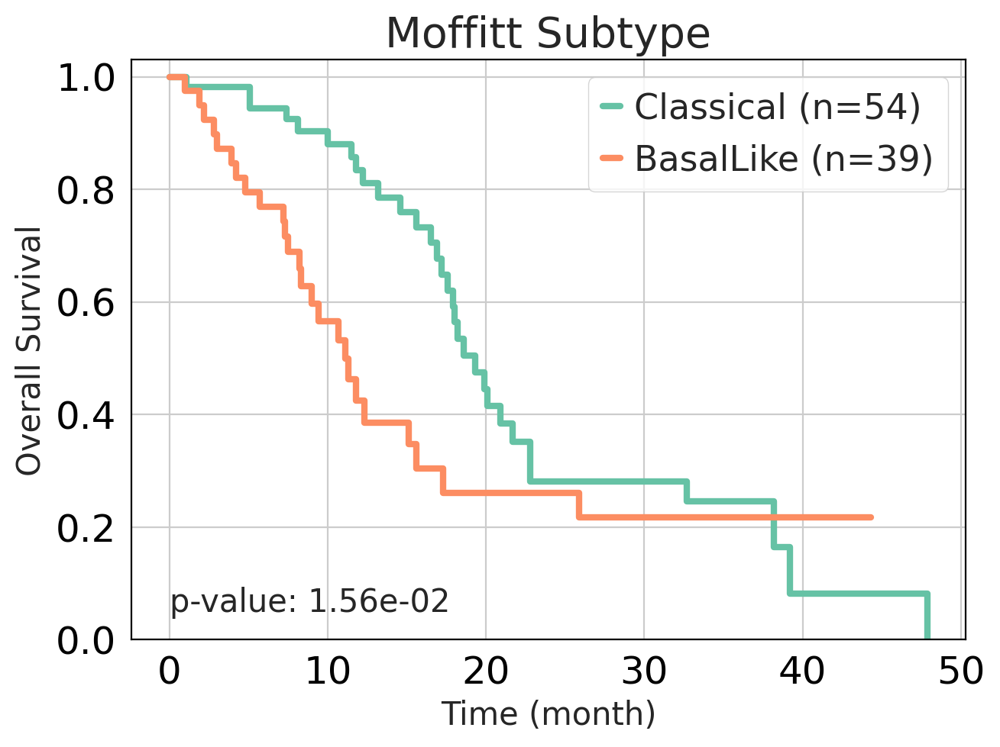

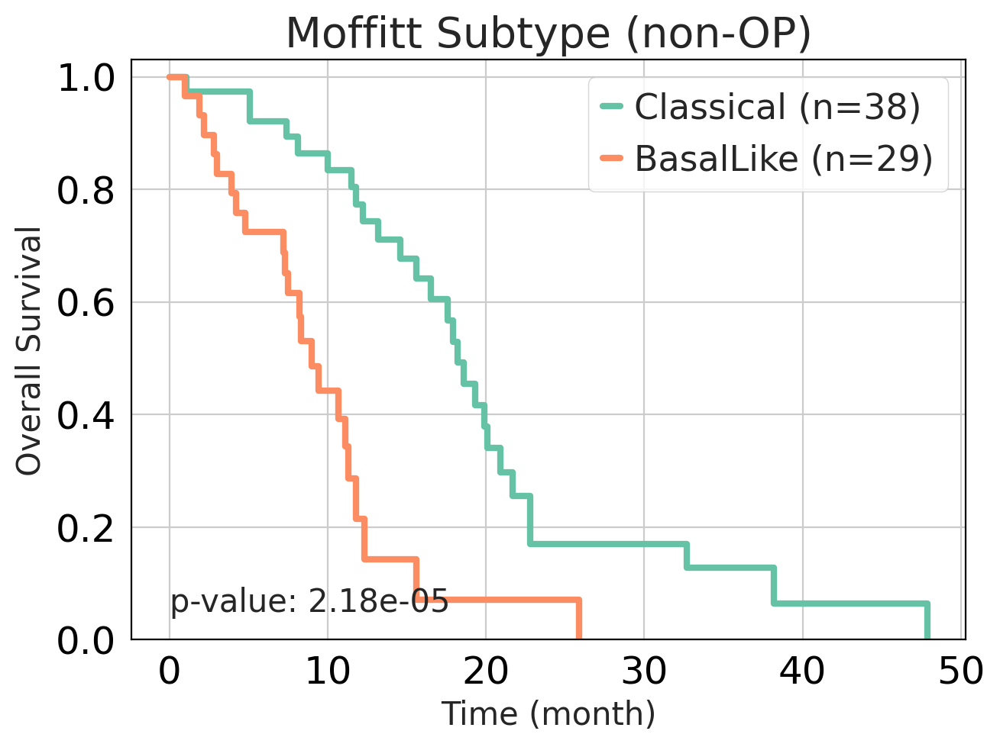

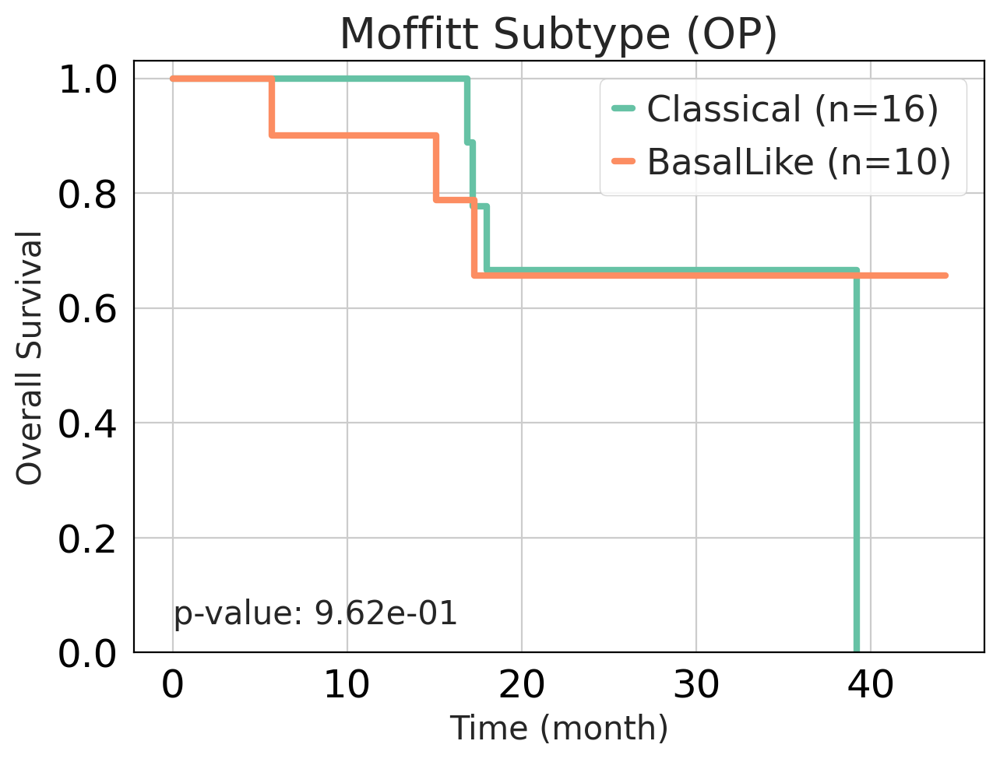

'9.62e-01'

In [587]:
sc.settings.set_figure_params(dpi=100, figsize=(7,5), fontsize=18)
order = ['Classical', 'BasalLike']
km_plot(df_info=SNU_annot, category='Moffitt Subtype', os='OS_F', event='OS_event', title='Moffitt Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Moffitt Subtype', os='OS_F', event='OS_event', title='Moffitt Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Moffitt Subtype', os='OS_F', event='OS_event', title='Moffitt Subtype (OP)', order=order)


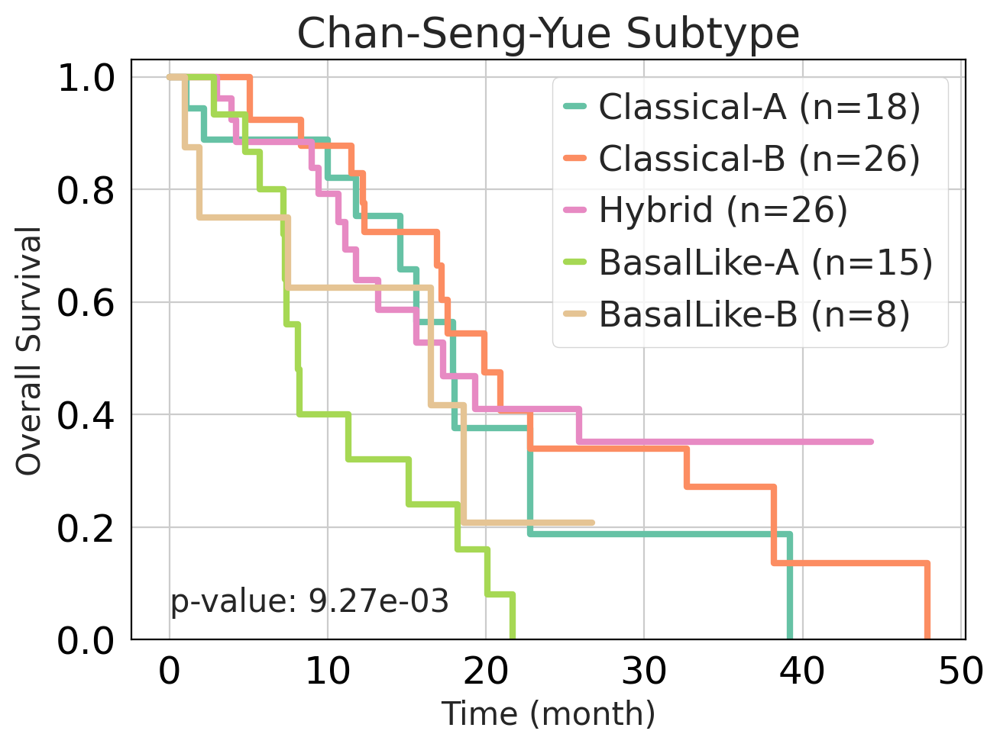

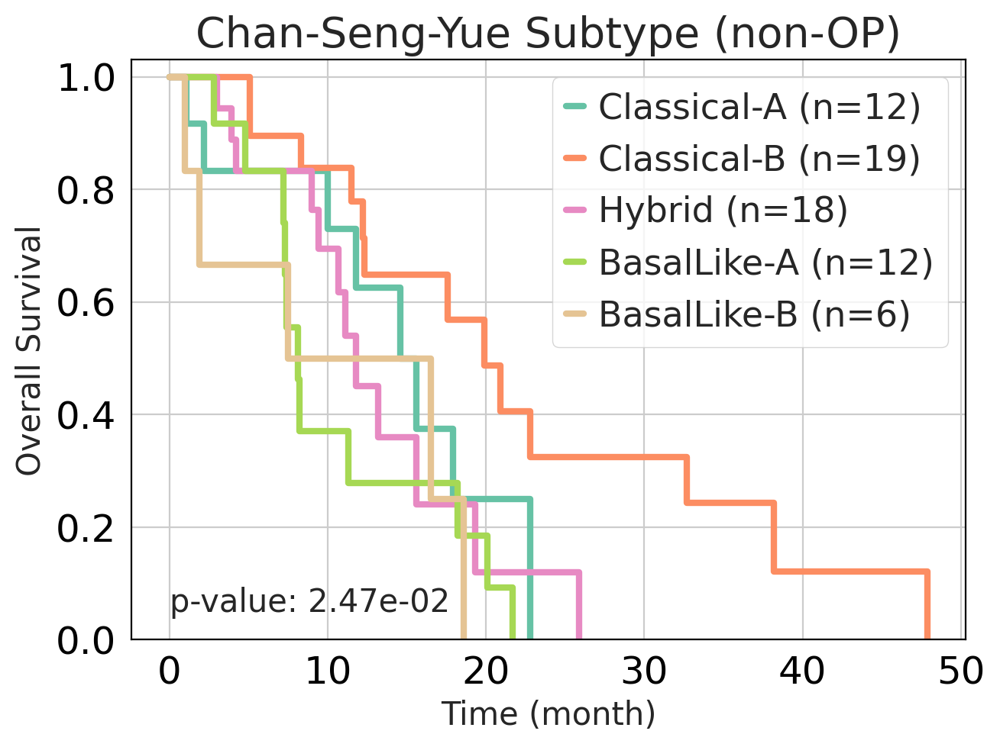

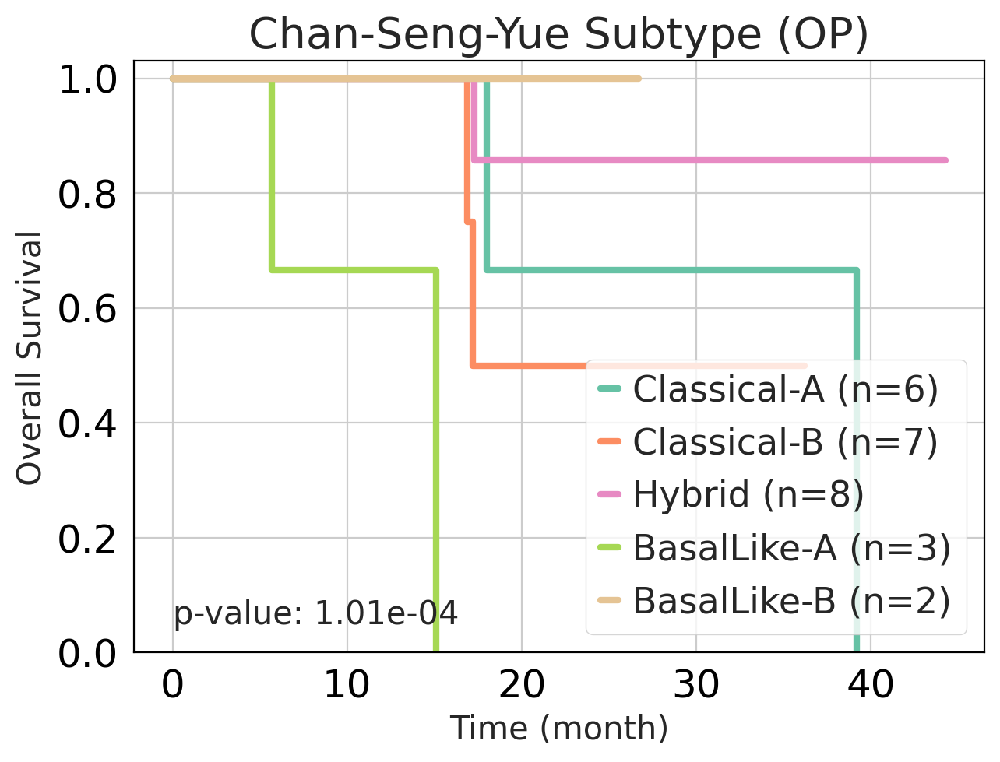

'1.01e-04'

In [572]:
sc.settings.set_figure_params(dpi=100, figsize=(7,5), fontsize=18)
order = ['Classical-A','Classical-B','Hybrid','BasalLike-A','BasalLike-B']
km_plot(df_info=SNU_annot, category='Chan-Seng-Yue Subtype', os='OS_F', event='OS_event', title='Chan-Seng-Yue Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Chan-Seng-Yue Subtype', os='OS_F', event='OS_event', title='Chan-Seng-Yue Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Chan-Seng-Yue Subtype', os='OS_F', event='OS_event', title='Chan-Seng-Yue Subtype (OP)', order=order)


In [1]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['Pancreatic Progenitor','Squamous']
km_plot(df_info=SNU_annot, category='Bailey P/S', os='OS_F', event='OS_event', title='Bailey P/S Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Bailey P/S', os='OS_F', event='OS_event', title='Bailey P/S Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Bailey P/S', os='OS_F', event='OS_event', title='Bailey P/S Subtype (OP)', order=order)


NameError: name 'sc' is not defined

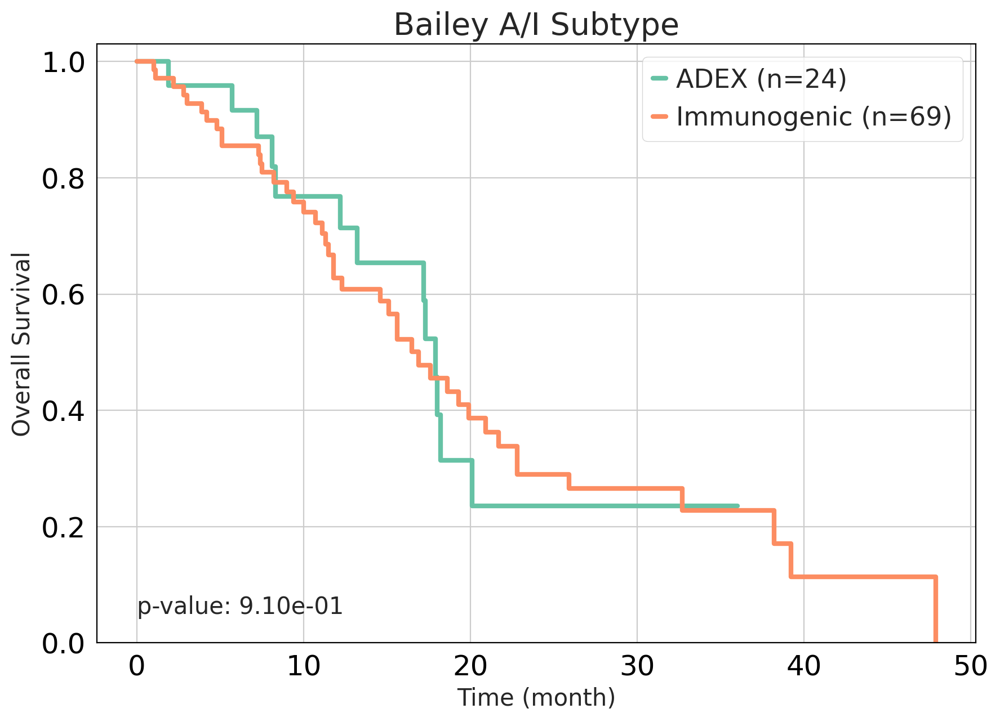

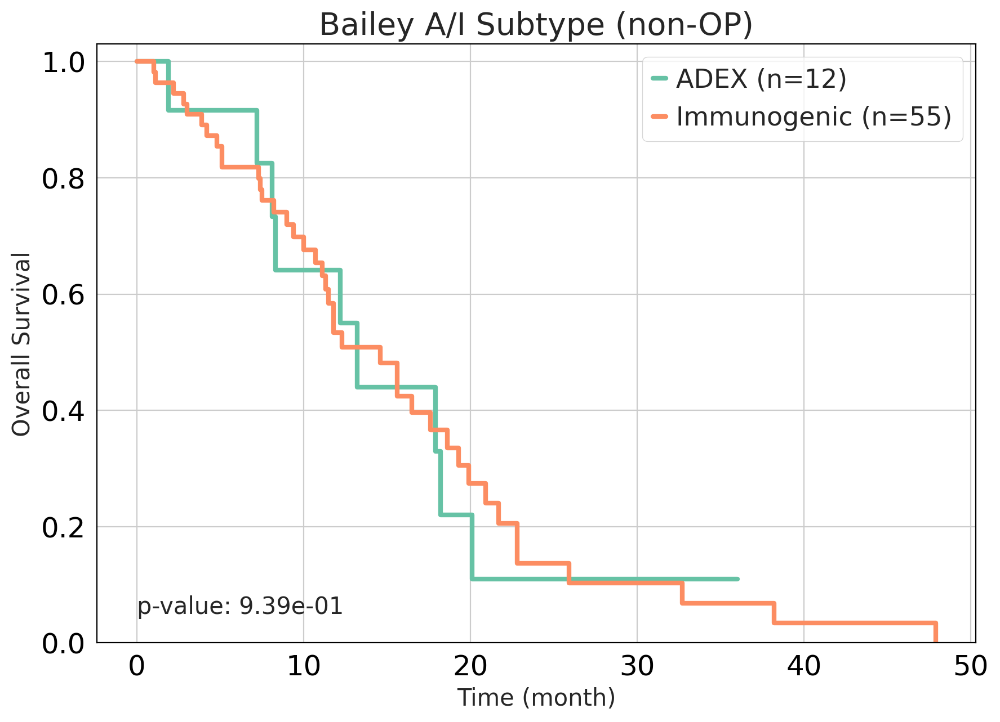

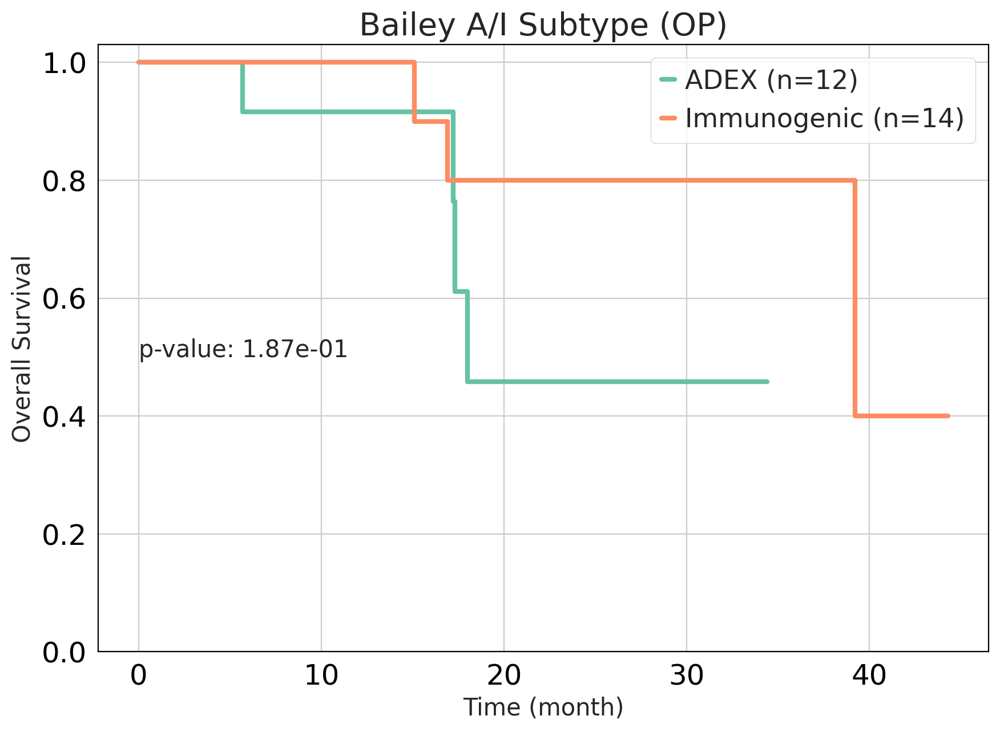

'1.87e-01'

In [593]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['ADEX','Immunogenic']
km_plot(df_info=SNU_annot, category='Bailey A/I', os='OS_F', event='OS_event', title='Bailey A/I Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Bailey A/I', os='OS_F', event='OS_event', title='Bailey A/I Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Bailey A/I', os='OS_F', event='OS_event', title='Bailey A/I Subtype (OP)', order=order, Pos=[0,0.5])


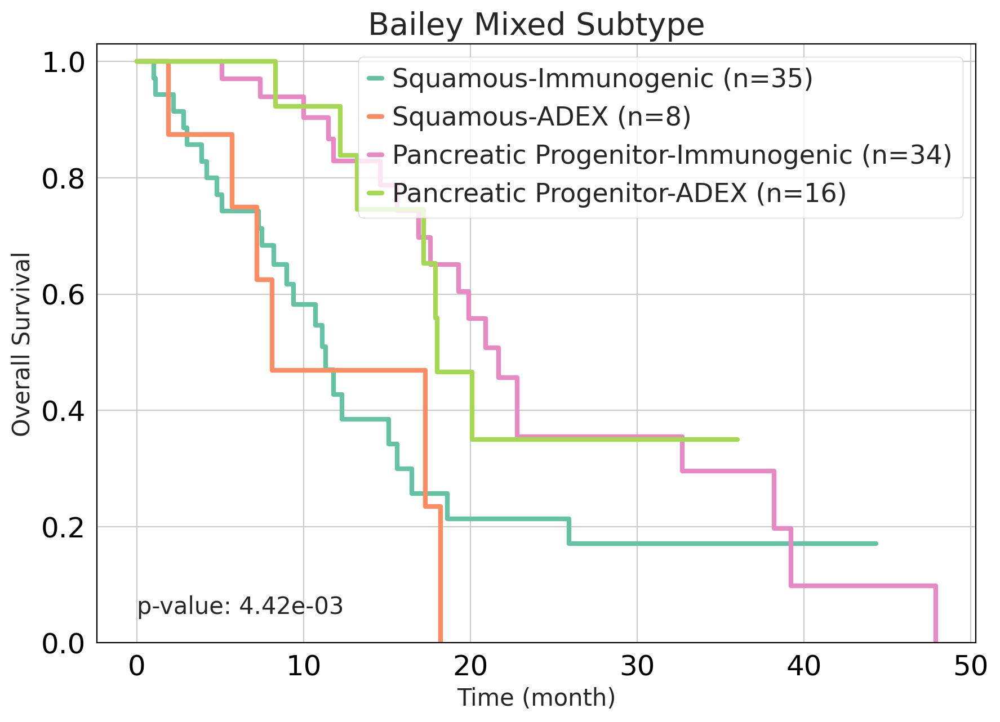

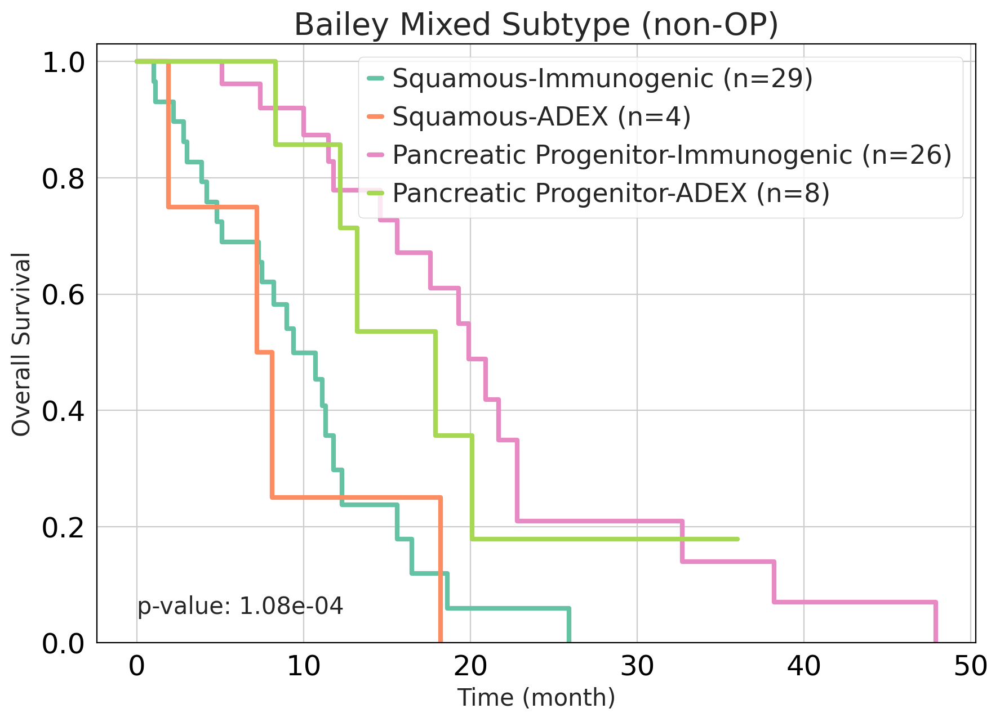

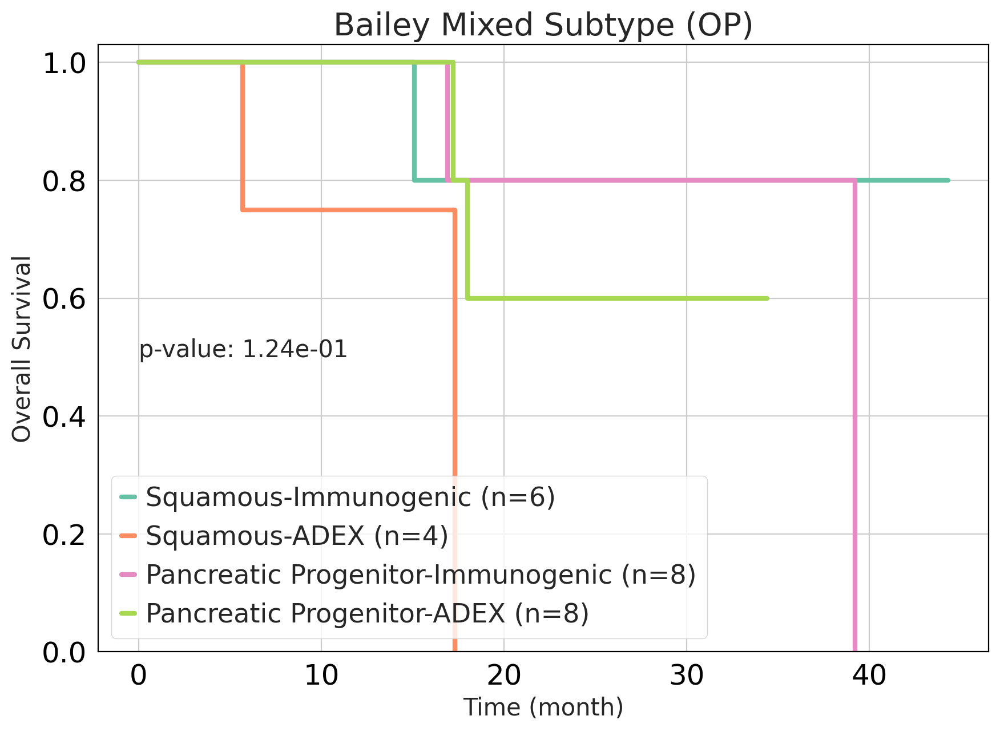

'1.24e-01'

In [592]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['Squamous-Immunogenic','Squamous-ADEX','Pancreatic Progenitor-Immunogenic','Pancreatic Progenitor-ADEX']
km_plot(df_info=SNU_annot, category='Bailey_Mixed', os='OS_F', event='OS_event', title='Bailey Mixed Subtype', order=order)
km_plot(df_info=SNU_annot_non_OP, category='Bailey_Mixed', os='OS_F', event='OS_event', title='Bailey Mixed Subtype (non-OP)', order=order)
km_plot(df_info=SNU_annot_OP, category='Bailey_Mixed', os='OS_F', event='OS_event', title='Bailey Mixed Subtype (OP)', order=order, Pos=[0,0.5])


# Bailey Data Final subtype

In [597]:
len(features)

51

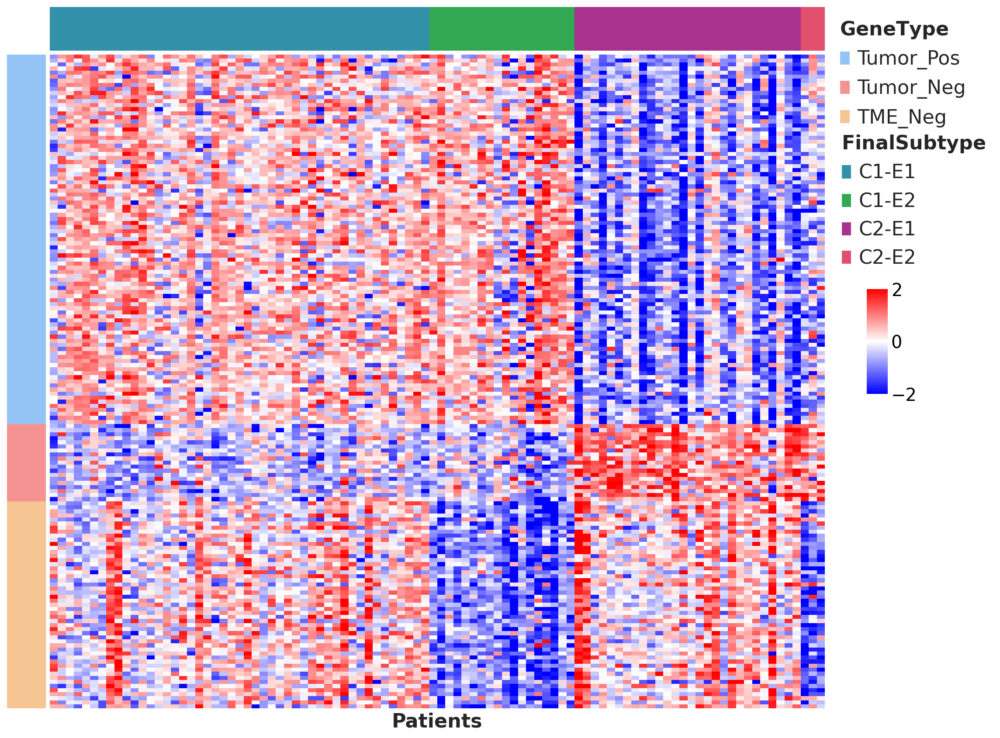

In [600]:
annot = Bailey_annot.sort_values(by='Final Subtype')
order = list(annot.index)
exp = Bailey_adata[:,features].to_df()
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

final_int_map = dict(zip(annot['Final Subtype'].unique(),range(annot['Final Subtype'].nunique())))
genetype_int_map = dict(zip(table_genes['Type'].unique(),range(table_genes['Type'].nunique())))


final = annot['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
genetype = table_genes['Type'].map(genetype_int_map).to_frame('GeneType')




fig = plt.figure(figsize=(15, 15), dpi= 80)
widths = [1,20]
heights = [1,1,1,15]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.02, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(25.2, 1.08), frameon=False, 
                              fontsize=20, markerscale=4)
ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.margins(0)


# ax0 = fig.add_subplot(gs[0, 1])
# sns.heatmap(tme, cmap=list(tme_lut.values()), cbar=False, ax=ax0)
# handles = [mpatches.Patch(facecolor=tme_lut[name]) for name in tme_lut]
# ax0_legend = ax0.legend(handles, tme_lut, bbox_to_anchor=(1.22, 1.5), frameon=False, 
#                               fontsize=20, markerscale=4)
# ax0_legend.set_title('$\\bf{TMESubtype}$',prop={'size':20})
# ax0_legend._legend_box.align = "left"
# ax0.set_xticks([])
# ax0.set_xlabel('')
# ax0.set_yticklabels('')
# ax0.margins(0)

# ax1 = fig.add_subplot(gs[1, 1])
# sns.heatmap(tumor, cmap=list(tumor_lut.values()), cbar=False, ax=ax1)
# handles = [mpatches.Patch(facecolor=tumor_lut[name]) for name in tumor_lut]
# ax1_legend = ax1.legend(handles, tumor_lut, bbox_to_anchor=(1.25, .8), frameon=False, 
#                               fontsize=20, markerscale=4)
# ax1_legend.set_title('$\\bf{TumorSubtype}$',prop={'size':20})
# ax1_legend._legend_box.align = "left"
# ax1.set_xticks([])
# ax1.set_xlabel('')
# ax1.set_yticklabels('')
# ax1.margins(0)

ax2 = fig.add_subplot(gs[2, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax2)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax2_legend = ax2.legend(handles, final_lut, bbox_to_anchor=(1.23, -1.5), frameon=False, 
                              fontsize=20, markerscale=4)
ax2_legend.set_title('$\\bf{FinalSubtype}$',prop={'size':20})
ax2_legend._legend_box.align = "left"
ax2.set_xticks([])
ax2.set_xlabel('')
ax2.set_yticklabels('')
ax2.margins(0)


cbar_ax = fig.add_axes([1.0, 0.45, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax3 = fig.add_subplot(gs[3, 1])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax3, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax3.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax3.set_xticks([])
ax3.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
#ax3.set_ylabel('Genes', fontsize=20, fontdict=dict(weight='bold'))
plt.show()


In [2]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
order=['C1-E2','C1-E1','C2-E2','C2-E1']
km_plot(df_info=Bailey_annot, category='Final Subtype', os='OS_F', event='OS_event', title='Bailey Survival - FinalType', order=order)

NameError: name 'sc' is not defined

# TCGA

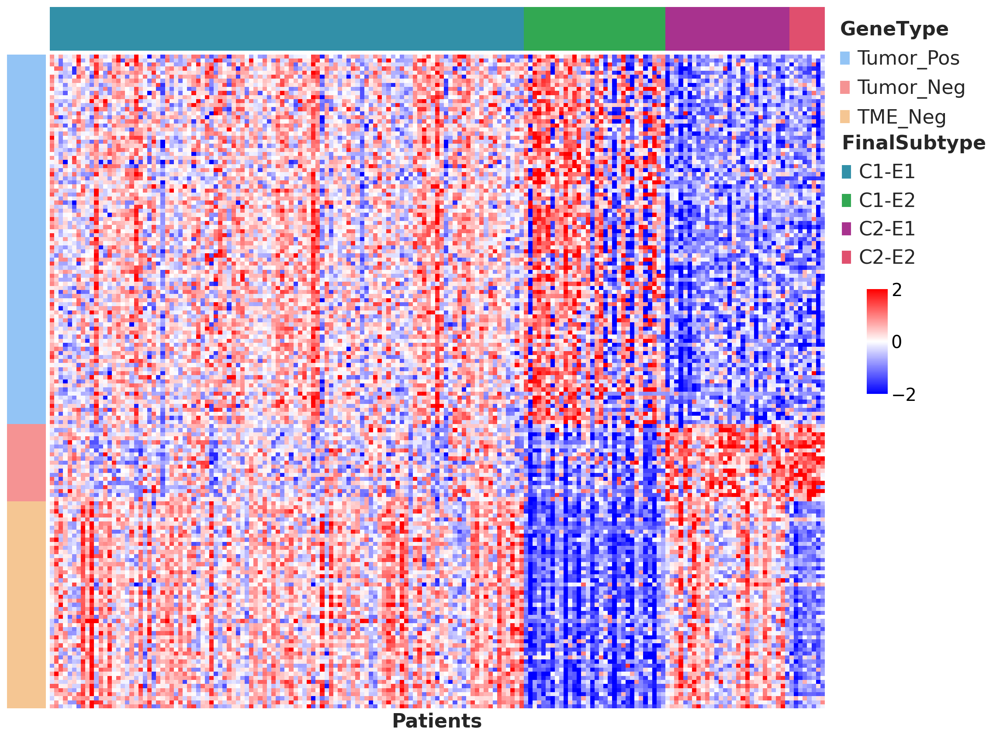

In [603]:
annot = TCGA_annot.sort_values(by='Final Subtype')
order = list(annot.index)
exp = TCGA_adata[:,features].to_df()
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

final_int_map = dict(zip(annot['Final Subtype'].unique(),range(annot['Final Subtype'].nunique())))
genetype_int_map = dict(zip(table_genes['Type'].unique(),range(table_genes['Type'].nunique())))


final = annot['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
genetype = table_genes['Type'].map(genetype_int_map).to_frame('GeneType')


fig = plt.figure(figsize=(15, 15), dpi= 80)
widths = [1,20]
heights = [1,1,1,15]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.02, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(25.2, 1.08), frameon=False, 
                              fontsize=20, markerscale=4)
ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.margins(0)

ax2 = fig.add_subplot(gs[2, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax2)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax2_legend = ax2.legend(handles, final_lut, bbox_to_anchor=(1.23, -1.5), frameon=False, 
                              fontsize=20, markerscale=4)
ax2_legend.set_title('$\\bf{FinalSubtype}$',prop={'size':20})
ax2_legend._legend_box.align = "left"
ax2.set_xticks([])
ax2.set_xlabel('')
ax2.set_yticklabels('')
ax2.margins(0)


cbar_ax = fig.add_axes([1.0, 0.45, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax3 = fig.add_subplot(gs[3, 1])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax3, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax3.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax3.set_xticks([])
ax3.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax3.set_ylabel('')
plt.show()


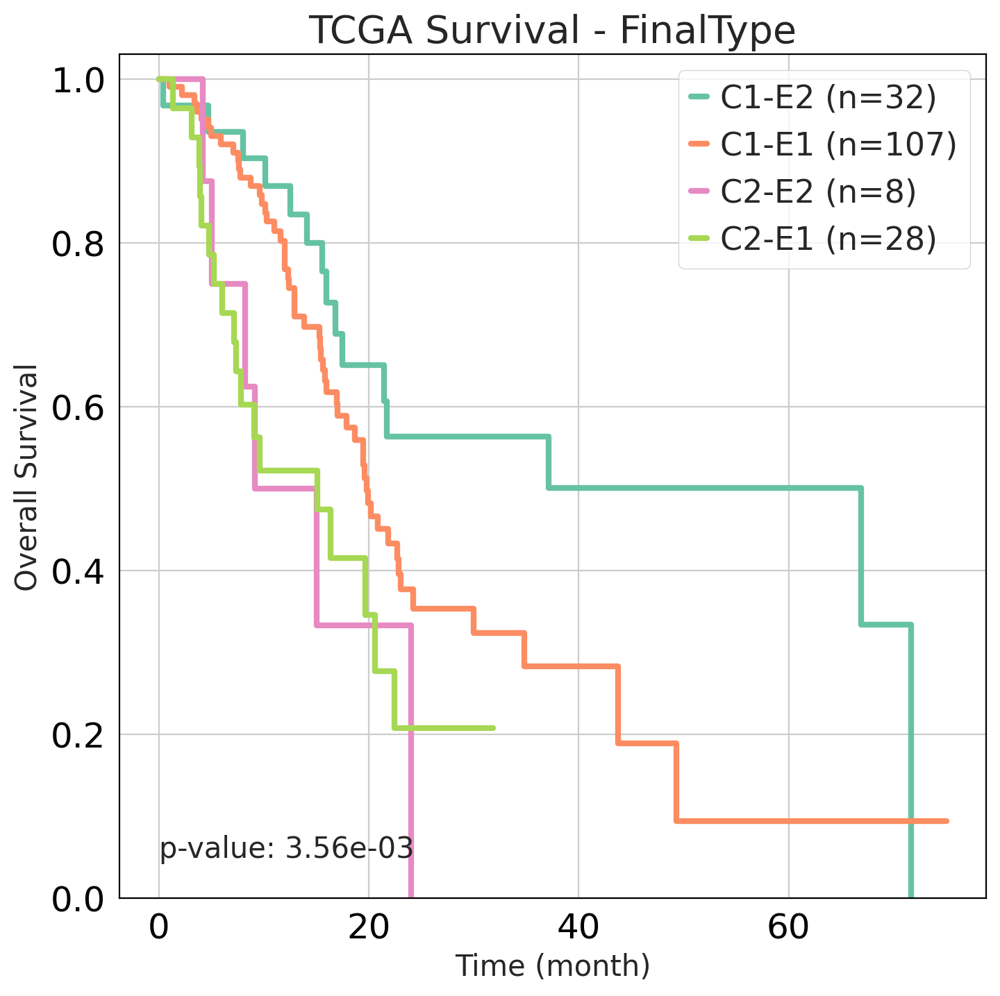

'3.56e-03'

In [605]:
sc.settings.set_figure_params(dpi=100, figsize=(8,8), fontsize=18)
order=['C1-E2','C1-E1','C2-E2','C2-E1']
km_plot(df_info=TCGA_annot, category='Final Subtype', os='OS_F', event='OS_event', title='TCGA Survival - FinalType', order=order)

In [223]:
def col_rename(x):
    x = x.replace('X','')
    x = x.replace('.','-')
    return x


os.listdir('deconv_res')
epic = pd.read_csv('deconv_res/epic_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
quantiseq = pd.read_csv('deconv_res/quantiseq_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
mcp_counter = pd.read_csv('deconv_res/mcp_counter_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
xcell = pd.read_csv('deconv_res/xcell_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
epic.columns = epic.columns.map(col_rename)
quantiseq.columns = quantiseq.columns.map(col_rename)
mcp_counter.columns = mcp_counter.columns.map(col_rename)
xcell.columns = xcell.columns.map(col_rename)

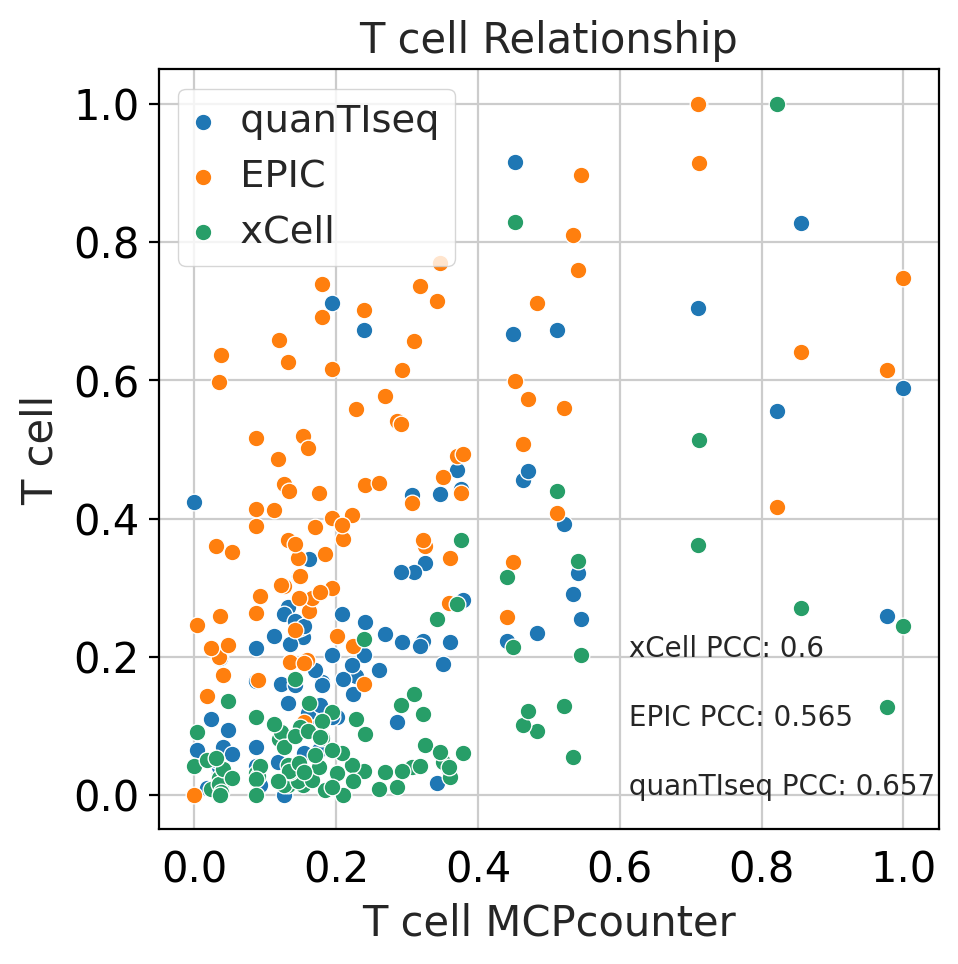

In [656]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=15)

mcp_counter = pd.read_csv('mcpcounter_LineageType.csv',index_col=0)
epic = pd.read_csv('epic_LineageType.csv',index_col=0)
quantiseq = pd.read_csv('quantiseq_LineageType.csv',index_col=0)
xcell = pd.read_csv('xcell_LineageType.csv',index_col=0)

mcp_counter.index = mcp_counter.index+' MCPcounter'
quantiseq.index = quantiseq.index+' quanTIseq'
epic.index = epic.index+' EPIC'
xcell.index = xcell.index+' xCell'

lineagetype = pd.concat([mcp_counter, quantiseq, epic, xcell],axis=0)
scaler = MinMaxScaler()
scaled = pd.DataFrame(scaler.fit_transform(lineagetype.T), columns=lineagetype.index, index=lineagetype.columns).T

target_cell = 'T cell'
ref = ' MCPcounter'
ref_cell = target_cell+ref
target_groups = [' quanTIseq',' EPIC',' xCell']
text_ypos = 0.0
text_xpos = 0.6
spacing = 0.1
i=0
for group in target_groups:
    cell = target_cell+group
    if cell in lineagetype.index:
        sns.scatterplot(x=scaled.loc[ref_cell,:],y=scaled.loc[cell,:], label=group)
        corr = np.round(np.corrcoef(scaled.loc[ref_cell,:],scaled.loc[cell,:])[0,1],3)
        corr = '{} PCC: {}'.format(group,corr)
        plt.text(text_xpos, text_ypos+i*spacing, corr, fontsize=10)
        i+=1
          
plt.ylabel('{}'.format(target_cell))
plt.title('{} Relationship'.format(target_cell))
plt.show()    



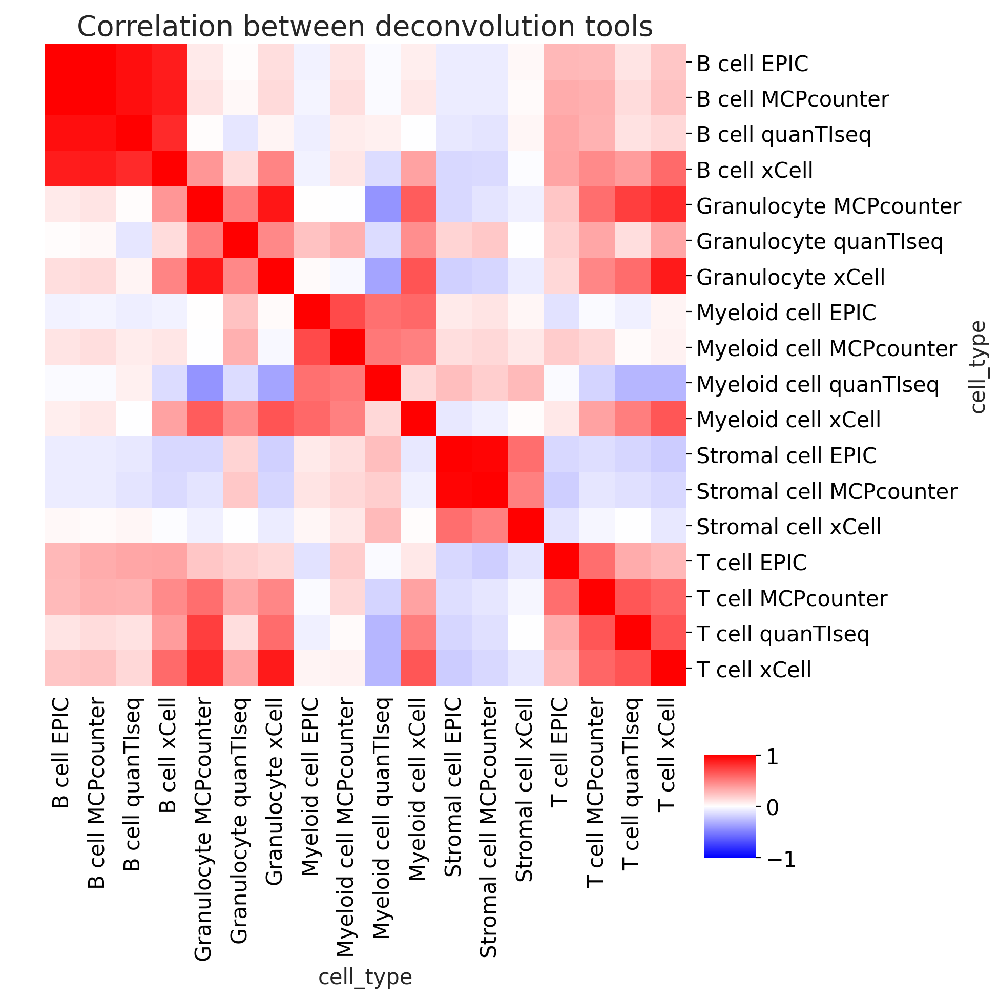

In [657]:
tmp = lineagetype.T.corr()
ordered = sorted(tmp.columns)
tmp = tmp.loc[ordered,ordered]
g=sns.clustermap(tmp,method='ward',row_cluster=False,col_cluster=False,
               dendrogram_ratio=0.05,cbar_pos=(0.7, 0.15, 0.05, 0.1),cmap="bwr", vmin=-1, vmax=1)
g.ax_heatmap.set_title('Correlation between deconvolution tools',fontsize=20)
plt.show()

In [226]:
order = list(annotation.index)
scaler = StandardScaler()
#scaler = MinMaxScaler()
mcp_counter = pd.read_csv('mcpcounter_LineageType.csv',index_col=0)
mcp_counter = pd.DataFrame(scaler.fit_transform(mcp_counter.loc[:,order].T), columns=mcp_counter.index, index=mcp_counter.columns).T

epic = pd.read_csv('epic_LineageType.csv',index_col=0)
epic = pd.DataFrame(scaler.fit_transform(epic.loc[:,order].T), columns=epic.index, index=epic.columns).T
quantiseq = pd.read_csv('quantiseq_LineageType.csv',index_col=0)
quantiseq = pd.DataFrame(scaler.fit_transform(quantiseq.loc[:,order].T), columns=quantiseq.index, index=quantiseq.columns).T
xcell = pd.read_csv('xcell_LineageType.csv',index_col=0)
xcell = pd.DataFrame(scaler.fit_transform(xcell.loc[:,order].T), columns=xcell.index, index=xcell.columns).T

In [229]:
annotation

,N0,PID,dateA,Snubh_BB,pathology_number,tumorcellularity(pathology),DNA_RNA,methylSeq,metagenomic,liquid_number,...,Tumor Subtype,TME Subtype,Moffitt Subtype,Bailey Subtype,Chan-Seng-Yue Subtype,Bailey P/S,Bailey A/I,Final Subtype,Dataset,Bailey_Mixed
Snubh_TB,,,,,,,,,,,,,,,,,,,,,
21-T00575_FT-01,NaN,34479166,2021-07-21,NaN,S 210032999,NaN,RNA,NaN,NaN,NaN,...,S0,S0,Classical,Immunogenic,Classical-A,Pancreatic Progenitor,ADEX,S0-S0,SNUBH,Pancreatic Progenitor-ADEX
21-T01027_FT-01,NaN,27021204,2021-12-16,NaN,S 210057858,NaN,RNA,NaN,NaN,NaN,...,S0,S0,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,S0-S0,SNUBH,Pancreatic Progenitor-Immunogenic
19-T00776_FO-01,sb2375,32183755,2019-12-30,19-B03158_EB-03,S 190062582,30,DNA+RNA,NaN,NaN,R124,...,S0,S0,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,S0-S0,SNUBH,Pancreatic Progenitor-Immunogenic
21-T01039_FT-01,NaN,35206741,2021-12-24,NaN,S 210058867,NaN,RNA,NaN,NaN,NaN,...,S0,S0,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,S0-S0,SNUBH,Pancreatic Progenitor-Immunogenic
21-T00640_FT-01,NaN,20443687,2021-08-12,NaN,S 210036633,NaN,RNA,NaN,NaN,NaN,...,S0,S0,Classical,Squamous,Classical-A,Squamous,Immunogenic,S0-S0,SNUBH,Squamous-Immunogenic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19-T00668_FO-01,sb2353,31995784,2019-11-13,19-B02684_EB-03,S 190054508,35,DNA+RNA,NaN,NaN,R115,...,S1,S1,BasalLike,Squamous,BasalLike-A,Squamous,Immunogenic,S1-S1,SNUBH,Squamous-Immunogenic
18-02904_FO-01,sb1904,30311136,2018-12-19,18-02904_EB-02,S 180058106,35,DNA+RNA,NaN,NaN,NaN,...,S1,S1,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,S1-S1,SNUBH,Squamous-Immunogenic
21-T00346_FT-01,NaN,34083060,2021-04-28,21-B01700_EB-04,S 210019182,25,DNA+RNA,NaN,NaN,R239,...,S1,S1,Classical,ADEX,Hybrid,Pancreatic Progenitor,ADEX,S1-S1,SNUBH,Pancreatic Progenitor-ADEX


In [699]:
order = list(annotation.index)
head = annotation.copy()
head = head.astype(str)
head['CTx_response_FFX'] = head['CTx_response_FFX'].replace('nan','NA')
head

,N0,PID,dateA,Snubh_BB,pathology_number,tumorcellularity(pathology),DNA_RNA,methylSeq,metagenomic,liquid_number,...,Tumor Subtype,TME Subtype,Moffitt Subtype,Bailey Subtype,Chan-Seng-Yue Subtype,Bailey P/S,Bailey A/I,Final Subtype,Dataset,Bailey_Mixed
Snubh_TB,,,,,,,,,,,,,,,,,,,,,
21-T00054_FT-01,nan,13691820,2021-01-20,21-B00269_EB-04,S 210003105,45,DNA+RNA,nan,nan,R214,...,C1,E1,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
21-T00875_FT-01,nan,34956214,2021-11-01,nan,S 210049507,nan,RNA,nan,nan,nan,...,C1,E1,Classical,Immunogenic,BasalLike-A,Squamous,Immunogenic,C1-E1,SNUBH,Squamous-Immunogenic
21-T01039_FT-01,nan,35206741,2021-12-24,nan,S 210058867,nan,RNA,nan,nan,nan,...,C1,E1,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
21-T00511_FT-01,nan,17227694,2021-06-30,nan,S 210029133,nan,RNA,nan,nan,nan,...,C1,E1,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
19-T00776_FO-01,sb2375,32183755,2019-12-30,19-B03158_EB-03,S 190062582,30,DNA+RNA,nan,nan,R124,...,C1,E1,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18-02904_FO-01,sb1904,30311136,2018-12-19,18-02904_EB-02,S 180058106,35,DNA+RNA,nan,nan,nan,...,C2,E2,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic
20-T00360_FO-01,sb2088,22888938,2020-06-03,20-B01405_EB-03,S 200022294,55,DNA+RNA,nan,nan,nan,...,C2,E2,BasalLike,Pancreatic Progenitor,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic
19-T00668_FO-01,sb2353,31995784,2019-11-13,19-B02684_EB-03,S 190054508,35,DNA+RNA,nan,nan,R115,...,C2,E2,BasalLike,Squamous,BasalLike-A,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic


In [333]:
fig = plt.figure(figsize=(25, 30), dpi= 150)
widths = [1]
heights = [0.5,2,1.5,2,2]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.15, wspace=0.01, width_ratios=widths, height_ratios=heights)



final_int_map = dict(zip(head['Final Subtype'].unique(),range(head['Final Subtype'].nunique())))
final = head['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
ax = fig.add_subplot(gs[0, 0])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.22, 1.6),
                              fontsize=30, markerscale=2, frameon=False, ncol=2, columnspacing=1)
ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False

ax = fig.add_subplot(gs[1, 0])
sns.heatmap(mcp_counter, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


ax = fig.add_subplot(gs[2, 0])
sns.heatmap(epic, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-EPIC',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(quantiseq, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-quanTIseq',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


cbar_ax = fig.add_axes([1.08, 0.79, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax = fig.add_subplot(gs[4, 0])
sns.heatmap(xcell, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-xCell',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)




plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True
plt.show()

# Prior knowledge based signature genes

In [896]:
sig_genes = pd.read_csv('SigGenes.csv',index_col=0)
sig_genes

,Signarutre,PMID
Gene,,
FOXP3,Treg,21488902
IKZF1,Treg,31244845
IKZF3,Treg,31244845
CTLA4,Treg,22403258
TNFRSF18,Treg,27591414
ENTPD1,Treg,20546740
TNFRSF4,Treg,32012260
SELL,Treg,34162888
ITGAM,MDSC,24060865


In [897]:
sig_dict = dict()
sig_genes = pd.read_csv('SigGenes.csv',index_col=0)
# common_genes = list(set(SNU_adata.to_df().columns) & set(sig_genes.index))
# m = sig_genes.index.isin(common_genes)
# sig_genes = sig_genes[m]
# sig_genes.to_csv('Signature_Genes.csv')
sig_keys = list(sig_genes['Signarutre'].unique())
snu_exp = SNU_adata.to_df()
zscore = snu_exp.copy()
#zscore = pd.DataFrame(scaler.fit_transform(snu_exp), columns=snu_exp.columns, index=snu_exp.index)

score_list = []
for key in sig_keys:
    m = sig_genes['Signarutre'] == key
    gene_set = list(sig_genes[m].index)
    sig_score = zscore.loc[:,gene_set]
    sig_score = sig_score.sum(axis=1).to_frame(name=key)
    score_list.append(sig_score)
    #print(key)
sig_gene_score = pd.concat(score_list, axis=1)
sig_gene_score

,Treg,MDSC,Immune Suppression Factors,Tumor-associated Macrophages
Snubh_TB,,,,
20-T00330_FO-01,17.238998,12.655540,26.248899,14.553450
19-T00062_FO-01,17.037563,12.926964,20.450037,12.285898
20-T00814_FT-01,14.100388,10.763420,24.425434,16.408226
19-T00201_FO-01,10.572201,7.880238,20.517307,13.778971
19-T00505_FO-01,12.969016,11.829847,20.185009,15.984309
...,...,...,...,...
21-T00576_FT-01,14.463134,13.999706,22.540874,15.477762
19-T00620_FO-01,14.784037,12.256018,24.250072,20.551836
19-T00413_FO-01,10.471897,6.930456,16.565037,13.200912


In [898]:
scaler = StandardScaler()
#scaler = MinMaxScaler()

order = list(annotation.index)
sig_gene_score_std = pd.DataFrame(scaler.fit_transform(sig_gene_score.loc[order,:]), columns=sig_gene_score.columns, index=sig_gene_score.index).T
sig_gene_score_std

Snubh_TB,20-T00330_FO-01,19-T00062_FO-01,20-T00814_FT-01,19-T00201_FO-01,19-T00505_FO-01,20-T00764_FT-01,20-T00577_FT-01,21-T00687_FT-01,21-T00771_FT-01,18-01500_FO-01,...,19-T00380_FO-01,19-T00573_FO-01,20-T00105_FO-01,21-T00511_FT-01,22-T00038_FT-01,21-T00576_FT-01,19-T00620_FO-01,19-T00413_FO-01,20-T00073_FO-01,19-T00119_FO-01
Treg,0.157662,0.846443,-0.334490,-0.133126,-0.726460,-0.339260,-1.322994,-0.468800,0.257429,-0.580354,...,1.234555,0.330132,0.636392,1.119796,0.846812,-0.378033,-1.086248,-0.862579,-0.986658,-1.014388
MDSC,0.769740,0.735938,-0.014339,0.190070,-0.981624,0.906349,-0.483506,-0.708099,0.603020,-0.117175,...,1.069835,0.598826,0.355516,2.018056,2.141561,-1.134904,-0.641992,-1.158437,-0.941581,-1.638272
Immune Suppression Factors,0.503781,0.005456,-0.178237,0.501794,-1.007635,0.795426,0.318953,-0.177454,0.457580,0.751385,...,1.185232,-1.155697,0.334615,1.044041,2.150308,-0.464608,-0.155768,0.869633,-1.320392,-0.467612
Tumor-associated Macrophages,0.904214,-0.501272,0.011828,1.087261,0.371649,1.952372,0.466913,0.092507,0.753581,1.286805,...,0.359405,-0.209889,0.558888,-0.222734,2.270691,-1.303940,-2.089607,-1.427699,-0.852683,-0.510981


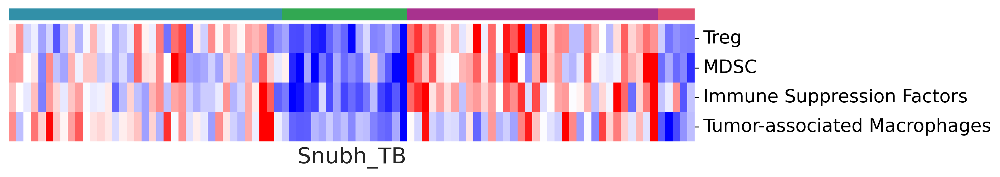

In [899]:
fig = plt.figure(figsize=(10, 2), dpi= 150)
widths = [1]
heights = [1,10]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.05, wspace=0.01, width_ratios=widths, height_ratios=heights)

final_int_map = dict(zip(head['Final Subtype'].unique(),range(head['Final Subtype'].nunique())))
final = head['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
ax = fig.add_subplot(gs[0, 0])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
# ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.22, 1.6),
#                               fontsize=10, markerscale=2, frameon=False, ncol=4, columnspacing=1)
# ax_legend.set_title('$\\bf{Subtype}$',prop={'size':10})
# ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False

ax = fig.add_subplot(gs[1, 0])
sns.heatmap(sig_gene_score_std, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
#sns.heatmap(sig_gene_score_std, cmap='bwr', vmin=0, vmax=1, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=15)
#ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True
plt.show()

In [900]:
files_tumor = ['MSigDB_Hallmark_2020-TumorType-ssGSEA.csv',
         'KEGG_2021_Human-TumorType-ssGSEA.csv',
         'GO_Biological_Process_2021-TumorType-ssGSEA.csv',
         'Reactome_2016-TumorType-ssGSEA.csv',
        ]
files_tme = ['MSigDB_Hallmark_2020-TMEType-ssGSEA.csv',
         'KEGG_2021_Human-TMEType-ssGSEA.csv',
         'GO_Biological_Process_2021-TMEType-ssGSEA.csv',
         'Reactome_2016-TMEType-ssGSEA.csv',
        ]

tumor_df = []
for file in files_tumor:
    df_ = pd.read_csv(file,index_col=0)
    tumor_df.append(df_)
tumor_score=pd.concat(tumor_df,axis=0).T.loc[order,:]


tme_df = []
for file in files_tme:
    df_ = pd.read_csv(file,index_col=0)
    tme_df.append(df_)
tme_score=pd.concat(tme_df,axis=0).T.loc[order,:]


In [939]:
EMT = [
    'epithelial to mesenchymal transition (GO:0001837)',
    'positive regulation of epithelial to mesenchymal transition (GO:0010718)',
    'Epithelial Mesenchymal Transition' 
]

Junction_Org = [
    'Cell-cell junction organization Homo sapiens R-HSA-421270',
    'Cell junction organization Homo sapiens R-HSA-446728',
]

TGFB = [
    'TGF-beta Signaling'
]

Angiogenesis = [
    'positive regulation of blood vessel endothelial cell migration (GO:0043536)',
    'Signaling by VEGF Homo sapiens R-HSA-194138',
    'VEGFA-VEGFR2 Pathway Homo sapiens R-HSA-4420097',
    'VEGF signaling pathway',
]


# WNT = [
#     'non-canonical Wnt signaling pathway (GO:0035567)',
#     'Beta-catenin independent WNT signaling Homo sapiens R-HSA-3858494',
#     'Signaling by WNT in cancer Homo sapiens R-HSA-4791275',
# ]
scaler = StandardScaler()
tumor = pd.DataFrame(scaler.fit_transform(tumor_score), columns=tumor_score.columns, index=tumor_score.index).T
Tumor_Features = EMT+Junction_Org+TGFB+Angiogenesis
tumor = tumor.loc[Tumor_Features,:]

Treg = [
    'negative regulation of T cell activation (GO:0050868)',
    'negative regulation of T cell proliferation (GO:0042130)',
    'IL-2/STAT5 Signaling'
]

PDL1 = [
    'PD-1 signaling Homo sapiens R-HSA-389948',
    'PD-L1 expression and PD-1 checkpoint pathway in cancer'  
]
cellcycle = [
    'Mitotic G1-G1/S phases Homo sapiens R-HSA-453279',
    'G1/S Transition Homo sapiens R-HSA-69206',
    'Cell cycle',
    'G2-M Checkpoint'
]
neutrophil = [
    'neutrophil mediated immunity (GO:0002446)',
    'neutrophil degranulation (GO:0043312)',
    'neutrophil activation involved in immune response (GO:0002283)',
    'Neutrophil extracellular trap formation',
]



#df_tme_score.loc[Innate_Immune,:].sort_values(by='scores',ascending=False)

tme = pd.DataFrame(scaler.fit_transform(tme_score), columns=tme_score.columns, index=tme_score.index).T
TME_Features = Treg+PDL1+cellcycle+neutrophil
tme = tme.loc[TME_Features,:]

ssGSEA = pd.concat([tumor,tme],axis=0)
ssGSEA

,21-T00054_FT-01,21-T00875_FT-01,21-T01039_FT-01,21-T00511_FT-01,19-T00776_FO-01,19-T00506_FO-01,20-T00672_FT-01,22-T00038_FT-01,21-T00500_FT-01,20-T00503_FO-01,...,19-T00545_FO-01,19-T00073_FO-01,19-T00501_FO-01,21-T00611_FT-01,21-T00687_FT-01,18-02904_FO-01,20-T00360_FO-01,19-T00668_FO-01,21-T00346_FT-01,19-T00201_FO-01
Term|NES,,,,,,,,,,,,,,,,,,,,,
epithelial to mesenchymal transition (GO:0001837),-0.230961,0.217922,-0.402560,-0.510937,-1.342712,-0.082635,-0.306277,-1.325407,-0.452905,0.094855,...,2.081305,0.242671,0.296147,0.962058,0.084178,-0.563862,1.029065,-0.465615,0.157687,-0.105149
positive regulation of epithelial to mesenchymal transition (GO:0010718),-0.707538,-0.035200,-0.571650,-0.348790,-1.365860,0.749643,0.501062,-1.119707,-0.572568,-0.284265,...,1.335376,-0.488252,-0.412973,1.232673,-0.149635,-1.010853,0.957150,0.469010,-0.183040,0.069923
Epithelial Mesenchymal Transition,-0.527799,0.707158,-0.000631,0.276213,-0.259870,-0.121282,-0.157640,-0.236471,1.238947,0.089050,...,1.536492,0.859630,0.560278,0.409950,0.523561,-0.356315,1.537837,-0.439702,0.536458,-0.112480
Cell-cell junction organization Homo sapiens R-HSA-421270,1.065179,0.263357,0.583459,0.127817,1.216549,0.135890,0.759623,0.727802,0.462644,0.817997,...,-0.430087,-0.760762,-0.229175,-1.864512,-0.650028,-0.224915,0.029063,-1.026908,0.657909,0.497498
Cell junction organization Homo sapiens R-HSA-446728,1.086696,0.456172,0.730164,0.390684,1.224659,0.117779,0.932197,0.841753,0.691590,0.249565,...,-0.201661,-0.973553,-0.087481,-1.672827,-0.827167,-0.225596,0.163236,-1.355868,0.662916,0.542191
TGF-beta Signaling,-0.286796,0.261457,0.062184,-0.804761,-0.229047,0.456774,0.387700,-0.174957,0.084347,-0.630038,...,2.461898,-0.477416,0.111879,-0.302827,0.383650,-0.004856,1.323710,-0.562069,0.657765,0.763953
positive regulation of blood vessel endothelial cell migration (GO:0043536),-1.129438,-0.236031,-1.010717,0.425535,-0.842847,0.563368,-0.944928,-0.079658,0.018522,-1.298753,...,2.172247,0.486194,0.718407,1.056612,0.674967,0.519789,0.475740,0.266272,0.044086,0.964179
Signaling by VEGF Homo sapiens R-HSA-194138,0.230541,-0.140207,-0.810487,0.257837,-0.970429,-0.101014,-0.415650,-0.344208,-0.314350,-0.418312,...,1.514026,0.078089,0.860485,1.842711,1.813523,-0.043214,0.834695,-0.743064,0.252344,-0.013573
VEGFA-VEGFR2 Pathway Homo sapiens R-HSA-4420097,0.211448,-0.040236,-0.829077,0.243266,-0.962611,-0.140781,-0.500048,-0.329884,-0.353030,-0.495375,...,1.254790,0.018785,0.904890,1.813691,1.823859,0.072623,0.882739,-0.756812,0.214757,0.013466


In [ ]:
# tumor_signatures = ['EMT']*3
# tumor_signatures = tumor_signatures+['Cell junction organization']*2
# tumor_signatures = tumor_signatures+['TGF-beta']
# tumor_signatures = tumor_signatures+['Angiogenesis']*4

# tumor_sig_df = pd.DataFrame(tumor_signatures,columns=['Signature'])
# tumor_sig_int_map = dict(zip(tumor_sig_df['Signature'].unique(),range(tumor_sig_df['Signature'].nunique())))
# tumor_sigtype = tumor_sig_df['Signature'].map(tumor_sig_int_map).to_frame('Signature')
# tumor_sig_color = mcp.gen_color(cmap="Spectral",n=tumor_sig_df['Signature'].nunique())
# tumor_sigtype_lut = dict(zip(tumor_sig_df['Signature'].unique(), tumor_sig_color))


# tme_signatures = ['Treg']*3
# tme_signatures = tme_signatures+['PD-L1']*2
# tme_signatures = tme_signatures+['Cellcycle']*5
# tme_sig_df = pd.DataFrame(tme_signatures,columns=['Signature'])
# tme_sig_int_map = dict(zip(tme_sig_df['Signature'].unique(),range(tme_sig_df['Signature'].nunique())))
# tme_sigtype = tme_sig_df['Signature'].map(tme_sig_int_map).to_frame('Signature')
# tme_sig_color = mcp.gen_color(cmap="Spectral",n=tme_sig_df['Signature'].nunique())
# tme_sigtype_lut = dict(zip(tme_sig_df['Signature'].unique(), tme_sig_color))

In [850]:
tumor_sig

['EMT',
 'EMT',
 'EMT',
 'Cell junction organization',
 'Cell junction organization',
 'TGF-beta',
 'Angiogenesis',
 'Angiogenesis',
 'Angiogenesis',
 'Angiogenesis']

In [940]:
tumor_sig = ['EMT']*len(EMT)
tumor_sig = tumor_sig+['Cell junction organization']*len(Junction_Org)
tumor_sig = tumor_sig+['TGF-beta']*len(TGFB)
tumor_sig = tumor_sig+['Angiogenesis']*len(Angiogenesis)


tme_sig = ['Treg']*len(Treg)
tme_sig = tme_sig+['PD-L1']*len(PDL1)
tme_sig = tme_sig+['Cellcycle']*len(cellcycle)
tme_sig = tme_sig+['Neutrophil']*len(neutrophil)

signatures = tumor_sig+tme_sig

tumor_len = len(Tumor_Features)
tme_len = len(TME_Features)

sig_df = pd.DataFrame(signatures,columns=['Signature'])
sig_int_map = dict(zip(sig_df['Signature'].unique(),range(sig_df['Signature'].nunique())))
sigtype = sig_df['Signature'].map(sig_int_map).to_frame('Signature')
sig_color = mcp.gen_color(cmap="Spectral",n=sig_df['Signature'].nunique())
sigtype_lut = dict(zip(sig_df['Signature'].unique(), sig_color))



tumor_sigtype = sigtype.iloc[:tumor_len,:]
tumor_lut = { key: sigtype_lut[key] for key in sorted(set(tumor_sig), key=tumor_sig.index) }
tme_sigtype = sigtype.iloc[tumor_len:,:]
tme_lut = { key: sigtype_lut[key] for key in sorted(set(tme_sig), key=tme_sig.index) }

In [941]:
import textwrap
def idx_rename(x):
    if x.find('GO') != -1 or x.find('R-HSA') != -1:
        x_parse = x.split(' ')
        ret =  ' '.join(x_parse[:-1])
        ret = textwrap.fill(ret, 40)
        return ret
    else:
        ret = textwrap.fill(x, 40)
        return ret
    
    
        
ssGSEA.index = ssGSEA.index.map(idx_rename)

tumor.index = tumor.index.map(idx_rename)
tme.index = tme.index.map(idx_rename)

In [942]:
fig = plt.figure(figsize=(25, 40), dpi= 150)
widths = [1,25]
heights = [1,8,22,22]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.08, wspace=0.01, width_ratios=widths, height_ratios=heights)


final_int_map = dict(zip(head['Final Subtype'].unique(),range(head['Final Subtype'].nunique())))
final = head['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
ax = fig.add_subplot(gs[0, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.25, 1.55),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
#ax_legend.set_title('Subtype',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False


ax = fig.add_subplot(gs[1, 1])
sns.heatmap(sig_gene_score_std, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_title('knowledge-based functional gene expression score',fontdict={'fontsize':30,'weight':'bold'})
ax.set_xticks([])
ax.set_ylabel('')
ax.set_xlabel('')
ax.tick_params(axis='y', labelsize=30)
#ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


ax = fig.add_subplot(gs[2, 0])
sns.heatmap(tumor_sigtype, cmap=list(tumor_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=tumor_lut[name]) for name in tumor_lut]
ax_legend = ax.legend(handles, tumor_lut, bbox_to_anchor=(24, -1.05), frameon=False, 
                              fontsize=35, markerscale=3, ncol=4)

ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_ylabel('Tumor Signatures ',fontdict={'fontsize':30,'weight':'bold'})
ax.margins(0)

cbar_ax = fig.add_axes([1.1, 0.84, 0.02, 0.03], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

ax = fig.add_subplot(gs[2, 1])
sns.heatmap(tumor, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
#ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('ssGSEA NES (adjusted p-value < 1e-5)',fontdict={'fontsize':30,'weight':'bold'})


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(tme_sigtype, cmap=list(tme_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=tme_lut[name]) for name in tme_lut]
ax_legend = ax.legend(handles, tme_lut, bbox_to_anchor=(16.6, -0.08), frameon=False, 
                              fontsize=35, markerscale=3, ncol=4)

ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_ylabel('TME Signatures ',fontdict={'fontsize':30,'weight':'bold'})
ax.margins(0)



ax = fig.add_subplot(gs[3, 1])
sns.heatmap(tme, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
#ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('ssGSEA NES (adjusted p-value < 1e-5)',fontdict={'fontsize':30,'weight':'bold'})
plt.show()

plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True

In [998]:
tumor_score_df = tumor_score.loc[:,Tumor_Features].T
tme_score_df = tme_score.loc[:,TME_Features].T
ssScore = pd.concat([tumor_score_df,tme_score_df],axis=0)
ssScore['Type'] = signatures
groupby_score = ssScore.groupby('Type').sum().T
groupby_score = pd.concat([groupby_score, annotation.loc[:,['Final Subtype']]], axis=1)
groupby_score

,Angiogenesis,Cell junction organization,Cellcycle,EMT,Neutrophil,PD-L1,TGF-beta,Treg,Final Subtype
Snubh_TB,,,,,,,,,
21-T00054_FT-01,0.731468,0.705340,0.491957,0.248622,1.092787,0.227572,0.410511,0.007066,C1-E1
21-T00875_FT-01,0.768147,0.605682,0.143123,0.443670,0.988593,0.137650,0.443973,-0.184331,C1-E1
21-T01039_FT-01,0.692842,0.646787,0.586152,0.298590,0.781238,0.064583,0.431811,-0.105415,C1-E1
21-T00511_FT-01,0.882997,0.591271,0.657085,0.333485,0.798250,0.081794,0.378897,0.021837,C1-E1
19-T00776_FO-01,0.630392,0.725275,0.858442,0.160562,0.256966,0.078451,0.414036,-0.294282,C1-E1
...,...,...,...,...,...,...,...,...,...
18-02904_FO-01,0.893225,0.527349,1.024144,0.224404,0.538972,0.100653,0.427719,-0.326552,C2-E2
20-T00360_FO-01,0.878704,0.570121,0.772109,0.642849,0.986338,-0.098296,0.508808,-0.331298,C2-E2
19-T00668_FO-01,0.780699,0.398065,1.420931,0.318555,0.514762,0.150465,0.393710,-0.125332,C2-E2


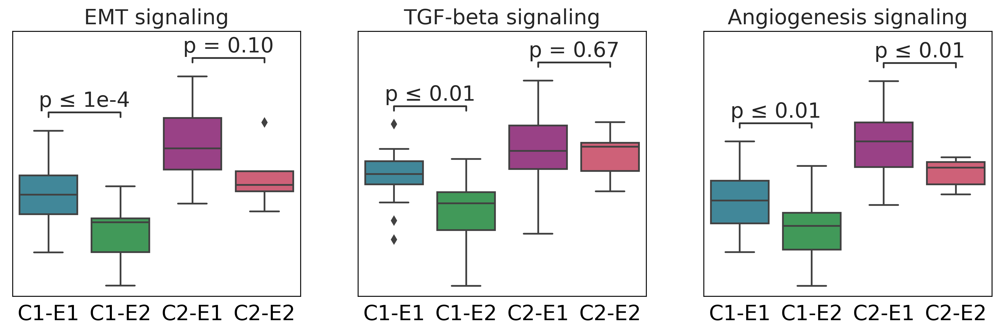

In [999]:
import seaborn as sns
from statannot import add_stat_annotation
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
#?add_stat_annotation
tumor_sig = ['EMT','TGF-beta','Angiogenesis']


fig = plt.figure(figsize=(15, 10), dpi= 150)
widths = [1,1,1]
heights = [1,1]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.4, wspace=0.2, width_ratios=widths, height_ratios=heights)



i=0
j=0
for sigtype in tumor_sig:
    ax = fig.add_subplot(gs[j, i])
    x = "Final Subtype"
    y = sigtype
    order = ['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']
    title='{} signaling'.format(sigtype)
    ax = sns.boxplot(data=groupby_score, x=x, y=y, order=order, ax=ax, palette=list(final_lut.values()))
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title(title)
    test_results = add_stat_annotation(ax, data=groupby_score, x=x, y=y, order=order,
                                       box_pairs=[('C1-E1', 'C1-E2'), ('C2-E1', 'C2-E2')],
                                       test='t-test_welch', text_format='simple', comparisons_correction=None,
                                       loc='inside', verbose=0)
    
    if i < len(widths)-1:
        i+=1
    else:
        j+=1
        i=0
    
plt.show()        
        
    


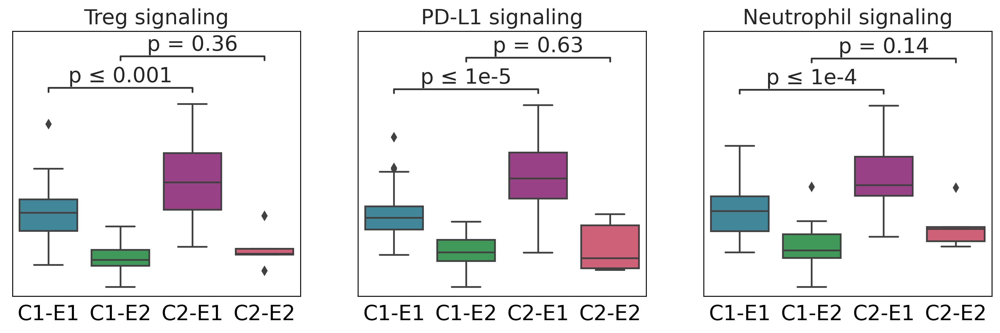

In [1000]:
tme_sig = ['Treg','PD-L1','Neutrophil']

fig = plt.figure(figsize=(15, 10), dpi= 150)
widths = [1,1,1]
heights = [1,1]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.4, wspace=0.2, width_ratios=widths, height_ratios=heights)



i=0
j=0

for sigtype in tme_sig:
    ax = fig.add_subplot(gs[j, i])
    
    x = "Final Subtype"
    y = sigtype
    order = ['C1-E1', 'C1-E2', 'C2-E1', 'C2-E2']
    title='{} signaling'.format(sigtype)
    ax = sns.boxplot(data=groupby_score, x=x, y=y, order=order, palette=list(final_lut.values()),ax=ax)
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title(title)
    
    test_results = add_stat_annotation(ax, data=groupby_score, x=x, y=y, order=order, 
                                       box_pairs=[('C1-E1', 'C2-E1'), ('C1-E2', 'C2-E2')],
                                       test='t-test_welch', text_format='simple', comparisons_correction=None,
                                       loc='inside', verbose=0)
    if i < len(widths)-1:
        i+=1
    else:
        j+=1
        i=0
    
plt.show()

In [987]:
def idx_rename(x):
    if x.find('GO') != -1 or x.find('R-HSA') != -1:
        x_parse = x.split(' ')
        ret =  ' '.join(x_parse[:-1])
        ret = textwrap.fill(ret, 60)
        return ret
    else:
        ret = textwrap.fill(x, 60)
        return ret

FFX_Features = [
    'positive regulation of interleukin-8 production (GO:0032757)',
    'positive regulation of chemokine production (GO:0032722)',
    'Neutrophil extracellular trap formation',
    'neutrophil activation involved in immune response (GO:0002283)',
    'neutrophil degranulation (GO:0043312)',
    'neutrophil mediated immunity (GO:0002446)',
]


FFX_ssScore_df = tme_score.loc[:,FFX_Features]
FFX_ssScore_df.columns = FFX_ssScore_df.columns.map(idx_rename)
groupby_score = pd.concat([FFX_ssScore_df, annotation.loc[:,['CTx_response_FFX']]], axis=1)
ffx_features = groupby_score.columns[:-1]

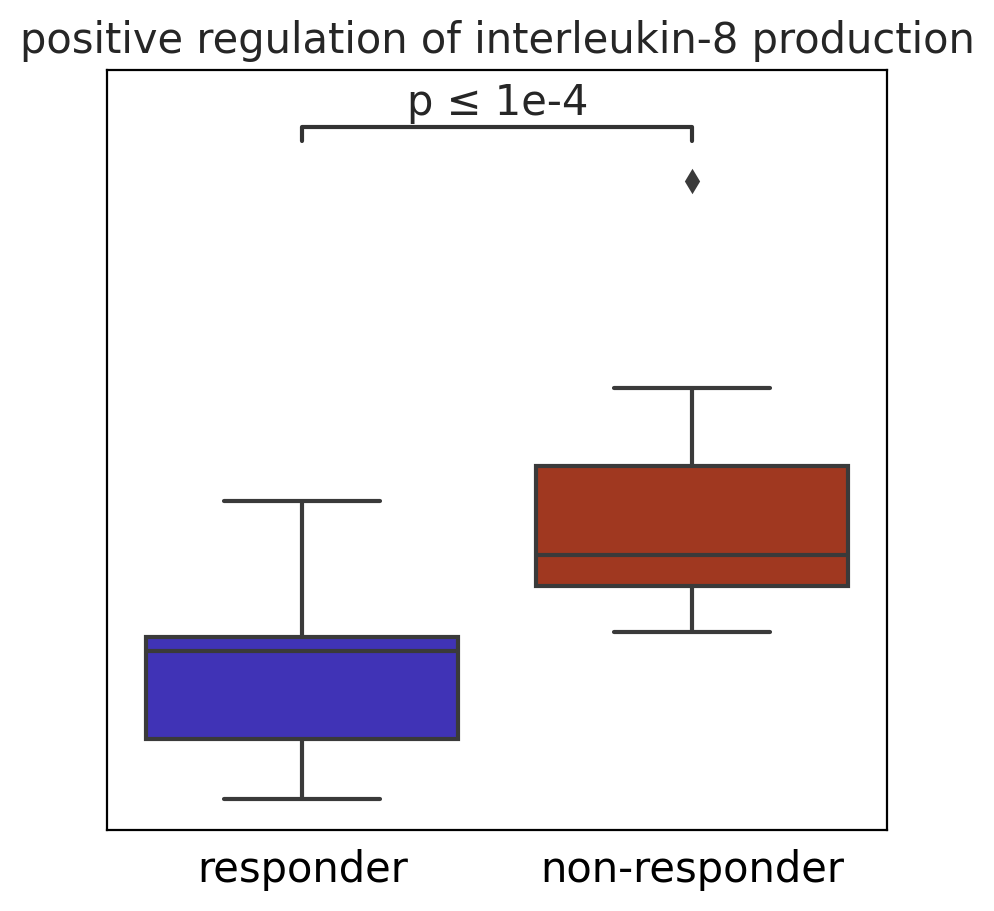

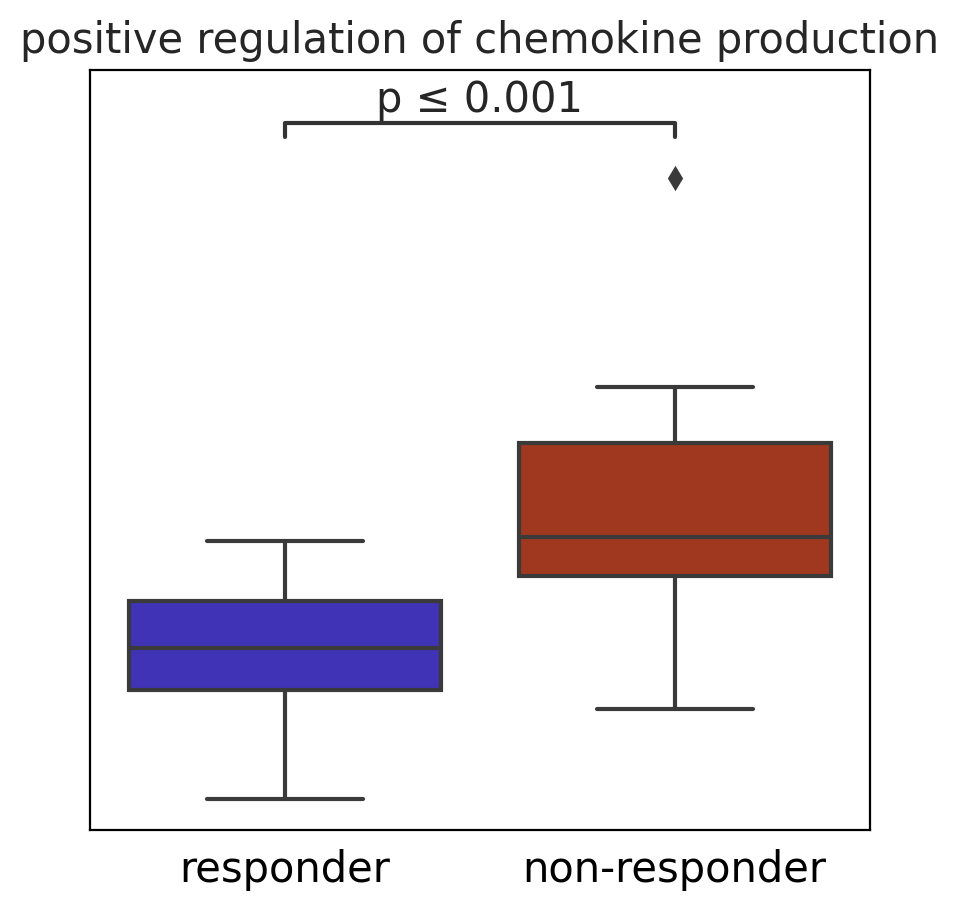

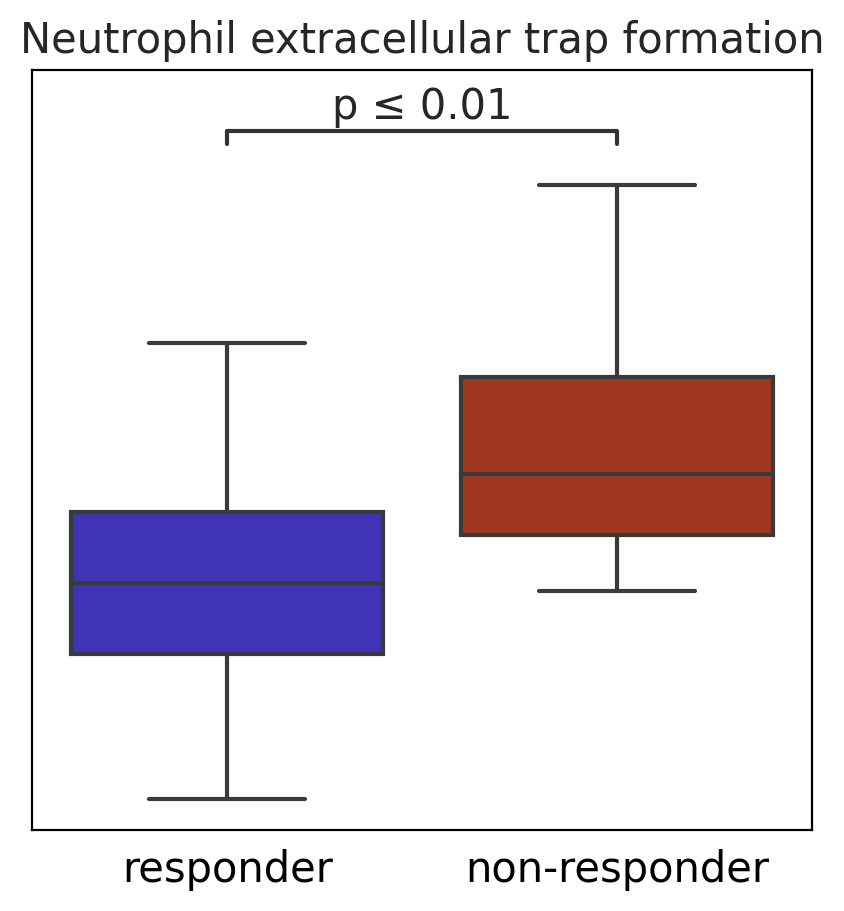

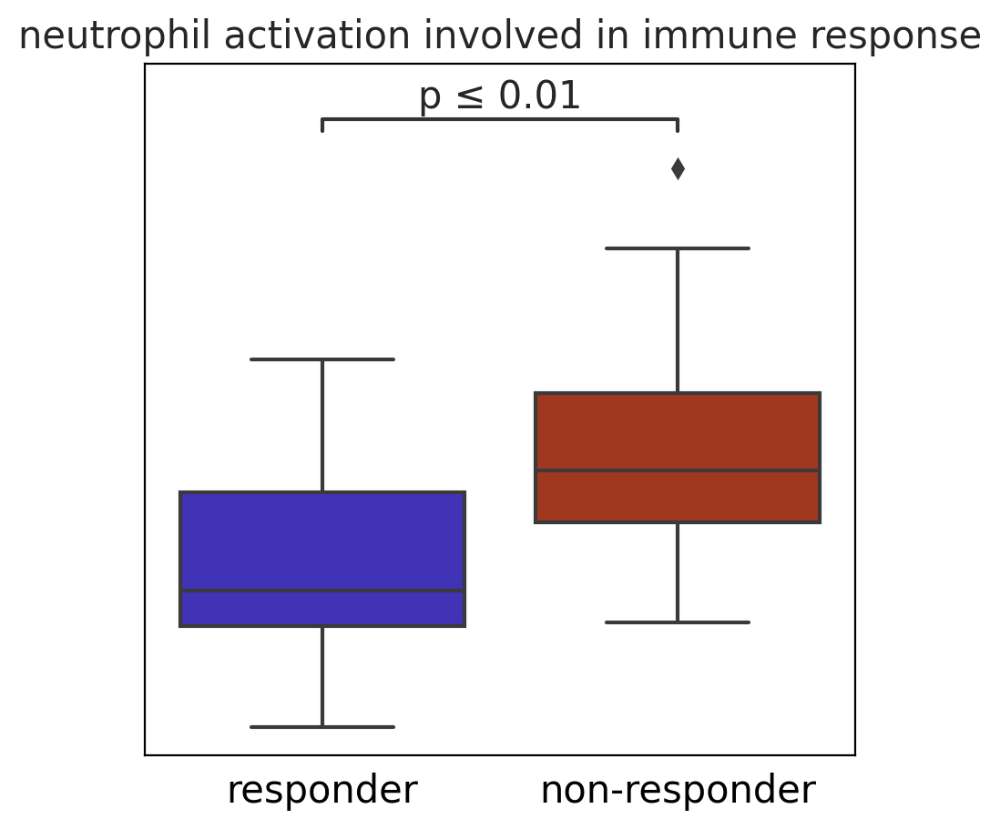

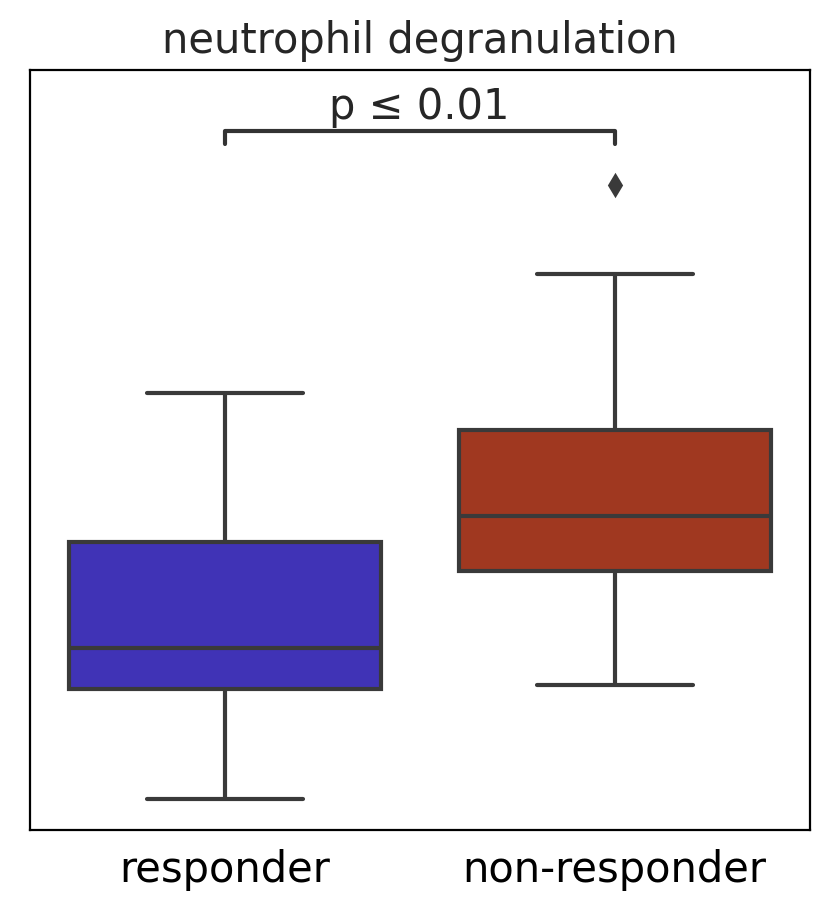

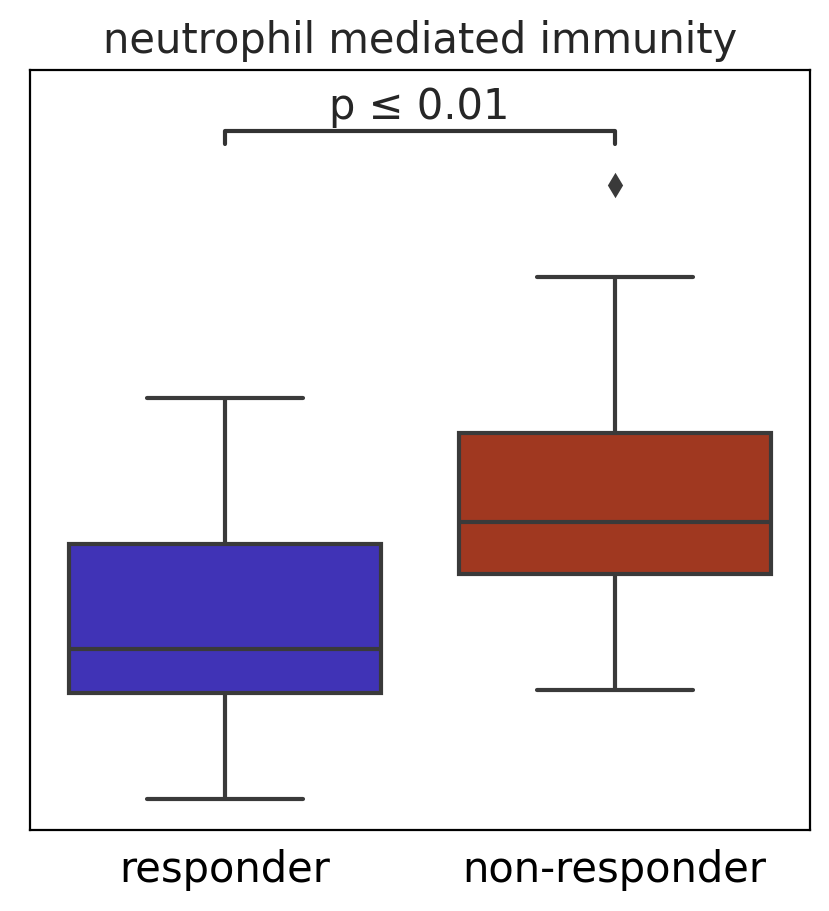

In [990]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=15)

for sigtype in ffx_features:
    x = "CTx_response_FFX"
    y = sigtype
    order = ['responder', 'non-responder']
    title='{}'.format(sigtype)
    ax = sns.boxplot(data=groupby_score, x=x, y=y, order=order, palette=['#2e1dcc','#b52b0b'])
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title(title)
    test_results = add_stat_annotation(ax, data=groupby_score, x=x, y=y, order=order,
                                       box_pairs=[('responder', 'non-responder')],
                                       test='t-test_ind', text_format='simple', comparisons_correction=None,
                                       loc='inside', verbose=0)
    plt.show()
   

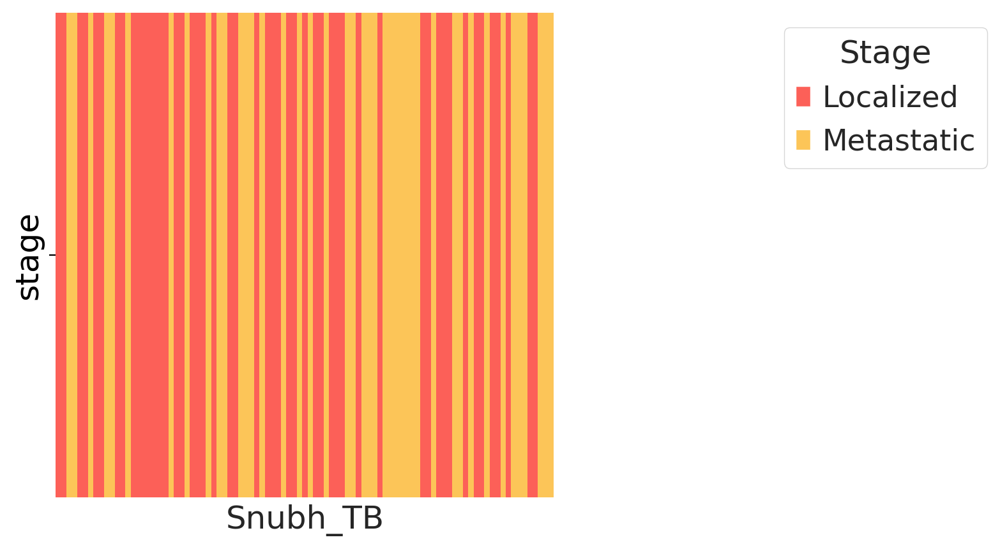

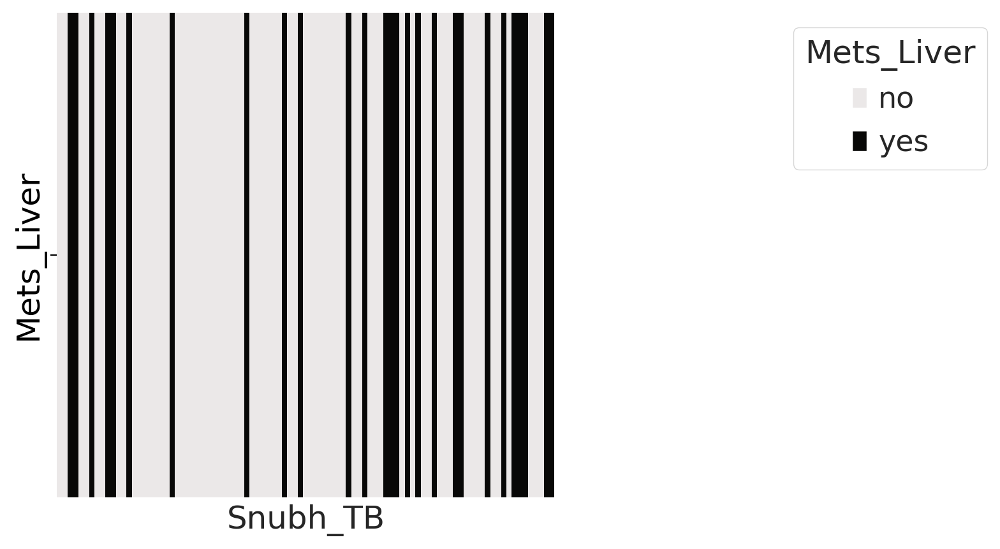

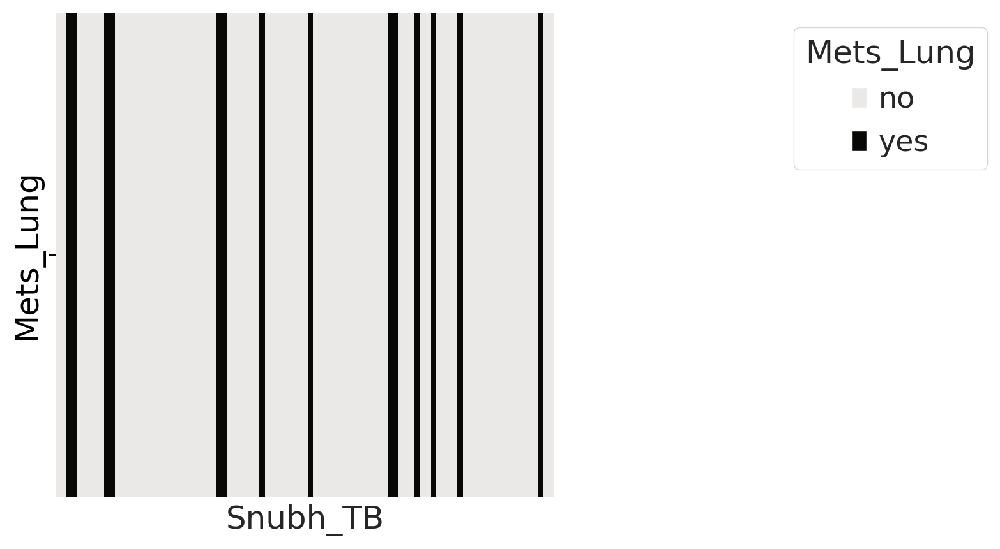

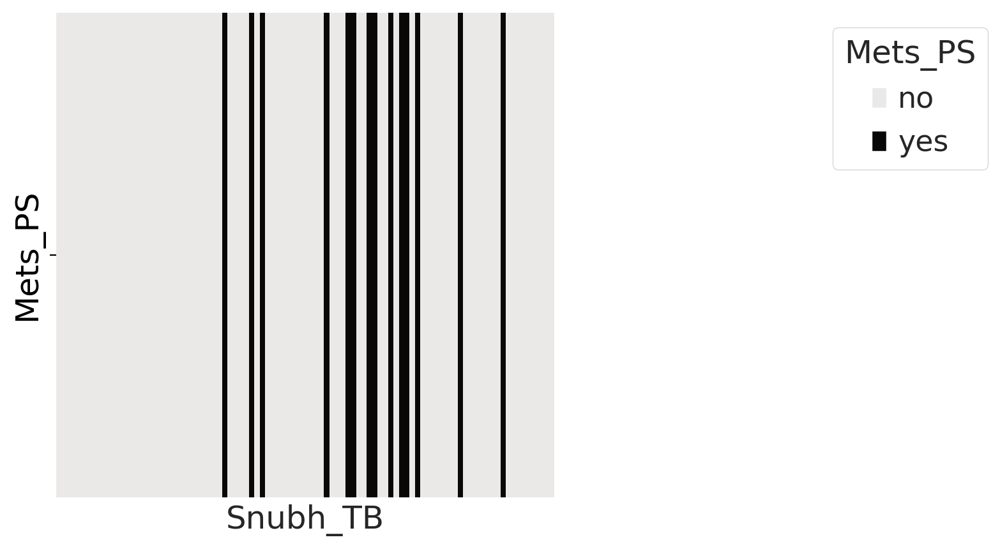

In [943]:
order = list(annotation.index)
with_stage = annotation.copy()
with_stage = with_stage.loc[order,:]
with_stage.loc[:,['Mets_liver_C','Mets_lung_C','Mets_PS_C']] = with_stage.loc[:,['Mets_liver_C','Mets_lung_C','Mets_PS_C']].astype(str)
with_stage = with_stage.replace('nan','no')

stage_map = dict(zip(with_stage['stage_C'].unique(),range(with_stage['stage_C'].nunique())))
stage_color = ['#fc6058','#fcc558']
stage_lut = dict(zip(with_stage['stage_C'].unique(), stage_color))
stage = with_stage['stage_C'].map(stage_map).astype(int).to_frame('stage').T
ax=sns.heatmap(stage, cmap=stage_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=stage_lut[name]) for name in stage_lut]
ax.legend(handles4, stage_lut, title='Stage',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

liver_map = dict(zip(with_stage['Mets_liver_C'].unique(),range(with_stage['Mets_liver_C'].nunique())))
liver_color = ['#ebe8e8','#080807']
liver_lut = dict(zip(with_stage['Mets_liver_C'].unique(), liver_color))
liver_lut
liver = with_stage['Mets_liver_C'].map(liver_map).astype(int).to_frame('Mets_Liver').T
ax=sns.heatmap(liver, cmap=liver_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=liver_lut[name]) for name in liver_lut]
ax.legend(handles4, liver_lut, title='Mets_Liver',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

lung_map = dict(zip(with_stage['Mets_lung_C'].unique(),range(with_stage['Mets_lung_C'].nunique())))
lung_color = ['#ebe8e8','#080807']
lung_lut = dict(zip(with_stage['Mets_lung_C'].unique(), lung_color))

lung = with_stage['Mets_lung_C'].map(lung_map).astype(int).to_frame('Mets_Lung').T
ax=sns.heatmap(lung, cmap=lung_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=lung_lut[name]) for name in lung_lut]
ax.legend(handles4, lung_lut, title='Mets_Lung',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

ps_map = dict(zip(with_stage['Mets_PS_C'].unique(),range(with_stage['Mets_PS_C'].nunique())))
ps_color = ['#ebe8e8','#080807']
ps_lut = dict(zip(with_stage['Mets_PS_C'].unique(), ps_color))

ps = with_stage['Mets_PS_C'].map(ps_map).astype(int).to_frame('Mets_PS').T
ax=sns.heatmap(ps, cmap=ps_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=ps_lut[name]) for name in ps_lut]
ax.legend(handles4, ps_lut, title='Mets_PS',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

In [944]:
FFX_lut

{'responder': '#2e1dcc', 'non-responder': '#b52b0b', 'NA': '#ebe8e8'}

In [945]:
FFX

,21-T00054_FT-01,21-T00875_FT-01,21-T01039_FT-01,21-T00511_FT-01,19-T00776_FO-01,19-T00506_FO-01,20-T00672_FT-01,22-T00038_FT-01,21-T00500_FT-01,20-T00503_FO-01,...,19-T00545_FO-01,19-T00073_FO-01,19-T00501_FO-01,21-T00611_FT-01,21-T00687_FT-01,18-02904_FO-01,20-T00360_FO-01,19-T00668_FO-01,21-T00346_FT-01,19-T00201_FO-01
FFX,0.0,1.0,1.0,1.0,2.0,1.0,0.0,2.0,1.0,0.0,...,1.0,2.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,2.0


In [946]:
FFX.loc['FFX'].unique()

array([0., 1., 2.])

In [947]:
FFX_map

{'non-responder': 0, 'NA': 1, 'responder': 2}

In [948]:
FFX_lut = {'responder':'#2e1dcc','non-responder':'#b52b0b','NA':'#ebe8e8'}

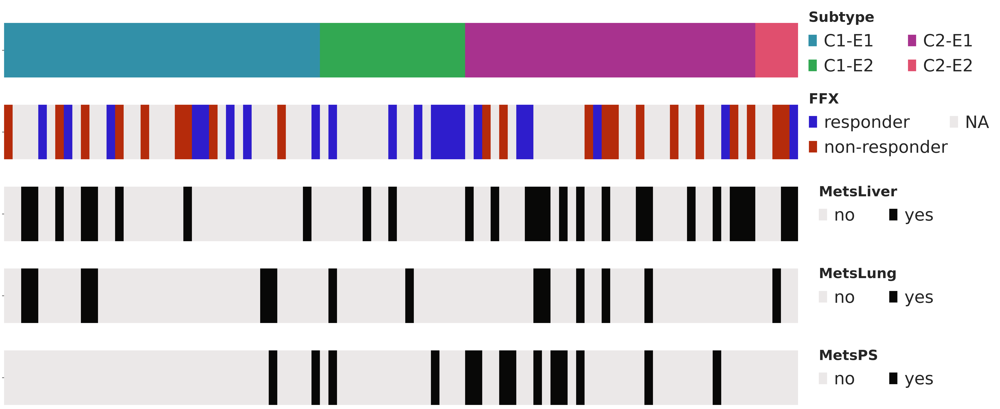

In [949]:
fig = plt.figure(figsize=(25, 15), dpi= 150)
widths = [1]
heights = [1,1,1,1,1,1]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.5, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[1, 0])
cmap = [FFX_lut[key] for key in list(FFX_map.keys())]
sns.heatmap(FFX, cmap=cmap, cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=FFX_lut[name]) for name in ['responder', 'non-responder', 'NA']]
ax_legend = ax.legend(handles, {'responder':'#2e1dcc','non-responder':'#b52b0b','NA':'#ebe8e8'}, 
                      bbox_to_anchor=(1.26, 1.5), frameon=False, 
                              fontsize=30, markerscale=2, ncol=2, labelspacing=0.5, columnspacing=0.1)
ax_legend.set_title('$\\bf{FFX}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
#ax.set_ylabel('FFX',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)

final_int_map = dict(zip(head['Final Subtype'].unique(),range(head['Final Subtype'].nunique())))
final = head['Final Subtype'].map(final_int_map).to_frame('Final Subtype').T.astype(float)
ax = fig.add_subplot(gs[0, 0])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.24, 1.5),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.margins(0)

# ax = fig.add_subplot(gs[2, 0])
# sns.heatmap(stage, cmap=list(stage_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=stage_lut[name]) for name in stage_lut]
# ax_legend = ax.legend(handles, stage_lut, bbox_to_anchor=(1.17, 1.5),
#                               fontsize=30, markerscale=2, frameon=False, ncol=1)
# ax_legend.set_title('$\\bf{Stage}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels([])
# ax.margins(0)

ax = fig.add_subplot(gs[2, 0])
sns.heatmap(liver, cmap=list(liver_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=liver_lut[name]) for name in liver_lut]
ax_legend = ax.legend(handles, liver_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsLiver}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.margins(0)

ax = fig.add_subplot(gs[3, 0])
sns.heatmap(lung, cmap=list(lung_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=lung_lut[name]) for name in lung_lut]
ax_legend = ax.legend(handles, lung_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsLung}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.margins(0)

ax = fig.add_subplot(gs[4, 0])
sns.heatmap(ps, cmap=list(ps_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=ps_lut[name]) for name in ps_lut]
ax_legend = ax.legend(handles, ps_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsPS}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.margins(0)

plt.show()

In [950]:
ssScore

,21-T00054_FT-01,21-T00875_FT-01,21-T01039_FT-01,21-T00511_FT-01,19-T00776_FO-01,19-T00506_FO-01,20-T00672_FT-01,22-T00038_FT-01,21-T00500_FT-01,20-T00503_FO-01,...,19-T00073_FO-01,19-T00501_FO-01,21-T00611_FT-01,21-T00687_FT-01,18-02904_FO-01,20-T00360_FO-01,19-T00668_FO-01,21-T00346_FT-01,19-T00201_FO-01,Type
Term|NES,,,,,,,,,,,,,,,,,,,,,
epithelial to mesenchymal transition (GO:0001837),0.049042,0.078063,0.037948,0.030941,-0.022835,0.058631,0.044172,-0.021717,0.034693,0.070107,...,0.079663,0.083121,0.126173,0.069416,0.027519,0.130505,0.033871,0.074169,0.057176,EMT
positive regulation of epithelial to mesenchymal transition (GO:0010718),0.020844,0.064488,0.029665,0.044132,-0.021890,0.115435,0.099299,-0.005911,0.029606,0.048320,...,0.035079,0.039965,0.146790,0.057060,0.001155,0.128905,0.097218,0.054891,0.071312,EMT
Epithelial Mesenchymal Transition,0.178736,0.301119,0.230978,0.258413,0.205287,0.219021,0.215418,0.207606,0.353819,0.239865,...,0.316229,0.286563,0.271666,0.282925,0.195730,0.383439,0.187466,0.284203,0.219894,EMT
Cell-cell junction organization Homo sapiens R-HSA-421270,0.343527,0.281231,0.306101,0.270700,0.355288,0.271327,0.319787,0.317315,0.296714,0.324323,...,0.201663,0.242964,0.115909,0.210267,0.243295,0.263028,0.180985,0.311885,0.299422,Cell junction organization
Cell junction organization Homo sapiens R-HSA-446728,0.361813,0.324452,0.340687,0.320571,0.369988,0.304400,0.352658,0.347299,0.338401,0.312209,...,0.239734,0.292238,0.198299,0.248408,0.284054,0.307094,0.217080,0.336702,0.329549,Cell junction organization
TGF-beta Signaling,0.410511,0.443973,0.431811,0.378897,0.414036,0.455894,0.451679,0.417337,0.433163,0.389561,...,0.398876,0.434844,0.409532,0.451431,0.427719,0.508808,0.393710,0.468162,0.474643,TGF-beta
positive regulation of blood vessel endothelial cell migration (GO:0043536),0.170856,0.228685,0.178540,0.271507,0.189406,0.280429,0.182799,0.238807,0.245162,0.159896,...,0.275434,0.290465,0.312356,0.287653,0.277608,0.274757,0.261198,0.246817,0.306373,Angiogenesis
Signaling by VEGF Homo sapiens R-HSA-194138,0.196573,0.188700,0.174466,0.197153,0.171069,0.189532,0.182850,0.184368,0.185002,0.182794,...,0.193336,0.209951,0.230810,0.230190,0.190760,0.209403,0.175897,0.197036,0.191389,Angiogenesis
VEGFA-VEGFR2 Pathway Homo sapiens R-HSA-4420097,0.202021,0.196676,0.179923,0.202696,0.177087,0.194540,0.186911,0.190524,0.190033,0.187010,...,0.197929,0.216747,0.236048,0.236264,0.199072,0.216277,0.181458,0.202091,0.197816,Angiogenesis


In [951]:
with_stage

,N0,PID,dateA,Snubh_BB,pathology_number,tumorcellularity(pathology),DNA_RNA,methylSeq,metagenomic,liquid_number,...,Tumor Subtype,TME Subtype,Moffitt Subtype,Bailey Subtype,Chan-Seng-Yue Subtype,Bailey P/S,Bailey A/I,Final Subtype,Dataset,Bailey_Mixed
Snubh_TB,,,,,,,,,,,,,,,,,,,,,
21-T00054_FT-01,NaN,13691820,2021-01-20,21-B00269_EB-04,S 210003105,45,DNA+RNA,NaN,NaN,R214,...,C1,E1,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
21-T00875_FT-01,NaN,34956214,2021-11-01,NaN,S 210049507,NaN,RNA,NaN,NaN,NaN,...,C1,E1,Classical,Immunogenic,BasalLike-A,Squamous,Immunogenic,C1-E1,SNUBH,Squamous-Immunogenic
21-T01039_FT-01,NaN,35206741,2021-12-24,NaN,S 210058867,NaN,RNA,NaN,NaN,NaN,...,C1,E1,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
21-T00511_FT-01,NaN,17227694,2021-06-30,NaN,S 210029133,NaN,RNA,NaN,NaN,NaN,...,C1,E1,Classical,Pancreatic Progenitor,Classical-A,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
19-T00776_FO-01,sb2375,32183755,2019-12-30,19-B03158_EB-03,S 190062582,30,DNA+RNA,NaN,NaN,R124,...,C1,E1,Classical,Pancreatic Progenitor,Classical-B,Pancreatic Progenitor,Immunogenic,C1-E1,SNUBH,Pancreatic Progenitor-Immunogenic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18-02904_FO-01,sb1904,30311136,2018-12-19,18-02904_EB-02,S 180058106,35,DNA+RNA,NaN,NaN,NaN,...,C2,E2,BasalLike,Squamous,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic
20-T00360_FO-01,sb2088,22888938,2020-06-03,20-B01405_EB-03,S 200022294,55,DNA+RNA,NaN,NaN,NaN,...,C2,E2,BasalLike,Pancreatic Progenitor,Hybrid,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic
19-T00668_FO-01,sb2353,31995784,2019-11-13,19-B02684_EB-03,S 190054508,35,DNA+RNA,NaN,NaN,R115,...,C2,E2,BasalLike,Squamous,BasalLike-A,Squamous,Immunogenic,C2-E2,SNUBH,Squamous-Immunogenic


CTx_response_FFX  non-responder  responder
Tumor Subtype                             
C1                            9         15
C2                           12          6
0.1189907208931241


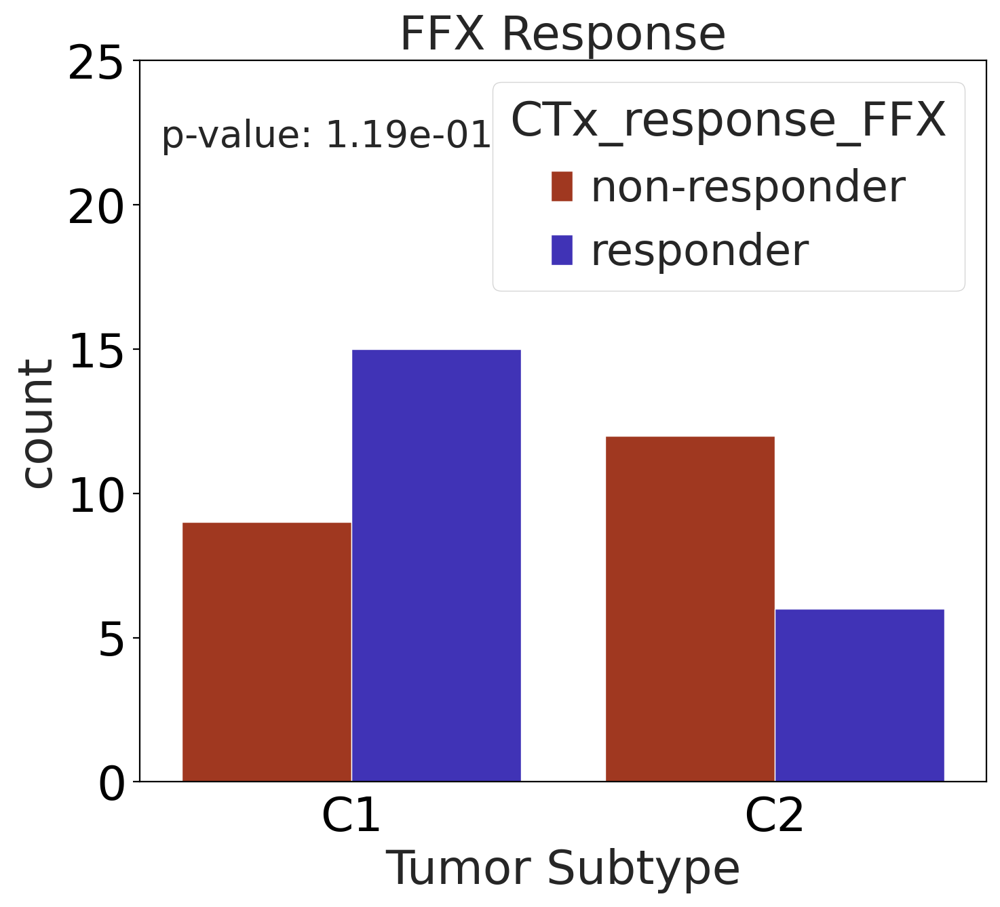

CTx_response_FFX  non-responder  responder
TME Subtype                               
E1                           19         13
E2                            2          8
0.07007553859334138


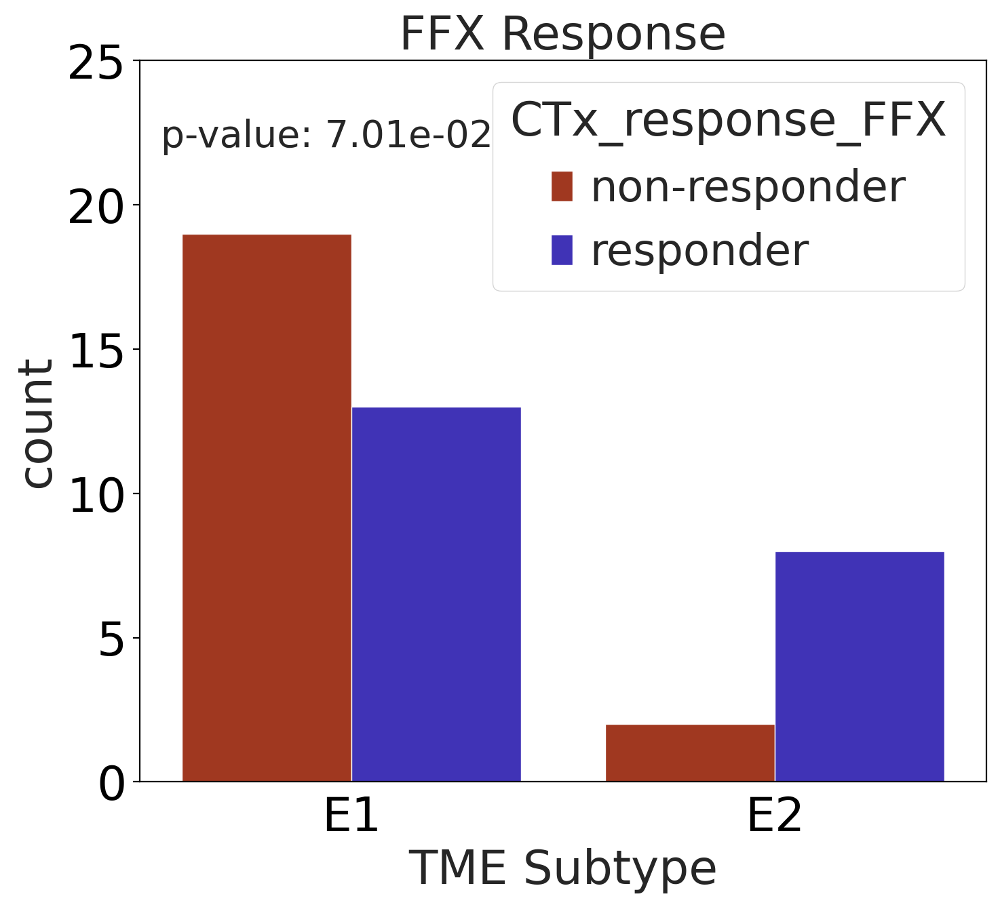

CTx_response_FFX  non-responder  responder
Final Subtype                             
C1-E1                         9          8
C1-E2                         0          7
C2-E1                        10          5
C2-E2                         2          1
0.028518933256690387
['C1-E1', 'C1-E2']
0.04869854331452281
['C2-E1', 'C1-E2']
0.013688056704732604
['C2-E2', 'C1-E2']
0.12050736908665413


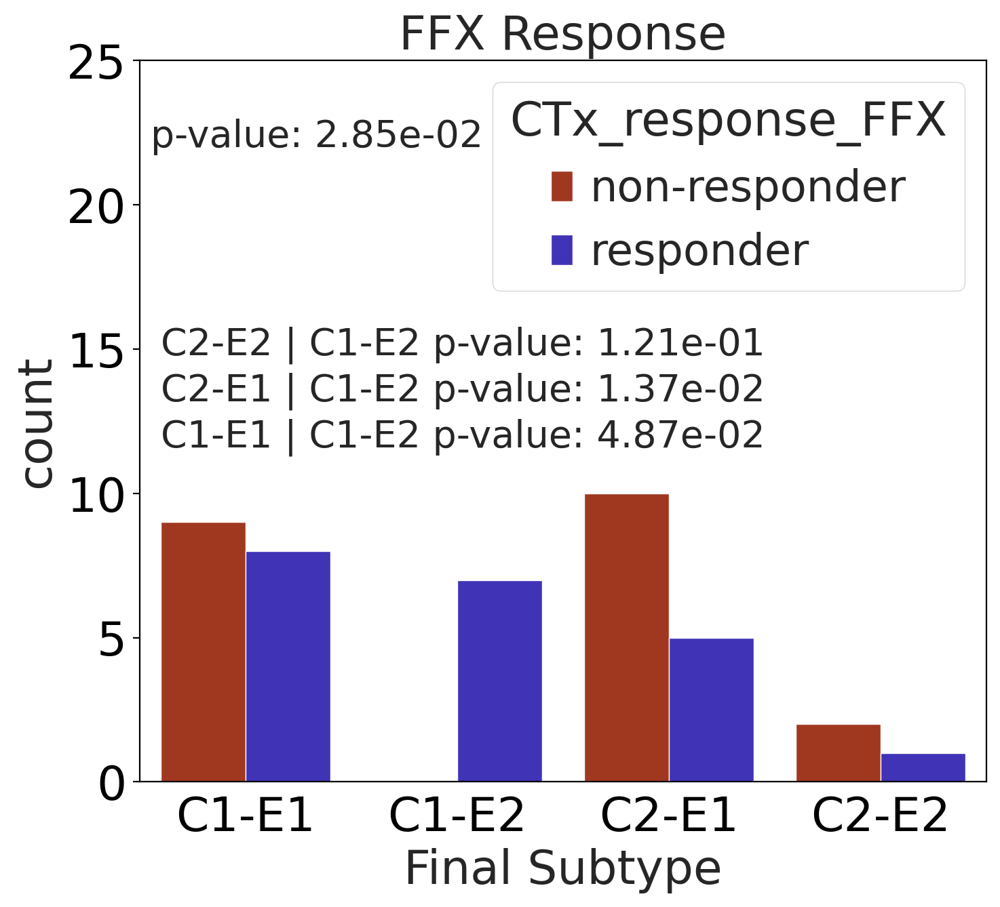

In [952]:
sc.settings.set_figure_params(dpi=100, figsize=(8,7), fontsize=25)

m = ~with_stage['CTx_response_FFX'].isna()
with_stage_sel = with_stage[m]
with_stage_sel


sns.countplot(x='Tumor Subtype', hue='CTx_response_FFX', data=with_stage_sel, palette=FFX_lut)
ct_table_ind=pd.crosstab(with_stage_sel['Tumor Subtype'],with_stage_sel['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.45, 22, 'p-value: {}'.format(p_val), fontsize=20)
plt.title('FFX Response')
plt.xlabel('Tumor Subtype')
plt.grid(False)
plt.ylim((0,25))
plt.show()

sns.countplot(x='TME Subtype', hue='CTx_response_FFX', data=with_stage_sel, palette=FFX_lut)
ct_table_ind=pd.crosstab(with_stage_sel['TME Subtype'],with_stage_sel['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.45, 22, 'p-value: {}'.format(p_val), fontsize=20)
plt.title('FFX Response')
plt.xlabel('TME Subtype')
plt.grid(False)
plt.ylim((0,25))
plt.show()

sns.countplot(x='Final Subtype', hue='CTx_response_FFX', data=with_stage_sel, palette=FFX_lut)  
ct_table_ind=pd.crosstab(with_stage_sel['Final Subtype'],with_stage_sel['CTx_response_FFX'])
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.45, 22, 'p-value: {}'.format(p_val), fontsize=20)
i=1
p1 = ['C1-E1','C1-E2']
p2 = ['C2-E1','C1-E2']
p3 = ['C2-E2','C1-E2']
pair_ = [p1,p2,p3]
for pair in pair_:
    ct_table_ind_tmp = ct_table_ind.loc[pair,:]
    chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind_tmp)
    p_val="{:.2e}".format(p)
    plt.text(-0.4, 10+i*1.6, '{} | {} p-value: {}'.format(pair[0],pair[1],p_val), fontsize=20)
    i+=1
    print(pair)
    print(p)


plt.title('FFX Response')
plt.xlabel('Final Subtype')
plt.grid(False)
plt.ylim((0,25))
plt.show()


# plt.show()

In [953]:
import plotly
def genSankey(df,cat_cols=[],value_cols='',title='Sankey Diagram',custom_color=None):
    
    colorPalette=mcp.gen_color(cmap="Spectral",n=len(cat_cols))
    labelList = []
    colorNumList = []
    for catCol in cat_cols:
        labelListTemp =  list(set(df[catCol].values))
        colorNumList.append(len(labelListTemp))
        labelList = labelList + labelListTemp
    
    if not custom_color:
        # remove duplicates from labelList
        labelList = list(dict.fromkeys(labelList))
        # define colors based on number of levels
        colorList = []
        for idx, colorNum in enumerate(colorNumList):
            colorList = colorList + [colorPalette[idx]]*colorNum         
    else:
        labelList = list(custom_color.keys())
        colorList = list(custom_color.values())
        
        
    # transform df into a source-target pair
    for i in range(len(cat_cols)-1):
        if i==0:
            sourceTargetDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            sourceTargetDf.columns = ['source','target','count']
        else:
            tempDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            tempDf.columns = ['source','target','count']
            sourceTargetDf = pd.concat([sourceTargetDf,tempDf])
        sourceTargetDf = sourceTargetDf.groupby(['source','target']).agg({'count':'sum'}).reset_index()
        
    # add index for source-target pair
    sourceTargetDf['sourceID'] = sourceTargetDf['source'].apply(lambda x: labelList.index(x))
    sourceTargetDf['targetID'] = sourceTargetDf['target'].apply(lambda x: labelList.index(x))
    
    # creating the sankey diagram
    data = dict(
        type='sankey',
        node = dict(
          pad = 15,
          thickness = 20,
          line = dict(
            color = "black",
            width = 0.5
          ),
          label = labelList,
          color = colorList
        ),
        link = dict(
          source = sourceTargetDf['sourceID'],
          target = sourceTargetDf['targetID'],
          value = sourceTargetDf['count'],
#           color = [
#                 px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)]
#                 for i in sourceTargetDf["sourceID"]
#             ],
                        
        )
      )
    
    layout =  dict(
        title = title,
        font = dict(
          size = 20
        ),
        width=800,
        height=700
        
    )
    
    fig = dict(data=[data], layout=layout)
    #print(data)  
    return fig

In [954]:
replace_ = dict()
replace_['Liver-no\nLung-no\nPS-no']='Localized'
replace_['Liver-yes\nLung-no\nPS-no']='Liver'
replace_['Liver-no\nLung-no\nPS-yes']='PS'
replace_['Liver-yes\nLung-yes\nPS-no']='Liver/Lung'
replace_['Liver-no\nLung-yes\nPS-yes']='Lung/PS'
replace_['Liver-no\nLung-yes\nPS-no']='Lung'
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
with_stage_sel['Mets_Pattern'] = 'Liver-'+with_stage_sel['Mets_liver_C']+'\n'+'Lung-'+with_stage_sel['Mets_lung_C']+'\n'+'PS-'+with_stage_sel['Mets_PS_C']
with_stage_sel = with_stage_sel.replace(replace_)
category = ['Final Subtype','CTx_response_FFX','Mets_Pattern']
to_sankey = with_stage_sel.groupby(category).size().reset_index(name='counts')
to_sankey
m = to_sankey['counts'] != 0
to_sankey = to_sankey[m]
to_sankey

fig = genSankey(to_sankey,cat_cols=category,value_cols='counts',title='Sankey Diagram')
iplot(fig, validate=False)

In [955]:
sankey_col = dict()
sankey_col['C1-E1']='#3290a8'
sankey_col['C1-E2']='#32a852'
sankey_col['C2-E1']='#a8328e'
sankey_col['C2-E2']='#e04f6e'
sankey_col['responder']='#2e1dcc'
sankey_col['non-responder']='#b52b0b'

sankey_col['Localized']='#ebe8e8'
sankey_col['Liver']='#080807'
sankey_col['PS']='#080807'
sankey_col['Liver/Lung']='#080807'
sankey_col['Lung/PS']='#080807'
sankey_col['Lung']='#080807'
sankey_col

fig = genSankey(to_sankey,cat_cols=category,value_cols='counts',title='',custom_color=sankey_col)
iplot(fig, validate=False)

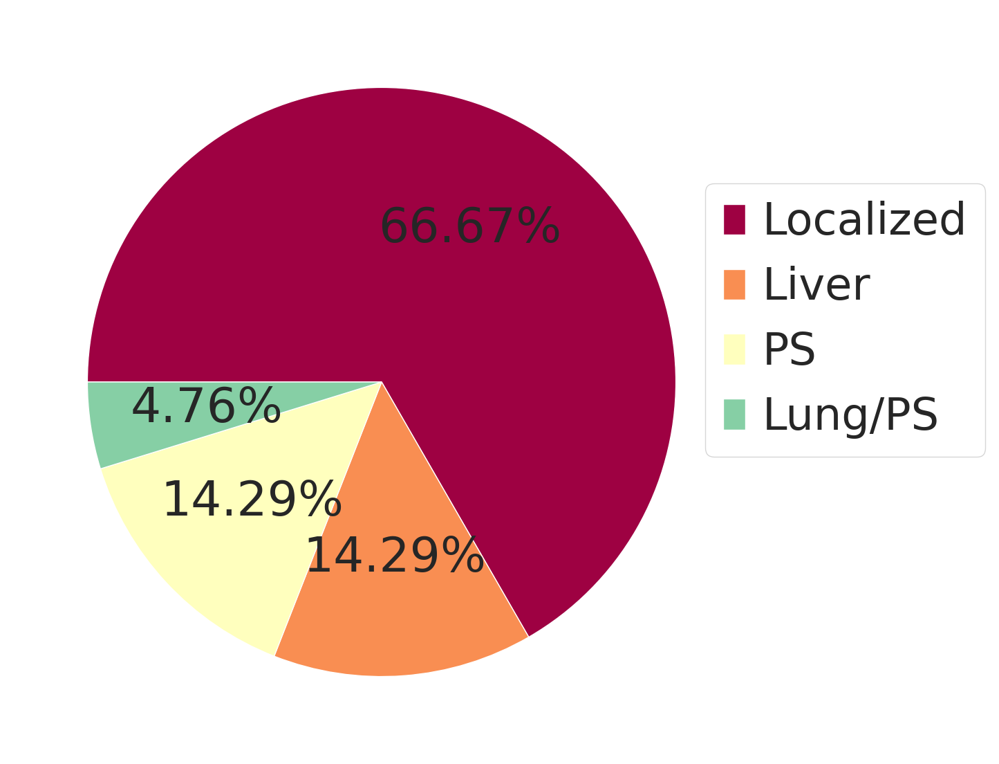

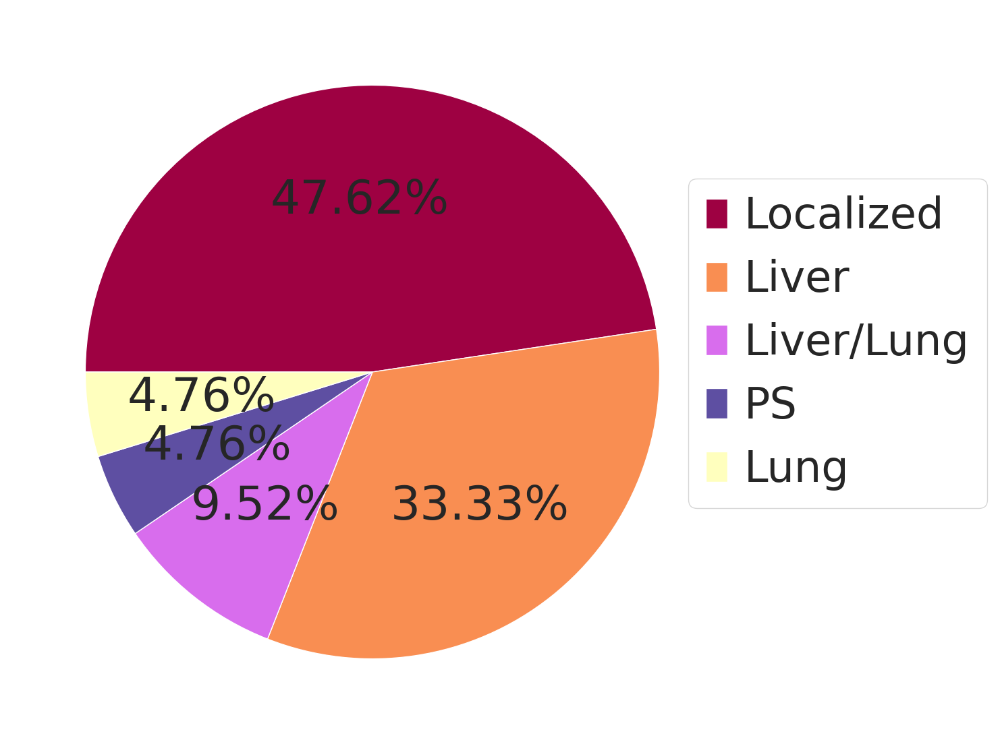

In [414]:
with_stage_sel
m = with_stage_sel['CTx_response_FFX'] == 'responder'
resp = with_stage_sel[m]


non_resp = with_stage_sel[~m]


resp = resp['Mets_Pattern'].value_counts().to_frame('Mets_Pattern')
non_resp = non_resp['Mets_Pattern'].value_counts().to_frame('Mets_Pattern')

resp_pct =  resp/resp['Mets_Pattern'].sum() *100
colors = ['#9e0142', '#f98e52', '#ffffbe', '#86cfa5', '#5e4fa2']
ratio = resp_pct.values.reshape(-1)
labels = list(resp.index)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.2f%%', startangle=180, counterclock=False, 
                                    colors=colors, labeldistance=None, rotatelabels=True)
plt.legend(bbox_to_anchor=(0.91, 0.8),ncol=1)
plt.show()

non_resp_pct =  non_resp/non_resp['Mets_Pattern'].sum() *100
colors = ['#9e0142','#f98e52','#d86ded','#5e4fa2','#ffffbe']
ratio = non_resp.values.reshape(-1)
labels = list(non_resp.index)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.2f%%', startangle=180, counterclock=False, 
                                    colors=colors, labeldistance=None, rotatelabels=True,)
plt.legend(bbox_to_anchor=(0.91, 0.8), ncol=1)
plt.show()

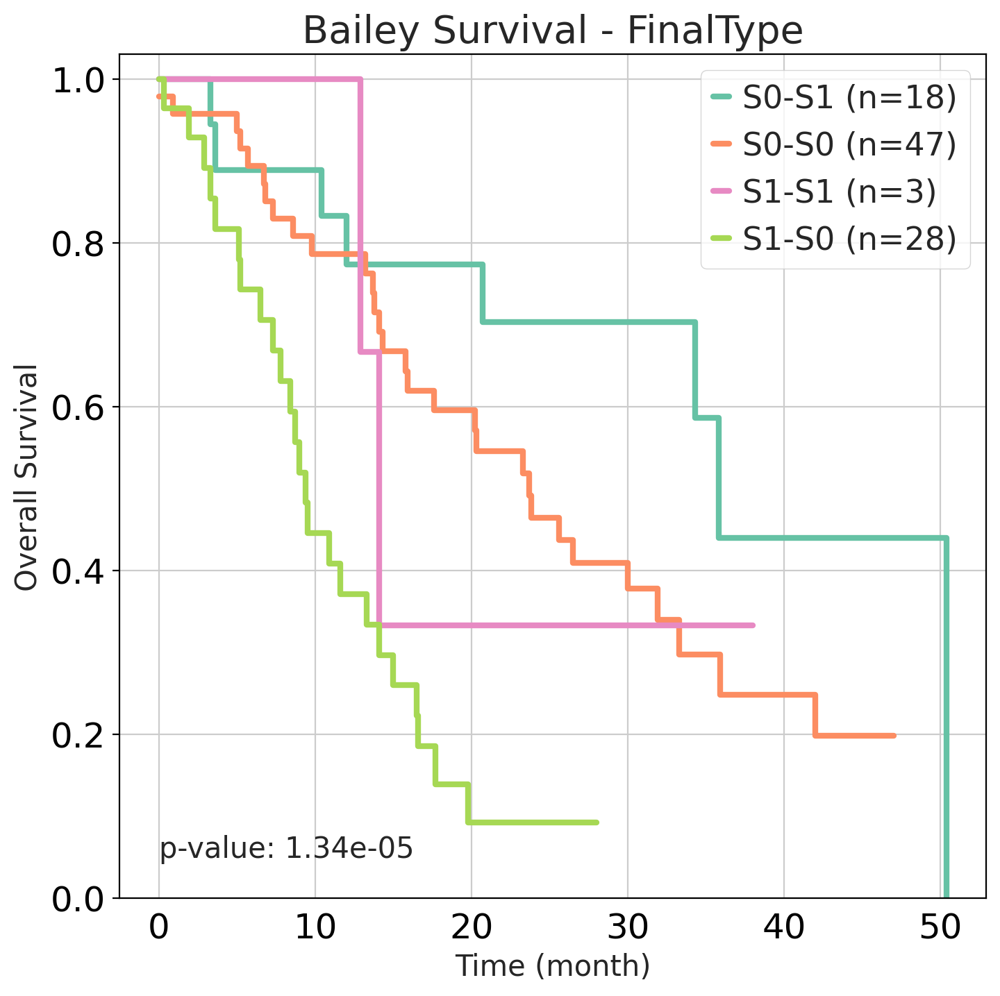

'1.34e-05'

In [165]:
sc.settings.set_figure_params(dpi=100, figsize=(8,8), fontsize=18)
Bailey_df = pd.concat([Bailey_adata.obs, Bailey_annot], axis=1)
km_plot(df_info=Bailey_df, category='FinalType', os='OS_F', event='OS_event', title='Bailey Survival - FinalType', order=['S0-S1','S0-S0','S1-S1','S1-S0'])

# TCGA

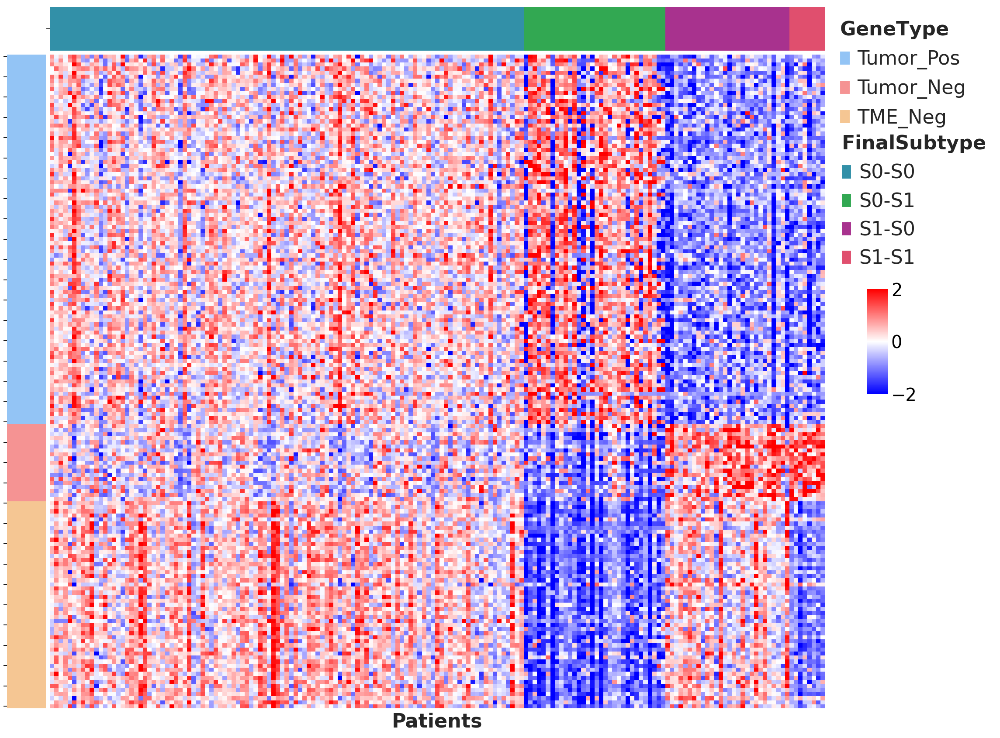

In [166]:
annot = TCGA_annot.sort_values(by='FinalType')
order = list(annot.index)
exp = TCGA_adata[:,features].to_df()
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

final_int_map = dict(zip(annot['FinalType'].unique(),range(annot['FinalType'].nunique())))
tumor_int_map = dict(zip(annot['Tumor2Type_2nd'].unique(),range(annot['Tumor2Type_2nd'].nunique())))
tme_int_map = dict(zip(annot['TME2Type_2nd'].unique(),range(annot['TME2Type_2nd'].nunique())))
genetype_int_map = dict(zip(genetype_df['Type'].unique(),range(genetype_df['Type'].nunique())))


final = annot['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
tumor = annot['Tumor2Type_2nd'].map(tumor_int_map).to_frame('TumorType').T.astype(float)
tme = annot['TME2Type_2nd'].map(tumor_int_map).to_frame('TMEType').T.astype(float)
genetype = genetype_df['Type'].map(genetype_int_map).to_frame('GeneType')


fig = plt.figure(figsize=(15, 15), dpi= 80)
widths = [1,20]
heights = [1,1,1,15]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.02, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(25.2, 1.08), frameon=False, 
                              fontsize=20, markerscale=4)
ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.margins(0)


# ax0 = fig.add_subplot(gs[0, 1])
# sns.heatmap(tme, cmap=list(tme_lut.values()), cbar=False, ax=ax0)
# handles = [mpatches.Patch(facecolor=tme_lut[name]) for name in tme_lut]
# ax0_legend = ax0.legend(handles, tme_lut, bbox_to_anchor=(1.22, 1.5), frameon=False, 
#                               fontsize=20, markerscale=4)
# ax0_legend.set_title('$\\bf{TMESubtype}$',prop={'size':20})
# ax0_legend._legend_box.align = "left"
# ax0.set_xticks([])
# ax0.set_xlabel('')
# ax0.set_yticklabels('')
# ax0.margins(0)

# ax1 = fig.add_subplot(gs[1, 1])
# sns.heatmap(tumor, cmap=list(tumor_lut.values()), cbar=False, ax=ax1)
# handles = [mpatches.Patch(facecolor=tumor_lut[name]) for name in tumor_lut]
# ax1_legend = ax1.legend(handles, tumor_lut, bbox_to_anchor=(1.25, .8), frameon=False, 
#                               fontsize=20, markerscale=4)
# ax1_legend.set_title('$\\bf{TumorSubtype}$',prop={'size':20})
# ax1_legend._legend_box.align = "left"
# ax1.set_xticks([])
# ax1.set_xlabel('')
# ax1.set_yticklabels('')
# ax1.margins(0)

ax2 = fig.add_subplot(gs[2, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax2)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax2_legend = ax2.legend(handles, final_lut, bbox_to_anchor=(1.23, -1.5), frameon=False, 
                              fontsize=20, markerscale=4)
ax2_legend.set_title('$\\bf{FinalSubtype}$',prop={'size':20})
ax2_legend._legend_box.align = "left"
ax2.set_xticks([])
ax2.set_xlabel('')
ax2.set_yticklabels('')
ax2.margins(0)


cbar_ax = fig.add_axes([1.0, 0.45, 0.02, 0.1], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax3 = fig.add_subplot(gs[3, 1])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax3, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax3.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax3.set_xticks([])
ax3.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax3.set_ylabel('')
plt.show()


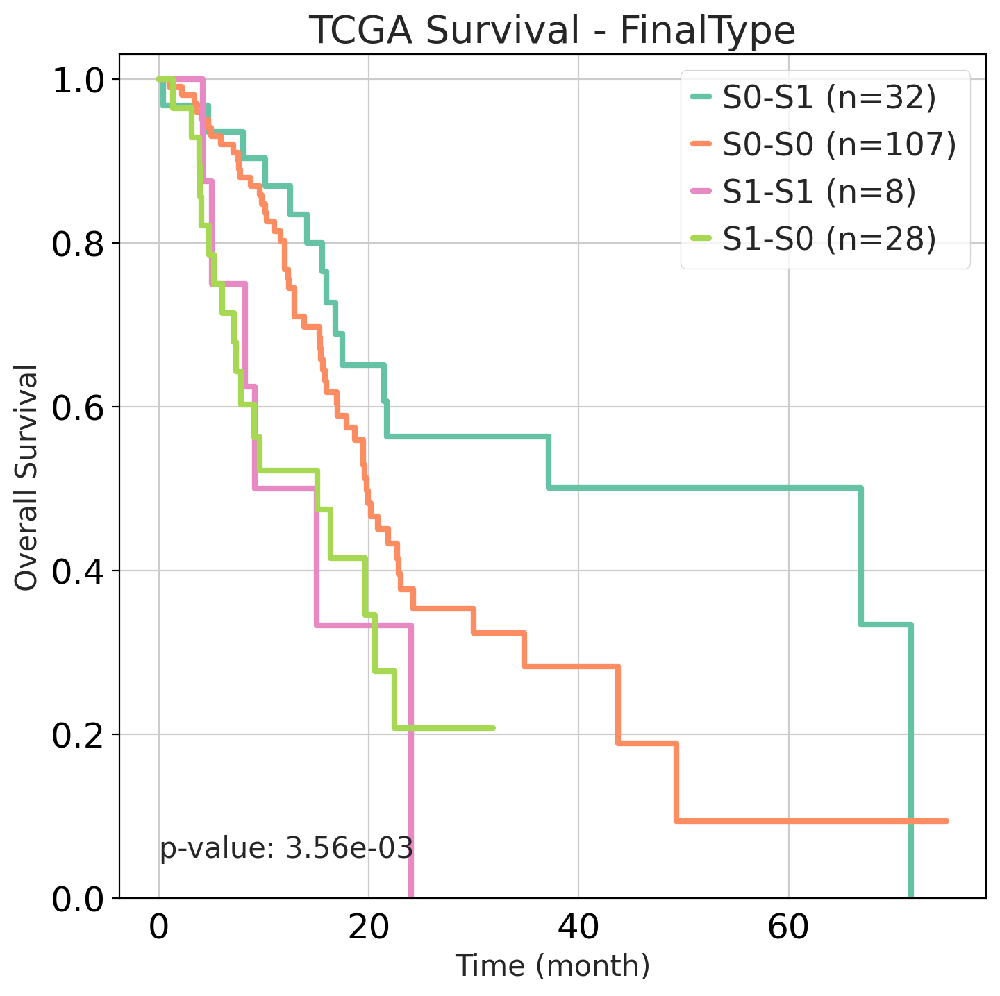

'3.56e-03'

In [167]:
sc.settings.set_figure_params(dpi=100, figsize=(8,8), fontsize=18)
TCGA_df = pd.concat([TCGA_adata.obs, TCGA_annot], axis=1)
km_plot(df_info=TCGA_df, category='FinalType', os='OS_F', event='OS_event', title='TCGA Survival - FinalType', order=['S0-S1','S0-S0','S1-S1','S1-S0'])

In [168]:
TCGA_df['AJCC_PATHOLOGIC_TUMOR_STAGE'].value_counts()

Stage IIB    119
Stage IIA     28
Stage IB      15
Stage IV       5
Stage IA       5
Stage III      3
Name: AJCC_PATHOLOGIC_TUMOR_STAGE, dtype: int64

TME Type     S0  S1
Tumor Type         
S0          107  32
S1           28   8
1.0


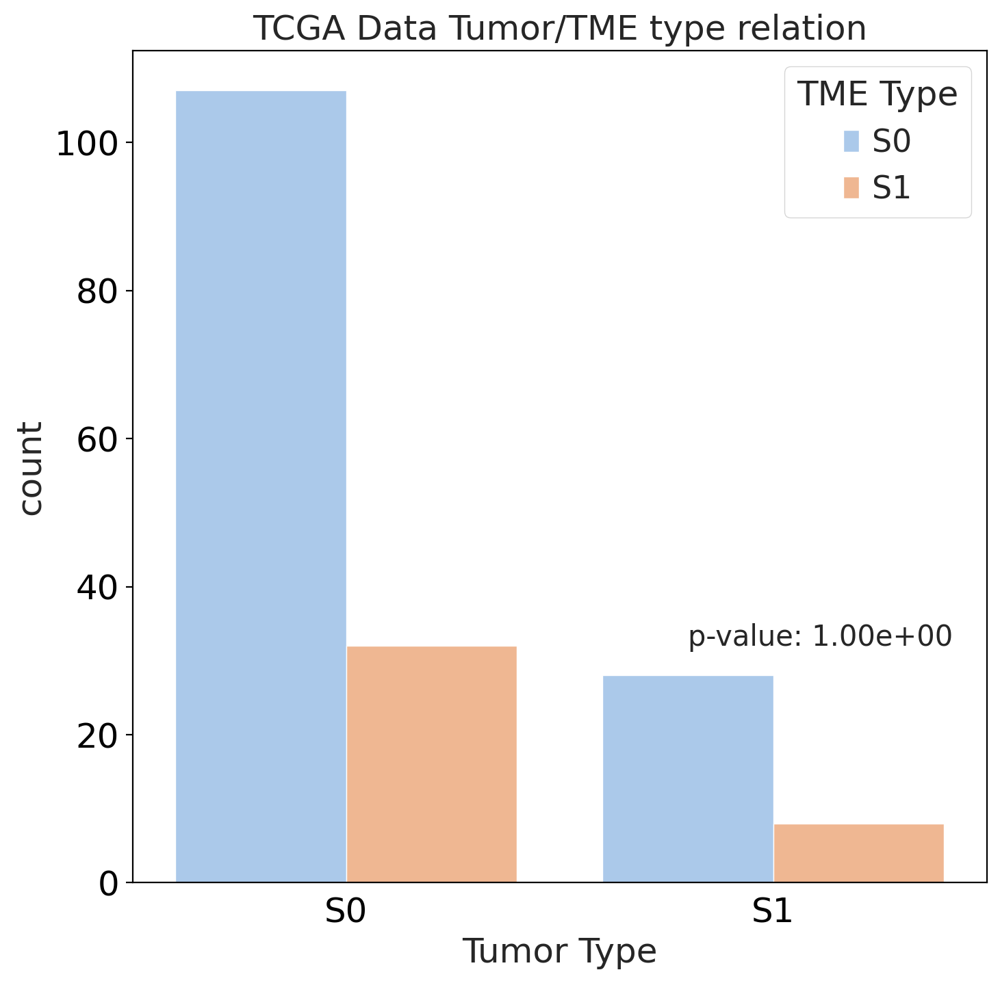

In [169]:
tmp = TCGA_annot.loc[:,['Tumor2Type_2nd','TME2Type_2nd']]
tmp
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(0.8, 32, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('TCGA Data Tumor/TME type relation')
plt.grid(False)
plt.show()


TME Type    S0  S1
Tumor Type        
S0          47  18
S1          28   3
0.08318803833006078


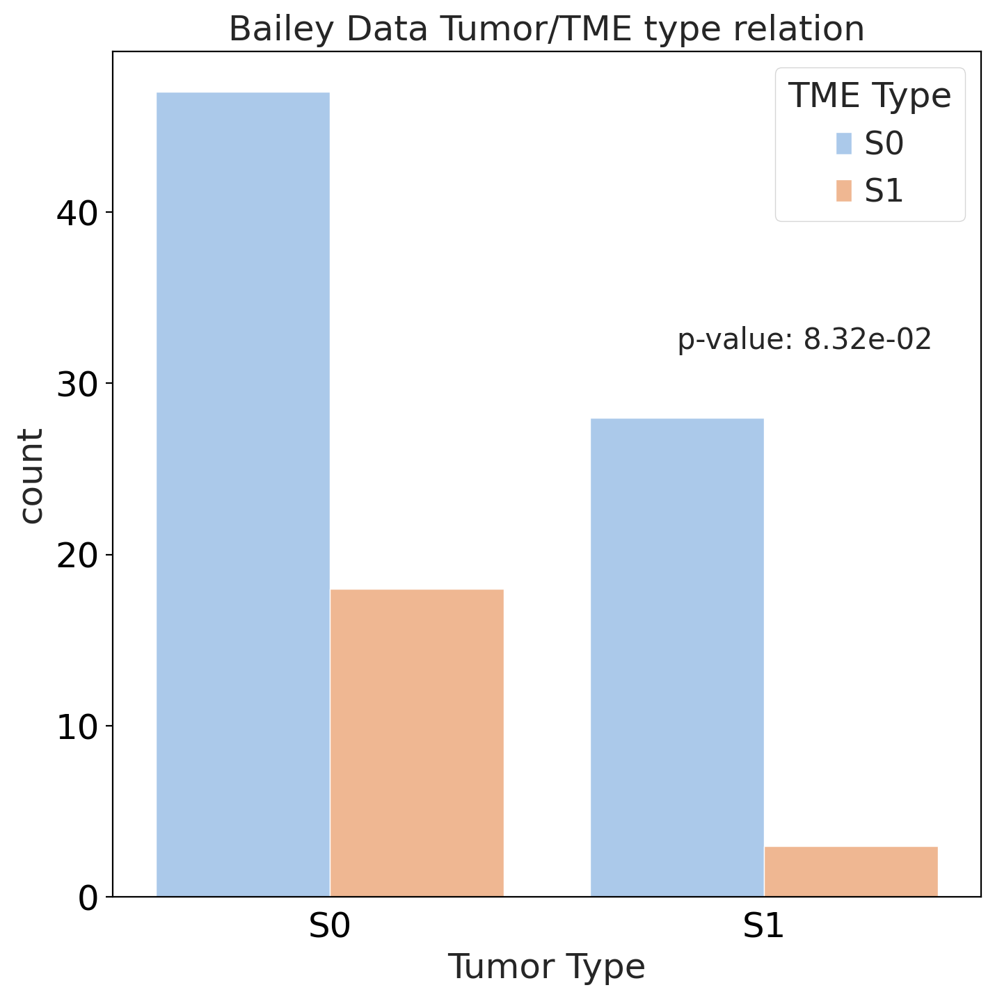

In [170]:
tmp = Bailey_annot.loc[:,['Tumor2Type_2nd','TME2Type_2nd']]
tmp
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(0.8, 32, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('Bailey Data Tumor/TME type relation')
plt.grid(False)
plt.show()


# SNU

In [171]:
other = pd.read_csv('ALL_TYPE2.csv',index_col=0)
tmp1 = other.loc[:,['MoffittType','BaileyType','Bailey2type','Bailey2type2','MichelleType','CE']]
snu_tumor = SNU_annot.loc[:,['Tumor2Type_2nd','TME2Type_2nd','FinalType']]
#snu_tumor['FinalType'] = snu_tumor['Tumor2Type_2nd'].map(simple_name)+'-'+snu_tumor['TME2Type_2nd'].map(simple_name)
snu_tumor.columns = ['TumorType','TMEType','FinalType']
annotation = pd.concat([tmp1,snu_tumor],axis=1)
annotation = annotation.sort_values(by='FinalType')
annotation

,MoffittType,BaileyType,Bailey2type,Bailey2type2,MichelleType,CE,TumorType,TMEType,FinalType
Snubh_TB,,,,,,,,,
19-T00489_FO-01,Classical,Squamous,Squamous,ADEX,BasalLike-A,CE1,S0,S0,S0-S0
19-T00192_FO-01,Classical,Immunogenic,Pancreatic Progenitor,Immunogenic,Classical-B,CE10,S0,S0,S0-S0
21-T01006_FT-01,Classical,ADEX,Pancreatic Progenitor,ADEX,Classical-B,CE6,S0,S0,S0-S0
21-T00749_FT-01,Classical,Pancreatic Progenitor,Pancreatic Progenitor,Immunogenic,Classical-B,CE1,S0,S0,S0-S0
21-T00054_FT-01,Classical,Pancreatic Progenitor,Pancreatic Progenitor,Immunogenic,Classical-B,CE5,S0,S0,S0-S0
...,...,...,...,...,...,...,...,...,...
19-T00714_FO-01,Classical,Squamous,Squamous,Immunogenic,BasalLike-B,CE2,S1,S1,S1-S1
21-T00346_FT-01,Classical,ADEX,Pancreatic Progenitor,ADEX,Hybrid,CE1,S1,S1,S1-S1
19-T00668_FO-01,BasalLike,Squamous,Squamous,Immunogenic,BasalLike-A,CE2,S1,S1,S1-S1


[]

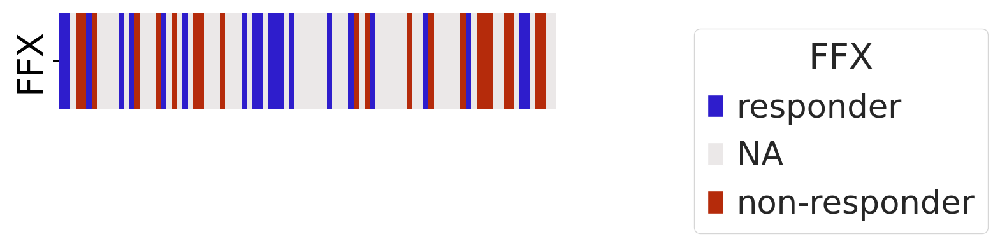

In [197]:
order = list(annotation.index)
snu_obs = SNU_adata.obs.copy().loc[order,:]
snu_obs['CTx_response_FFX'] = snu_obs['CTx_response_FFX'].cat.add_categories('NA')
snu_obs['CTx_response_FFX'] = snu_obs['CTx_response_FFX'].fillna('NA')
snu_obs['CTx_response_FFX'].value_counts()

FFX_map = dict(zip(snu_obs['CTx_response_FFX'].unique(),range(snu_obs['CTx_response_FFX'].nunique())))
FFX_color = ['#2e1dcc','#ebe8e8','#b52b0b']
FFX_lut = dict(zip(snu_obs['CTx_response_FFX'].unique(), FFX_color))
FFX = snu_obs['CTx_response_FFX'].map(FFX_map).to_frame('FFX').T.astype(float)
FFX
ax=sns.heatmap(FFX, cmap=FFX_color, cbar=False)
FFX_lut

handles4 = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
ax.legend(handles4, FFX_lut, title='FFX',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

In [172]:
annotation['Bailey_Mixed'] = annotation['Bailey2type']+'-'+annotation['Bailey2type2']
annotation

,MoffittType,BaileyType,Bailey2type,Bailey2type2,MichelleType,CE,TumorType,TMEType,FinalType,Bailey_Mixed
Snubh_TB,,,,,,,,,,
19-T00489_FO-01,Classical,Squamous,Squamous,ADEX,BasalLike-A,CE1,S0,S0,S0-S0,Squamous-ADEX
19-T00192_FO-01,Classical,Immunogenic,Pancreatic Progenitor,Immunogenic,Classical-B,CE10,S0,S0,S0-S0,Pancreatic Progenitor-Immunogenic
21-T01006_FT-01,Classical,ADEX,Pancreatic Progenitor,ADEX,Classical-B,CE6,S0,S0,S0-S0,Pancreatic Progenitor-ADEX
21-T00749_FT-01,Classical,Pancreatic Progenitor,Pancreatic Progenitor,Immunogenic,Classical-B,CE1,S0,S0,S0-S0,Pancreatic Progenitor-Immunogenic
21-T00054_FT-01,Classical,Pancreatic Progenitor,Pancreatic Progenitor,Immunogenic,Classical-B,CE5,S0,S0,S0-S0,Pancreatic Progenitor-Immunogenic
...,...,...,...,...,...,...,...,...,...,...
19-T00714_FO-01,Classical,Squamous,Squamous,Immunogenic,BasalLike-B,CE2,S1,S1,S1-S1,Squamous-Immunogenic
21-T00346_FT-01,Classical,ADEX,Pancreatic Progenitor,ADEX,Hybrid,CE1,S1,S1,S1-S1,Pancreatic Progenitor-ADEX
19-T00668_FO-01,BasalLike,Squamous,Squamous,Immunogenic,BasalLike-A,CE2,S1,S1,S1-S1,Squamous-Immunogenic


In [173]:
# def rm_sp(x):
#     return x.replace(' ','\n')

# annotation['BaileyType'] = annotation['BaileyType'].map(rm_sp)

[]

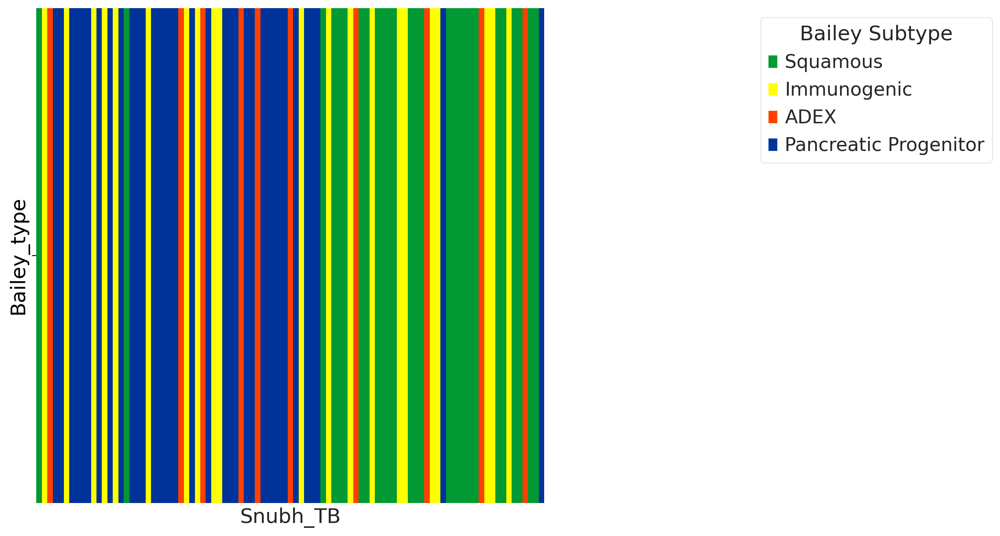

In [174]:
Bailey_map = dict(zip(annotation['BaileyType'].unique(),range(annotation['BaileyType'].nunique())))
Bailey_color = ['#009933','#ffff00','#ff4000', '#003399']
lut2 = dict(zip(annotation['BaileyType'].unique(), Bailey_color))
Bailey_type = annotation['BaileyType'].map(Bailey_map).astype(int).to_frame('Bailey_type').T
ax=sns.heatmap(Bailey_type, cmap=Bailey_color, cbar=False)


handles2 = [mpatches.Patch(facecolor=lut2[name]) for name in lut2]
ax.legend(handles2, lut2, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

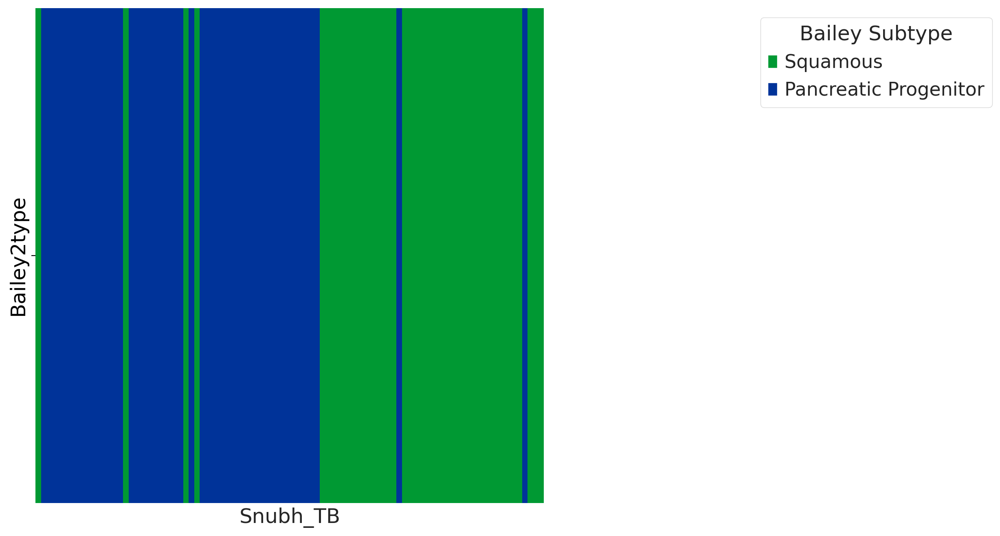

In [175]:
BaileyPS_map = dict(zip(annotation['Bailey2type'].unique(),range(annotation['Bailey2type'].nunique())))
BaileyPS_color = ['#009933','#003399']
BaileyPS_lut = dict(zip(annotation['Bailey2type'].unique(), BaileyPS_color))
BaileyPS_type = annotation['Bailey2type'].map(BaileyPS_map).astype(int).to_frame('Bailey2type').T
ax=sns.heatmap(BaileyPS_type, cmap=BaileyPS_color, cbar=False)

BaileyPS_handles = [mpatches.Patch(facecolor=BaileyPS_lut[name]) for name in BaileyPS_lut]
ax.legend(BaileyPS_handles, BaileyPS_lut, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

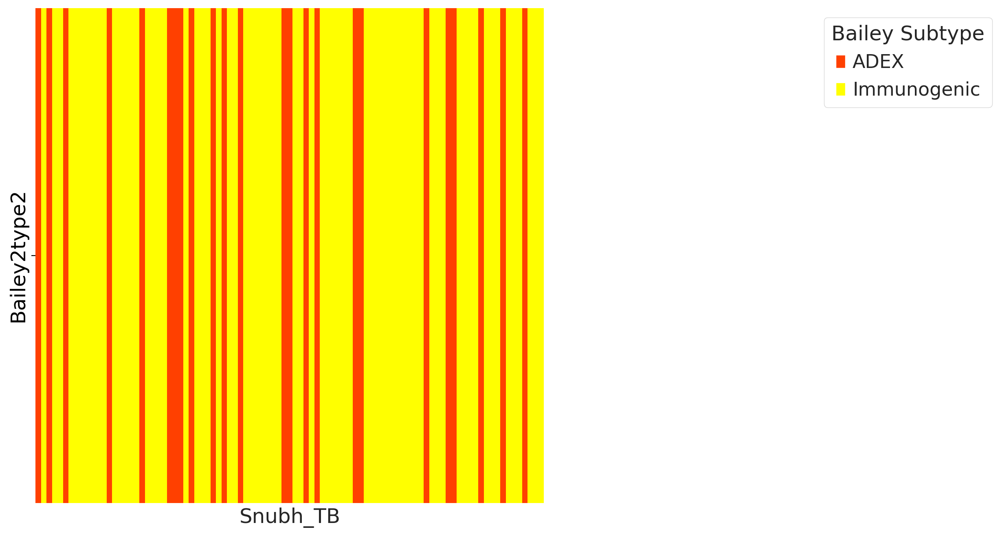

In [176]:
BaileyAI_map = dict(zip(annotation['Bailey2type2'].unique(),range(annotation['Bailey2type2'].nunique())))
BaileyAI_color = ['#ff4000','#ffff00']
BaileyAI_lut = dict(zip(annotation['Bailey2type2'].unique(), BaileyAI_color))
BaileyAI_type = annotation['Bailey2type2'].map(BaileyAI_map).astype(int).to_frame('Bailey2type2').T
ax=sns.heatmap(BaileyAI_type, cmap=BaileyAI_color, cbar=False)

BaileyAI_handles = [mpatches.Patch(facecolor=BaileyAI_lut[name]) for name in BaileyAI_lut]
ax.legend(BaileyAI_handles, BaileyAI_lut, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

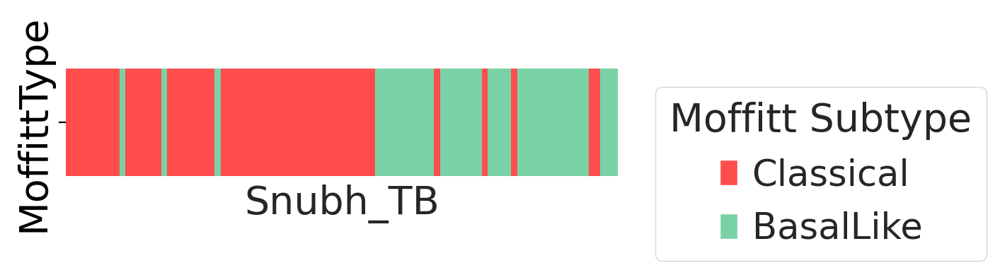

In [177]:
sc.set_figure_params(figsize=(5, 1), dpi=100, fontsize=20)
Moffitt_map = dict(zip(annotation['MoffittType'].unique(),range(annotation['MoffittType'].nunique())))
Moffitt_color = ['#ff4d4d','#79d2a6']
lut3 = dict(zip(annotation['MoffittType'].unique(), Moffitt_color))
Moffitt_type = annotation['MoffittType'].map(Moffitt_map).astype(int).to_frame('MoffittType').T
ax=sns.heatmap(Moffitt_type, cmap=Moffitt_color, cbar=False)


handles3 = [mpatches.Patch(facecolor=lut3[name]) for name in lut3]
ax.legend(handles3, lut3, title='Moffitt Subtype',
           bbox_to_anchor=(1.7, 1))
ax.set_xticks([])

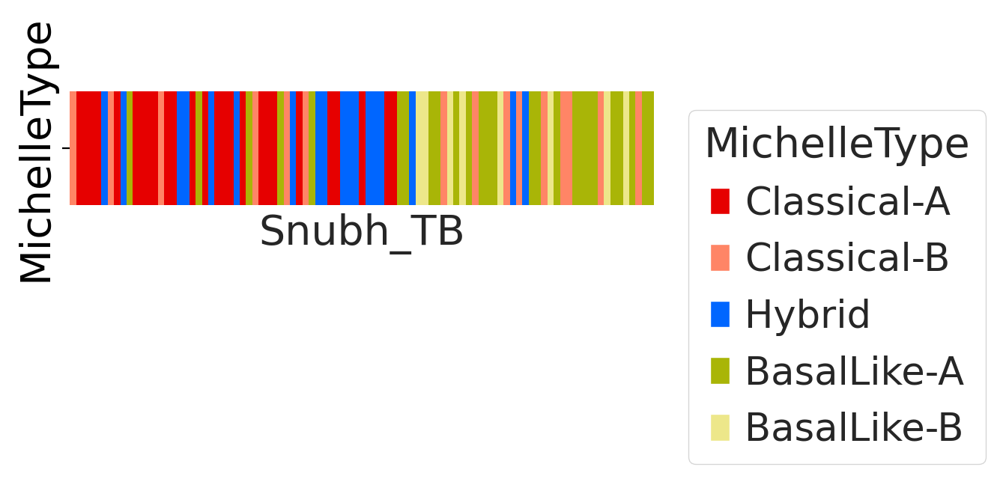

In [178]:
MichelleType_map = dict(zip(annotation['MichelleType'].unique(),range(5)))
MichelleType_map
MichelleType_color = ['#ff8566','#e60000','#0066ff','#a9b507','#ede78a']
lut4 = dict(zip(annotation['MichelleType'].unique(), MichelleType_color))
lut4 = {'Classical-A': '#e60000',
     'Classical-B': '#ff8566',
     'Hybrid': '#0066ff',
     'BasalLike-A': '#a9b507',
     'BasalLike-B': '#ede78a'}

MichelleType = annotation['MichelleType'].map(MichelleType_map).astype(int).to_frame('MichelleType').T
ax=sns.heatmap(MichelleType, cmap=MichelleType_color, cbar=False)


handles4 = [mpatches.Patch(facecolor=lut4[name]) for name in lut4]
ax.legend(handles4, lut4, title='MichelleType',bbox_to_anchor=(1.6, 1))
ax.set_xticks([])
plt.show()

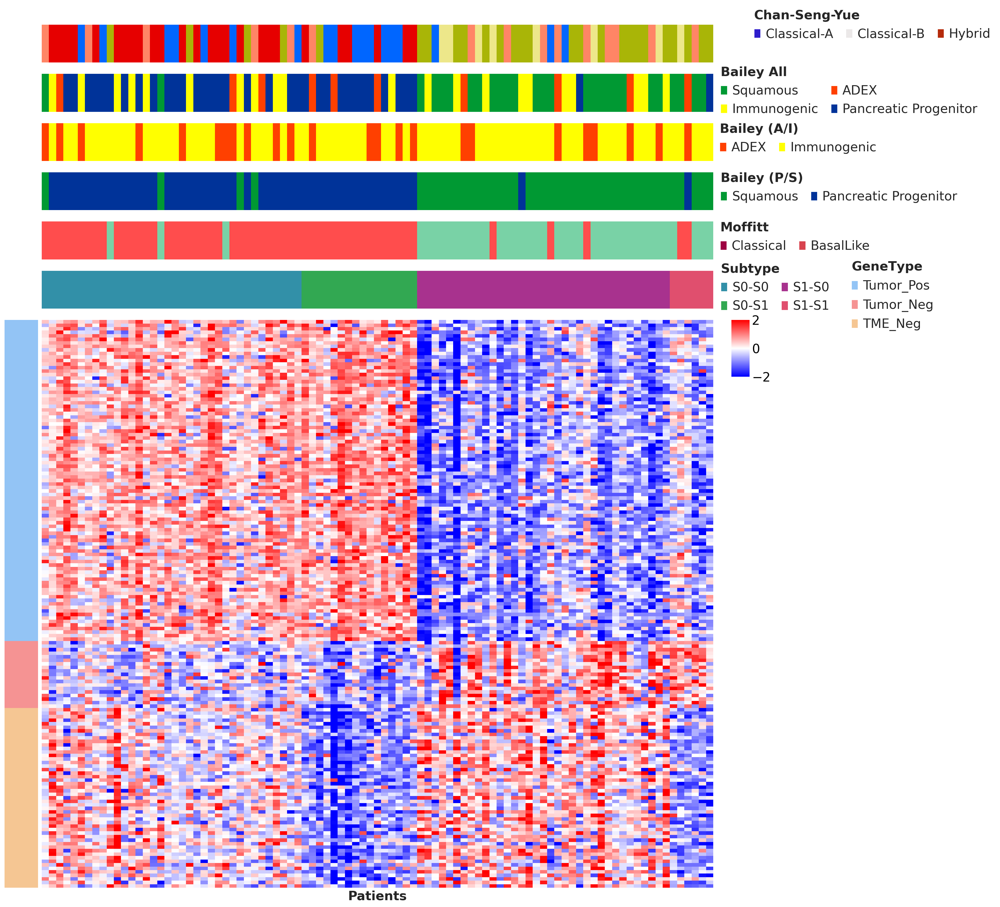

In [184]:
#annot = SNU_annot.sort_values(by='FinalType')
order = list(annotation.index)
exp = SNU_adata[:,features].to_df()
scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

final_int_map = dict(zip(annotation['FinalType'].unique(),range(annotation['FinalType'].nunique())))
genetype_int_map = dict(zip(genetype_df['Type'].unique(),range(genetype_df['Type'].nunique())))


final = annotation['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
genetype = genetype_df['Type'].map(genetype_int_map).to_frame('GeneType')


fig = plt.figure(figsize=(20, 25), dpi= 80)
widths = [1,20]
heights = [1,1,1,1,1,1,15]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.1, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[6, 0])
sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(28, 1.125), frameon=False, 
                              fontsize=20, markerscale=2)
ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_yticks([])
ax.margins(0)


ax = fig.add_subplot(gs[0, 1])
sns.heatmap(MichelleType, ax=ax, cmap=MichelleType_color, cbar=False)
#ax0.set_ylabel('Michelle', fontsize=18, fontdict=dict(weight='bold'))
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles4, lut4, bbox_to_anchor=(1.43, 1.7), 
                      frameon=False, fontsize=20, ncol=3, columnspacing=1)
ax_legend.set_title('Chan-Seng-Yue',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[1, 1])
sns.heatmap(Bailey_type, ax=ax, cmap=Bailey_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles2, lut2, bbox_to_anchor=(1.41, 1.5), 
                      frameon=False, fontsize=20,ncol=2, columnspacing=1)
ax_legend.set_title('Bailey All',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[2, 1])
sns.heatmap(BaileyAI_type, ax=ax, cmap=BaileyAI_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(BaileyAI_handles, BaileyAI_lut, bbox_to_anchor=(1.26, 1.3), 
                      frameon=False,fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Bailey (A/I)',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[3, 1])
sns.heatmap(BaileyPS_type, ax=ax, cmap=BaileyPS_color, cbar=False)
#ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(BaileyPS_handles, BaileyPS_lut, bbox_to_anchor=(1.38, 1.3), 
                      frameon=False, fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Bailey (P/S)',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[4, 1])
sns.heatmap(Moffitt_type, ax=ax, cmap=Moffitt_color, cbar=False, )
#ax2.set_ylabel('Moffitt', fontsize=18, fontdict=dict(weight='bold'))
ax.set_xlabel('')
ax.set_yticks([])
ax.set_xticks([])
ax.margins(0)
ax_legend = ax.legend(handles3, lut3, bbox_to_anchor=(1.25, 1.3), 
                      frameon=False, fontsize=20, ncol=2, columnspacing=1)
ax_legend.set_title('Moffitt',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"


ax = fig.add_subplot(gs[5, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.19, 1.5),
                    fontsize=20, markerscale=2.5, frameon=False, ncol=2, columnspacing=1)
ax_legend.set_title('Subtype',prop={'size':20, 'weight':'bold'})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_yticks([])
ax.margins(0)


cbar_ax = fig.add_axes([0.98, 0.6, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax = fig.add_subplot(gs[6, 1])
sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax.set_xticks([])
ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax.set_ylabel('')
plt.show()


In [203]:
# #annot = SNU_annot.sort_values(by='FinalType')
# order = list(annotation.index)
# exp = SNU_adata[:,features].to_df()
# scaled_df = pd.DataFrame(scaler.fit_transform(exp), columns=exp.columns, index=exp.index).loc[order,:].T

# final_int_map = dict(zip(annotation['FinalType'].unique(),range(annotation['FinalType'].nunique())))
# genetype_int_map = dict(zip(genetype_df['Type'].unique(),range(genetype_df['Type'].nunique())))


# final = annotation['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
# genetype = genetype_df['Type'].map(genetype_int_map).to_frame('GeneType')


# fig = plt.figure(figsize=(40, 25), dpi= 80)
# widths = [1,20]
# heights = [1,1,1,1, 15]
# gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.1, wspace=0.01, width_ratios=widths, height_ratios=heights)


# ax = fig.add_subplot(gs[4, 0])
# sns.heatmap(genetype, cmap=list(genetype_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=genetype_lut[name]) for name in genetype_lut]
# ax_legend = ax.legend(handles, genetype_lut, bbox_to_anchor=(28, 1.125), frameon=False, 
#                               fontsize=20, markerscale=2)
# ax_legend.set_title('$\\bf{GeneType}$',prop={'size':20})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_yticks([])
# ax.margins(0)




# ax = fig.add_subplot(gs[0, 1])
# sns.heatmap(BaileyPS_type, ax=ax, cmap=BaileyPS_color, cbar=False)
# #ax1.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'), rotation=90)
# ax.set_xlabel('')
# ax.set_yticks([])
# ax.set_xticks([])
# ax.margins(0)
# ax_legend = ax.legend(BaileyPS_handles, BaileyPS_lut, bbox_to_anchor=(1.38, 1.3), 
#                       frameon=False, fontsize=20, ncol=2, columnspacing=1)
# ax_legend.set_title('Bailey (P/S)',prop={'size':20, 'weight':'bold'})
# ax_legend._legend_box.align = "left"


# ax = fig.add_subplot(gs[1, 1])
# sns.heatmap(Moffitt_type, ax=ax, cmap=Moffitt_color, cbar=False, )
# #ax2.set_ylabel('Moffitt', fontsize=18, fontdict=dict(weight='bold'))
# ax.set_xlabel('')
# ax.set_yticks([])
# ax.set_xticks([])
# ax.margins(0)
# ax_legend = ax.legend(handles3, lut3, bbox_to_anchor=(1.25, 1.3), 
#                       frameon=False, fontsize=20, ncol=2, columnspacing=1)
# ax_legend.set_title('Moffitt',prop={'size':20, 'weight':'bold'})
# ax_legend._legend_box.align = "left"


# ax = fig.add_subplot(gs[2, 1])
# sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
# ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.19, 1.5),
#                     fontsize=20, markerscale=2.5, frameon=False, ncol=2, columnspacing=1)
# ax_legend.set_title('Subtype',prop={'size':20, 'weight':'bold'})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_yticks([])
# ax.margins(0)

# ax = fig.add_subplot(gs[2, 1])
# sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
# ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.19, 1.5),
#                     fontsize=20, markerscale=2.5, frameon=False, ncol=2, columnspacing=1)
# ax_legend.set_title('Subtype',prop={'size':20, 'weight':'bold'})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_yticks([])
# ax.margins(0)

# ax = fig.add_subplot(gs[3, 1])
# sns.heatmap(FFX, cmap=list(FFX_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
# # ax_legend = ax.legend(handles, FFX_lut, bbox_to_anchor=(1.19, 1.5),
# #                     fontsize=20, markerscale=2.5, frameon=False, ncol=2, columnspacing=1)
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_yticks([])
# ax.margins(0)


# cbar_ax = fig.add_axes([0.98, 0.6, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
# cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
# ax = fig.add_subplot(gs[4, 1])
# sns.heatmap(scaled_df, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# #ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# plt.show()


In [180]:
order = list(annotation.index)
head = pd.concat([SNU_adata.obs.loc[order,['stage_C','CTx_response_FFX']], annotation.loc[:,['FinalType','CE']]], axis=1)
head = head.astype(str)
head['CTx_response_FFX'] = head['CTx_response_FFX'].replace('nan','NA')
head

,stage_C,CTx_response_FFX,FinalType,CE
Snubh_TB,,,,
19-T00489_FO-01,Localized,responder,S0-S0,CE1
19-T00192_FO-01,Localized,responder,S0-S0,CE10
21-T01006_FT-01,Localized,NA,S0-S0,CE6
21-T00749_FT-01,Metastatic,non-responder,S0-S0,CE1
21-T00054_FT-01,Localized,non-responder,S0-S0,CE5
...,...,...,...,...
19-T00714_FO-01,Metastatic,NA,S1-S1,CE2
21-T00346_FT-01,Metastatic,non-responder,S1-S1,CE1
19-T00668_FO-01,Metastatic,non-responder,S1-S1,CE2


In [181]:
head['CTx_response_FFX'].unique()

array(['responder', 'NA', 'non-responder'], dtype=object)

In [182]:
head['CTx_response_FFX'].value_counts()

NA               51
non-responder    21
responder        21
Name: CTx_response_FFX, dtype: int64

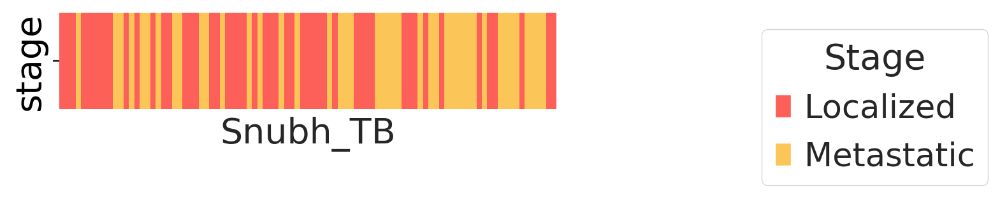

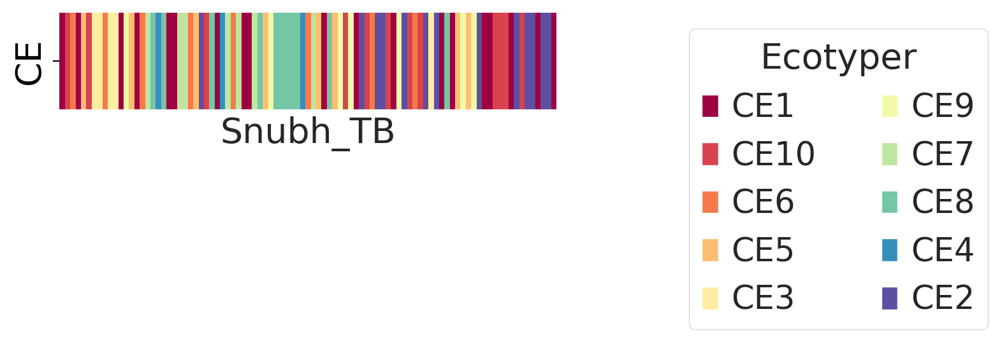

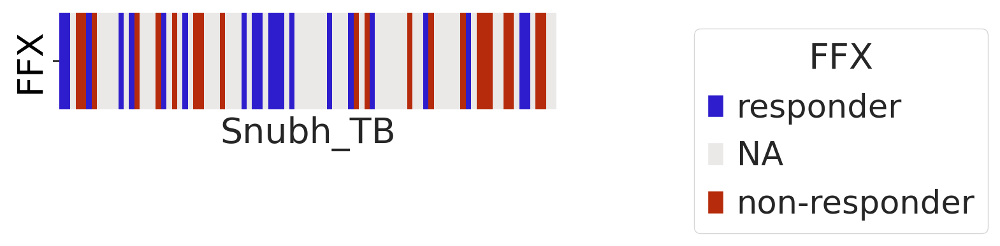

In [183]:
stage_map = dict(zip(head['stage_C'].unique(),range(head['stage_C'].nunique())))
stage_color = ['#fc6058','#fcc558']
stage_lut = dict(zip(head['stage_C'].unique(), stage_color))
stage = head['stage_C'].map(stage_map).astype(int).to_frame('stage').T
ax=sns.heatmap(stage, cmap=stage_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=stage_lut[name]) for name in stage_lut]
ax.legend(handles4, stage_lut, title='Stage',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

CE_map = dict(zip(head['CE'].unique(),range(head['CE'].nunique())))
CE_color = mcp.gen_color(cmap="Spectral",n=head['CE'].nunique())
CE_lut = dict(zip(head['CE'].unique(), CE_color))
CE = head['CE'].map(CE_map).astype(int).to_frame('CE').T
ax=sns.heatmap(CE, cmap=CE_color, cbar=False)
handles3 = [mpatches.Patch(facecolor=CE_lut[name]) for name in CE_lut]
ax.legend(handles3, CE_lut, title='Ecotyper',
           bbox_to_anchor=(1.9, 1), ncol=2)
ax.set_xticks([])
plt.show()

FFX_map = dict(zip(head['CTx_response_FFX'].unique(),range(head['CTx_response_FFX'].nunique())))
FFX_color = ['#2e1dcc','#ebe8e8','#b52b0b']
FFX_lut = dict(zip(head['CTx_response_FFX'].unique(), FFX_color))
FFX = head['CTx_response_FFX'].map(FFX_map).to_frame('FFX').T
ax=sns.heatmap(FFX, cmap=FFX_color, cbar=False)
FFX_lut

handles4 = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
ax.legend(handles4, FFX_lut, title='FFX',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

In [94]:
def col_rename(x):
    x = x.replace('X','')
    x = x.replace('.','-')
    return x


os.listdir('deconv_res')
epic = pd.read_csv('deconv_res/epic_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
quantiseq = pd.read_csv('deconv_res/quantiseq_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
mcp_counter = pd.read_csv('deconv_res/mcp_counter_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
xcell = pd.read_csv('deconv_res/xcell_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
epic.columns = epic.columns.map(col_rename)
quantiseq.columns = quantiseq.columns.map(col_rename)
mcp_counter.columns = mcp_counter.columns.map(col_rename)
xcell.columns = xcell.columns.map(col_rename)

In [85]:
# cell_map = dict()
# cell_map['T cell']='T cell'
# cell_map['T cell CD4+']='T cell'
# cell_map['T cell CD8+']='T cell'
# cell_map['T cell CD4+ (non-regulatory)']='T cell'
# cell_map['T cell regulatory (Tregs)']='T cell'
# cell_map['T cell CD4+ memory']='T cell'
# cell_map['T cell CD4+ naive']='T cell'
# cell_map['T cell CD4+ central memory']='T cell'
# cell_map['T cell CD4+ effector memory']='T cell'
# cell_map['T cell CD8+ naive']='T cell'
# cell_map['T cell CD8+ central memory']='T cell'
# cell_map['T cell CD8+ effector memory']='T cell'
# cell_map['NK cell']='T cell'
# cell_map['T cell NK']='T cell'
# cell_map['T cell gamma delta']='T cell'
# cell_map['T cell CD4+ Th1']='T cell'
# cell_map['T cell CD4+ Th2']='T cell'

# cell_map['B cell']='B cell'
# cell_map['Class-switched memory B cell']='B cell'
# cell_map['B cell memory']='B cell'
# cell_map['B cell naive']='B cell'
# cell_map['B cell plasma']='B cell'

# cell_map['Macrophage']='Myeloid cell'
# cell_map['Macrophage M1']='Myeloid cell'
# cell_map['Macrophage M2']='Myeloid cell'
# cell_map['Myeloid dendritic cell']='Myeloid cell'
# cell_map['Macrophage/Monocyte']='Myeloid cell'
# cell_map['Myeloid dendritic cell activated']='Myeloid cell'
# cell_map['Monocyte']='Myeloid cell'
# cell_map['Common myeloid progenitor']='Myeloid cell'
# cell_map['Plasmacytoid dendritic cell']='Myeloid cell'

# cell_map['Neutrophil']='Granulocyte'
# cell_map['Eosinophil']='Granulocyte'
# cell_map['Mast cell']='Granulocyte'

# cell_map['Endothelial cell']='Stromal cell'
# cell_map['Cancer associated fibroblast']='Stromal cell'

# epic.index = epic.index.map(cell_map)
# epic = epic.groupby(epic.index).agg(sum)

# quantiseq.index = quantiseq.index.map(cell_map)
# quantiseq = quantiseq.groupby(quantiseq.index).agg(sum)

# mcp_counter.index = mcp_counter.index.map(cell_map)
# mcp_counter = mcp_counter.groupby(mcp_counter.index).agg(sum)

# xcell.index = xcell.index.map(cell_map)
# xcell = xcell.groupby(xcell.index).agg(sum)

# epic.to_csv('epic_LineageType.csv')
# quantiseq.to_csv('quantiseq_LineageType.csv')
# mcp_counter.to_csv('mcpcounter_LineageType.csv')
# xcell.to_csv('xcell_LineageType.csv')

In [86]:
# mcp_counter = pd.read_csv('mcpcounter_LineageType.csv',index_col=0).T

# epic = pd.read_csv('epic_LineageType.csv',index_col=0).T

# quantiseq = pd.read_csv('quantiseq_LineageType.csv',index_col=0).T
# xcell = pd.read_csv('xcell_LineageType.csv',index_col=0).T

# mcp_counter['Data']='MCPcounter'
# epic['Data']='EPIC'
# quantiseq['Data']='quanTIseq'
# xcell['Data']='xCell'

In [93]:
mcp_counter


,X20.T00330_FO.01,X19.T00062_FO.01,X20.T00814_FT.01,X19.T00201_FO.01,X19.T00505_FO.01,X20.T00764_FT.01,X20.T00577_FT.01,X21.T00687_FT.01,X21.T00771_FT.01,X18.01500_FO.01,...,X19.T00380_FO.01,X19.T00573_FO.01,X20.T00105_FO.01,X21.T00511_FT.01,X22.T00038_FT.01,X21.T00576_FT.01,X19.T00620_FO.01,X19.T00413_FO.01,X20.T00073_FO.01,X19.T00119_FO.01
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,9.036429,7.231429,6.735714,4.590000,6.653571,4.560000,3.883571,7.262857,10.257143,7.044286,...,5.844286,6.703571,5.705714,7.747143,6.477857,12.175000,6.160000,9.554286,17.887857,3.749286
T cell CD8+,6.830000,2.090000,0.720000,1.600000,0.670000,1.350000,5.310000,8.610000,5.590000,1.400000,...,6.100000,4.580000,0.000000,1.450000,0.720000,9.040000,2.410000,0.850000,7.760000,0.000000
cytotoxicity score,12.908571,11.245714,2.227143,1.952857,12.465714,3.887143,5.627143,7.680000,12.190000,14.375714,...,25.532857,3.340000,2.980000,5.247143,2.478571,15.040000,2.214286,4.017143,9.804286,3.364286
NK cell,1.157500,2.078750,0.760000,0.602500,1.410000,1.026250,0.678750,1.002500,3.062500,2.353750,...,1.371250,1.371250,1.097500,1.498750,0.908750,2.013750,1.113750,1.013750,0.575000,0.895000
B cell,4.656250,6.108750,5.087500,3.872500,2.701250,3.488750,2.477500,3.282500,11.965000,5.177500,...,4.633750,4.478750,3.266250,2.130000,4.005000,6.421250,9.757500,4.100000,217.280000,2.821250
Monocyte,20.174286,10.608571,12.474286,13.678571,15.700000,8.957143,6.837143,37.921429,13.574286,44.281429,...,7.250000,17.091429,13.470000,17.502857,11.082857,16.922857,24.802857,13.294286,12.604286,9.094286
Macrophage/Monocyte,20.174286,10.608571,12.474286,13.678571,15.700000,8.957143,6.837143,37.921429,13.574286,44.281429,...,7.250000,17.091429,13.470000,17.502857,11.082857,16.922857,24.802857,13.294286,12.604286,9.094286
Myeloid dendritic cell,1.914000,2.594000,4.120000,1.370000,1.788000,2.070000,1.334000,2.436000,2.506000,2.500000,...,2.274000,1.296000,1.212000,2.000000,2.280000,1.946000,4.732000,1.284000,2.378000,1.578000
Neutrophil,47.185333,62.702000,16.238000,29.019333,36.500667,30.276667,42.890667,71.291333,87.418000,34.266667,...,83.378667,18.822667,19.848667,22.949333,16.594000,54.092000,25.568000,22.308667,61.210000,48.413333


In [88]:
epic

,20-T00330_FO-01,19-T00062_FO-01,20-T00814_FT-01,19-T00201_FO-01,19-T00505_FO-01,20-T00764_FT-01,20-T00577_FT-01,21-T00687_FT-01,21-T00771_FT-01,18-01500_FO-01,...,19-T00380_FO-01,19-T00573_FO-01,20-T00105_FO-01,21-T00511_FT-01,22-T00038_FT-01,21-T00576_FT-01,19-T00620_FO-01,19-T00413_FO-01,20-T00073_FO-01,19-T00119_FO-01
cell_type,,,,,,,,,,,,,,,,,,,,,
B cell,0.002823,2.842961e-03,3.254472e-03,1.962193e-03,2.693375e-08,3.026053e-03,1.893401e-03,7.515846e-07,6.923524e-03,2.280260e-03,...,0.004173,3.313689e-03,2.277704e-03,6.087884e-07,2.235802e-03,4.227448e-03,1.287282e-02,1.357753e-03,2.581507e-01,5.885229e-04
Cancer associated fibroblast,0.056286,1.147640e-01,2.659096e-02,6.921415e-02,3.418157e-02,6.526195e-03,9.898460e-03,5.289604e-02,1.150791e-01,2.405389e-02,...,0.007019,1.126146e-01,2.537523e-02,7.512494e-02,1.138445e-01,1.429703e-02,5.975443e-03,3.060323e-02,3.389239e-02,1.288948e-02
T cell CD4+,0.145102,1.857510e-01,2.590181e-01,1.226623e-01,2.466748e-01,8.019046e-02,8.534175e-02,1.444008e-01,2.176204e-01,2.584648e-01,...,0.082560,1.056504e-01,1.687333e-01,1.349534e-01,1.917957e-01,2.274287e-01,8.001675e-02,2.441766e-01,3.130247e-01,1.269251e-01
T cell CD8+,0.026332,2.070037e-07,1.952386e-02,1.396636e-02,2.013384e-02,2.145045e-02,2.675081e-02,3.023945e-02,2.272564e-04,3.184768e-02,...,0.011178,1.376923e-02,2.201075e-02,1.236518e-02,2.473993e-02,2.015646e-02,3.022159e-02,1.920791e-02,1.584633e-03,8.186506e-03
Endothelial cell,0.012991,1.890124e-02,2.869902e-02,1.211639e-02,2.065549e-02,1.653079e-02,1.006339e-02,2.324695e-02,1.562488e-02,1.936609e-02,...,0.004953,1.644100e-02,2.298981e-02,1.891707e-02,3.109529e-02,1.418169e-02,1.379231e-02,3.389075e-02,2.191331e-02,3.157129e-02
Macrophage,0.005155,1.675837e-03,4.841277e-03,3.030200e-03,4.028239e-03,5.639302e-03,3.085423e-03,1.415481e-02,3.201370e-03,8.766721e-03,...,0.002326,5.394871e-03,2.611241e-03,6.175682e-03,3.588459e-03,3.796313e-03,1.136278e-02,2.298216e-03,2.012077e-03,2.415837e-03
NK cell,0.000119,6.767359e-11,1.049677e-11,1.593550e-09,1.847564e-09,9.706550e-10,7.656882e-10,1.159792e-08,2.142637e-09,1.514383e-08,...,0.005902,1.440685e-08,8.165471e-10,1.228740e-09,4.923317e-09,1.350494e-09,6.242459e-10,3.300427e-10,1.522619e-10,4.364952e-08
uncharacterized cell,0.751191,6.760648e-01,6.580723e-01,7.770485e-01,6.743260e-01,8.666368e-01,8.629668e-01,7.350612e-01,6.413234e-01,6.552206e-01,...,0.881889,7.428162e-01,7.560020e-01,7.524631e-01,6.327003e-01,7.159124e-01,8.457583e-01,6.684656e-01,3.694221e-01,8.174232e-01


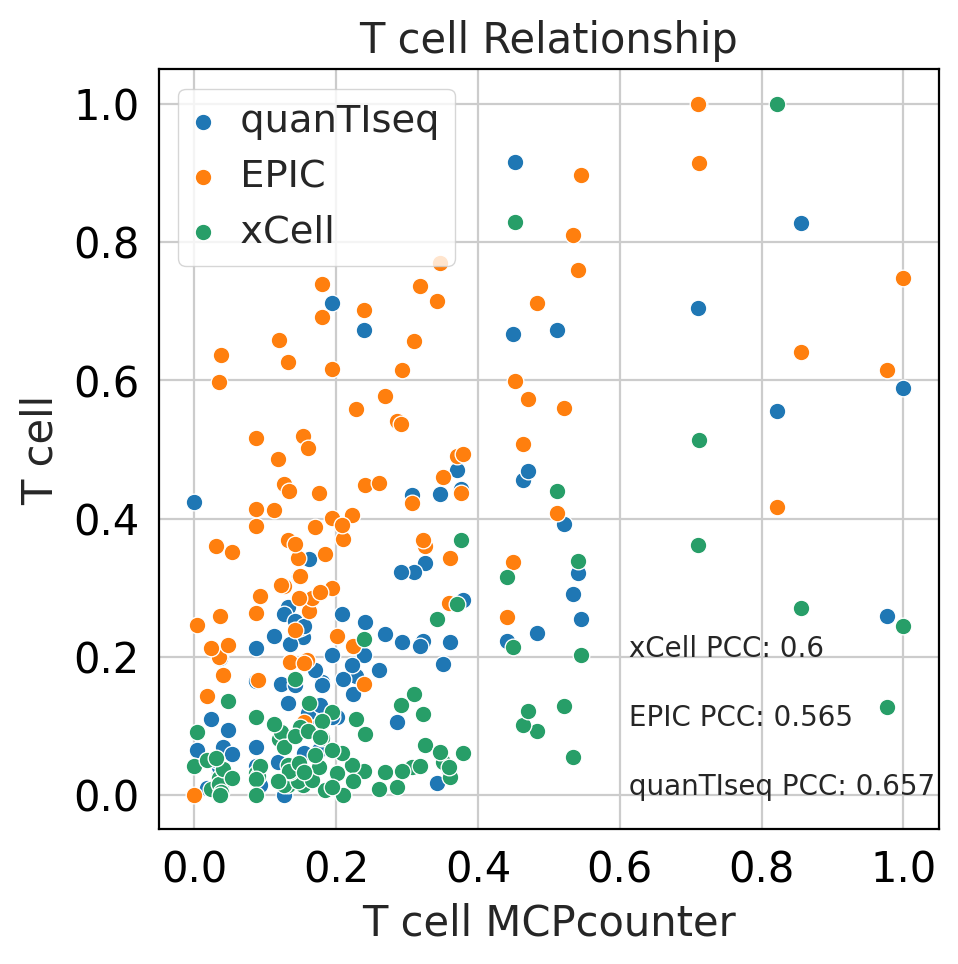

In [95]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=15)

mcp_counter = pd.read_csv('mcpcounter_LineageType.csv',index_col=0)
epic = pd.read_csv('epic_LineageType.csv',index_col=0)
quantiseq = pd.read_csv('quantiseq_LineageType.csv',index_col=0)
xcell = pd.read_csv('xcell_LineageType.csv',index_col=0)

mcp_counter.index = mcp_counter.index+' MCPcounter'
quantiseq.index = quantiseq.index+' quanTIseq'
epic.index = epic.index+' EPIC'
xcell.index = xcell.index+' xCell'

lineagetype = pd.concat([mcp_counter, quantiseq, epic, xcell],axis=0)
scaler = MinMaxScaler()
scaled = pd.DataFrame(scaler.fit_transform(lineagetype.T), columns=lineagetype.index, index=lineagetype.columns).T

target_cell = 'T cell'
ref = ' MCPcounter'
ref_cell = target_cell+ref
target_groups = [' quanTIseq',' EPIC',' xCell']
text_ypos = 0.0
text_xpos = 0.6
spacing = 0.1
i=0
for group in target_groups:
    cell = target_cell+group
    if cell in lineagetype.index:
        sns.scatterplot(x=scaled.loc[ref_cell,:],y=scaled.loc[cell,:], label=group)
        corr = np.round(np.corrcoef(scaled.loc[ref_cell,:],scaled.loc[cell,:])[0,1],3)
        corr = '{} PCC: {}'.format(group,corr)
        plt.text(text_xpos, text_ypos+i*spacing, corr, fontsize=10)
        i+=1
          
plt.ylabel('{}'.format(target_cell))
plt.title('{} Relationship'.format(target_cell))
plt.show()    



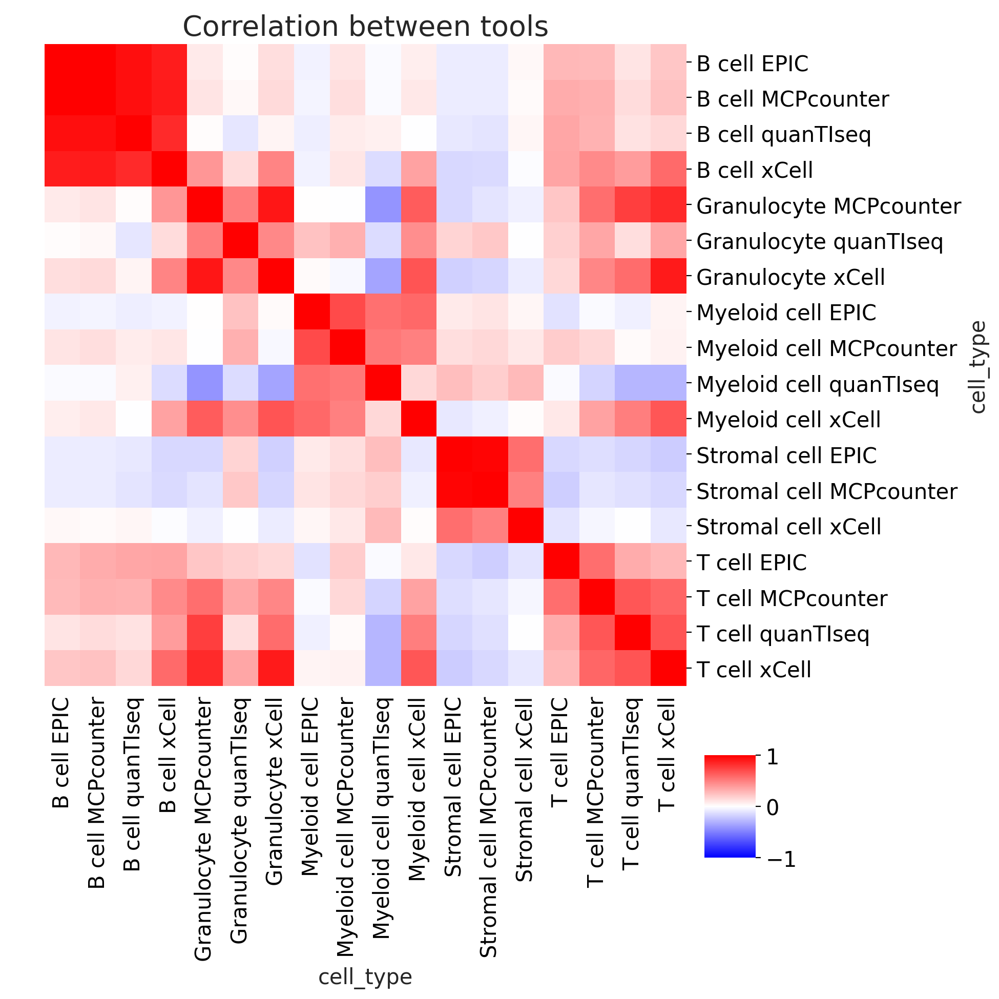

In [96]:
tmp = lineagetype.T.corr()
ordered = sorted(tmp.columns)
tmp = tmp.loc[ordered,ordered]
g=sns.clustermap(tmp,method='ward',row_cluster=False,col_cluster=False,
               dendrogram_ratio=0.05,cbar_pos=(0.7, 0.15, 0.05, 0.1),cmap="bwr", vmin=-1, vmax=1)
g.ax_heatmap.set_title('Correlation between tools',fontsize=20)
plt.show()

In [100]:
order = list(annotation.index)
scaler = StandardScaler()
#scaler = MinMaxScaler()
mcp_counter = pd.read_csv('mcpcounter_LineageType.csv',index_col=0)
mcp_counter = pd.DataFrame(scaler.fit_transform(mcp_counter.loc[:,order].T), columns=mcp_counter.index, index=mcp_counter.columns).T

epic = pd.read_csv('epic_LineageType.csv',index_col=0)
epic = pd.DataFrame(scaler.fit_transform(epic.loc[:,order].T), columns=epic.index, index=epic.columns).T
quantiseq = pd.read_csv('quantiseq_LineageType.csv',index_col=0)
quantiseq = pd.DataFrame(scaler.fit_transform(quantiseq.loc[:,order].T), columns=quantiseq.index, index=quantiseq.columns).T
xcell = pd.read_csv('xcell_LineageType.csv',index_col=0)
xcell = pd.DataFrame(scaler.fit_transform(xcell.loc[:,order].T), columns=xcell.index, index=xcell.columns).T

In [101]:
fig = plt.figure(figsize=(25, 30), dpi= 150)
widths = [1]
heights = [0.5,2,1.5,2,2]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.15, wspace=0.01, width_ratios=widths, height_ratios=heights)



final_int_map = dict(zip(head['FinalType'].unique(),range(head['FinalType'].nunique())))
final = head['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
ax = fig.add_subplot(gs[0, 0])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.22, 1.6),
                              fontsize=30, markerscale=2, frameon=False, ncol=2, columnspacing=1)
ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False

ax = fig.add_subplot(gs[1, 0])
sns.heatmap(mcp_counter, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


ax = fig.add_subplot(gs[2, 0])
sns.heatmap(epic, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-EPIC',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


ax = fig.add_subplot(gs[3, 0])
sns.heatmap(quantiseq, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-quanTIseq',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)


cbar_ax = fig.add_axes([1.08, 0.79, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax = fig.add_subplot(gs[4, 0])
sns.heatmap(xcell, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
ax.set_xticks([])
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=30)
ax.set_title('Deconvolution-xCell',fontdict={'fontsize':30,'weight':'bold'})
plt.yticks(rotation=0)




plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True
plt.show()

In [102]:
def col_rename(x):
    x = x.replace('X','')
    x = x.replace('.','-')
    return x

def epic_col(x):
    if x == 'Cancer associated fibroblast':
        return 'CAF'
    else:
        return x
    
def quantiseq_col(x):
    if x == 'T cell CD4+ (non-regulatory)':
        return 'T cell CD4+'
    elif x == 'T cell regulatory (Tregs)':
        return 'Treg'
    elif x == 'Myeloid dendritic cell':
        return 'Dendritic cell'
    else:
        return x
    
def mcp_counter_col(x):
    if x == 'Macrophage/Monocyte':
        return 'Macrophage'
    elif x == 'Cancer associated fibroblast':
        return 'CAF'
    elif x == 'Myeloid dendritic cell':
        return 'Dendritic cell'
    else:
        return x
    
scaler = StandardScaler()

"""
1: subtype
2: FFX Response

3: epic
4: quantiseq
5: mcp counter
6: xcell

"""
os.listdir('deconv_res')
epic = pd.read_csv('deconv_res/epic_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
quantiseq = pd.read_csv('deconv_res/quantiseq_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
mcp_counter = pd.read_csv('deconv_res/mcp_counter_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
xcell = pd.read_csv('deconv_res/xcell_deconv_SNU.csv', index_col='cell_type').drop('Unnamed: 0',axis=1)
epic.columns = epic.columns.map(col_rename)
quantiseq.columns = quantiseq.columns.map(col_rename)
mcp_counter.columns = mcp_counter.columns.map(col_rename)
xcell.columns = xcell.columns.map(col_rename)

epic = epic.loc[:,order]
tmp = epic.T.copy()
epic = pd.DataFrame(scaler.fit_transform(tmp), columns=tmp.columns, index=tmp.index).T.drop('uncharacterized cell')
#epic.index = epic.index.map(epic_col)

quantiseq = quantiseq.loc[:,order]
tmp = quantiseq.T.copy()
quantiseq = pd.DataFrame(scaler.fit_transform(tmp), columns=tmp.columns, index=tmp.index).T.drop('uncharacterized cell')
#quantiseq.index = quantiseq.index.map(quantiseq_col)

mcp_counter = mcp_counter.loc[:,order]
tmp = mcp_counter.T.copy()
mcp_counter = pd.DataFrame(scaler.fit_transform(tmp), columns=tmp.columns, index=tmp.index).T
#mcp_counter.index = mcp_counter.index.map(mcp_counter_col)

xcell = xcell.loc[:,order]
tmp = xcell.T.copy()
xcell = pd.DataFrame(scaler.fit_transform(tmp), columns=tmp.columns, index=tmp.index).T
# xcell.drop('T cell CD4+ (non-regulatory)', inplace=True)
# xcell.drop('Common myeloid progenitor', inplace=True)
# xcell.drop('Granulocyte-monocyte progenitor', inplace=True)
# xcell.drop('NK cell', inplace=True)
# xcell.drop('T cell CD4+ (non-regulatory)', inplace=True)



In [103]:
files_tumor = ['MSigDB_Hallmark_2020-TumorType-ssGSEA.csv',
         'KEGG_2021_Human-TumorType-ssGSEA.csv',
         'GO_Biological_Process_2021-TumorType-ssGSEA.csv',
         'Reactome_2016-TumorType-ssGSEA.csv',
        ]
files_tme = ['MSigDB_Hallmark_2020-TMEType-ssGSEA.csv',
         'KEGG_2021_Human-TMEType-ssGSEA.csv',
         'GO_Biological_Process_2021-TMEType-ssGSEA.csv',
         'Reactome_2016-TMEType-ssGSEA.csv',
        ]

tumor_df = []
for file in files_tumor:
    df_ = pd.read_csv(file,index_col=0)
    tumor_df.append(df_)
tumor_score=pd.concat(tumor_df,axis=0).T.loc[order,:]


tme_df = []
for file in files_tme:
    df_ = pd.read_csv(file,index_col=0)
    tme_df.append(df_)
tme_score=pd.concat(tme_df,axis=0).T.loc[order,:]


In [104]:
genetype_lut

{'Tumor_Pos': '#93c4f5', 'Tumor_Neg': '#f59393', 'TME_Neg': '#f5c693'}

In [105]:
EMT_Pos_sig = [
    'Epithelial Mesenchymal Transition' 
]

EMT_Neg_sig = [
    'Cell junction organization Homo sapiens R-HSA-446728',
    'Cell-cell junction organization Homo sapiens R-HSA-421270',
]

TGFB = [
    'TGF-beta Signaling'
]

apoptotic_regulation = [
    'positive regulation of intrinsic apoptotic signaling pathway (GO:2001244)',
    'regulation of extrinsic apoptotic signaling pathway via death domain receptors (GO:1902041)',
    'regulation of intrinsic apoptotic signaling pathway (GO:2001242)',
    'positive regulation of apoptotic signaling pathway (GO:2001235)',
    'positive regulation of apoptotic process (GO:0043065)',
]

O_glycosylation = [
    'Mucin type O-glycan biosynthesis',
    'protein O-linked glycosylation (GO:0006493)',
    'O-linked glycosylation of mucins Homo sapiens R-HSA-913709',
    'O-glycan processing (GO:0016266)',
    'O-linked glycosylation Homo sapiens R-HSA-5173105'
]

vegf = [
    'Signaling by VEGF Homo sapiens R-HSA-194138',
    'vascular endothelial growth factor receptor signaling pathway (GO:0048010)',
    'VEGFA-VEGFR2 Pathway Homo sapiens R-HSA-4420097',
    'VEGF signaling pathway'
]
scaler = StandardScaler()
tumor = pd.DataFrame(scaler.fit_transform(tumor_score), columns=tumor_score.columns, index=tumor_score.index).T
Tumor_Features = EMT_Pos_sig+EMT_Neg_sig+TGFB+apoptotic_regulation+O_glycosylation+vegf
tumor = tumor.loc[Tumor_Features,:]



cellcycle = [
    'Mitotic G1-G1/S phases Homo sapiens R-HSA-453279',
    'G1/S Transition Homo sapiens R-HSA-69206',
    'regulation of mitotic cell cycle phase transition (GO:1901990)',
    'E2F Targets',
    'G2-M Checkpoint',
    'G2/M Checkpoints Homo sapiens R-HSA-69481'
]

platelet = [
    'Platelet activation',
    'Platelet activation, signaling and aggregation Homo sapiens R-HSA-76002' 
]

ras = [
    'KRAS Signaling Up',
]

Innate_Immune = [
    'Innate Immune System Homo sapiens R-HSA-168249',
    'Neutrophil extracellular trap formation',
    'neutrophil mediated immunity (GO:0002446)',
    'neutrophil activation involved in immune response (GO:0002283)',
    'neutrophil migration (GO:1990266)',
    'neutrophil chemotaxis (GO:0030593)'    
]



treg = [
    'regulation of T cell proliferation (GO:0042129)',
    'positive regulation of T cell activation (GO:0050870)',
    'positive regulation of T cell proliferation (GO:0042102)',
    'Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell Homo sapiens R-HSA-198933'
]

PDL1 = [
    'PD-1 signaling Homo sapiens R-HSA-389948',
    'PD-L1 expression and PD-1 checkpoint pathway in cancer'  
]

#df_tme_score.loc[Innate_Immune,:].sort_values(by='scores',ascending=False)

tme = pd.DataFrame(scaler.fit_transform(tme_score), columns=tme_score.columns, index=tme_score.index).T
TME_Features = cellcycle+platelet+ras+Innate_Immune+treg+PDL1
tme = tme.loc[TME_Features,:]

ssGSEA = pd.concat([tumor,tme],axis=0)
ssGSEA

,19-T00489_FO-01,19-T00192_FO-01,21-T01006_FT-01,21-T00749_FT-01,21-T00054_FT-01,21-T00575_FT-01,20-T00027_FO-01,21-T01027_FT-01,21-T00941_FT-01,19-T00506_FO-01,...,19-T00494_FO-01,20-T00311_FO-01,19-T00385_FO-01,19-T00737_FO-01,19-T00201_FO-01,19-T00714_FO-01,21-T00346_FT-01,19-T00668_FO-01,18-02904_FO-01,20-T00360_FO-01
Term|NES,,,,,,,,,,,,,,,,,,,,,
Epithelial Mesenchymal Transition,0.925400,-0.309427,0.606957,-0.346915,-0.659812,0.327253,0.188893,-0.091614,-0.293530,-0.090070,...,-0.124410,2.182904,0.623818,1.150772,-0.192205,-0.230954,0.408198,-0.504317,-0.284012,1.504384
Cell junction organization Homo sapiens R-HSA-446728,-0.072473,0.104862,0.168382,0.939526,0.969330,0.239510,0.666848,0.584936,0.486679,0.221043,...,-0.820604,-0.129356,-0.740707,-2.719585,0.489162,0.543237,0.626321,-1.258222,-0.154156,-0.062290
Cell-cell junction organization Homo sapiens R-HSA-421270,-0.274914,0.140618,-0.005724,0.935970,0.973196,-0.149991,0.480031,0.565265,0.450801,0.243859,...,-0.776735,-0.320316,-0.944564,-2.451396,0.457743,0.401367,0.638320,-0.945365,-0.108823,-0.165315
TGF-beta Signaling,-0.147504,-0.079119,0.432042,0.320242,-0.352941,0.455802,0.421907,0.102080,0.279204,0.598525,...,-0.131481,1.497818,0.642955,0.809581,0.872001,0.221343,0.652853,-0.470074,0.197665,1.236108
positive regulation of intrinsic apoptotic signaling pathway (GO:2001244),0.043520,0.478108,-0.604334,-1.004427,-0.101017,0.454352,0.339987,-0.023847,-0.416379,-0.580620,...,0.651156,-0.355193,1.825397,-0.589282,0.248897,0.192408,-0.184624,1.115024,0.323226,1.057074
regulation of extrinsic apoptotic signaling pathway via death domain receptors (GO:1902041),0.022300,0.611415,-1.114084,-1.368664,-2.579656,0.936887,0.101294,-0.351204,-0.563179,0.605269,...,1.575406,0.376156,0.842812,0.496286,-0.037989,0.432106,0.192602,-0.205127,0.380504,0.102291
regulation of intrinsic apoptotic signaling pathway (GO:2001242),0.342111,0.275258,-0.986117,-1.176931,-0.305206,0.178475,-0.043821,-0.169455,-1.012811,-0.626120,...,0.296304,0.404469,1.962527,-0.749221,-0.115028,-0.122242,-0.581046,2.076682,0.215607,1.068544
positive regulation of apoptotic signaling pathway (GO:2001235),-0.195737,0.373577,-0.768931,-0.908644,0.108242,0.411423,0.499777,-0.243627,-0.061297,-0.310054,...,0.056721,0.145643,1.843541,-0.439873,0.296150,-0.302757,0.256166,1.788885,0.533434,1.339027
positive regulation of apoptotic process (GO:0043065),0.057207,0.204403,0.375094,-1.042550,-0.084774,1.270400,0.755996,-0.982013,0.124695,0.115317,...,0.811889,-0.137961,0.367524,1.385851,-0.233616,-0.738206,-0.155208,1.553459,-0.493299,0.310198


In [112]:
signatures = ['EMT']
signatures = signatures+['Cell junction organization']*2
signatures = signatures+['TGF-beta']
signatures = signatures+['Regulation apoptosis']*5
signatures = signatures+['O-glycosylation']*5
signatures = signatures+['Angiogenesis']*4
signatures = signatures+['Cellcycle']*6
signatures = signatures+['Platelet']*2
signatures = signatures+['KRAS']*1
signatures = signatures+['Neutrophil']*6
signatures = signatures+['Treg']*4
signatures = signatures+['PD-L1']*2
tumor_score_df = tumor_score.loc[:,Tumor_Features].T
tme_score_df = tme_score.loc[:,TME_Features].T
ssScore = pd.concat([tumor_score_df,tme_score_df],axis=0)
ssScore['Type'] = signatures
groupby_score = ssScore.groupby('Type').sum().T
groupby_score = pd.concat([groupby_score, annotation.loc[:,['FinalType']]], axis=1)
groupby_score

,Angiogenesis,Cell junction organization,Cellcycle,EMT,KRAS,Neutrophil,O-glycosylation,PD-L1,Platelet,Regulation apoptosis,TGF-beta,Treg,FinalType
Snubh_TB,,,,,,,,,,,,,
19-T00489_FO-01,0.740622,0.490778,1.046401,0.329308,0.210090,0.695635,0.747415,-0.004308,0.157664,1.343004,0.414499,-0.296220,S0-S0
19-T00192_FO-01,0.958113,0.532213,-0.121151,0.205575,0.234165,1.854695,0.717427,0.494378,0.373928,1.418227,0.418667,0.403982,S0-S0
21-T01006_FT-01,0.891355,0.525176,-0.413720,0.297399,0.242355,0.893068,0.444541,0.149188,0.304239,1.181007,0.449821,-0.041769,S0-S0
21-T00749_FT-01,0.670589,0.641224,1.326943,0.201818,0.203789,0.561795,0.927681,-0.000033,0.113069,1.108326,0.443007,-0.369024,S0-S0
21-T00054_FT-01,0.803067,0.645771,0.908221,0.170465,0.185490,1.496533,0.973358,0.227572,0.192248,1.205866,0.401978,0.111442,S0-S0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
19-T00714_FO-01,0.819818,0.577831,1.693171,0.213438,0.119443,0.496120,0.318878,-0.020033,0.066166,1.330369,0.436979,-0.495089,S1-S1
21-T00346_FT-01,0.836890,0.600377,1.676453,0.277483,0.125653,0.259418,0.757698,-0.091413,0.094875,1.315342,0.463279,-0.449248,S1-S1
19-T00668_FO-01,0.769037,0.369968,2.141660,0.186046,0.132081,0.902508,0.330872,0.150465,0.106305,1.582682,0.394839,-0.062091,S1-S1


In [107]:
import seaborn as sns
from statannot import add_stat_annotation

#?add_stat_annotation


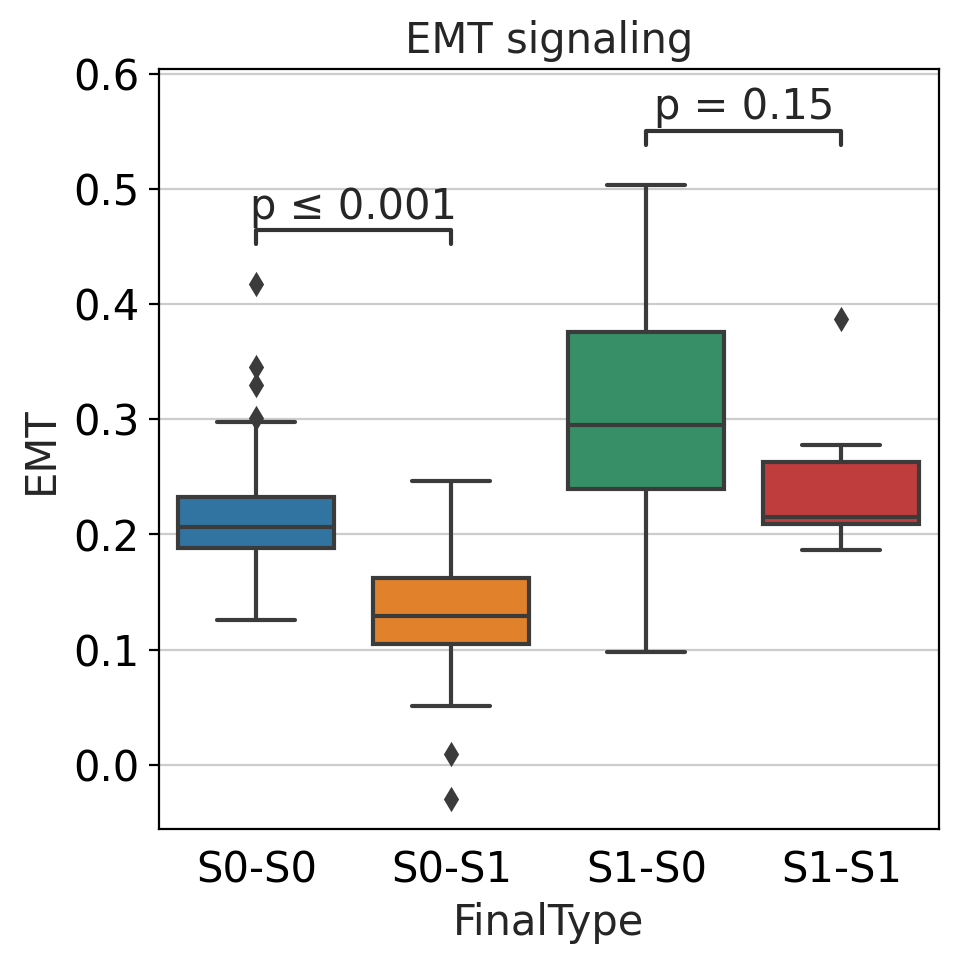

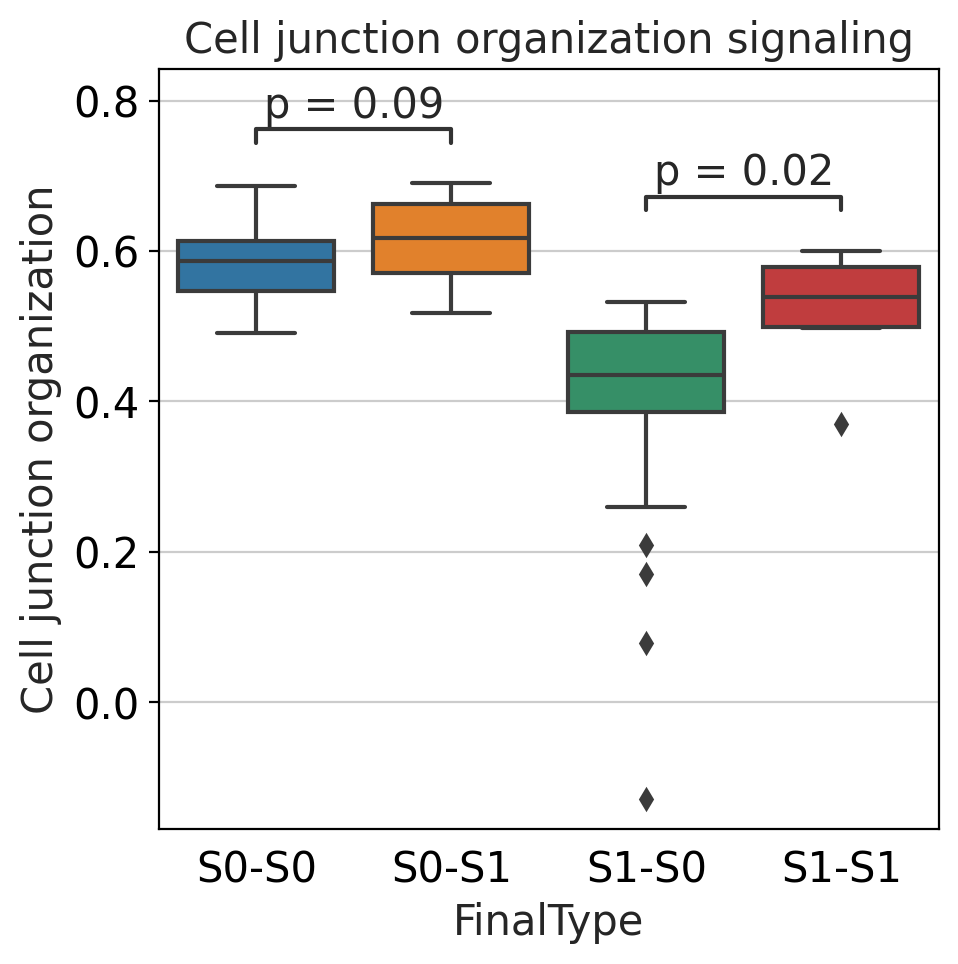

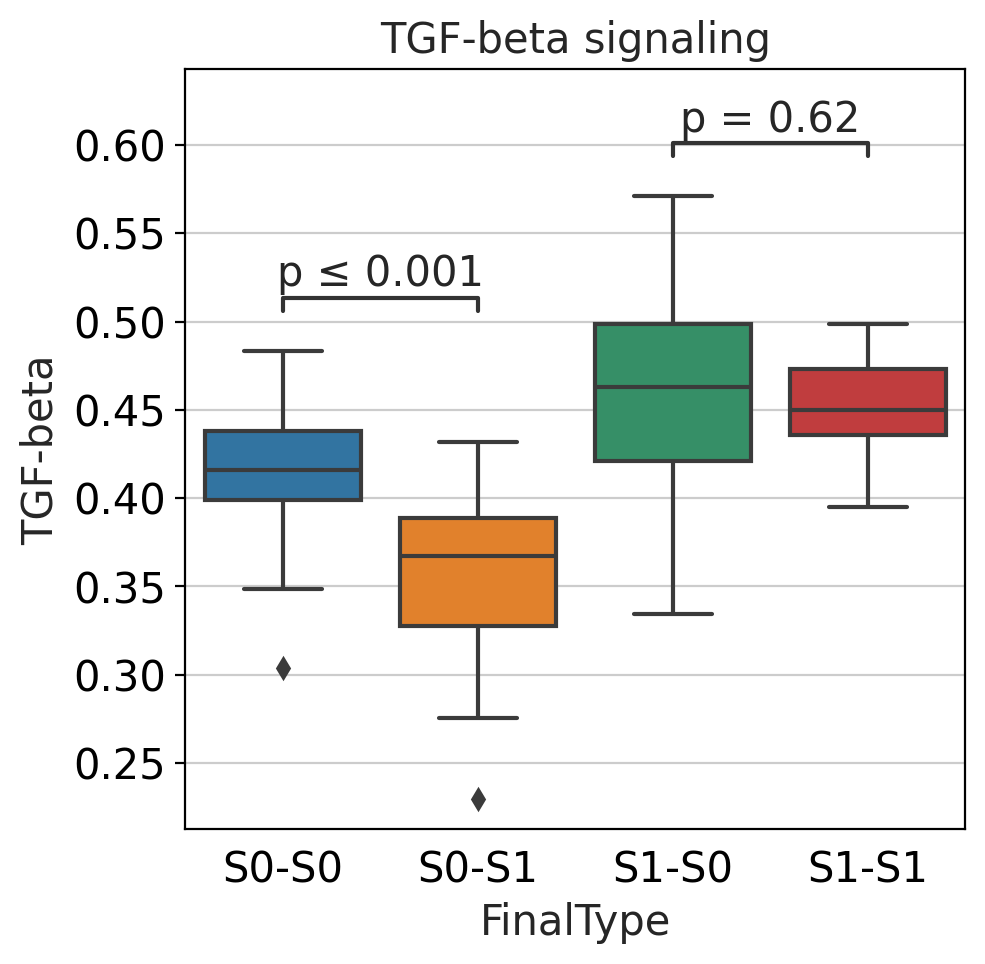

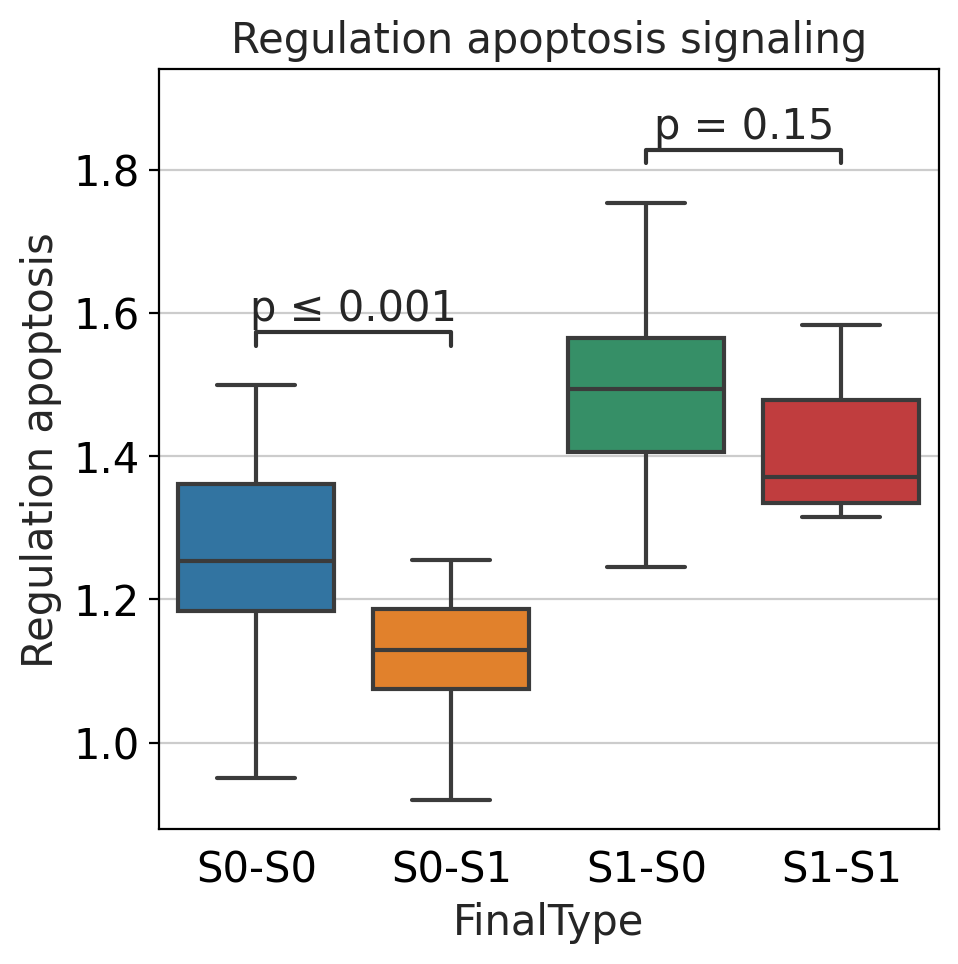

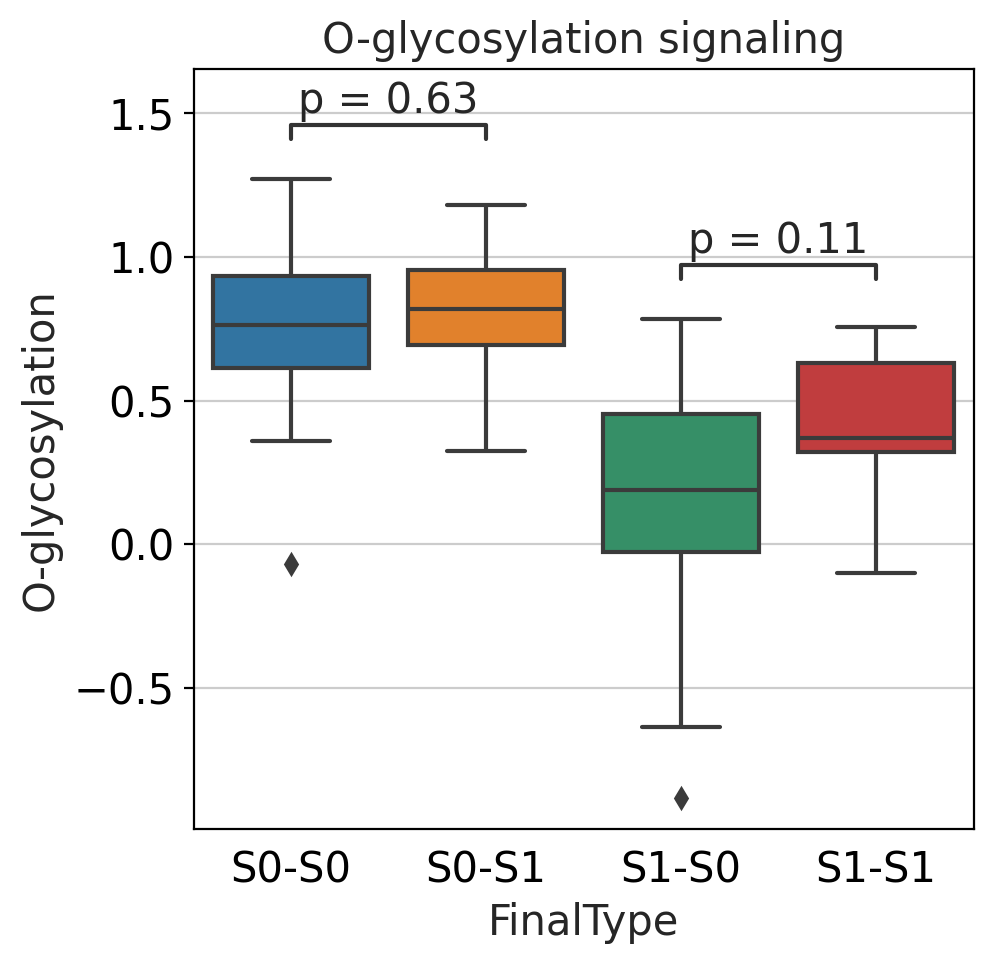

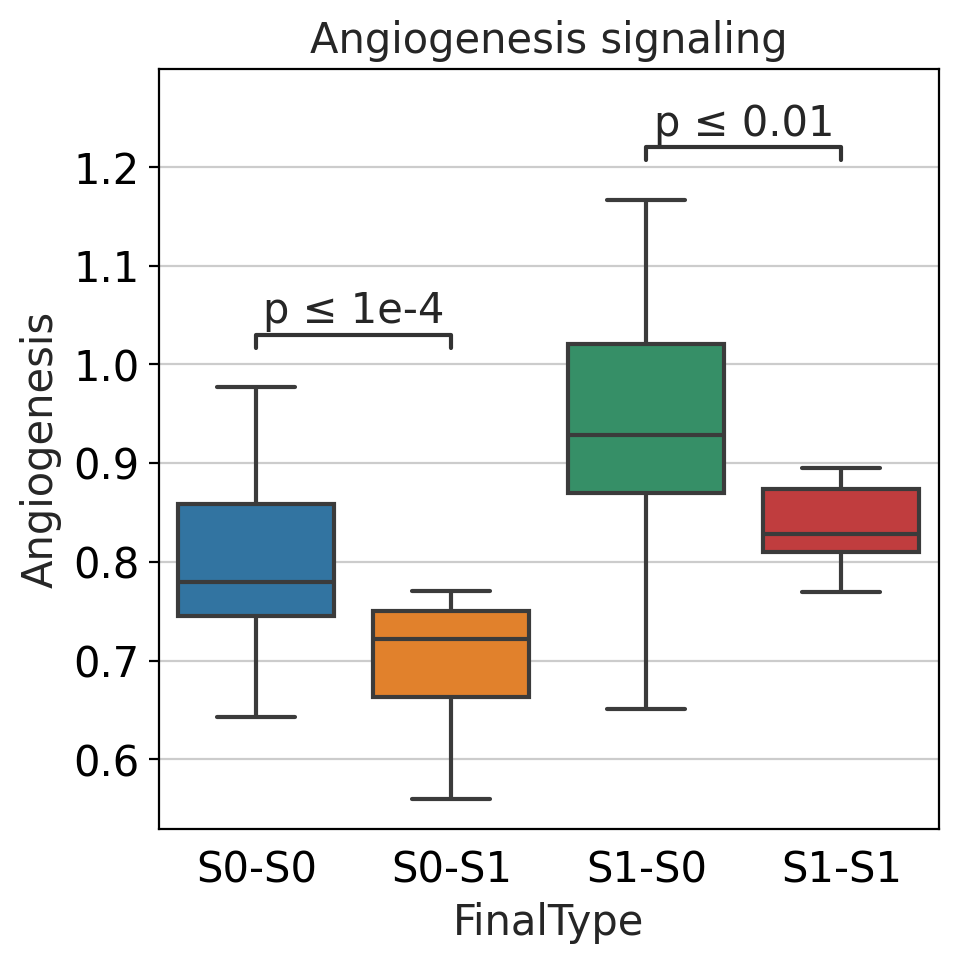

In [113]:
tumor_sig = ['EMT','Cell junction organization','TGF-beta','Regulation apoptosis','O-glycosylation','Angiogenesis']

for sigtype in tumor_sig:
    x = "FinalType"
    y = sigtype
    order = ['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']
    title='{} signaling'.format(sigtype)
    ax = sns.boxplot(data=groupby_score, x=x, y=y, order=order)
    ax.set_title(title)
    test_results = add_stat_annotation(ax, data=groupby_score, x=x, y=y, order=order,
                                       box_pairs=[("S0-S0", "S0-S1"), ("S1-S0", "S1-S1")],
                                       test='t-test_welch', text_format='simple', comparisons_correction=None,
                                       loc='inside', verbose=0)
    plt.show()


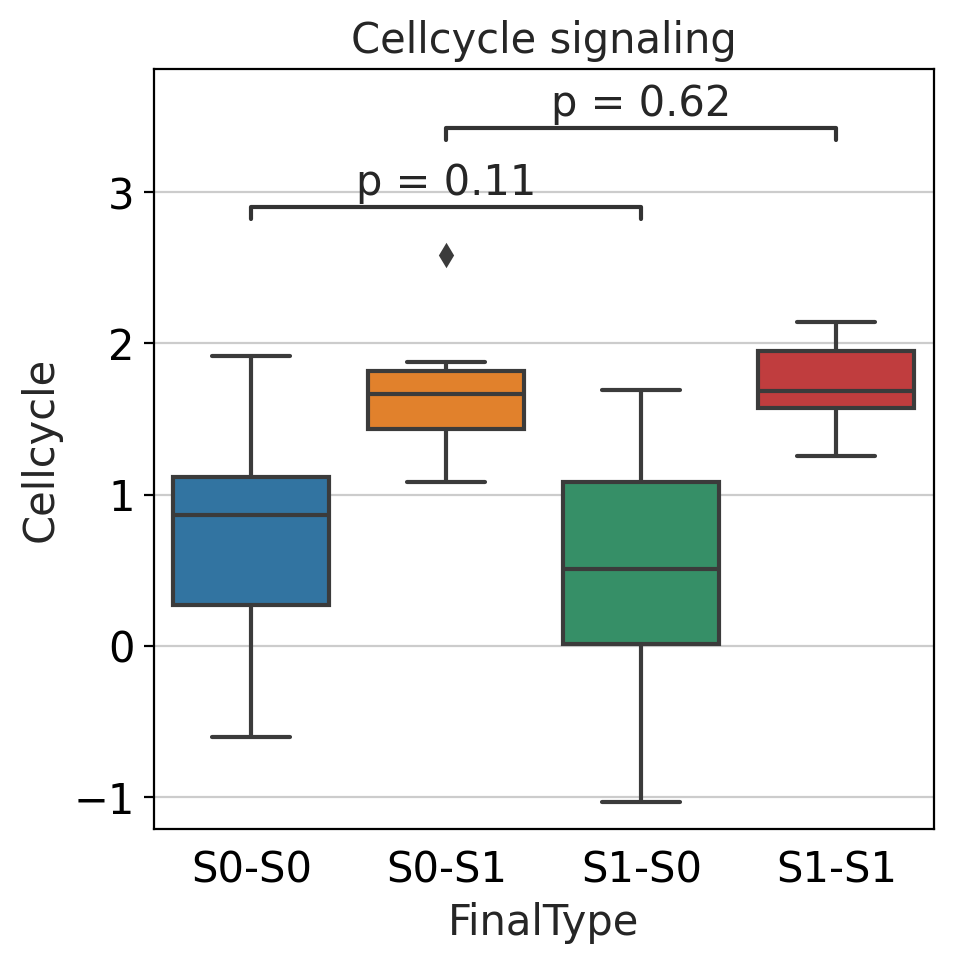

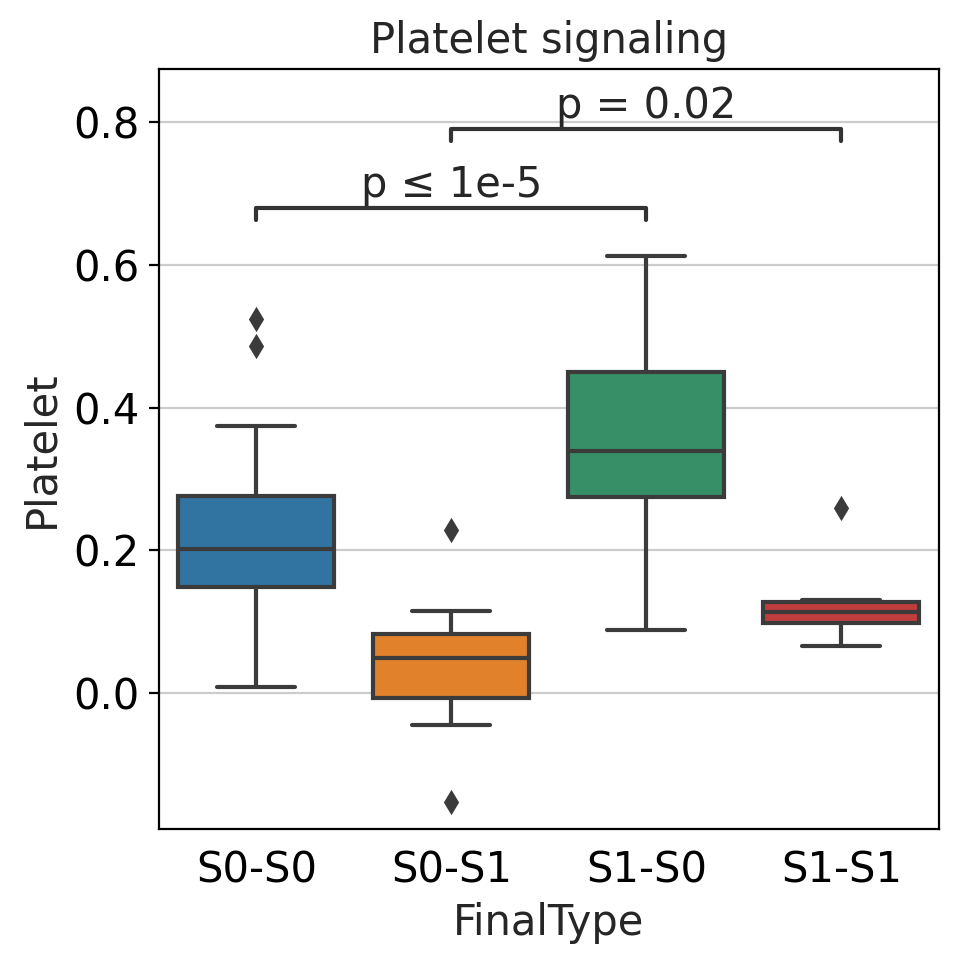

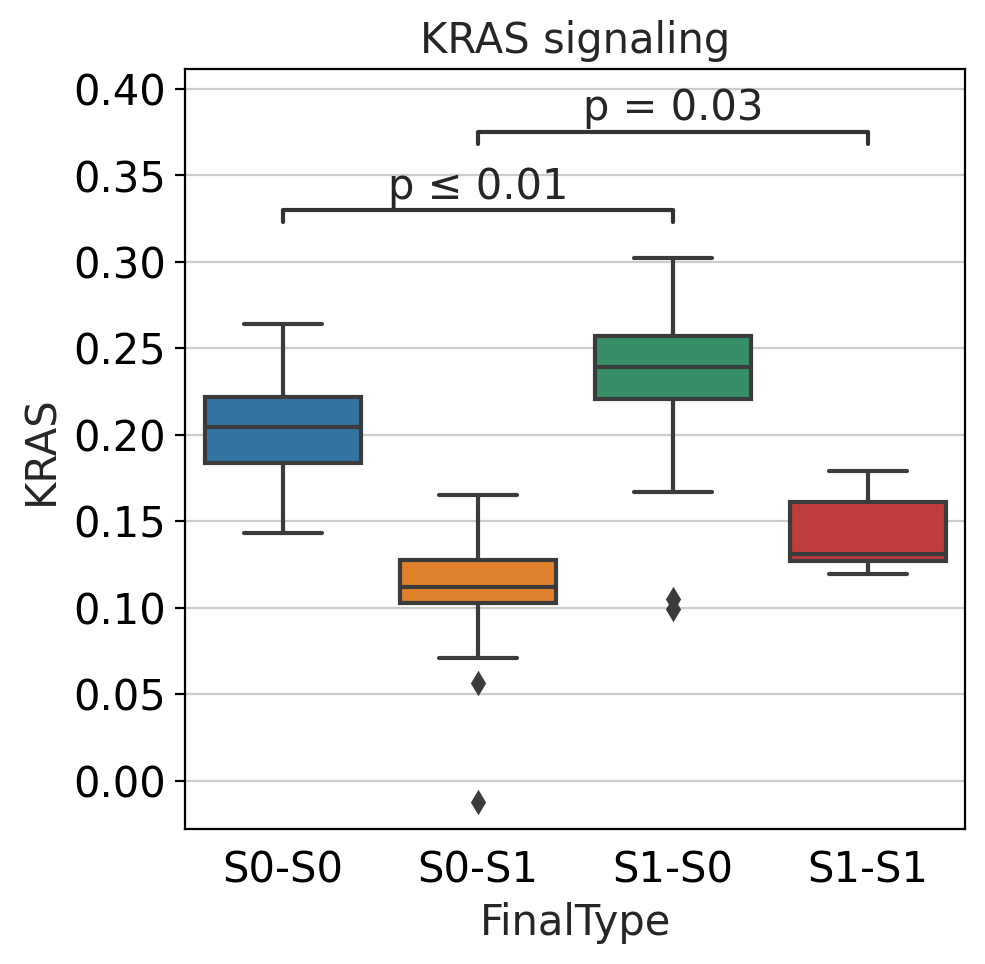

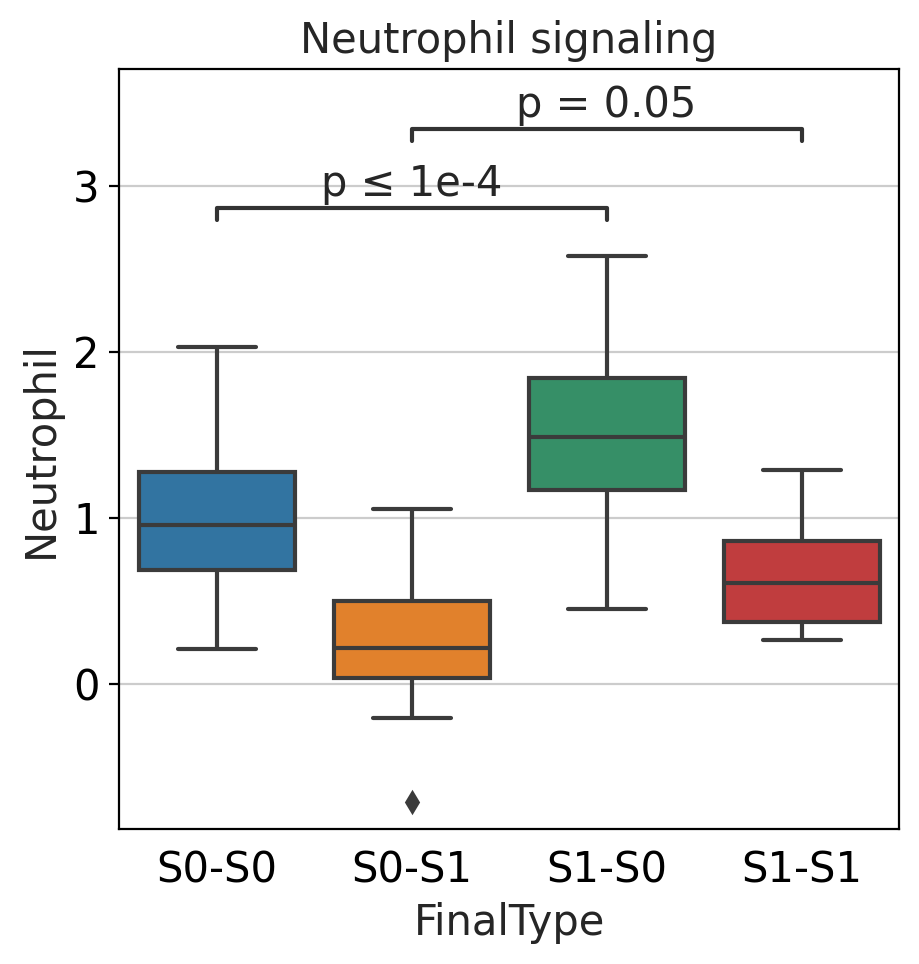

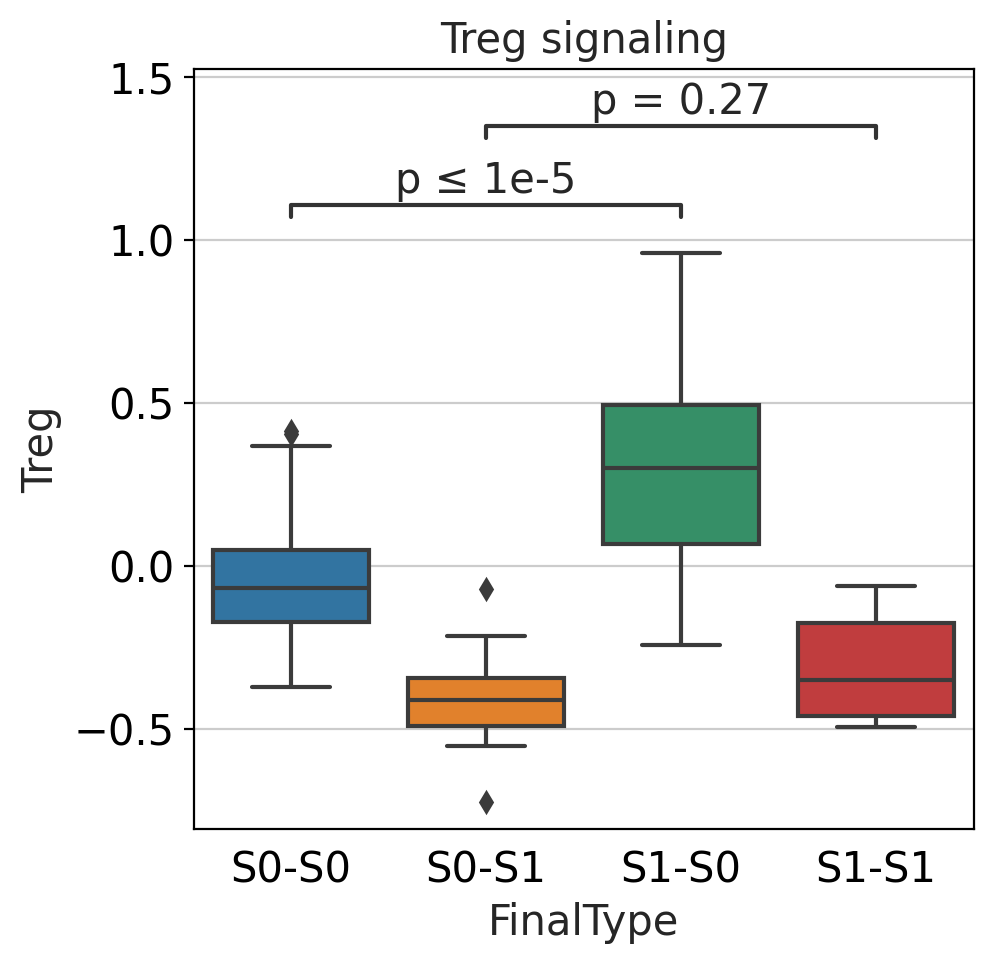

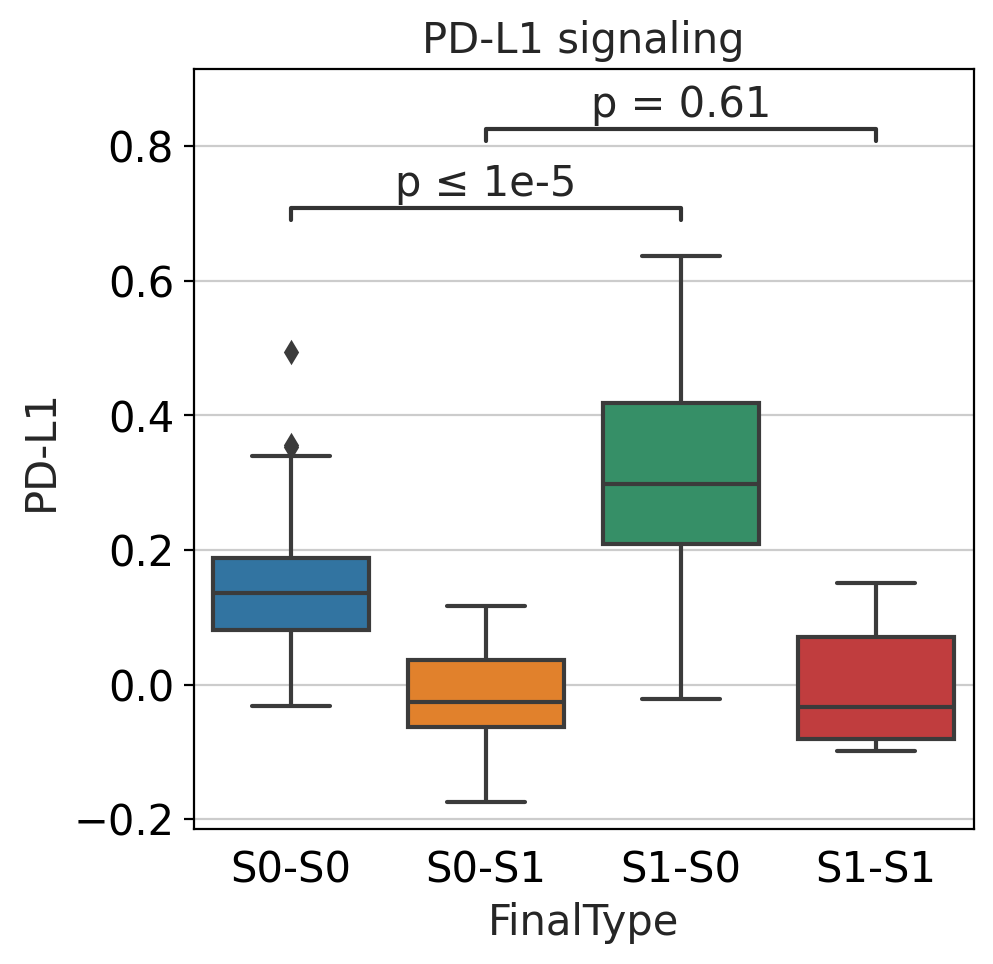

In [109]:
tme_sig = ['Cellcycle','Platelet','KRAS','Neutrophil','Treg','PD-L1']
for sigtype in tme_sig:
    x = "FinalType"
    y = sigtype
    order = ['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']
    title='{} signaling'.format(sigtype)
    ax = sns.boxplot(data=groupby_score, x=x, y=y, order=order)
    ax.set_title(title)
    test_results = add_stat_annotation(ax, data=groupby_score, x=x, y=y, order=order,
                                       box_pairs=[("S0-S0", "S1-S0"), ("S0-S1", "S1-S1")],
                                       test='t-test_welch', text_format='simple', comparisons_correction=None,
                                       loc='inside', verbose=0)
    plt.show()

In [114]:
signatures = ['EMT']
signatures = signatures+['Cell junction organization']*2
signatures = signatures+['TGF-beta']
signatures = signatures+['Regulation apoptosis']*5
signatures = signatures+['O-glycosylation']*5
signatures = signatures+['Angiogenesis']*4
signatures = signatures+['Cellcycle']*6
signatures = signatures+['Platelet']*2
signatures = signatures+['KRAS']*1
signatures = signatures+['Neutrophil']*6
signatures = signatures+['Treg']*4
signatures = signatures+['PD-L1']*2

sig_df = pd.DataFrame(signatures,columns=['Signature'])
sig_int_map = dict(zip(sig_df['Signature'].unique(),range(sig_df['Signature'].nunique())))
sigtype = sig_df['Signature'].map(sig_int_map).to_frame('Signature')
sig_color = mcp.gen_color(cmap="Spectral",n=sig_df['Signature'].nunique())
sigtype_lut = dict(zip(sig_df['Signature'].unique(), sig_color))
# cell_junction = 3
# apoptotic_regulation

In [115]:
len(sigtype_lut)

12

In [116]:
import textwrap
def idx_rename(x):
    if x.find('GO') != -1 or x.find('R-HSA') != -1:
        x_parse = x.split(' ')
        ret =  ' '.join(x_parse[:-1])
        ret = textwrap.fill(ret, 50)
        return ret
    else:
        ret = textwrap.fill(x, 50)
        return ret
    
    
        
ssGSEA.index = ssGSEA.index.map(idx_rename)


In [117]:
ssGSEA

,19-T00489_FO-01,19-T00192_FO-01,21-T01006_FT-01,21-T00749_FT-01,21-T00054_FT-01,21-T00575_FT-01,20-T00027_FO-01,21-T01027_FT-01,21-T00941_FT-01,19-T00506_FO-01,...,19-T00494_FO-01,20-T00311_FO-01,19-T00385_FO-01,19-T00737_FO-01,19-T00201_FO-01,19-T00714_FO-01,21-T00346_FT-01,19-T00668_FO-01,18-02904_FO-01,20-T00360_FO-01
Term|NES,,,,,,,,,,,,,,,,,,,,,
Epithelial Mesenchymal Transition,0.925400,-0.309427,0.606957,-0.346915,-0.659812,0.327253,0.188893,-0.091614,-0.293530,-0.090070,...,-0.124410,2.182904,0.623818,1.150772,-0.192205,-0.230954,0.408198,-0.504317,-0.284012,1.504384
Cell junction organization Homo sapiens,-0.072473,0.104862,0.168382,0.939526,0.969330,0.239510,0.666848,0.584936,0.486679,0.221043,...,-0.820604,-0.129356,-0.740707,-2.719585,0.489162,0.543237,0.626321,-1.258222,-0.154156,-0.062290
Cell-cell junction organization Homo sapiens,-0.274914,0.140618,-0.005724,0.935970,0.973196,-0.149991,0.480031,0.565265,0.450801,0.243859,...,-0.776735,-0.320316,-0.944564,-2.451396,0.457743,0.401367,0.638320,-0.945365,-0.108823,-0.165315
TGF-beta Signaling,-0.147504,-0.079119,0.432042,0.320242,-0.352941,0.455802,0.421907,0.102080,0.279204,0.598525,...,-0.131481,1.497818,0.642955,0.809581,0.872001,0.221343,0.652853,-0.470074,0.197665,1.236108
positive regulation of intrinsic apoptotic\nsignaling pathway,0.043520,0.478108,-0.604334,-1.004427,-0.101017,0.454352,0.339987,-0.023847,-0.416379,-0.580620,...,0.651156,-0.355193,1.825397,-0.589282,0.248897,0.192408,-0.184624,1.115024,0.323226,1.057074
regulation of extrinsic apoptotic signaling\npathway via death domain receptors,0.022300,0.611415,-1.114084,-1.368664,-2.579656,0.936887,0.101294,-0.351204,-0.563179,0.605269,...,1.575406,0.376156,0.842812,0.496286,-0.037989,0.432106,0.192602,-0.205127,0.380504,0.102291
regulation of intrinsic apoptotic signaling\npathway,0.342111,0.275258,-0.986117,-1.176931,-0.305206,0.178475,-0.043821,-0.169455,-1.012811,-0.626120,...,0.296304,0.404469,1.962527,-0.749221,-0.115028,-0.122242,-0.581046,2.076682,0.215607,1.068544
positive regulation of apoptotic signaling pathway,-0.195737,0.373577,-0.768931,-0.908644,0.108242,0.411423,0.499777,-0.243627,-0.061297,-0.310054,...,0.056721,0.145643,1.843541,-0.439873,0.296150,-0.302757,0.256166,1.788885,0.533434,1.339027
positive regulation of apoptotic process,0.057207,0.204403,0.375094,-1.042550,-0.084774,1.270400,0.755996,-0.982013,0.124695,0.115317,...,0.811889,-0.137961,0.367524,1.385851,-0.233616,-0.738206,-0.155208,1.553459,-0.493299,0.310198


In [129]:
fig = plt.figure(figsize=(25, 55), dpi= 150)
widths = [1,25]
heights = [1,1,45]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.05, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[2, 0])
sns.heatmap(sigtype, cmap=list(sigtype_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=sigtype_lut[name]) for name in sigtype_lut]
ax_legend = ax.legend(handles, sigtype_lut, bbox_to_anchor=(28.5, 0), frameon=False, 
                              fontsize=25, markerscale=2, ncol=int(len(sigtype_lut)/2))


ax_legend.set_title('$\\bf{Signaure}$',prop={'size':20})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
ax.set_ylabel('Signaures',fontdict={'fontsize':30,'weight':'bold'})
ax.margins(0)


ax = fig.add_subplot(gs[0, 1])
sns.heatmap(CE, cmap=list(CE_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=CE_lut[name]) for name in CE_lut]
ax_legend = ax.legend(handles, CE_lut, bbox_to_anchor=(1.465, 1.6), frameon=False, 
                              fontsize=25, markerscale=2, ncol=5)
ax_legend.set_title('$\\bf{Ecotyper}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Ecotyper',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


# ax = fig.add_subplot(gs[1, 1])
# sns.heatmap(FFX, cmap=list(FFX_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
# ax_legend = ax.legend(handles, FFX_lut, bbox_to_anchor=(1.5, 1.3), frameon=False, 
#                               fontsize=30, markerscale=2, ncol=4)
# ax_legend.set_title('$\\bf{FFX}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_ylabel('FFX',fontdict={'fontsize':25,'weight':'bold'})
# ax.margins(0)


final_int_map = dict(zip(head['FinalType'].unique(),range(head['FinalType'].nunique())))
final = head['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
ax = fig.add_subplot(gs[1, 1])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.516, 1.5),
                              fontsize=30, markerscale=2, frameon=False, ncol=4)
ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
#ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)


plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False

# ax = fig.add_subplot(gs[4, 0])
# sns.heatmap(epic, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# #ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# ax.tick_params(axis='y', labelsize=15)
# ax.set_title('Deconvolution-EPIC',fontdict={'fontsize':20})



# ax = fig.add_subplot(gs[5, 0])
# sns.heatmap(quantiseq, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# #ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# ax.tick_params(axis='y', labelsize=15)
# ax.set_title('Deconvolution-quanTIseq',fontdict={'fontsize':20})


# cbar_ax = fig.add_axes([0.1, 0.5, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
# cbar_ax.tick_params(axis=u'both', which=u'both',length=0)

# ax = fig.add_subplot(gs[2, 1])
# sns.heatmap(mcp_counter, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# #ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# ax.tick_params(axis='y', labelsize=25)
# ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})


cbar_ax = fig.add_axes([1.3, 0.80, 0.02, 0.03], frameon=False, xticklabels=[], yticklabels=[])
cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
ax = fig.add_subplot(gs[2, 1])
sns.heatmap(ssGSEA, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
#ax.set_yticks([])
# cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
ax.set_xticks([])
#ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
ax.set_ylabel('')
ax.tick_params(axis='y', labelsize=25)
ax.set_title('ssGSEA',fontdict={'fontsize':30,'weight':'bold'})
#ax.yaxis.tick_right()
# ax.yaxis.set_label_position("right")
# ax.set_yticks(rotation=90)
plt.show()

plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True

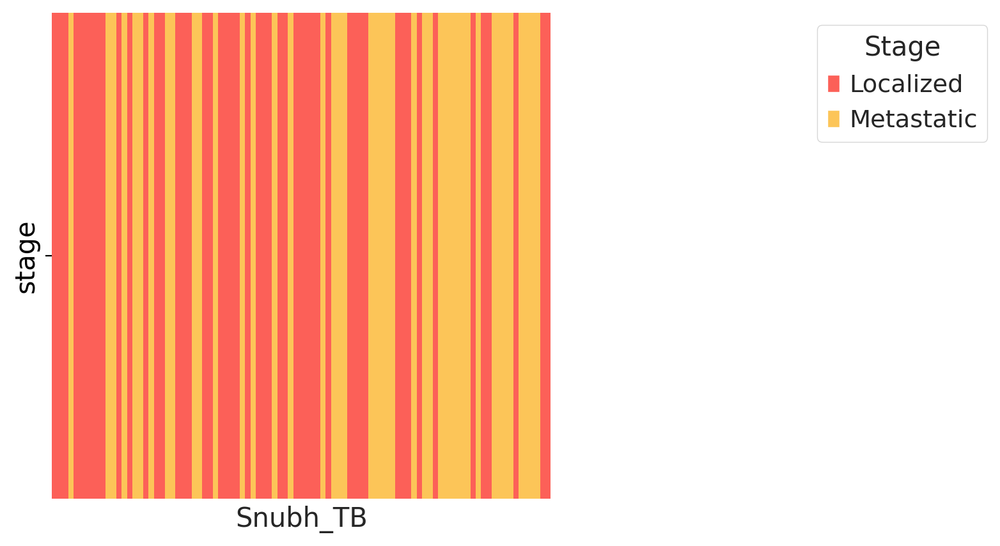

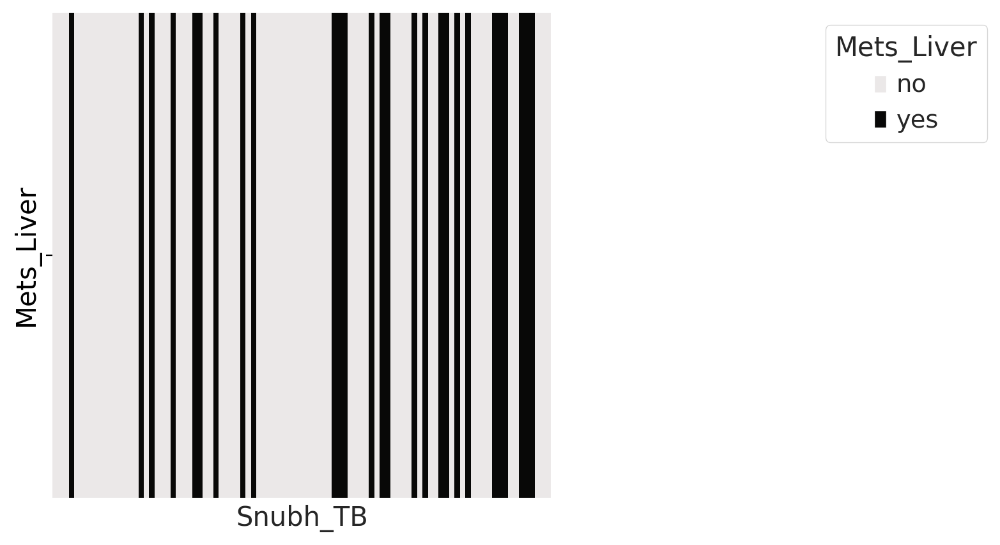

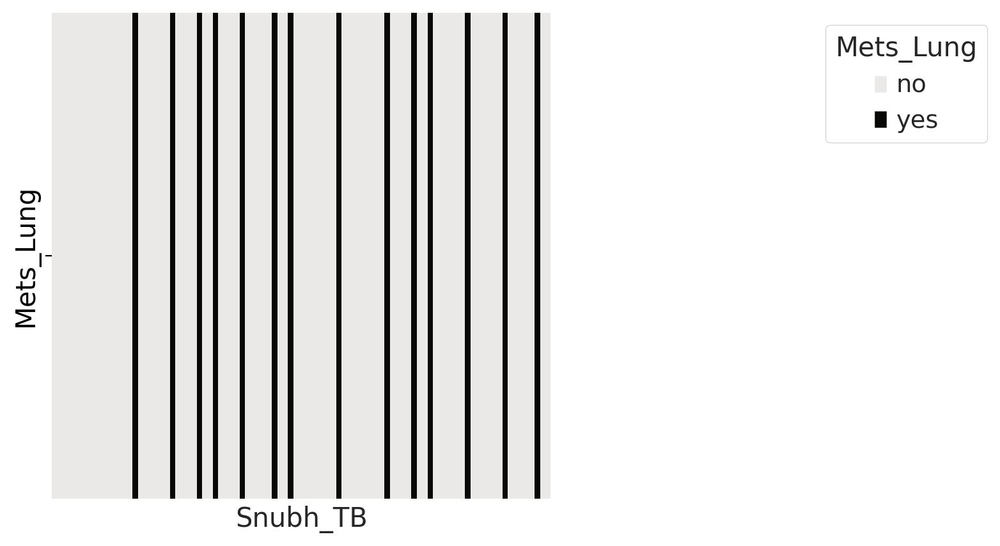

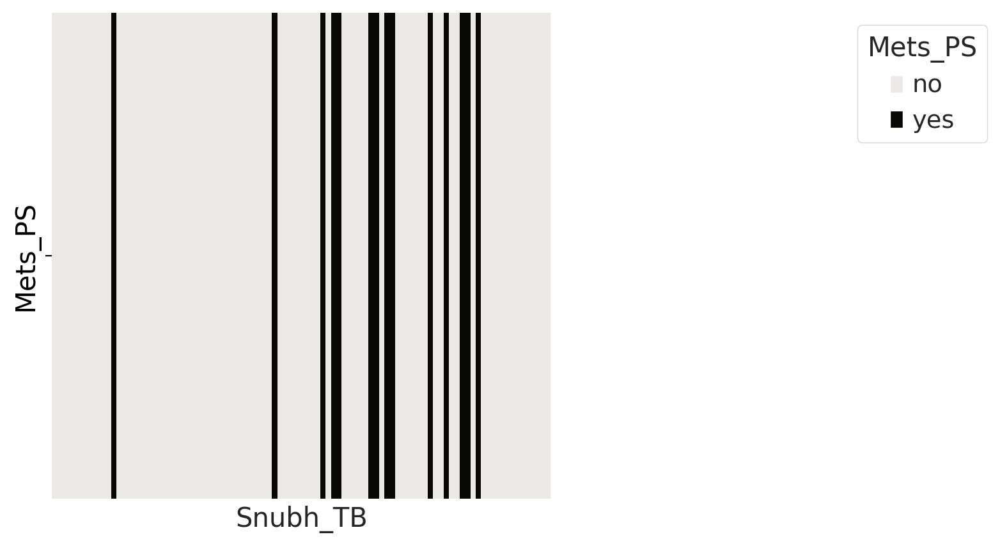

In [113]:
order = list(annotation.index)
with_stage = pd.concat([SNU_adata_HVG.obs.loc[:,['stage_C','Mets_liver_C','Mets_lung_C','Mets_PS_C', 'CTx_response_FFX']], SNU_annot],axis=1)
with_stage = with_stage.loc[order,:]
with_stage.loc[:,['Mets_liver_C','Mets_lung_C','Mets_PS_C']] = with_stage.loc[:,['Mets_liver_C','Mets_lung_C','Mets_PS_C']].astype(str)
with_stage = with_stage.replace('nan','no')

stage_map = dict(zip(with_stage['stage_C'].unique(),range(with_stage['stage_C'].nunique())))
stage_color = ['#fc6058','#fcc558']
stage_lut = dict(zip(with_stage['stage_C'].unique(), stage_color))
stage = with_stage['stage_C'].map(stage_map).astype(int).to_frame('stage').T
ax=sns.heatmap(stage, cmap=stage_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=stage_lut[name]) for name in stage_lut]
ax.legend(handles4, stage_lut, title='Stage',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

liver_map = dict(zip(with_stage['Mets_liver_C'].unique(),range(with_stage['Mets_liver_C'].nunique())))
liver_color = ['#ebe8e8','#080807']
liver_lut = dict(zip(with_stage['Mets_liver_C'].unique(), liver_color))
liver_lut
liver = with_stage['Mets_liver_C'].map(liver_map).astype(int).to_frame('Mets_Liver').T
ax=sns.heatmap(liver, cmap=liver_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=liver_lut[name]) for name in liver_lut]
ax.legend(handles4, liver_lut, title='Mets_Liver',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

lung_map = dict(zip(with_stage['Mets_lung_C'].unique(),range(with_stage['Mets_lung_C'].nunique())))
lung_color = ['#ebe8e8','#080807']
lung_lut = dict(zip(with_stage['Mets_lung_C'].unique(), lung_color))

lung = with_stage['Mets_lung_C'].map(lung_map).astype(int).to_frame('Mets_Lung').T
ax=sns.heatmap(lung, cmap=lung_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=lung_lut[name]) for name in lung_lut]
ax.legend(handles4, lung_lut, title='Mets_Lung',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

ps_map = dict(zip(with_stage['Mets_PS_C'].unique(),range(with_stage['Mets_PS_C'].nunique())))
ps_color = ['#ebe8e8','#080807']
ps_lut = dict(zip(with_stage['Mets_PS_C'].unique(), ps_color))

ps = with_stage['Mets_PS_C'].map(ps_map).astype(int).to_frame('Mets_PS').T
ax=sns.heatmap(ps, cmap=ps_color, cbar=False)
handles4 = [mpatches.Patch(facecolor=ps_lut[name]) for name in ps_lut]
ax.legend(handles4, ps_lut, title='Mets_PS',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])
plt.show()

In [114]:
FFX_lut

{'responder': '#2e1dcc', 'NA': '#ebe8e8', 'non-responder': '#b52b0b'}

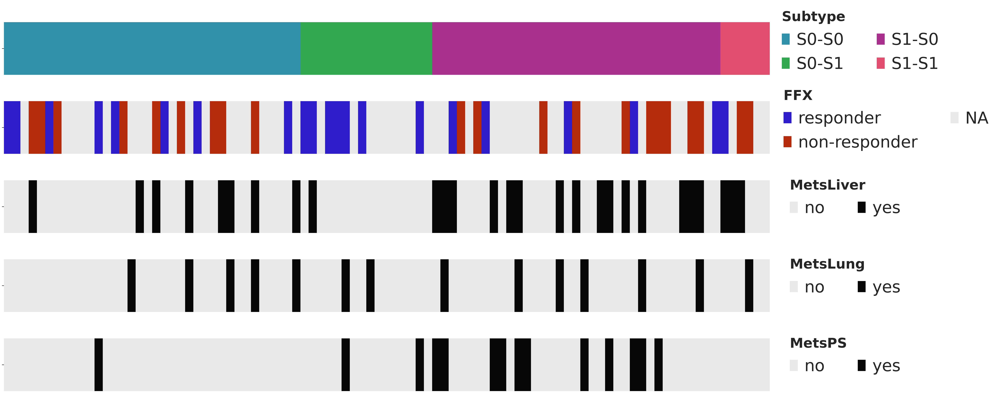

In [115]:
fig = plt.figure(figsize=(25, 15), dpi= 150)
widths = [1]
heights = [1,1,1,1,1,1]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.5, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax = fig.add_subplot(gs[1, 0])
sns.heatmap(FFX, cmap=list(FFX_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=FFX_lut[name]) for name in ['responder', 'non-responder', 'NA']]
ax_legend = ax.legend(handles, {'responder':'#2e1dcc','non-responder':'#b52b0b','NA':'#ebe8e8'}, 
                      bbox_to_anchor=(1.305, 1.5), frameon=False, 
                              fontsize=30, markerscale=2, ncol=2)
ax_legend.set_title('$\\bf{FFX}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels('')
#ax.set_ylabel('FFX',fontdict={'fontsize':25,'weight':'bold'})
ax.margins(0)

final_int_map = dict(zip(head['FinalType'].unique(),range(head['FinalType'].nunique())))
final = head['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
ax = fig.add_subplot(gs[0, 0])
sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.24, 1.5),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.margins(0)

# ax = fig.add_subplot(gs[2, 0])
# sns.heatmap(stage, cmap=list(stage_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=stage_lut[name]) for name in stage_lut]
# ax_legend = ax.legend(handles, stage_lut, bbox_to_anchor=(1.17, 1.5),
#                               fontsize=30, markerscale=2, frameon=False, ncol=1)
# ax_legend.set_title('$\\bf{Stage}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels([])
# ax.margins(0)

ax = fig.add_subplot(gs[2, 0])
sns.heatmap(liver, cmap=list(liver_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=liver_lut[name]) for name in liver_lut]
ax_legend = ax.legend(handles, liver_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsLiver}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.margins(0)

ax = fig.add_subplot(gs[3, 0])
sns.heatmap(lung, cmap=list(lung_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=lung_lut[name]) for name in lung_lut]
ax_legend = ax.legend(handles, lung_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsLung}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.margins(0)

ax = fig.add_subplot(gs[4, 0])
sns.heatmap(ps, cmap=list(ps_lut.values()), cbar=False, ax=ax)
handles = [mpatches.Patch(facecolor=ps_lut[name]) for name in ps_lut]
ax_legend = ax.legend(handles, ps_lut, bbox_to_anchor=(1.19, 1.3),
                              fontsize=30, markerscale=2, frameon=False, ncol=2)
ax_legend.set_title('$\\bf{MetsPS}$',prop={'size':25})
ax_legend._legend_box.align = "left"
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.margins(0)

plt.show()

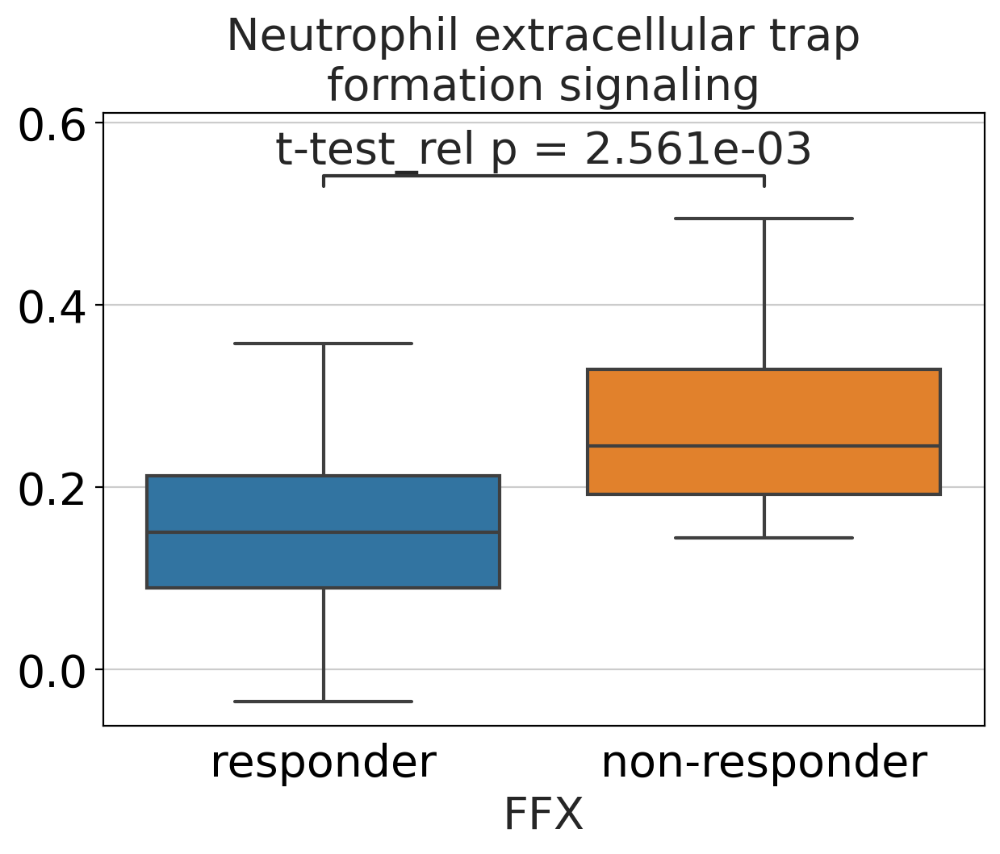

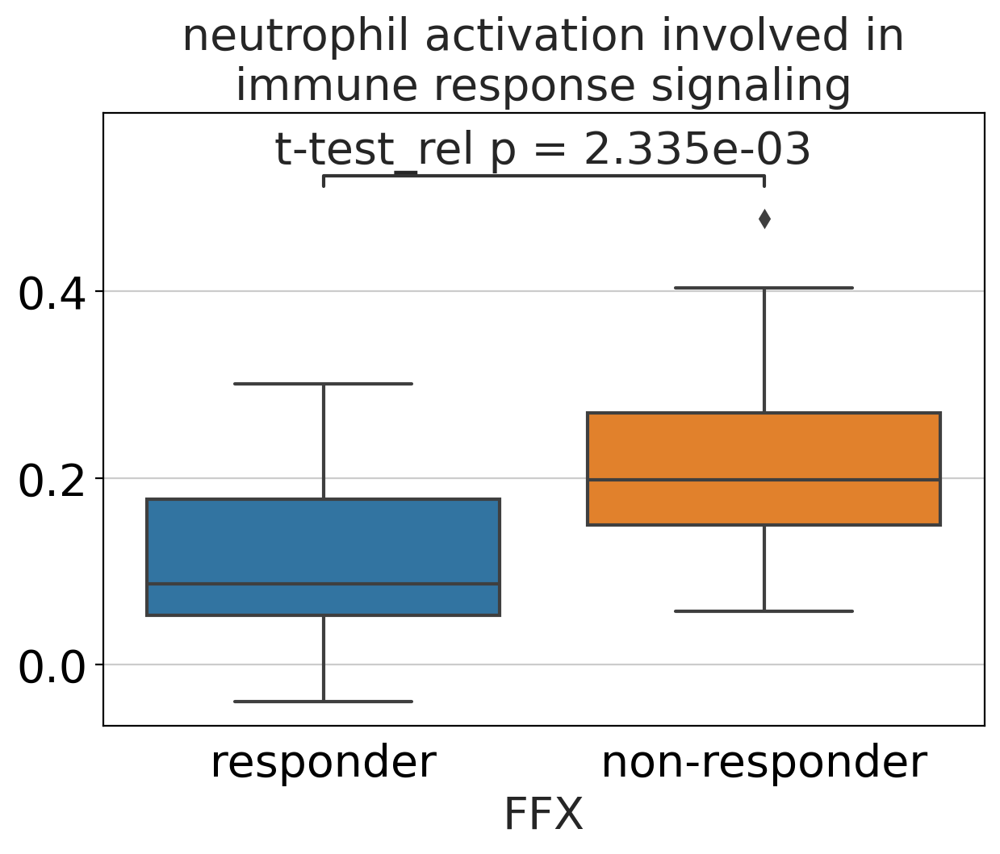

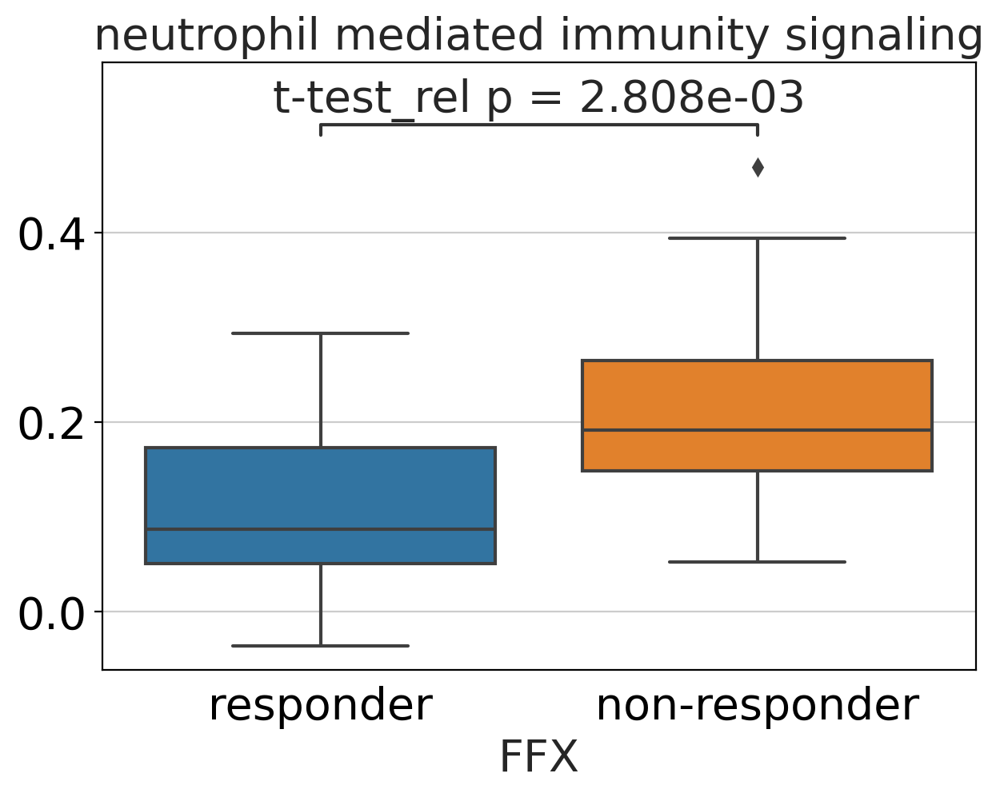

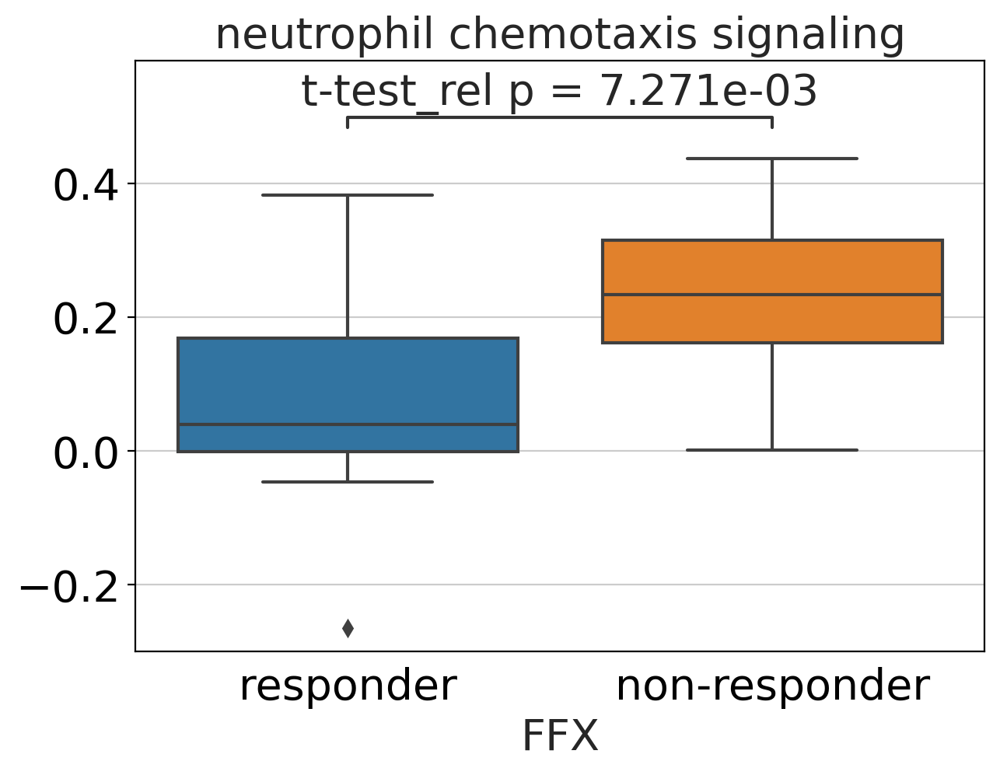

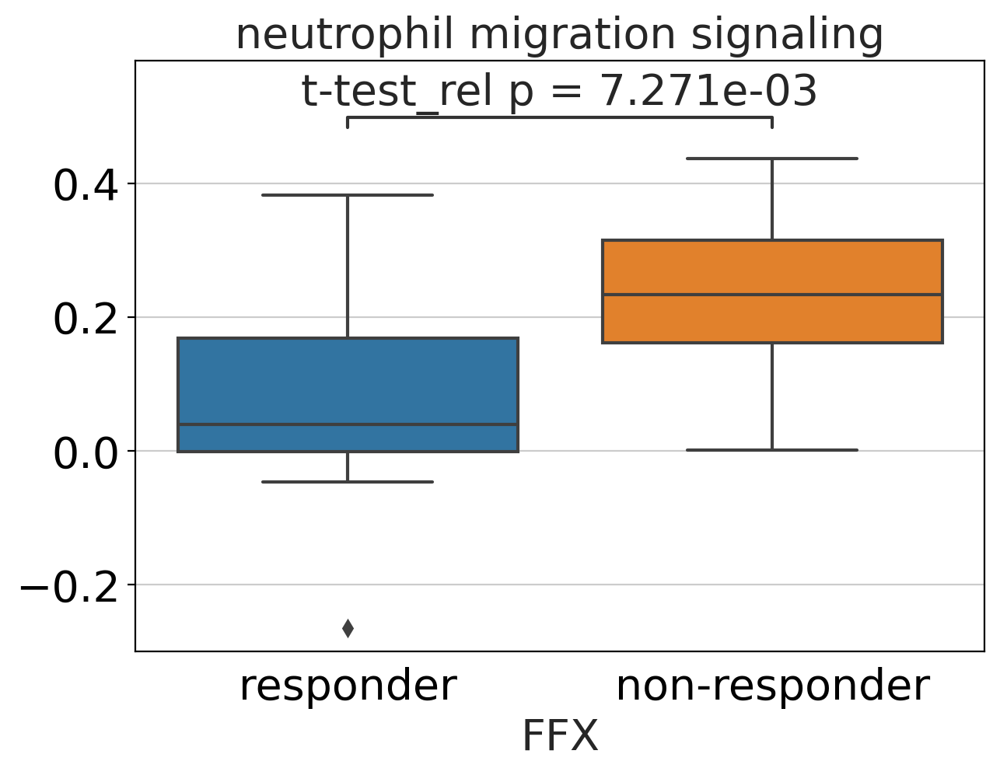

In [136]:
def idx_rename(x):
    if x.find('GO') != -1 or x.find('R-HSA') != -1:
        x_parse = x.split(' ')
        ret =  ' '.join(x_parse[:-1])
        ret = textwrap.fill(ret, 34)
        return ret
    else:
        ret = textwrap.fill(x, 34)
        return ret
sc.settings.set_figure_params(dpi=100, figsize=(7,5), fontsize=20)
ffx_dict = dict(zip(head['CTx_response_FFX'].index,head['CTx_response_FFX'].values))
tmp = ssScore.T
tmp.columns = tmp.columns.map(idx_rename)
tmp['FFX'] = tmp.index.map(ffx_dict)
tmp['FFX'] = tmp['FFX'].replace({'responder':1,'non-responder':0})
m = tmp['FFX'] != 'NA'
tmp = tmp[m]
tmp.drop('Type',inplace=True)
signals = list(tmp.astype(float).corr()['FFX'].sort_values().index[:6])
tmp['FFX'] = tmp['FFX'].replace({1:'responder',0:'non-responder'})
signals.remove('Platelet activation, signaling and\naggregation Homo sapiens')



c=0
nrow=2
total = len(signals)
ncol=int(np.ceil(total/nrow))

for sigtype in signals:
    x = "FFX"
    y = sigtype
    title='{} signaling'.format(sigtype)
    ax = sns.boxplot(data=tmp, x=x, y=y)
    ax.set_title(title)
    test_results = add_stat_annotation(ax, data=tmp, x=x, y=y,
                                       box_pairs=[("responder", "non-responder")],
                                       test='t-test_paired', text_format='full', comparisons_correction=None,
                                       loc='inside', verbose=0)
    plt.ylabel('')
    plt.show()
        
    

In [135]:
signals

['Neutrophil extracellular trap\nformation',
 'neutrophil activation involved in\nimmune response',
 'neutrophil mediated immunity',
 'Platelet activation, signaling and\naggregation Homo sapiens',
 'neutrophil chemotaxis',
 'neutrophil migration']

CTx_response_FFX  non-responder  responder
Tumor2Type_2nd                            
S0                            9         15
S1                           12          6
0.1189907208931241


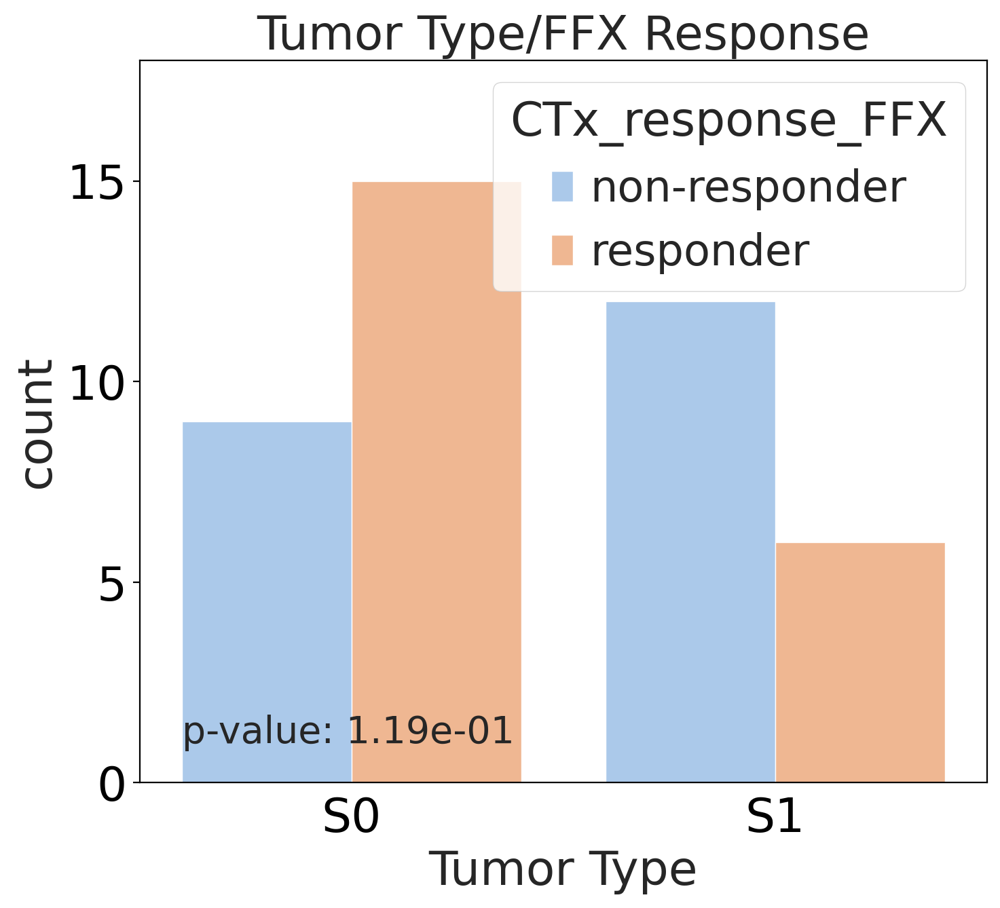

CTx_response_FFX  non-responder  responder
TME2Type_2nd                              
S0                           19         13
S1                            2          8
0.07007553859334138


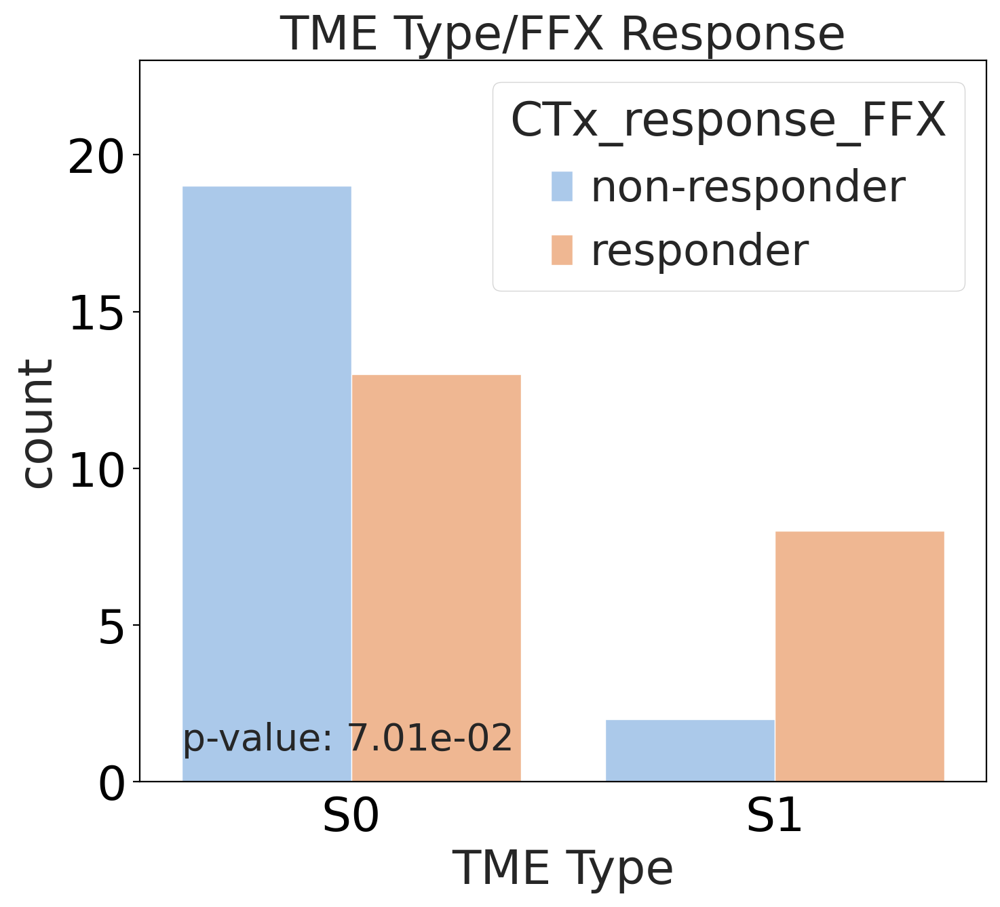

CTx_response_FFX  non-responder  responder
FinalType                                 
S0-S0                         9          8
S0-S1                         0          7
S1-S0                        10          5
S1-S1                         2          1
0.028518933256690387
['S0-S0', 'S0-S1']
0.04869854331452281
['S1-S0', 'S0-S1']
0.013688056704732604
['S1-S1', 'S0-S1']
0.12050736908665413


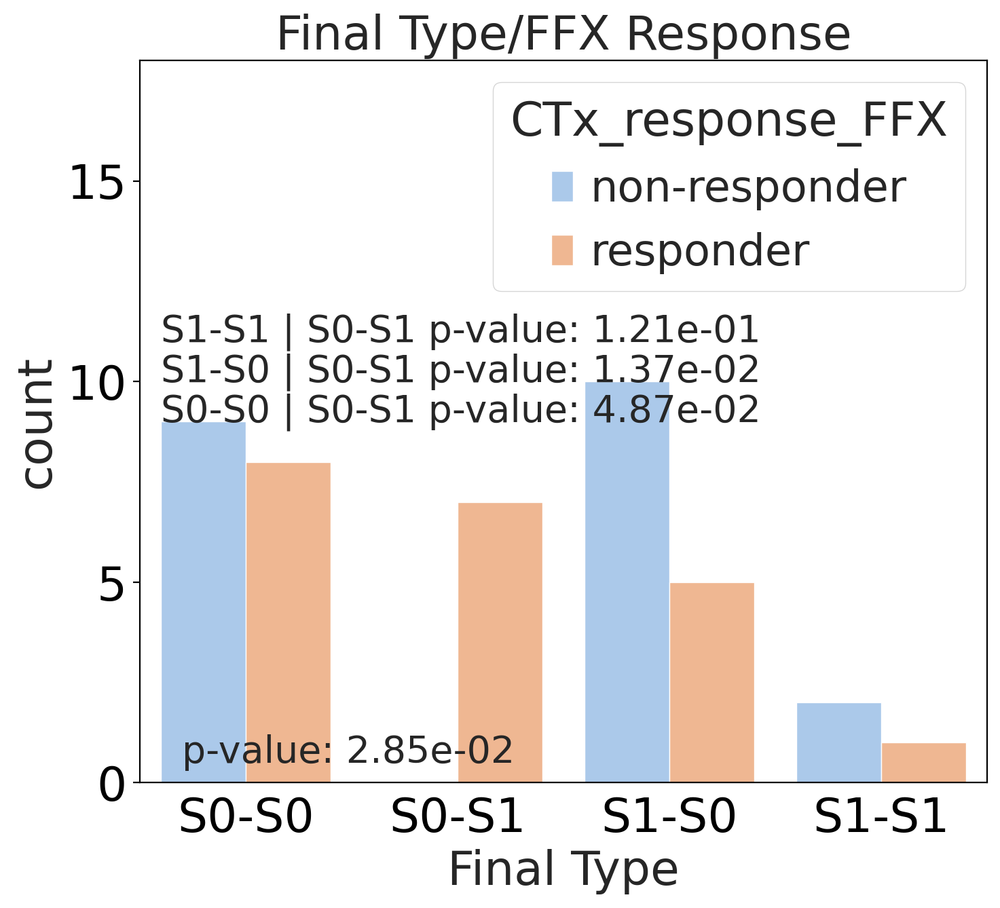

In [205]:
sc.settings.set_figure_params(dpi=100, figsize=(8,7), fontsize=25)

m = ~with_stage['CTx_response_FFX'].isna()
with_stage_sel = with_stage[m]
with_stage_sel


sns.countplot(x='Tumor2Type_2nd', hue='CTx_response_FFX', data=with_stage_sel, palette='pastel')
ct_table_ind=pd.crosstab(with_stage_sel['Tumor2Type_2nd'],with_stage_sel['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.4, 1, 'p-value: {}'.format(p_val), fontsize=20)
plt.title('{}/{}'.format('Tumor Type','FFX Response'))
plt.xlabel('Tumor Type')
plt.grid(False)
plt.ylim((0,18))
plt.show()

sns.countplot(x='TME2Type_2nd', hue='CTx_response_FFX', data=with_stage_sel, palette='pastel')
ct_table_ind=pd.crosstab(with_stage_sel['TME2Type_2nd'],with_stage_sel['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.4, 1, 'p-value: {}'.format(p_val), fontsize=20)
plt.title('{}/{}'.format('TME Type','FFX Response'))
plt.xlabel('TME Type')
plt.grid(False)
plt.ylim((0,23))
plt.show()

sns.countplot(x='FinalType', hue='CTx_response_FFX', data=with_stage_sel, palette='pastel')  
ct_table_ind=pd.crosstab(with_stage_sel['FinalType'],with_stage_sel['CTx_response_FFX'])
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.3, 0.5, 'p-value: {}'.format(p_val), fontsize=20)
i=1
p1 = ['S0-S0','S0-S1']
p2 = ['S1-S0','S0-S1']
p3 = ['S1-S1','S0-S1']
pair_ = [p1,p2,p3]
for pair in pair_:
    ct_table_ind_tmp = ct_table_ind.loc[pair,:]
    chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind_tmp)
    p_val="{:.2e}".format(p)
    plt.text(-0.4, 8+i, '{} | {} p-value: {}'.format(pair[0],pair[1],p_val), fontsize=20)
    i+=1
    print(pair)
    print(p)


plt.title('{}/{}'.format('Final Type','FFX Response'))
plt.xlabel('Final Type')
plt.grid(False)
plt.ylim((0,18))
plt.show()


# plt.show()

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


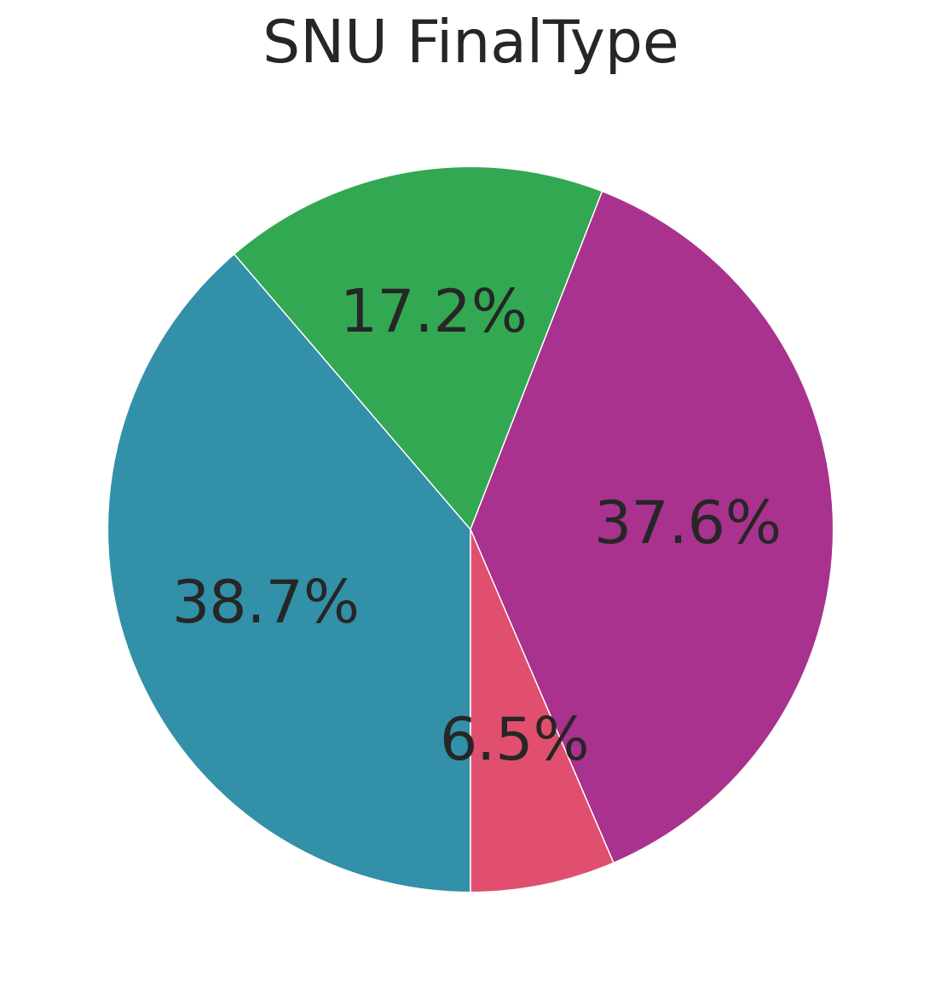

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


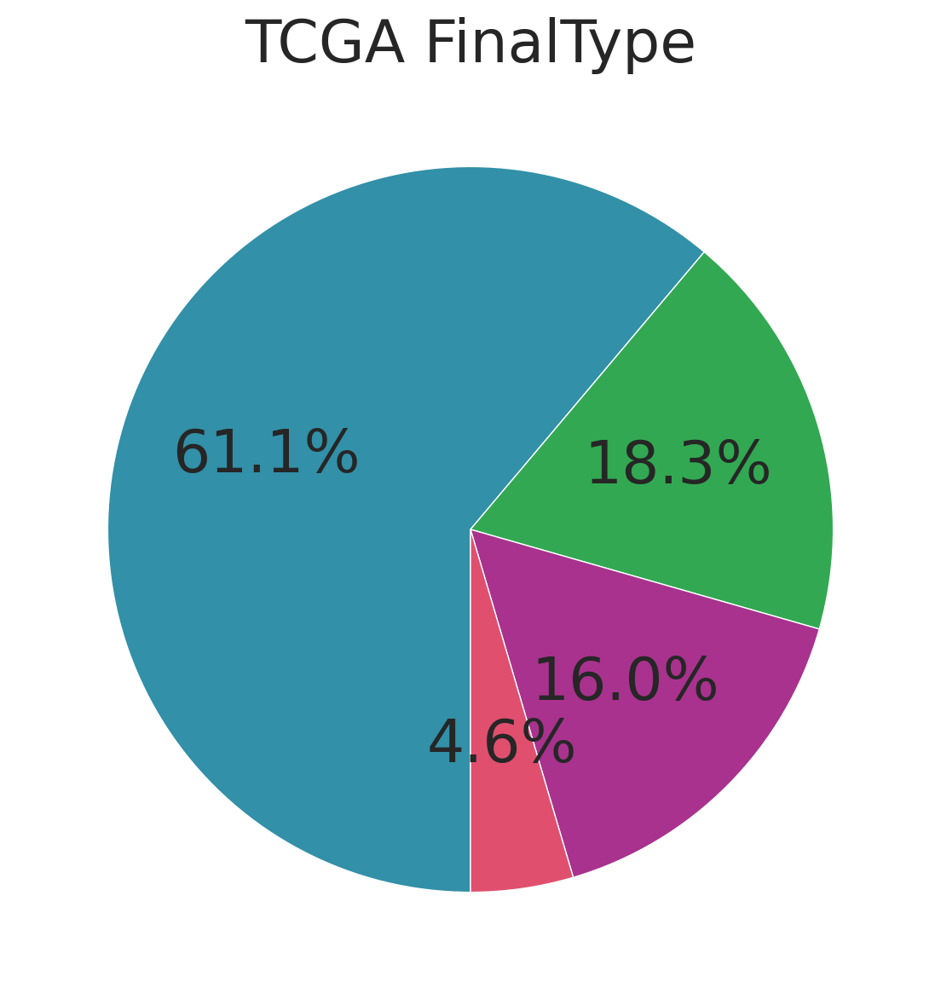

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


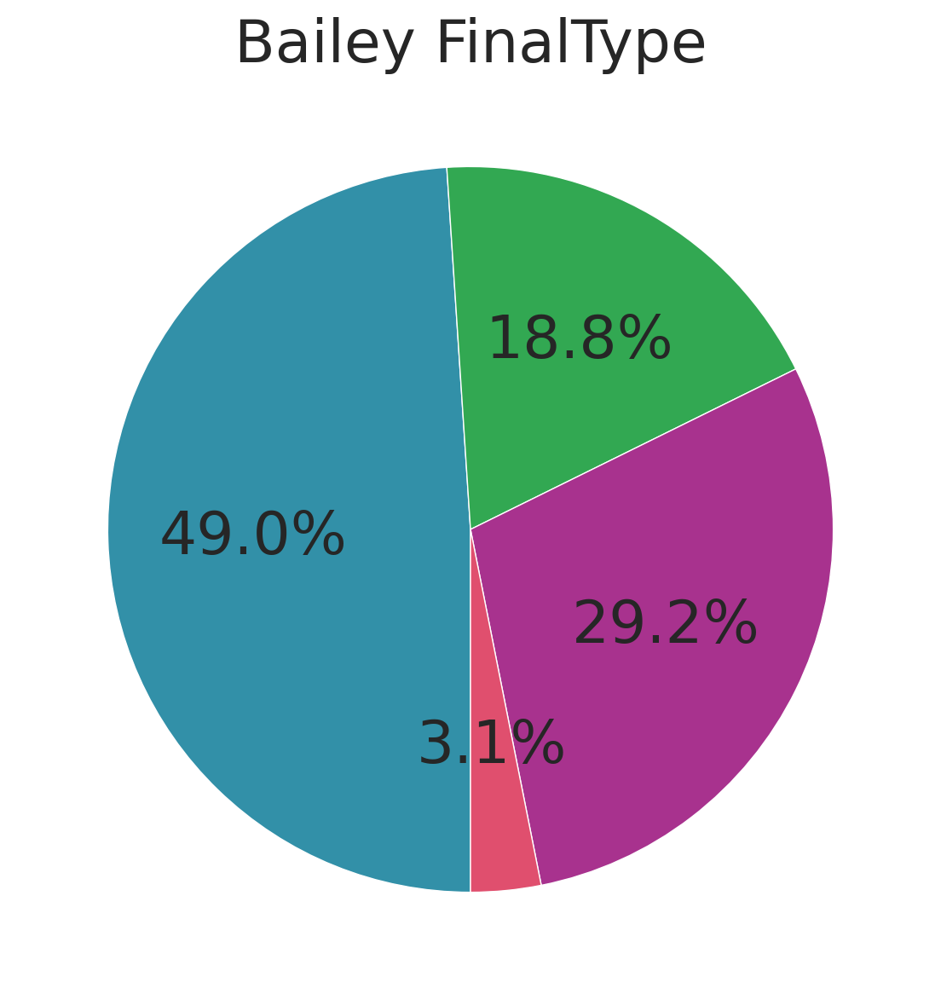

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


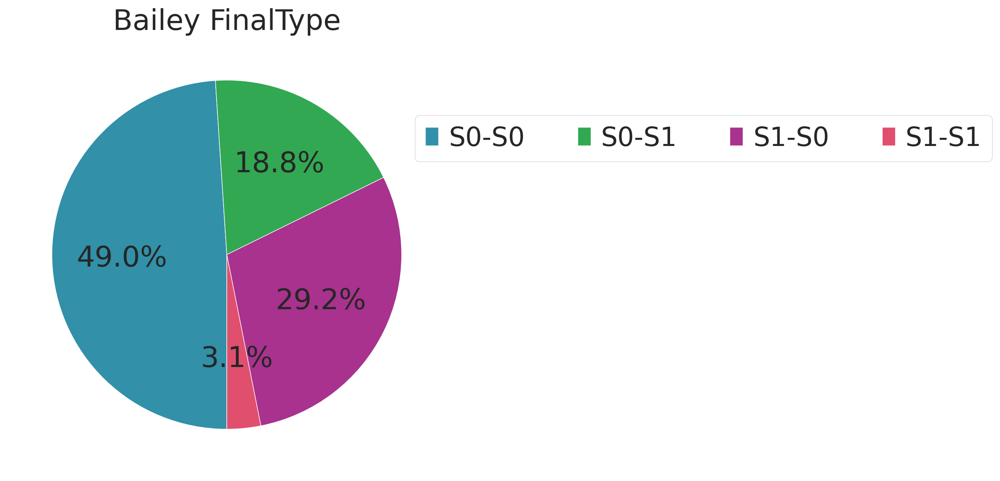

In [206]:
subtype = SNU_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('SNU FinalType')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = TCGA_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('TCGA FinalType')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = Bailey_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('Bailey FinalType')
#plt.legend(bbox_to_anchor=(0.9, .85),ncol=4)
plt.show()

subtype = Bailey_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('Bailey FinalType')
plt.legend(bbox_to_anchor=(0.9, .85),ncol=4)
plt.show()

In [1666]:
# import plotly.express as px

# fig = px.sunburst(with_stage_sel, path=['FinalType','CTx_response_FFX','Mets_liver_C','Mets_lung_C','Mets_PS_C'],
#                   color = 'CTx_response_FFX',
#                   color_discrete_map={'responder':'blue','non-responder':'red','(?)':''},
#                  width=1000, height=1000)

# fig.update_traces(textfont=dict(size=15))
# fig.show()

In [207]:
import plotly
def genSankey(df,cat_cols=[],value_cols='',title='Sankey Diagram',custom_color=None):
    # maximum of 6 value cols -> 6 colors
    colorPalette=mcp.gen_color(cmap="Spectral",n=len(cat_cols))
    labelList = []
    colorNumList = []
    for catCol in cat_cols:
        labelListTemp =  list(set(df[catCol].values))
        colorNumList.append(len(labelListTemp))
        labelList = labelList + labelListTemp
    
    if not custom_color:
        # remove duplicates from labelList
        labelList = list(dict.fromkeys(labelList))
        # define colors based on number of levels
        colorList = []
        for idx, colorNum in enumerate(colorNumList):
            colorList = colorList + [colorPalette[idx]]*colorNum         
    else:
        labelList = list(custom_color.keys())
        colorList = list(custom_color.values())
        
        
        
    
        
    # transform df into a source-target pair
    for i in range(len(cat_cols)-1):
        if i==0:
            sourceTargetDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            sourceTargetDf.columns = ['source','target','count']
        else:
            tempDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            tempDf.columns = ['source','target','count']
            sourceTargetDf = pd.concat([sourceTargetDf,tempDf])
        sourceTargetDf = sourceTargetDf.groupby(['source','target']).agg({'count':'sum'}).reset_index()
        
    # add index for source-target pair
    sourceTargetDf['sourceID'] = sourceTargetDf['source'].apply(lambda x: labelList.index(x))
    sourceTargetDf['targetID'] = sourceTargetDf['target'].apply(lambda x: labelList.index(x))
    
    # creating the sankey diagram
    data = dict(
        type='sankey',
        node = dict(
          pad = 15,
          thickness = 20,
          line = dict(
            color = "black",
            width = 0.5
          ),
          label = labelList,
          color = colorList
        ),
        link = dict(
          source = sourceTargetDf['sourceID'],
          target = sourceTargetDf['targetID'],
          value = sourceTargetDf['count'],
#           color = [
#                 px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)]
#                 for i in sourceTargetDf["sourceID"]
#             ],
                        
        )
      )
    
    layout =  dict(
        title = title,
        font = dict(
          size = 20
        )
    )
    
    fig = dict(data=[data], layout=layout)
    #print(data)  
    return fig

In [1945]:
# with_stage_sel['Mets_Pattern'].value_counts()

In [208]:
replace_ = dict()
replace_['Liver-no\nLung-no\nPS-no']='Localized'
replace_['Liver-yes\nLung-no\nPS-no']='Liver'
replace_['Liver-no\nLung-no\nPS-yes']='PS'
replace_['Liver-yes\nLung-yes\nPS-no']='Liver/Lung'
replace_['Liver-no\nLung-yes\nPS-yes']='Lung/PS'
replace_['Liver-no\nLung-yes\nPS-no']='Lung'
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
with_stage_sel['Mets_Pattern'] = 'Liver-'+with_stage_sel['Mets_liver_C']+'\n'+'Lung-'+with_stage_sel['Mets_lung_C']+'\n'+'PS-'+with_stage_sel['Mets_PS_C']
with_stage_sel = with_stage_sel.replace(replace_)
category = ['FinalType','CTx_response_FFX','Mets_Pattern']
to_sankey = with_stage_sel.groupby(category).size().reset_index(name='counts')
to_sankey
m = to_sankey['counts'] != 0
to_sankey = to_sankey[m]
to_sankey

fig = genSankey(to_sankey,cat_cols=category,value_cols='counts',title='Sankey Diagram')
iplot(fig, validate=False)

In [209]:
sankey_col = dict()
sankey_col['S0-S0']='#3290a8'
sankey_col['S0-S1']='#32a852'
sankey_col['S1-S0']='#a8328e'
sankey_col['S1-S1']='#e04f6e'
sankey_col['responder']='#2e1dcc'
sankey_col['non-responder']='#b52b0b'

sankey_col['Localized']='#ebe8e8'
sankey_col['Liver']='#080807'
sankey_col['PS']='#080807'
sankey_col['Liver/Lung']='#080807'
sankey_col['Lung/PS']='#080807'
sankey_col['Lung']='#080807'
sankey_col

fig = genSankey(to_sankey,cat_cols=category,value_cols='counts',title='Sankey Diagram',custom_color=sankey_col)
iplot(fig, validate=False)

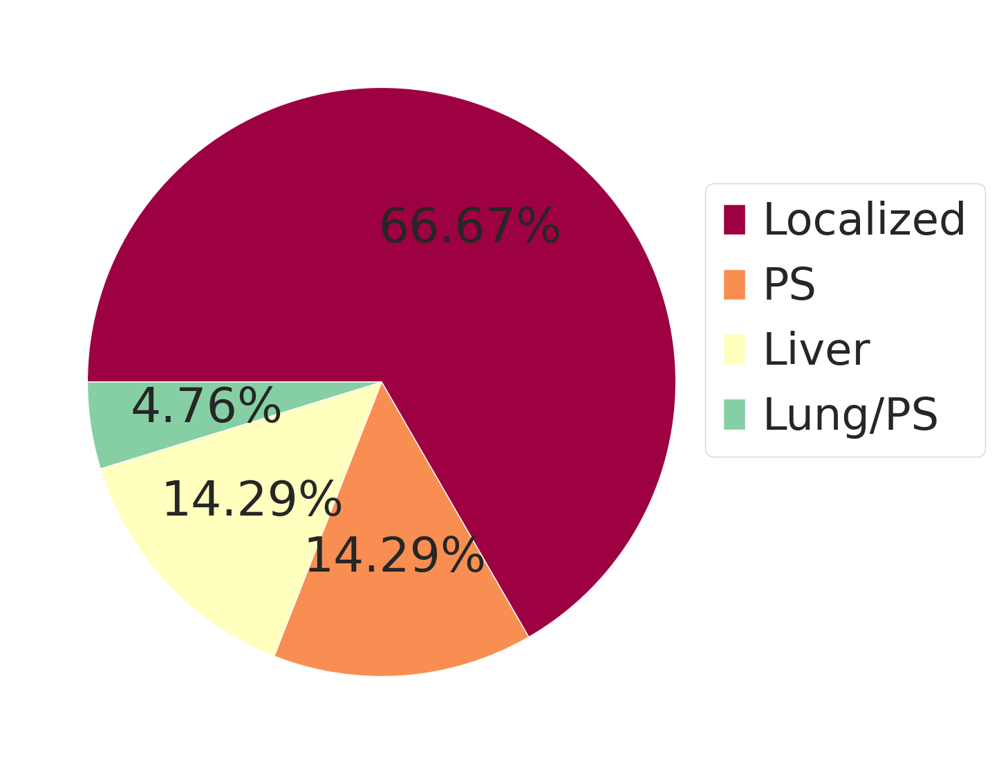

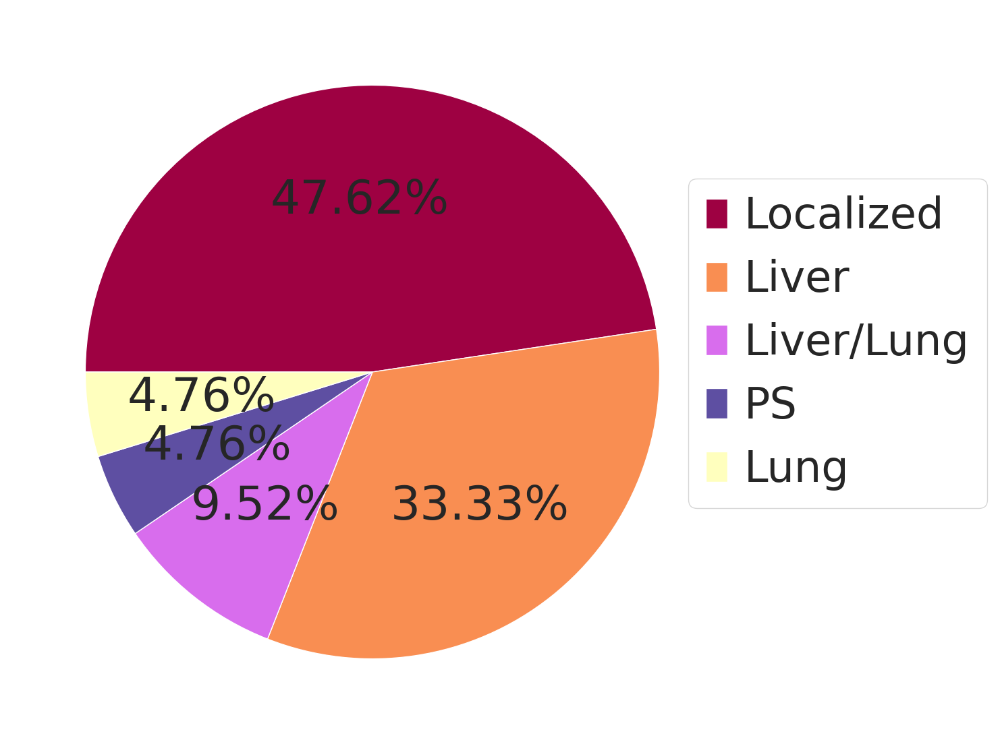

In [216]:
with_stage_sel
m = with_stage_sel['CTx_response_FFX'] == 'responder'
resp = with_stage_sel[m]


non_resp = with_stage_sel[~m]


resp = resp['Mets_Pattern'].value_counts().to_frame('Mets_Pattern')
non_resp = non_resp['Mets_Pattern'].value_counts().to_frame('Mets_Pattern')

resp_pct =  resp/resp['Mets_Pattern'].sum() *100
colors = ['#9e0142', '#f98e52', '#ffffbe', '#86cfa5', '#5e4fa2']
ratio = resp_pct.values.reshape(-1)
labels = list(resp.index)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.2f%%', startangle=180, counterclock=False, 
                                    colors=colors, labeldistance=None, rotatelabels=True)
plt.legend(bbox_to_anchor=(0.91, 0.8),ncol=1)
plt.show()

non_resp_pct =  non_resp/non_resp['Mets_Pattern'].sum() *100
colors = ['#9e0142','#f98e52','#d86ded','#5e4fa2','#ffffbe']
ratio = non_resp.values.reshape(-1)
labels = list(non_resp.index)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.2f%%', startangle=180, counterclock=False, 
                                    colors=colors, labeldistance=None, rotatelabels=True,)
plt.legend(bbox_to_anchor=(0.91, 0.8), ncol=1)
plt.show()

In [1271]:
# import pandas as pd
# import numpy as np
# import plotly.graph_objects as go
# import plotly.express as px
# import itertools

# df = pd.DataFrame(
#     itertools.product(
#         ["AF", "SY", "IQ", "SO", "ER"], ["DE", "AT", "BG", "SE", "UK", "CH"]
#     ),
#     columns=["source", "target"],
# ).pipe(lambda d: d.assign(value=np.random.uniform(1, 10000, 1000)[:len(d)]))

# nodes = np.unique(df[["source", "target"]], axis=None)
# nodes = pd.Series(index=nodes, data=range(len(nodes)))

# fig = go.Figure(
#     go.Sankey(
#         node={
#             "label": nodes.index,
#             "color": [
#                 px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)]
#                 for i in nodes
#             ],
#         },
#         link={
#             "source": nodes.loc[df["source"]],
#             "target": nodes.loc[df["target"]],
#             "value": df["value"],
           
#         },
#     )
# )

# fig

In [1671]:
# fig = make_subplots(1, 1, specs=[[{"type": "domain"}]],)

# fig.add_trace(go.Sunburst(
#     labels=df_all_trees['id'],
#     parents=df_all_trees['parent'],
#     values=df_all_trees['value'],
#     branchvalues='total',
#     marker=dict(
#         colors=df_all_trees['color'],
#         colorscale='RdBu',
#         cmid=average_score),
#     hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
#     name=''
#     ), 1, 1)

In [1672]:
# fig = make_subplots(1, 1, specs=[[{"type": "domain"}]],)

# fig.add_trace(go.Sunburst(
#     labels=df_all_trees['id'],
#     parents=df_all_trees['parent'],
#     values=df_all_trees['value'],
#     branchvalues='total',
#     marker=dict(
#         colors=df_all_trees['color'],
#         colorscale='RdBu',
#         cmid=average_score),
#     hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
#     name=''
#     ), 1, 1)

# fig.update_layout(margin=dict(t=10, b=10, r=10, l=10))
# fig.show()

In [1673]:
# fig = plt.figure(figsize=(25, 55), dpi= 150)
# widths = [1,25]
# heights = [1,1,1,0.01,6.5,45]
# gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.1, wspace=0.01, width_ratios=widths, height_ratios=heights)


# ax = fig.add_subplot(gs[5, 0])
# sns.heatmap(sigtype, cmap=list(sigtype_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=sigtype_lut[name]) for name in sigtype_lut]
# ax_legend = ax.legend(handles, sigtype_lut, bbox_to_anchor=(40.5, 0), frameon=False, 
#                               fontsize=25, markerscale=2, ncol=len(sigtype_lut))


# ax_legend.set_title('$\\bf{Signaure}$',prop={'size':20})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_yticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_ylabel('Signaures',fontdict={'fontsize':30,'weight':'bold'})
# ax.margins(0)


# ax = fig.add_subplot(gs[0, 1])
# sns.heatmap(CE, cmap=list(CE_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=CE_lut[name]) for name in CE_lut]
# ax_legend = ax.legend(handles, CE_lut, bbox_to_anchor=(1.465, 1.6), frameon=False, 
#                               fontsize=25, markerscale=2, ncol=5)
# ax_legend.set_title('$\\bf{Ecotyper}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_ylabel('Ecotyper',fontdict={'fontsize':25,'weight':'bold'})
# ax.margins(0)


# ax = fig.add_subplot(gs[1, 1])
# sns.heatmap(FFX, cmap=list(FFX_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=FFX_lut[name]) for name in FFX_lut]
# ax_legend = ax.legend(handles, FFX_lut, bbox_to_anchor=(1.5, 1.3), frameon=False, 
#                               fontsize=30, markerscale=2, ncol=4)
# ax_legend.set_title('$\\bf{FFX}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_ylabel('FFX',fontdict={'fontsize':25,'weight':'bold'})
# ax.margins(0)


# final_int_map = dict(zip(head['FinalType'].unique(),range(head['FinalType'].nunique())))
# final = head['FinalType'].map(final_int_map).to_frame('FinalType').T.astype(float)
# ax = fig.add_subplot(gs[2, 1])
# sns.heatmap(final, cmap=list(final_lut.values()), cbar=False, ax=ax)
# handles = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
# ax_legend = ax.legend(handles, final_lut, bbox_to_anchor=(1.516, 1.6),
#                               fontsize=30, markerscale=2, frameon=False, ncol=4)
# ax_legend.set_title('$\\bf{Subtype}$',prop={'size':25})
# ax_legend._legend_box.align = "left"
# ax.set_xticks([])
# ax.set_xlabel('')
# ax.set_yticklabels('')
# ax.set_ylabel('Subtype',fontdict={'fontsize':25,'weight':'bold'})
# ax.margins(0)


# plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = True
# plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = False

# # ax = fig.add_subplot(gs[4, 0])
# # sns.heatmap(epic, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# # #ax.set_yticks([])
# # # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# # ax.set_xticks([])
# # #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# # ax.set_ylabel('')
# # ax.tick_params(axis='y', labelsize=15)
# # ax.set_title('Deconvolution-EPIC',fontdict={'fontsize':20})



# # ax = fig.add_subplot(gs[5, 0])
# # sns.heatmap(quantiseq, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# # #ax.set_yticks([])
# # # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# # ax.set_xticks([])
# # #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# # ax.set_ylabel('')
# # ax.tick_params(axis='y', labelsize=15)
# # ax.set_title('Deconvolution-quanTIseq',fontdict={'fontsize':20})


# # cbar_ax = fig.add_axes([0.1, 0.5, 0.02, 0.05], frameon=False, xticklabels=[], yticklabels=[])
# # cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
# ax = fig.add_subplot(gs[4, 1])
# sns.heatmap(mcp_counter, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# #ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# ax.tick_params(axis='y', labelsize=25)
# ax.set_title('Deconvolution-MCPcounter',fontdict={'fontsize':30,'weight':'bold'})


# cbar_ax = fig.add_axes([1.2, 0.78, 0.02, 0.04], frameon=False, xticklabels=[], yticklabels=[])
# cbar_ax.tick_params(axis=u'both', which=u'both',length=0)
# ax = fig.add_subplot(gs[5, 1])
# sns.heatmap(ssGSEA, cmap='bwr', vmin=-2, vmax=2, ax=ax, cbar_kws = dict(use_gridspec=True), cbar_ax=cbar_ax)
# #ax.set_yticks([])
# # cbar_legend = cbar_ax.legend(bbox_to_anchor=(4, 0), frameon=False, fontsize=18)
# # cbar_legend.set_title('$\\bf{Gene  Expression}$',prop={'size':18})
# ax.set_xticks([])
# #ax.set_xlabel('Patients', fontsize=20, fontdict=dict(weight='bold'))
# ax.set_ylabel('')
# ax.tick_params(axis='y', labelsize=25)
# ax.set_title('ssGSEA',fontdict={'fontsize':30,'weight':'bold'})
# #ax.yaxis.tick_right()
# # ax.yaxis.set_label_position("right")
# # ax.set_yticks(rotation=90)
# plt.show()

# plt.rcParams['ytick.right'] = plt.rcParams['ytick.labelright'] = False
# plt.rcParams['ytick.left'] = plt.rcParams['ytick.labelleft'] = True

In [1949]:
tmp = TCGA_adata_HVG.obs.loc[:,['TREATMENT_OUTCOME_FIRST_COURSE']]
drug_res = dict()
drug_res['Complete Remission/Response']='Responder'
drug_res['Partial Remission/Response']='Responder'
drug_res['Progressive Disease']='Non-Responder'
drug_res['Stable Disease']='Non-Responder'
drug_res['[Discrepancy]']='NA'
drug_res['[Not Applicable]']='NA'
drug_res['[Not Available]']='NA'

tmp['TREATMENT_OUTCOME_FIRST_COURSE'] = tmp['TREATMENT_OUTCOME_FIRST_COURSE'].map(drug_res)
TCGA_mg = pd.concat([tmp, TCGA_annot], axis=1)
m = TCGA_mg['TREATMENT_OUTCOME_FIRST_COURSE'] != 'NA'
TCGA_mg = TCGA_mg[m]

ct_table_ind=pd.crosstab(TCGA_mg['TREATMENT_OUTCOME_FIRST_COURSE'],TCGA_mg['FinalType'])
print(ct_table_ind)

ct_table_ind=pd.crosstab(TCGA_mg['TREATMENT_OUTCOME_FIRST_COURSE'],TCGA_mg['Tumor2Type_2nd'])
print(ct_table_ind)

ct_table_ind=pd.crosstab(TCGA_mg['TREATMENT_OUTCOME_FIRST_COURSE'],TCGA_mg['TME2Type_2nd'])
print(ct_table_ind)

# chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
# p_val="{:.2e}".format(p)

FinalType                       S0-S0  S0-S1  S1-S0  S1-S1
TREATMENT_OUTCOME_FIRST_COURSE                            
Non-Responder                      27      8     11      2
Responder                          28     10      9      2
Tumor2Type_2nd                  S0  S1
TREATMENT_OUTCOME_FIRST_COURSE        
Non-Responder                   35  13
Responder                       38  11
TME2Type_2nd                    S0  S1
TREATMENT_OUTCOME_FIRST_COURSE        
Non-Responder                   38  10
Responder                       37  12


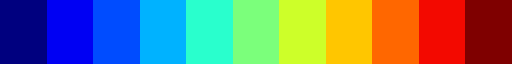

In [662]:
# plt.cm.get_cmap('jet',lut=11)

In [1675]:
other

,MoffittType,BaileyType,SNU_3subtype,MichelleType,SNU_4subtype,TME_2,TME_3,TME_4,TSub_2,TSub_3,...,TME_3_v1,TME_2_v1,TME_2_v2,TME_3_v2,TME_2_v3,CE,XCELL_2type,MyPaper_TME2,Bailey2type,Bailey2type2
Snubh_TB,,,,,,,,,,,,,,,,,,,,,
20-T00330_FO-01,BasalLike,Squamous,Subtype_1,BasalLike-B,Subtype_1,Subtype_1,Subtype_1,Subtype_2,Subtype_0,Subtype_0,...,Subtype_2,Subtype_0,Subtype_0,Subtype_2,Subtype_0,CE2,Subtype_1,Subtype_0,Squamous,Immunogenic
19-T00062_FO-01,BasalLike,ADEX,Subtype_1,BasalLike-A,Subtype_1,Subtype_1,Subtype_1,Subtype_2,Subtype_0,Subtype_1,...,Subtype_1,Subtype_0,Subtype_0,Subtype_1,Subtype_0,CE1,Subtype_1,Subtype_0,Squamous,ADEX
20-T00814_FT-01,BasalLike,Pancreatic Progenitor,Subtype_0,Classical-B,Subtype_0_1,Subtype_0,Subtype_0,Subtype_0,Subtype_0,Subtype_0,...,Subtype_2,Subtype_0,Subtype_0,Subtype_2,Subtype_0,CE5,Subtype_1,Subtype_0,Pancreatic Progenitor,ADEX
19-T00201_FO-01,BasalLike,Squamous,Subtype_0,Hybrid,Subtype_0_1,Subtype_0,Subtype_0,Subtype_0,Subtype_0,Subtype_0,...,Subtype_1,Subtype_0,Subtype_0,Subtype_1,Subtype_1,CE2,Subtype_0,Subtype_0,Squamous,Immunogenic
19-T00505_FO-01,Classical,Pancreatic Progenitor,Subtype_0,Hybrid,Subtype_0_0,Subtype_0,Subtype_0,Subtype_0,Subtype_0,Subtype_0,...,Subtype_2,Subtype_0,Subtype_0,Subtype_2,Subtype_0,CE8,Subtype_0,Subtype_0,Pancreatic Progenitor,ADEX
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-T00576_FT-01,Classical,Immunogenic,Subtype_0,Classical-B,Subtype_0_0,Subtype_1,Subtype_1,Subtype_2,Subtype_0,Subtype_0,...,Subtype_2,Subtype_0,Subtype_0,Subtype_2,Subtype_0,CE10,Subtype_1,Subtype_0,Squamous,Immunogenic
19-T00620_FO-01,BasalLike,Immunogenic,Subtype_0,Classical-A,Subtype_0_1,Subtype_0,Subtype_0,Subtype_0,Subtype_0,Subtype_0,...,Subtype_0,Subtype_1,Subtype_1,Subtype_0,Subtype_0,CE8,Subtype_1,Subtype_1,Squamous,Immunogenic
19-T00413_FO-01,Classical,Pancreatic Progenitor,Subtype_0,Classical-B,Subtype_0_0,Subtype_0,Subtype_0,Subtype_1,Subtype_0,Subtype_0,...,Subtype_1,Subtype_0,Subtype_0,Subtype_1,Subtype_1,CE7,Subtype_0,Subtype_0,Pancreatic Progenitor,Immunogenic


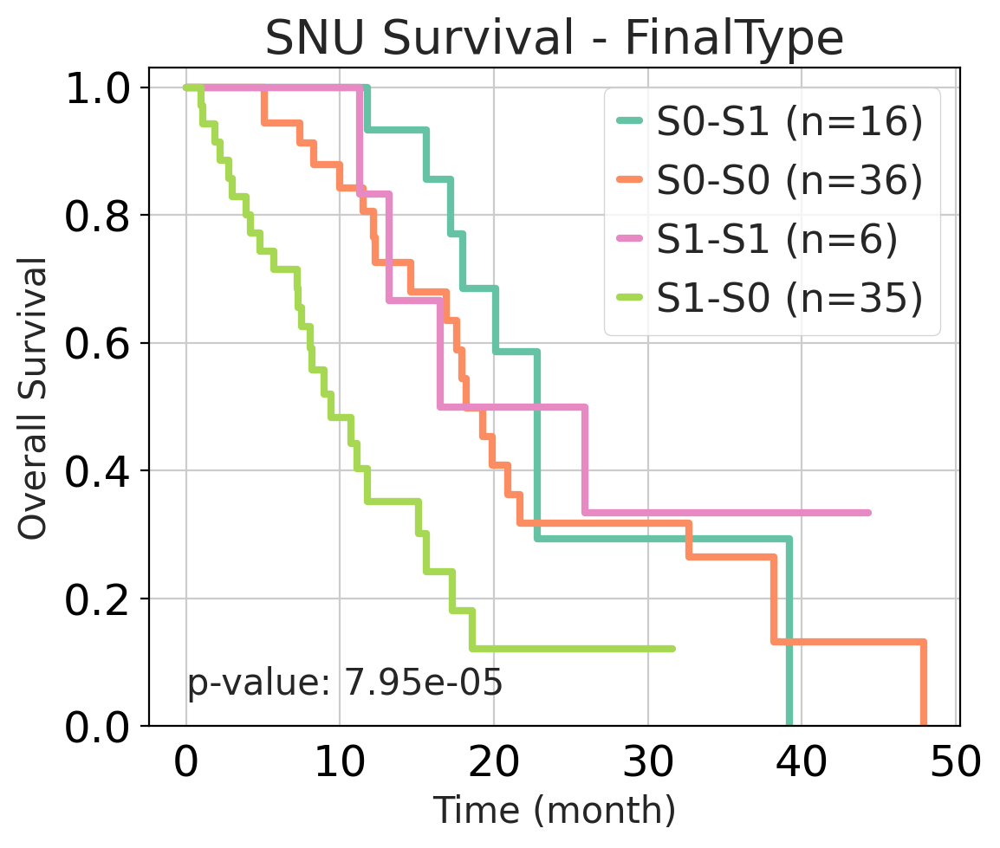

'7.95e-05'

In [1950]:


#dd = {'Calssical-A':'Classical-A','Calssical-B':'Classical-B','Hybrid':'Hybrid','Basallike-A':'Basallike-A','Basallike-B':'Basallike-B'}
other = pd.read_csv('ALL_TYPE2.csv',index_col=0)
other['Bailey_Mixed'] = other['Bailey2type']+'-'+other['Bailey2type2']
#other['MichelleType'] = other['MichelleType'].map(dd)
#other.to_csv('ALL_TYPE2.csv')

tmp1 = other.loc[:,['MoffittType','BaileyType','Bailey2type','Bailey2type2','Bailey_Mixed', 'MichelleType']]
SNU_df = pd.concat([SNU_adata.obs, SNU_annot, tmp1], axis=1)
sc.settings.set_figure_params(dpi=100, figsize=(6,5), fontsize=18)
km_plot(df_info=SNU_df, category='FinalType', os='OS_F', event='OS_event', title='SNU Survival - FinalType', order=['S0-S1','S0-S0','S1-S1','S1-S0'])

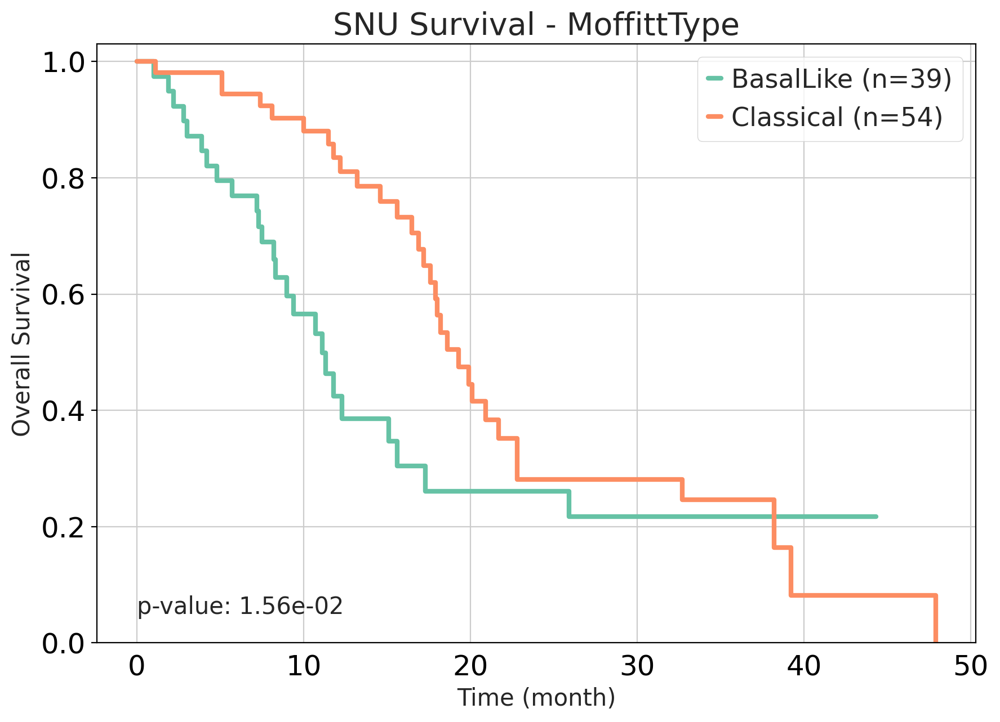

'1.56e-02'

In [1951]:
['MoffittType','BaileyType','MichelleType']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
km_plot(df_info=SNU_df, category='MoffittType', os='OS_F', event='OS_event', title='SNU Survival - MoffittType')

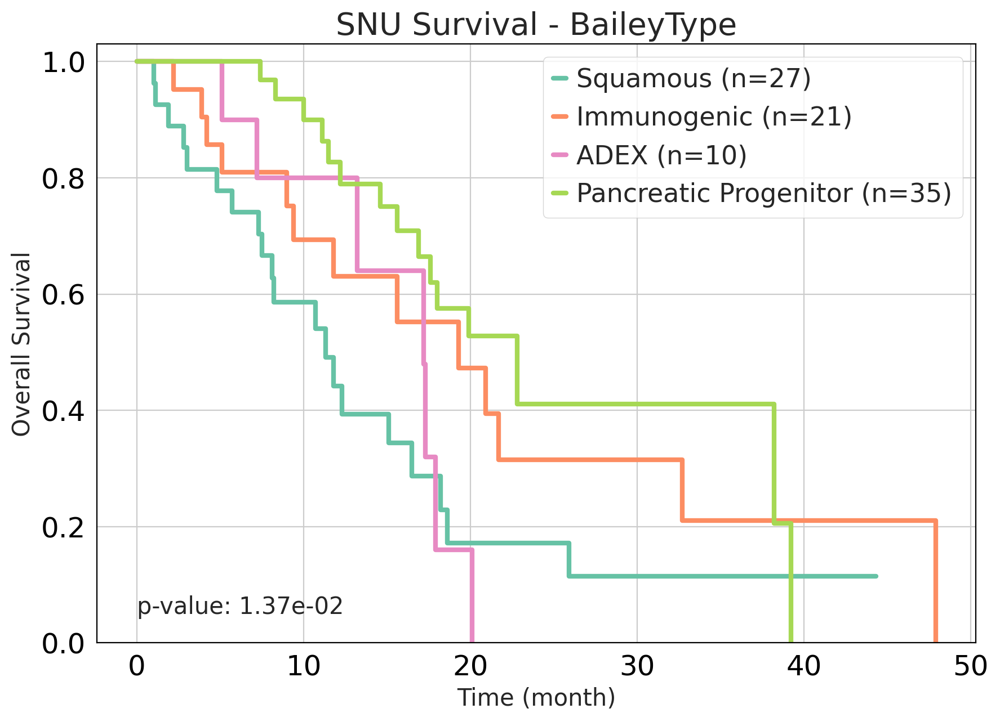

'1.37e-02'

In [1812]:
['MoffittType','BaileyType','MichelleType']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
km_plot(df_info=SNU_df, category='BaileyType', os='OS_F', event='OS_event', title='SNU Survival - BaileyType')

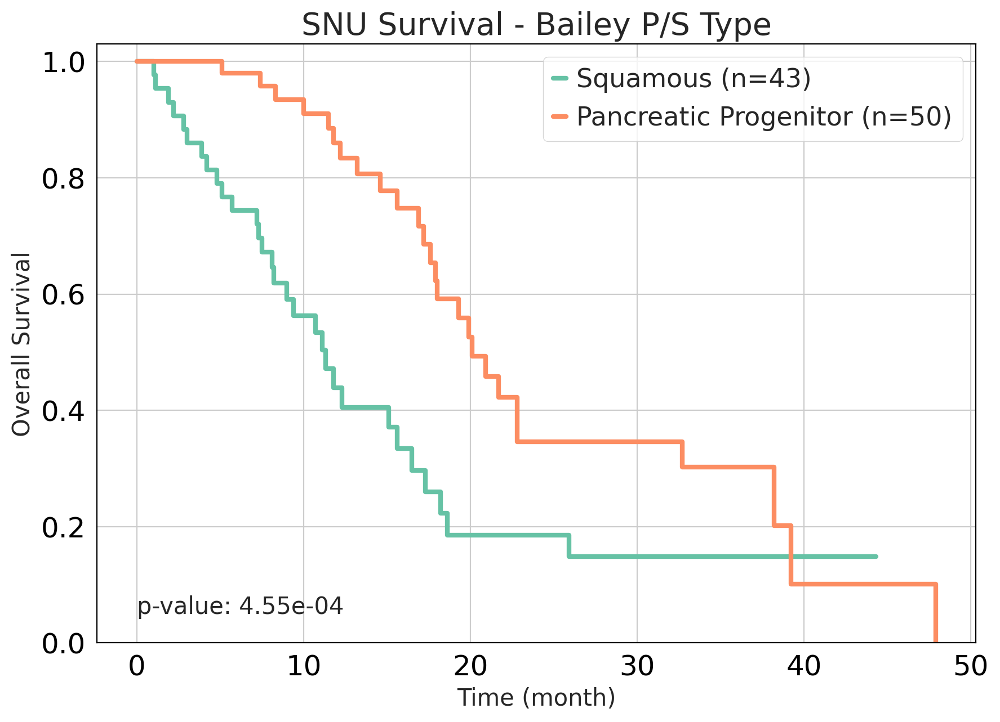

'4.55e-04'

In [1813]:
['MoffittType','BaileyType','MichelleType']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
km_plot(df_info=SNU_df, category='Bailey2type', os='OS_F', event='OS_event', title='SNU Survival - Bailey P/S Type')

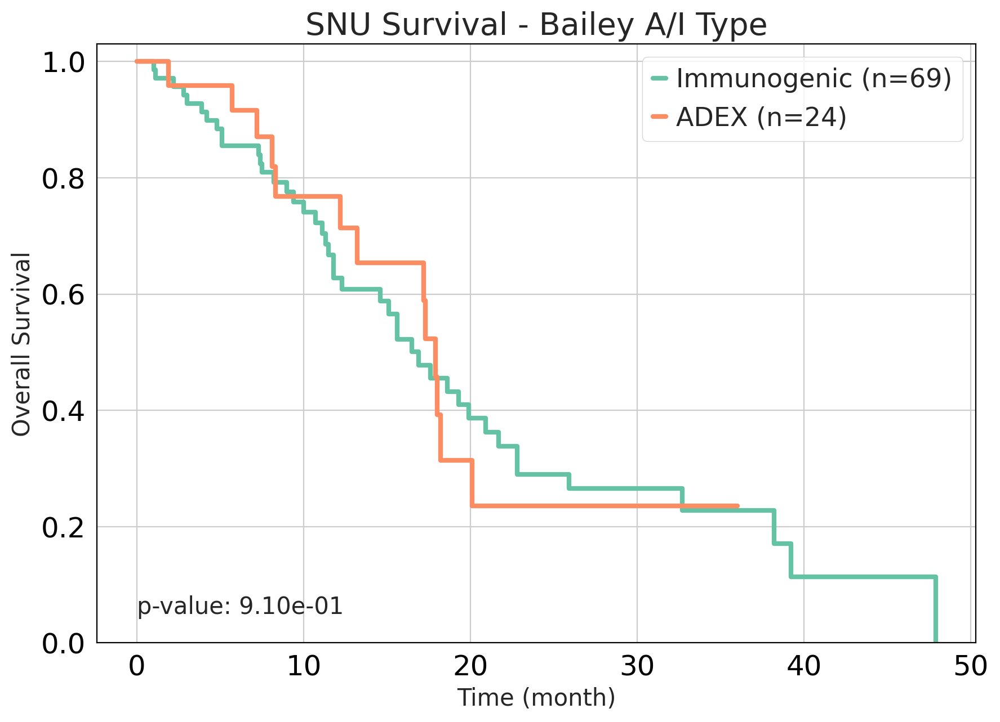

'9.10e-01'

In [1814]:
['MoffittType','BaileyType','MichelleType']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
km_plot(df_info=SNU_df, category='Bailey2type2', os='OS_F', event='OS_event', title='SNU Survival - Bailey A/I Type')

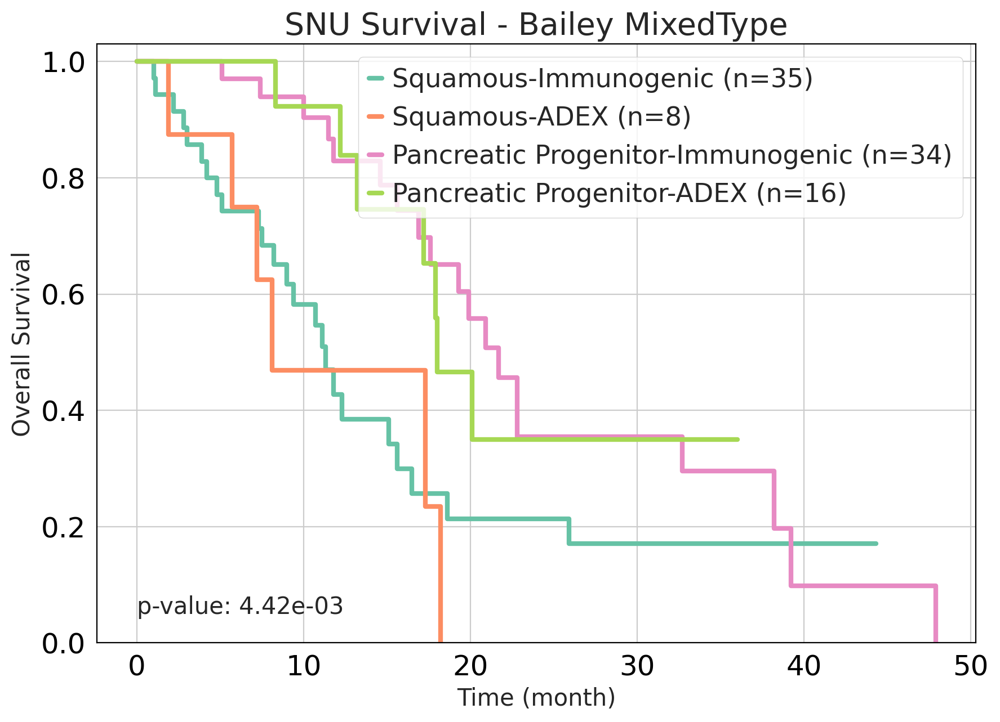

'4.42e-03'

In [1817]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['Squamous-Immunogenic','Squamous-ADEX','Pancreatic Progenitor-Immunogenic','Pancreatic Progenitor-ADEX']
km_plot(df_info=SNU_df, category='Bailey_Mixed', os='OS_F', event='OS_event', title='SNU Survival - Bailey MixedType',order=order)

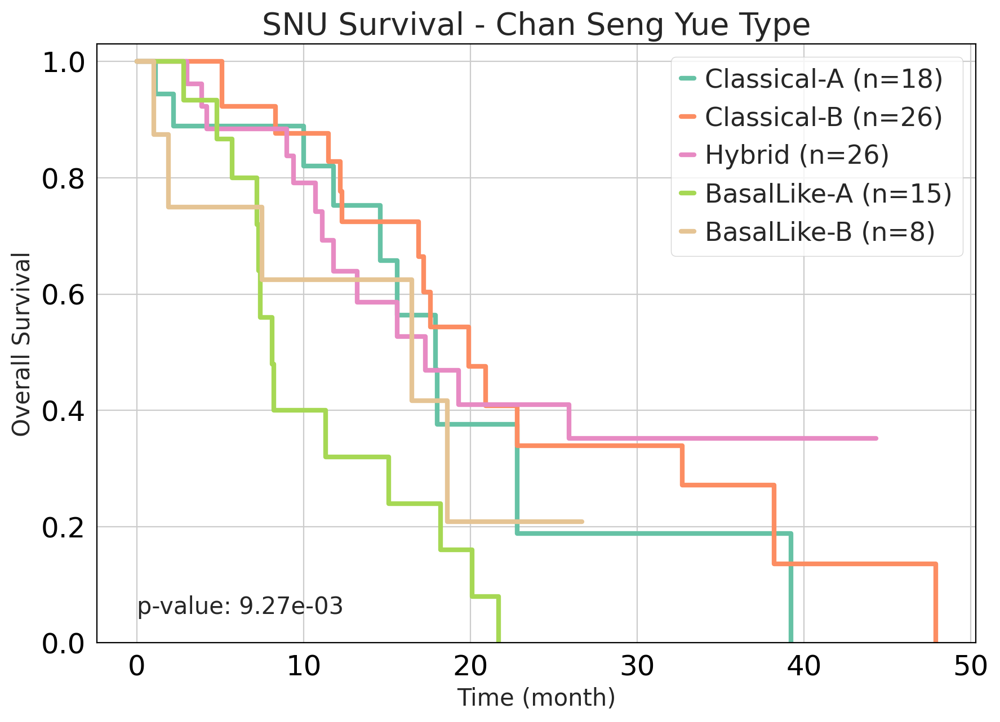

'9.27e-03'

In [1816]:
['MoffittType','BaileyType','MichelleType']
order = ['Classical-A','Classical-B','Hybrid','BasalLike-A','BasalLike-B']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
km_plot(df_info=SNU_df, category='MichelleType', os='OS_F', event='OS_event', title='SNU Survival - Chan Seng Yue Type', order=order)

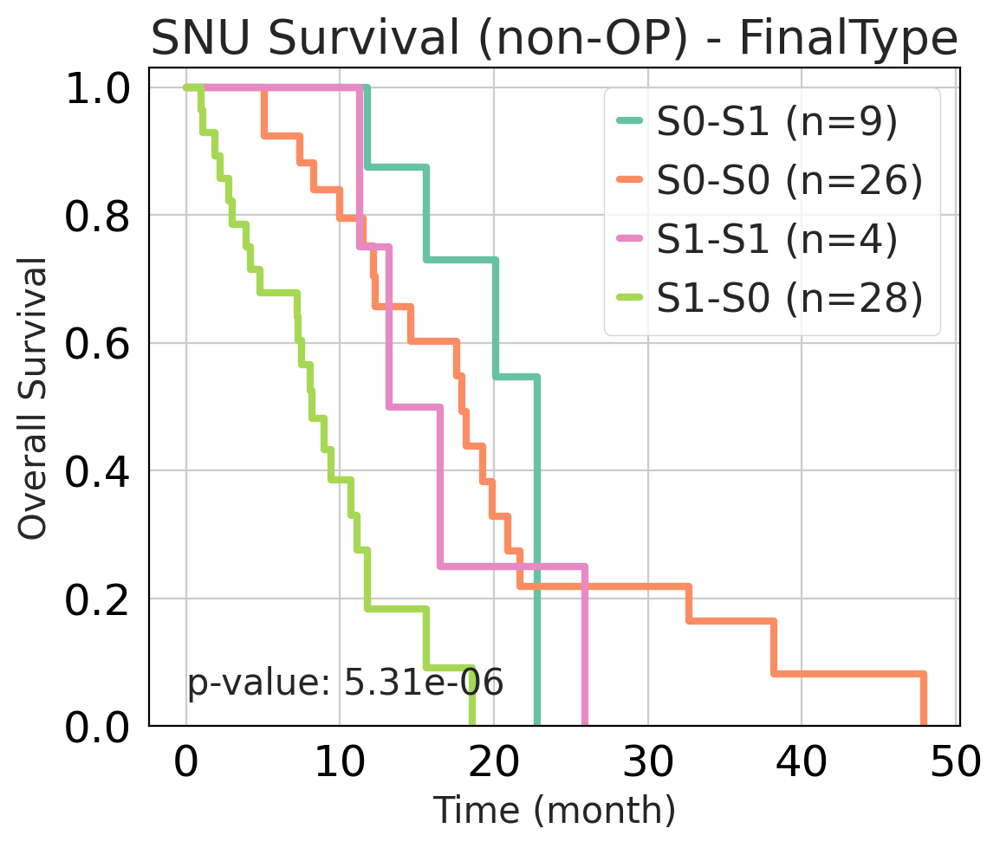

'5.31e-06'

In [1841]:
m = SNU_df['clinical_setting'] == 'OP'
SNU_df_OP = SNU_df[m]
SNU_df_non_OP = SNU_df[~m]
sc.settings.set_figure_params(dpi=100, figsize=(6,5), fontsize=18)
km_plot(df_info=SNU_df_non_OP, category='FinalType', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - FinalType', order=['S0-S1','S0-S0','S1-S1','S1-S0'])

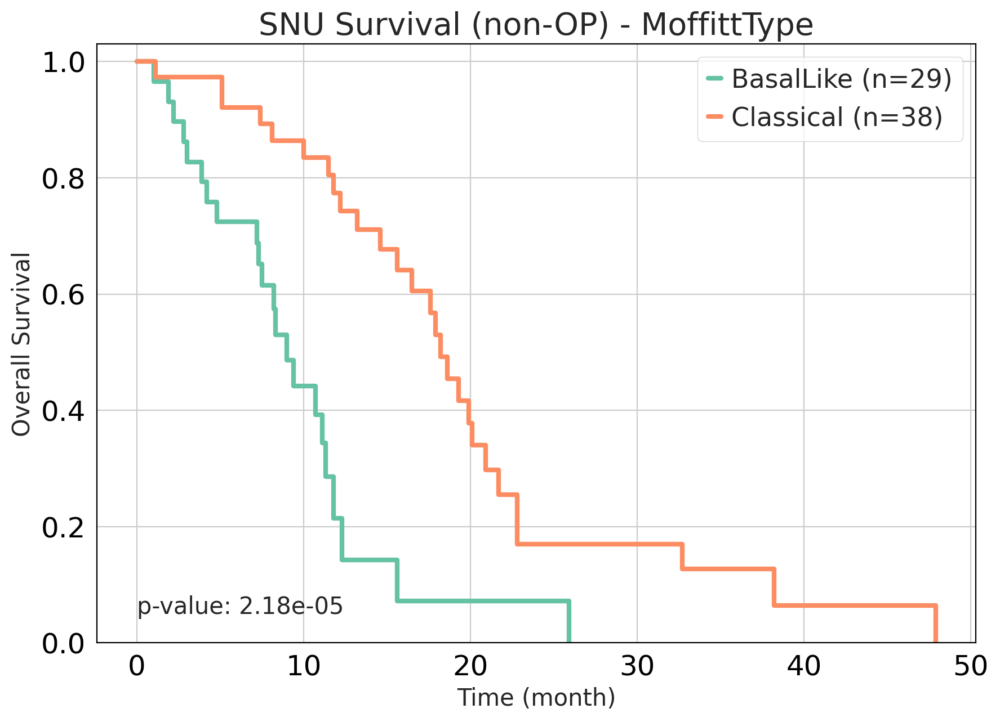

'2.18e-05'

In [1842]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_non_OP, category='MoffittType', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - MoffittType')

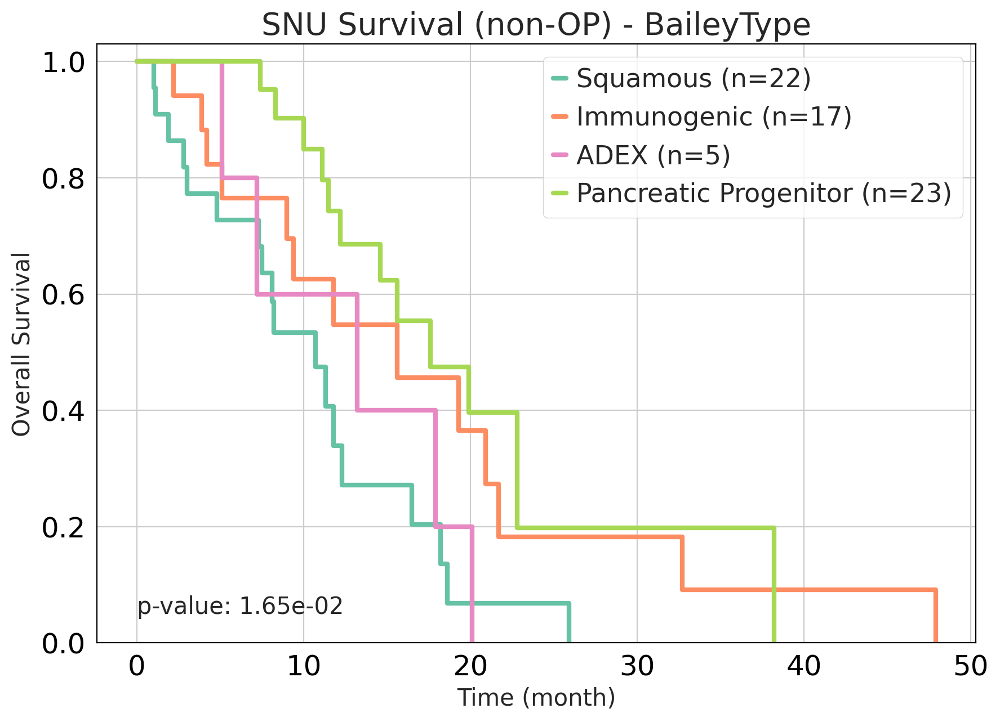

'1.65e-02'

In [1819]:
order = ['Squamous','Immunogenic','ADEX','Pancreatic Progenitor']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_non_OP, category='BaileyType', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - BaileyType',order=order)

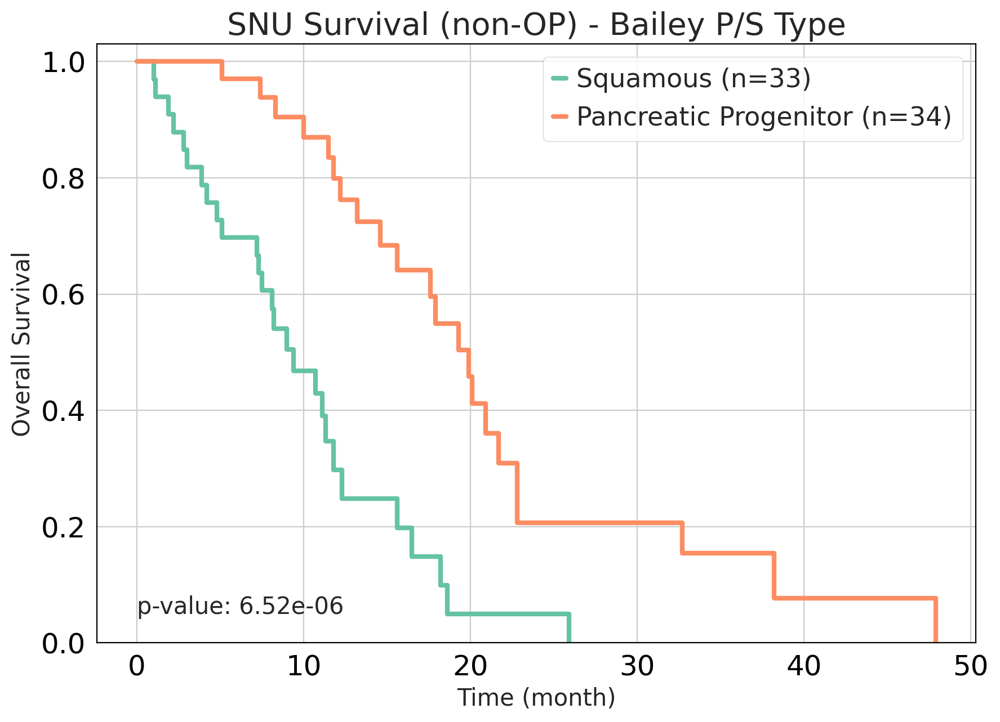

'6.52e-06'

In [1820]:
order = ['Squamous','Pancreatic Progenitor']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_non_OP, category='Bailey2type', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - Bailey P/S Type',order=order)

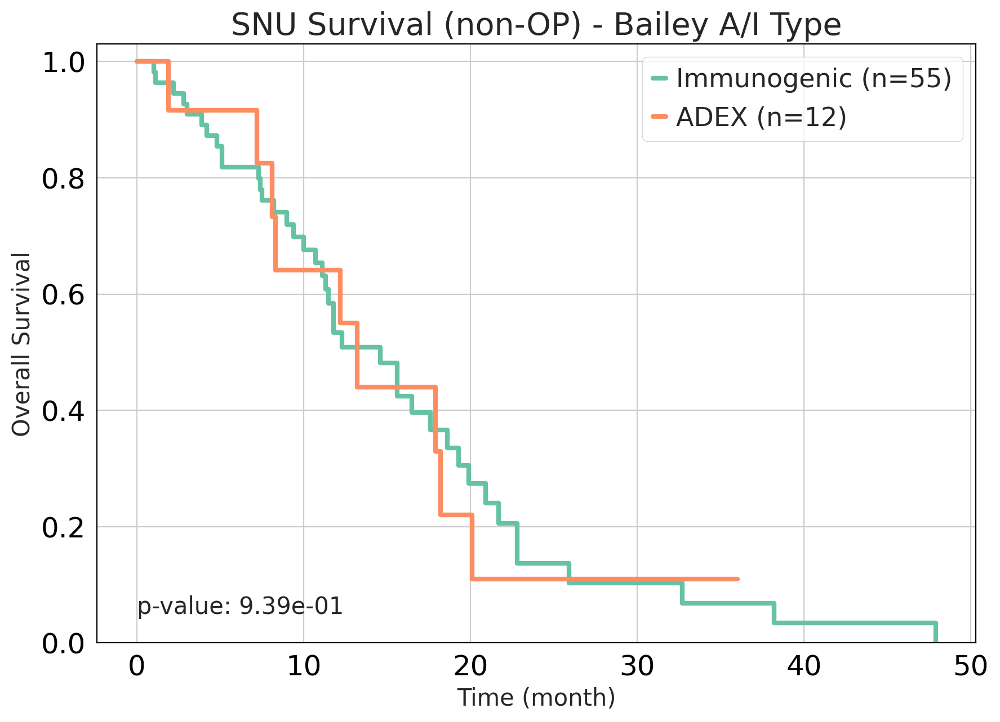

'9.39e-01'

In [1821]:
order = ['Immunogenic','ADEX']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_non_OP, category='Bailey2type2', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - Bailey A/I Type',order=order)

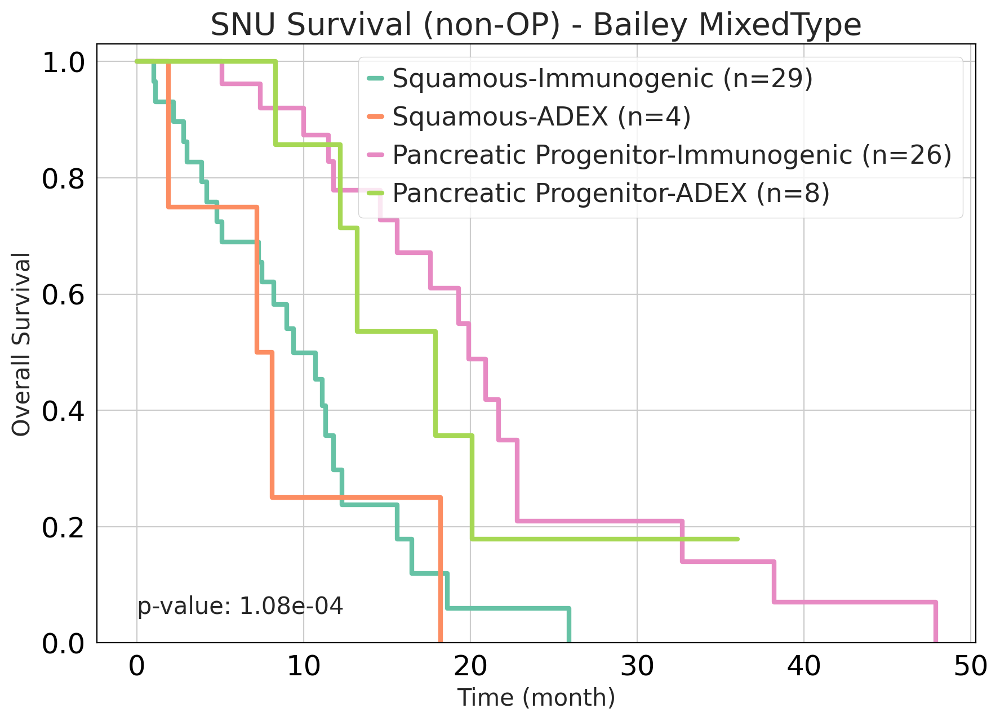

'1.08e-04'

In [1843]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['Squamous-Immunogenic','Squamous-ADEX','Pancreatic Progenitor-Immunogenic','Pancreatic Progenitor-ADEX']
km_plot(df_info=SNU_df_non_OP, category='Bailey_Mixed', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - Bailey MixedType',order=order)

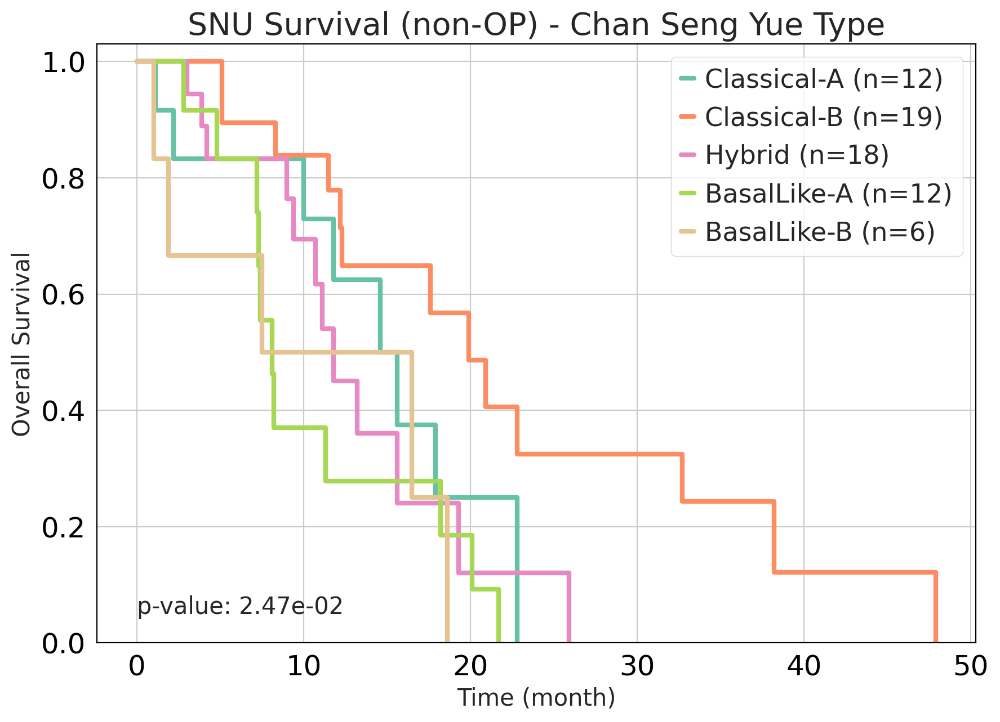

'2.47e-02'

In [1822]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
order = ['Classical-A','Classical-B','Hybrid','BasalLike-A','BasalLike-B']
km_plot(df_info=SNU_df_non_OP, category='MichelleType', os='OS_F', event='OS_event', title='SNU Survival (non-OP) - Chan Seng Yue Type', order=order)

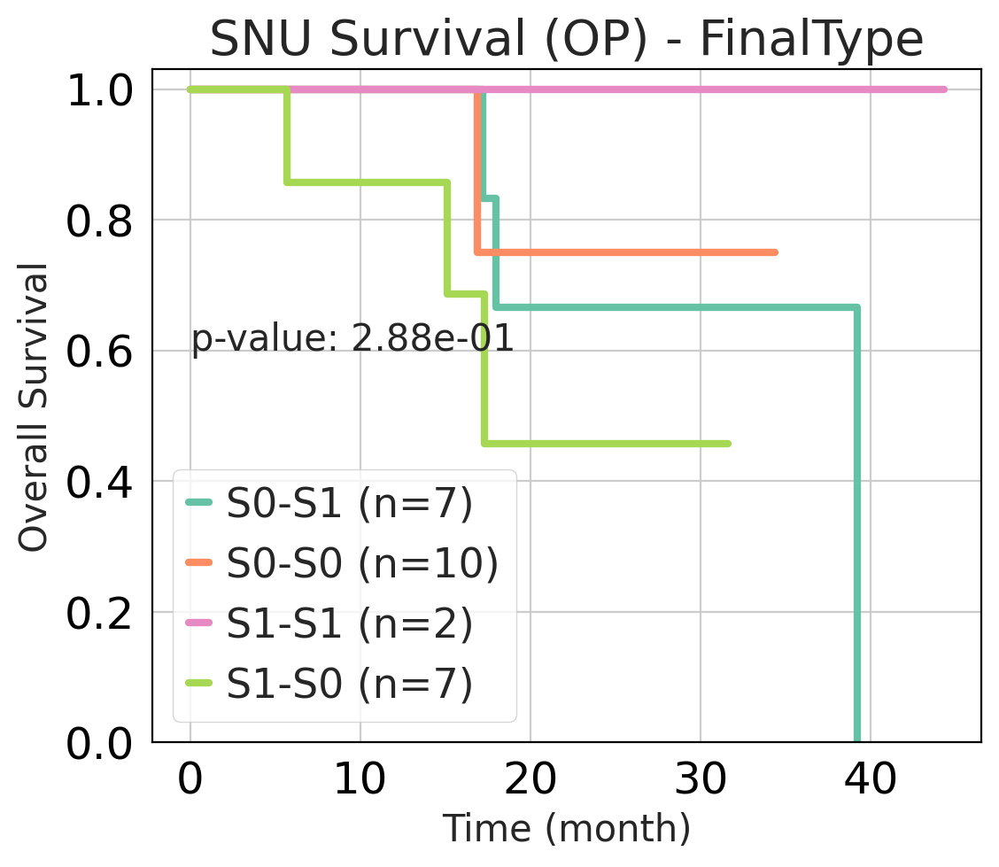

'2.88e-01'

In [1838]:

sc.settings.set_figure_params(dpi=100, figsize=(6,5), fontsize=18)
km_plot(df_info=SNU_df_OP, category='FinalType', os='OS_F', event='OS_event', title='SNU Survival (OP) - FinalType', order=['S0-S1','S0-S0','S1-S1','S1-S0'])

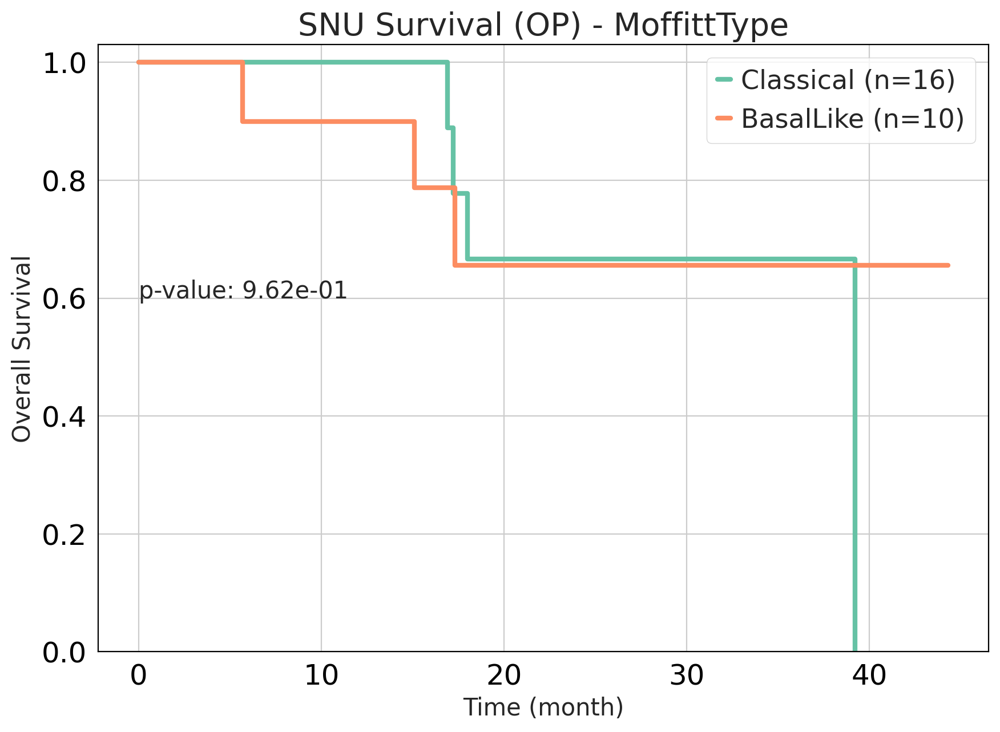

'9.62e-01'

In [1837]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_OP, category='MoffittType', os='OS_F', event='OS_event', title='SNU Survival (OP) - MoffittType')

In [1824]:
def km_plot(df_info, category, os, event, title='', order=None):
    i=0
    kmf = lifelines.KaplanMeierFitter()
    #plt.figure(figsize=(8,4))
    #ax = plt.gca()
    m = ~df_info[category].isna()
    df_info = df_info[m]
    category_vals = list(df_info[category].unique())
    
    if len(category_vals) > 6:
        colormap=mcp.gen_color(cmap="Set2",n=len(category_vals))
    else:
        colormap=mcp.gen_color(cmap="Set2",n=6)
    
    
    median_os = df_info[os].median()
    group_os = dict()
    for val in category_vals:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        time = kmf.predict(median_os)
        group_os[val]=time

    m_survival = pd.DataFrame.from_dict(group_os, orient='index', columns=['m_survival']).sort_values(by='m_survival', ascending=True)
    sorted_category = list(m_survival.index)
    
    if order:
        sorted_category = order
    
    for val in sorted_category:
        m = df_info[category] == val
        count = sum(m)
        label = "{} (n={})".format(val,count)
        T_exp, E_exp = df_info.loc[m,os], df_info.loc[m,event]
        kmf.fit(T_exp, E_exp, label=label)
        kmf.plot_survival_function(ci_show=False, linewidth=3, show_censors=False, color=colormap[i])
        i+=1
        

    result = multivariate_logrank_test(df_info[os], df_info[category], df_info[event])
    p_val="{:.2e}".format(result.p_value)
    plt.text(0, 0.6, 'p-value: {}'.format(p_val), fontsize=15)
    if title=='':
        title = 'KM Plot - {}'.format(category)
    plt.title(title, fontsize=20)
    plt.xlabel('Time (month)',fontsize=15)
    plt.ylabel('Overall Survival',fontsize=15)
    plt.ylim((0,1.03))
    plt.show()
    return p_val

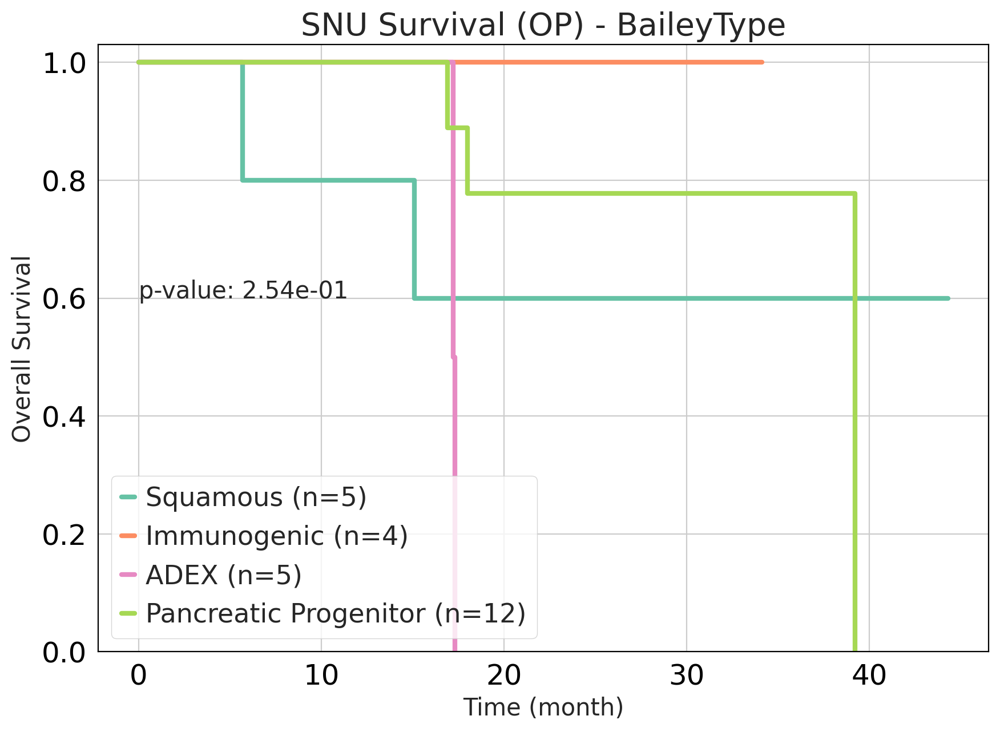

'2.54e-01'

In [1832]:
order = ['Squamous','Immunogenic','ADEX','Pancreatic Progenitor']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_OP, category='BaileyType', os='OS_F', event='OS_event', title='SNU Survival (OP) - BaileyType',order=order)

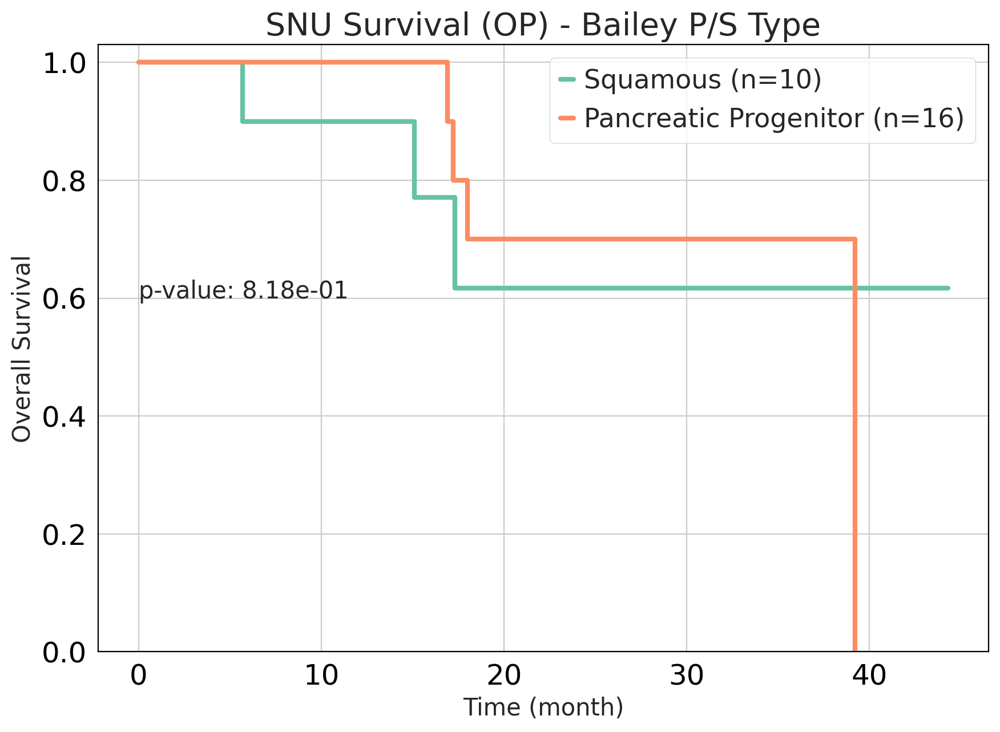

'8.18e-01'

In [1833]:
order = ['Squamous','Pancreatic Progenitor']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_OP, category='Bailey2type', os='OS_F', event='OS_event', title='SNU Survival (OP) - Bailey P/S Type',order=order)

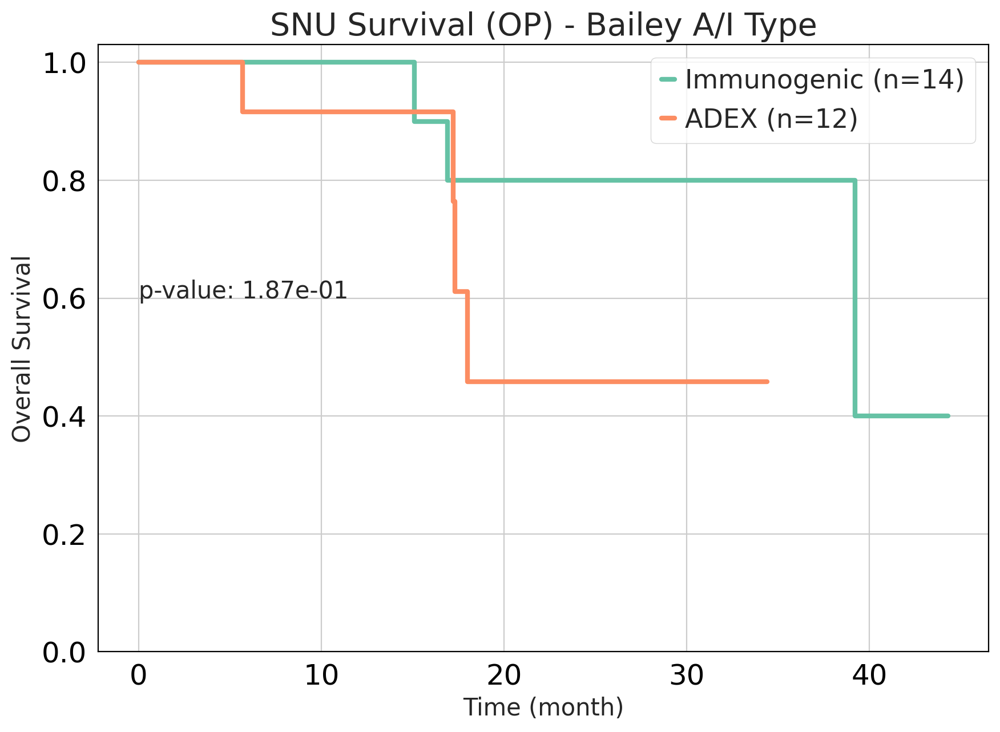

'1.87e-01'

In [1834]:
order = ['Immunogenic','ADEX']
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
km_plot(df_info=SNU_df_OP, category='Bailey2type2', os='OS_F', event='OS_event', title='SNU Survival (OP) - Bailey A/I Type',order=order)

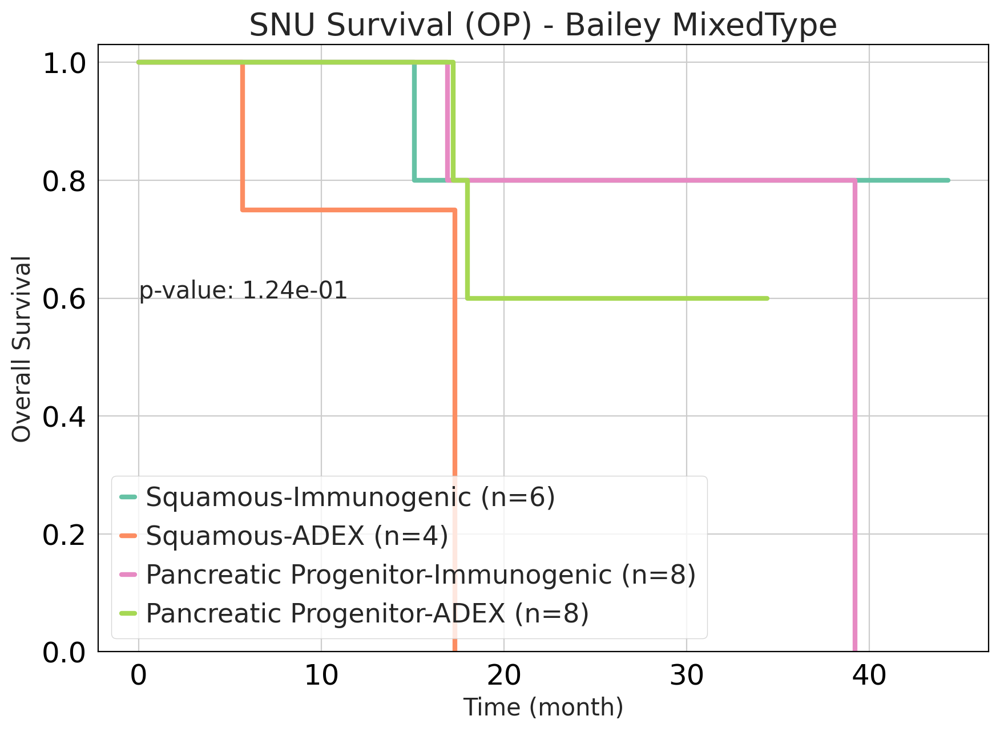

'1.24e-01'

In [1835]:

sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
order = ['Squamous-Immunogenic','Squamous-ADEX','Pancreatic Progenitor-Immunogenic','Pancreatic Progenitor-ADEX']
km_plot(df_info=SNU_df_OP, category='Bailey_Mixed', os='OS_F', event='OS_event', title='SNU Survival (OP) - Bailey MixedType',order=order)

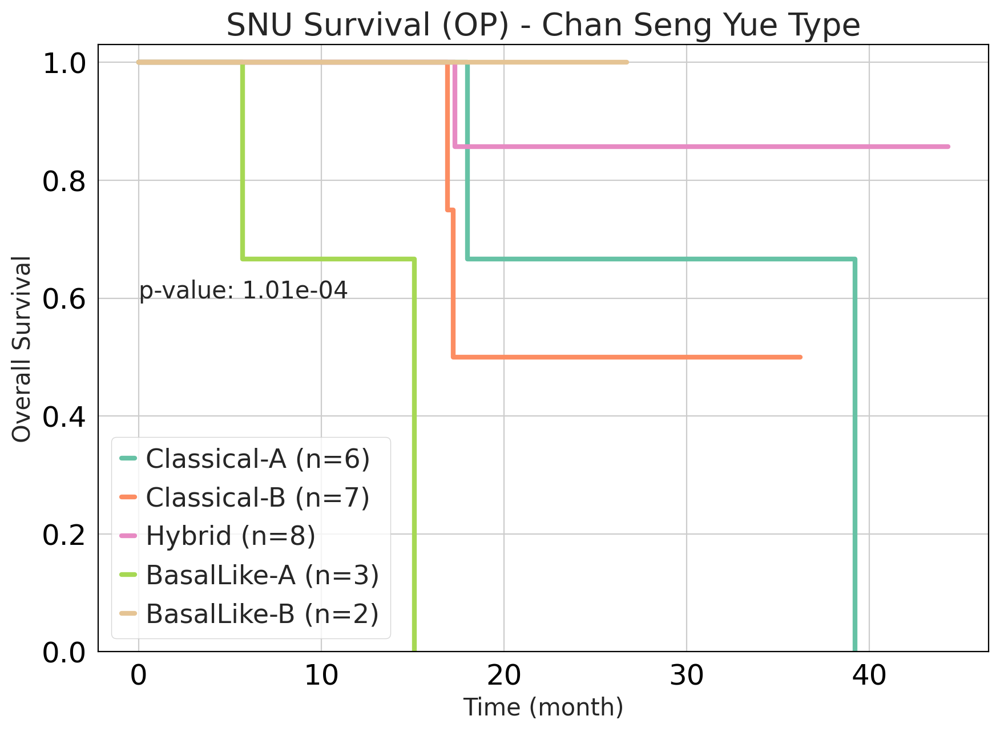

'1.01e-04'

In [1836]:
sc.settings.set_figure_params(dpi=100, figsize=(10,7), fontsize=18)
['MoffittType','BaileyType','MichelleType']
order = ['Classical-A','Classical-B','Hybrid','BasalLike-A','BasalLike-B']
#order = ['Classical-A','Classical-B','Hybrid','Basallike-A']
km_plot(df_info=SNU_df_OP, category='MichelleType', os='OS_F', event='OS_event', title='SNU Survival (OP) - Chan Seng Yue Type', order=order)

In [200]:
SNU_adata_HVG.obs.columns

Index(['N0', 'PID', 'dateA', 'Snubh_BB', 'pathology_number',
       'tumorcellularity(pathology)', 'DNA_RNA', 'methylSeq', 'metagenomic',
       'liquid_number', 'liguid_timing', 'KRAS_mutation_WES', 'KRAS_VAF',
       'KRAS_mutation_WTS', 'KRAS_final', 'cfDNA', 'liquid_KRAS', 'R_ul',
       'R_DNA', 'cellularity', 'MSI', 'pathology', 'dateA.1', 'stageA', 'CTx',
       'neo_response', 'Op_date', 'R', 'LN', 'CAP_score', 'TNM', 'recur',
       'recur_date', 'Liver_recur', 'Lung_recur', 'PS_recur', 'other_recur',
       'multiple_recur', 'RFS', 'postrecur_CTx', 'chemo', 'CTxBOR',
       'RTx_effect', 'PD', 'PD_date', 'Localizd_tumor', 'Liver_PD', 'Lung_PD',
       'PS_PD', 'other_PD', 'multiple_PD', 'PFS', 'Unnamed:53', 'Unnamed:54',
       'metsA1', 'metsA2', 'metsA3', 'LN.1', 'metsA4', 'metsA5', 'EOPC',
       'stage', 'stage_A', 'Mets_liver', 'Mets_lung', 'Mets_PS',
       'primary_tumor_location', 'cellularity_path', 'stage_B', 'stage_C',
       'Mets_liver_C', 'Mets_lung_C', 'Mets_PS

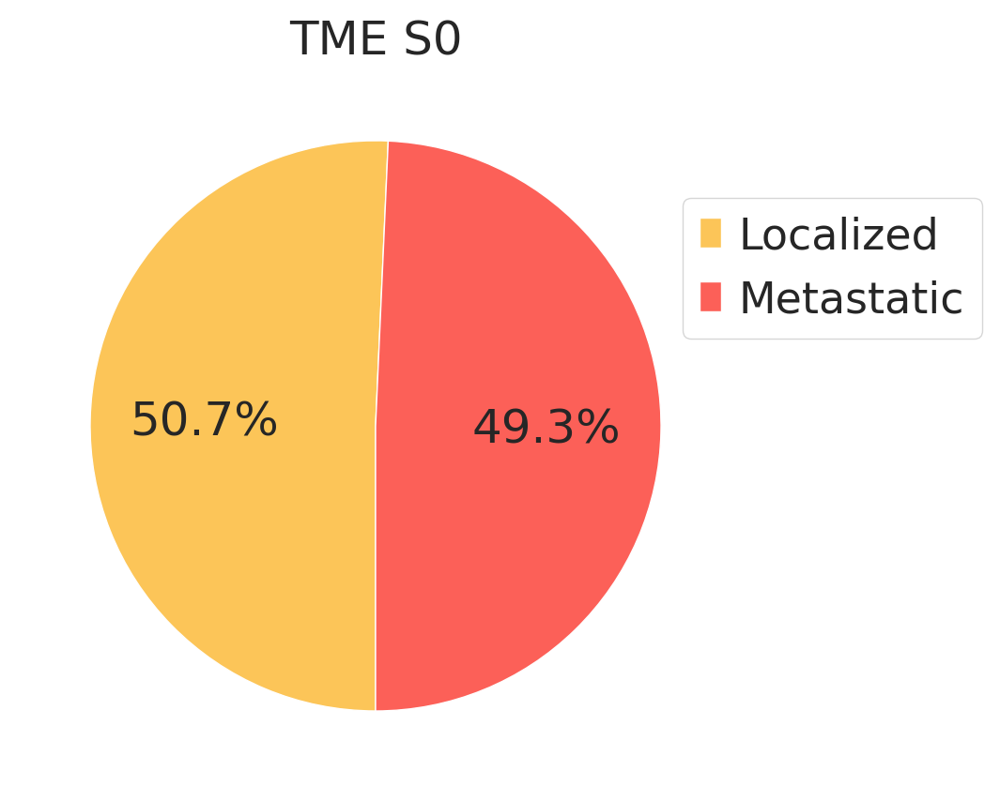

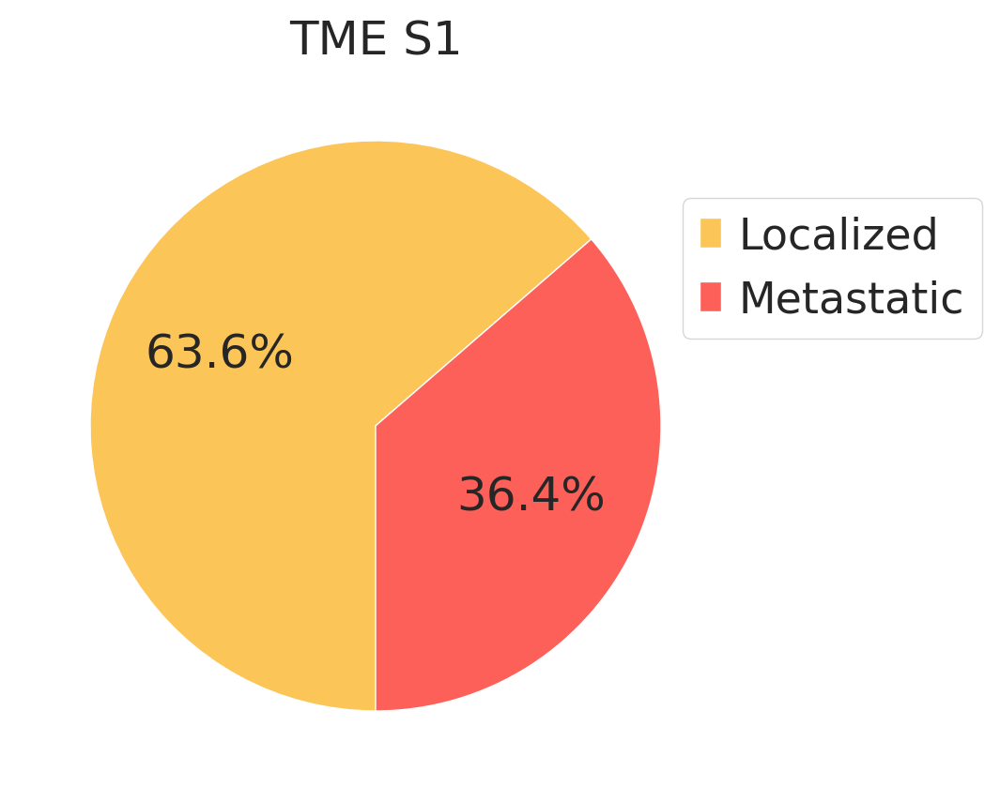

In [790]:
sc.settings.set_figure_params(dpi=100, figsize=(5,5), fontsize=18)
with_stage = pd.concat([SNU_adata_HVG.obs.loc[:,['stage_C','Mets_liver_C','Mets_lung_C','Mets_PS_C', 'CTx_response_FFX']], SNU_annot],axis=1)
m1 = with_stage['TME2Type_2nd'] == 'S0'
m2 = with_stage['TME2Type_2nd'] == 'S1'

with_stage_sel1 = with_stage[m1]
with_stage_sel2 = with_stage[m2]

stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('TME S0')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('TME S1')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

Mets_liver  no  yes
Tumor Type         
S0          14    3
S1          14   11
0.14849462386925674


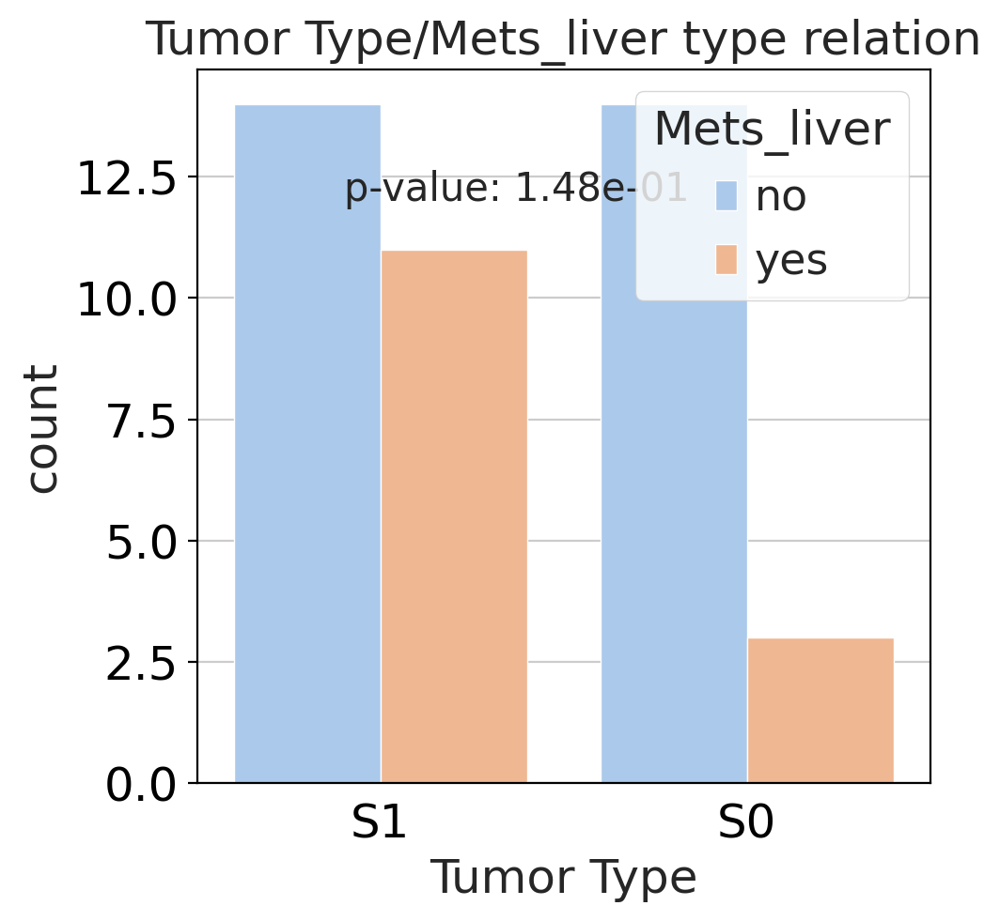

In [795]:
cat = ['Tumor2Type_2nd','Mets_PS_C']
tmp = with_stage.loc[:,cat]
n = ['Tumor Type', 'Mets_liver']
n1 = n[0]
n2 = n[1]
tmp.columns = n
sns.countplot(x=n1, hue=n2, data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp[n1],tmp[n2])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.1, 12, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('{}/{} type relation'.format(n1,n2))
plt.show()

TME Type    S0  S1
Tumor Type        
S0          36  16
S1          35   6
0.11591547480714859


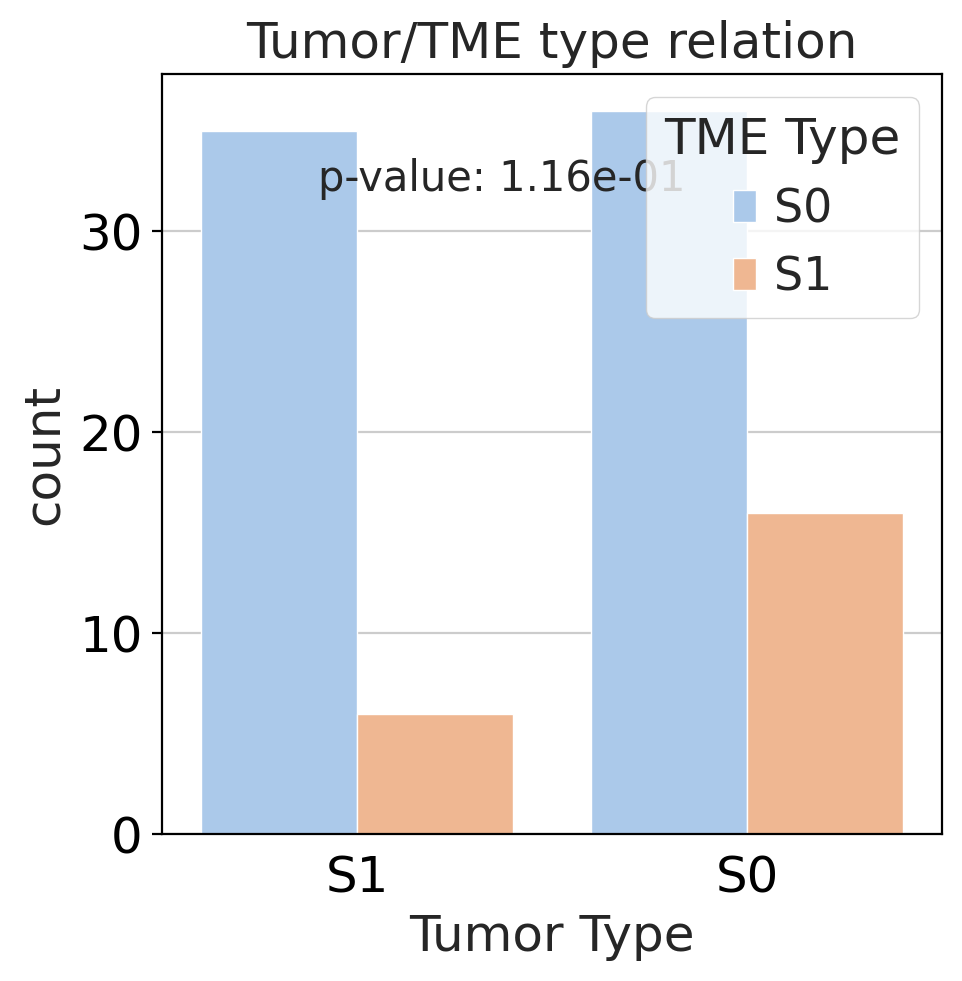

In [791]:
tmp = with_stage.loc[:,['Tumor2Type_2nd','TME2Type_2nd']]
tmp.columns = ['Tumor Type', 'TME Type']
sns.countplot(x="Tumor Type", hue="TME Type", data=tmp, palette='pastel')

ct_table_ind=pd.crosstab(tmp['Tumor Type'],tmp['TME Type'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
p_val="{:.2e}".format(p)
print(ct_table_ind)
print(p)
plt.text(-0.1, 32, 'p-value: {}'.format(p_val), fontsize=15)
plt.title('Tumor/TME type relation')
plt.show()


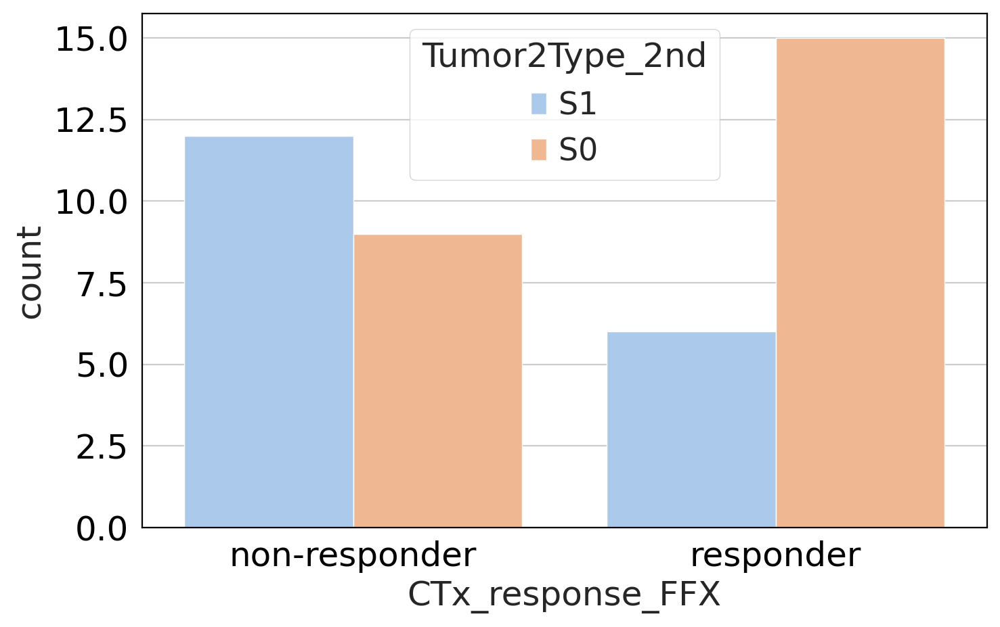

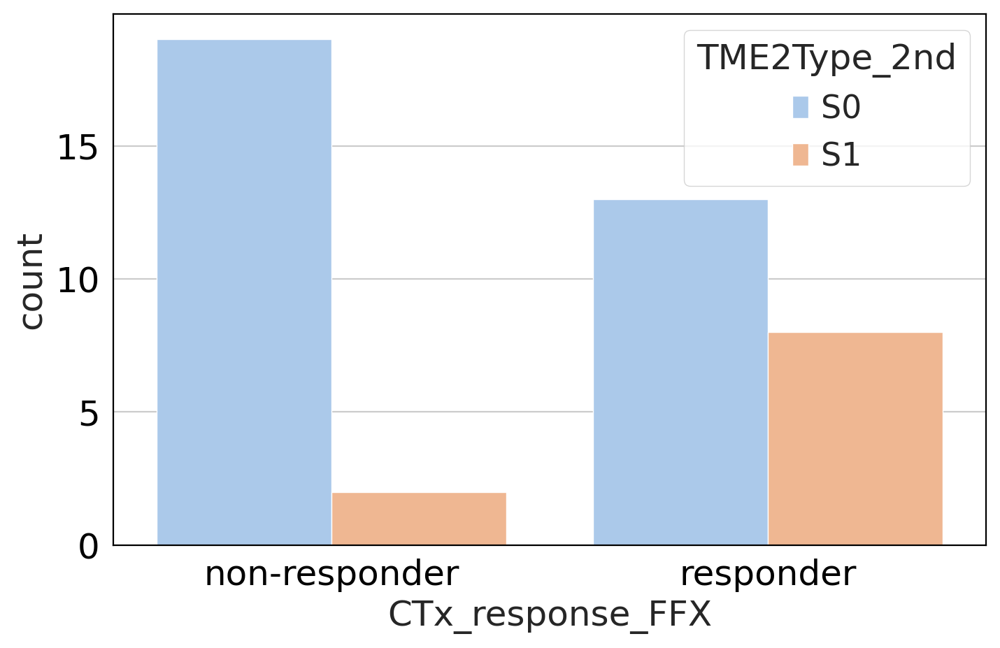

In [194]:
sns.countplot(x="CTx_response_FFX", hue="Tumor2Type_2nd", data=with_stage, palette='pastel')
plt.show()
sns.countplot(x="CTx_response_FFX", hue="TME2Type_2nd", data=with_stage, palette='pastel')
plt.show()

yes    8
no     5
Name: Mets_liver_C, dtype: int64
no     8
yes    5
Name: Mets_lung_C, dtype: int64
no     12
yes     1
Name: Mets_PS_C, dtype: int64


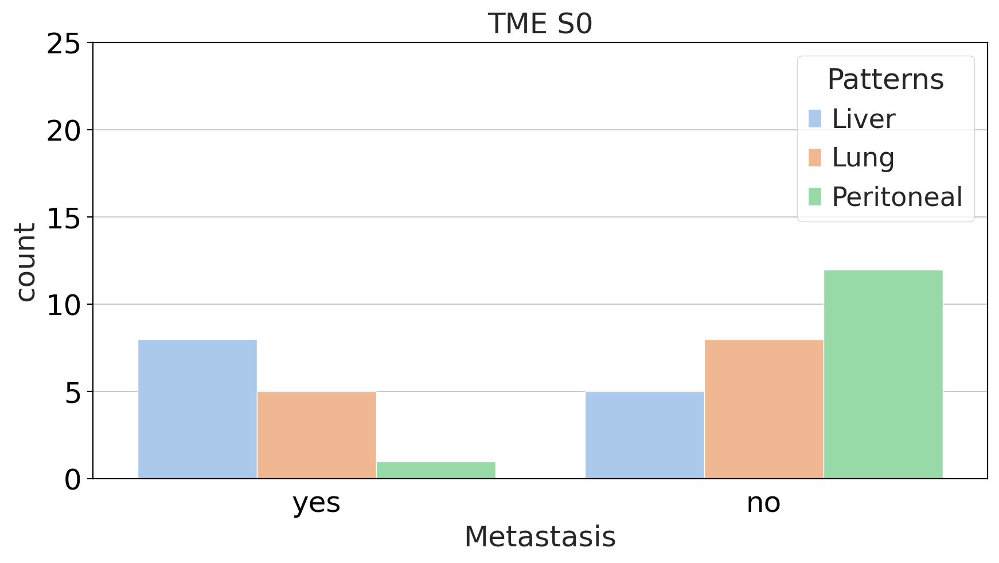

no     3
yes    1
Name: Mets_liver_C, dtype: int64
yes    2
no     2
Name: Mets_lung_C, dtype: int64
yes    2
no     2
Name: Mets_PS_C, dtype: int64


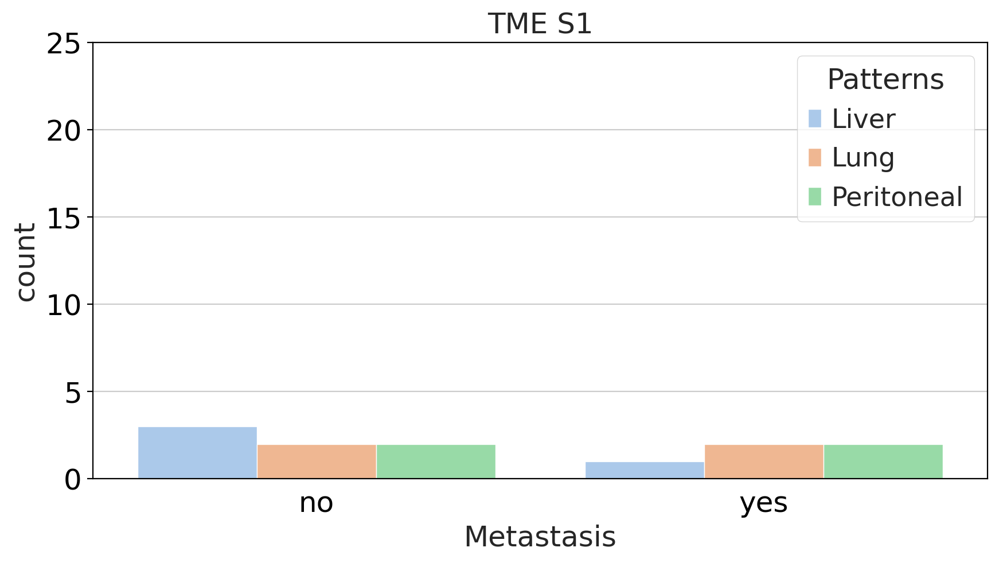

In [838]:
mets_dict = dict()
mets_dict['Mets_liver_C']='Liver'
mets_dict['Mets_lung_C']='Lung'
mets_dict['Mets_PS_C']='Peritoneal'



met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')

df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
plt.title('TME S0')
plt.ylim((0,25))
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
plt.title('TME S1')
plt.ylim((0,25))
plt.show()


In [196]:
with_stage
ct_table_ind=pd.crosstab(with_stage['Tumor2Type_2nd'],with_stage['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(with_stage['TME2Type_2nd'],with_stage['stage_C'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(with_stage['Tumor2Type_2nd'],with_stage['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)
print()
ct_table_ind=pd.crosstab(with_stage['TME2Type_2nd'],with_stage['CTx_response_FFX'])    
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
print(ct_table_ind)
print(p)


stage_C         Localized  Metastatic
Tumor2Type_2nd                       
S0                     35          17
S1                     15          26
0.006127581755820714

stage_C       Localized  Metastatic
TME2Type_2nd                       
S0                   36          35
S1                   14           8
0.4131863667710439

CTx_response_FFX  non-responder  responder
Tumor2Type_2nd                            
S0                            9         15
S1                           12          6
0.1189907208931241

CTx_response_FFX  non-responder  responder
TME2Type_2nd                              
S0                           19         13
S1                            2          8
0.07007553859334138


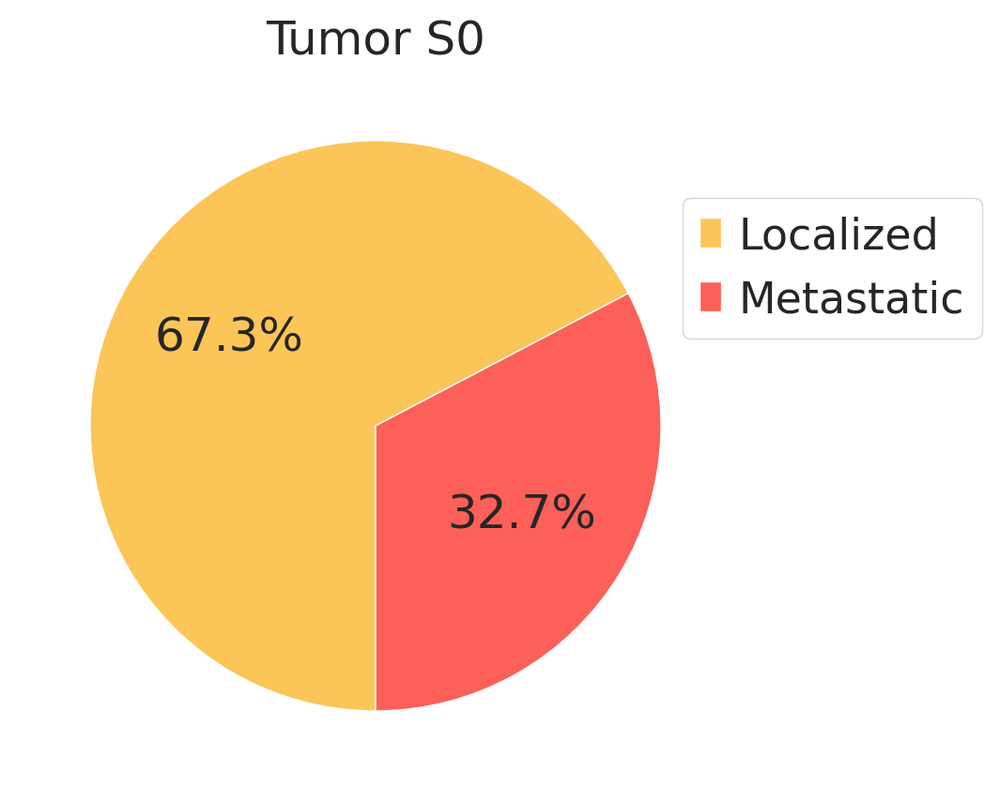

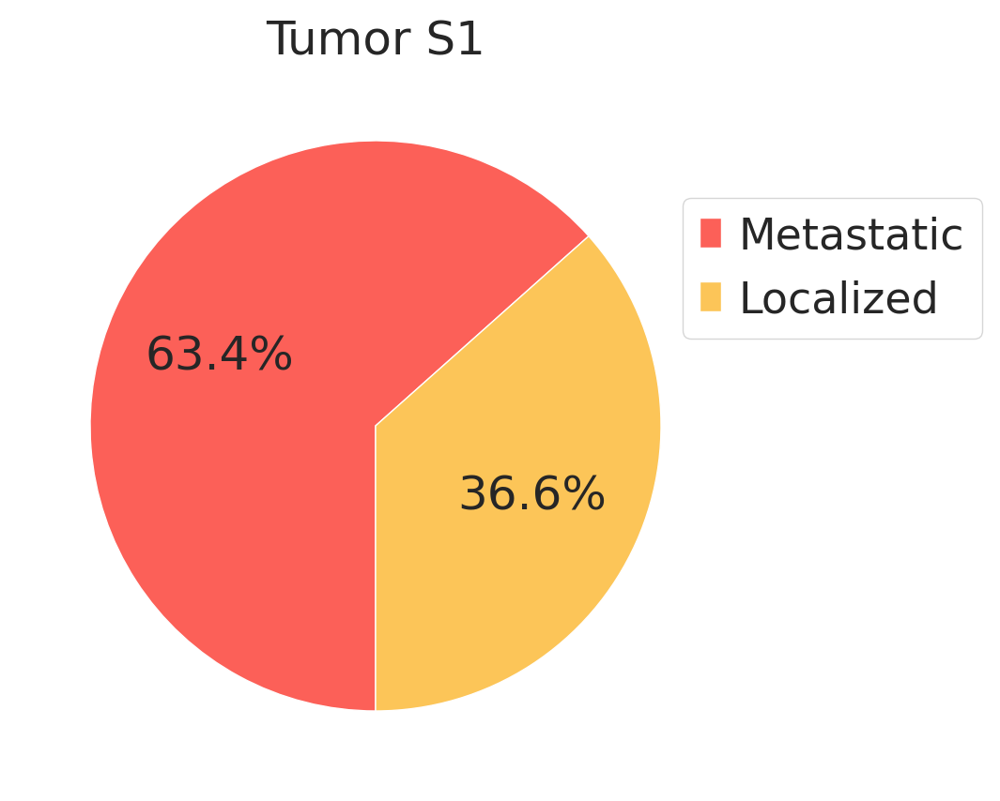

In [197]:
m1 = with_stage['Tumor2Type_2nd'] == 'S0'
m2 = with_stage['Tumor2Type_2nd'] == 'S1'

with_stage_sel1 = with_stage[m1]
with_stage_sel2 = with_stage[m2]

stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('Tumor S0')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fc6058', '#fcc558'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('Tumor S1')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

yes    9
no     8
Name: Mets_liver_C, dtype: int64
no     10
yes     7
Name: Mets_lung_C, dtype: int64
no     14
yes     3
Name: Mets_PS_C, dtype: int64


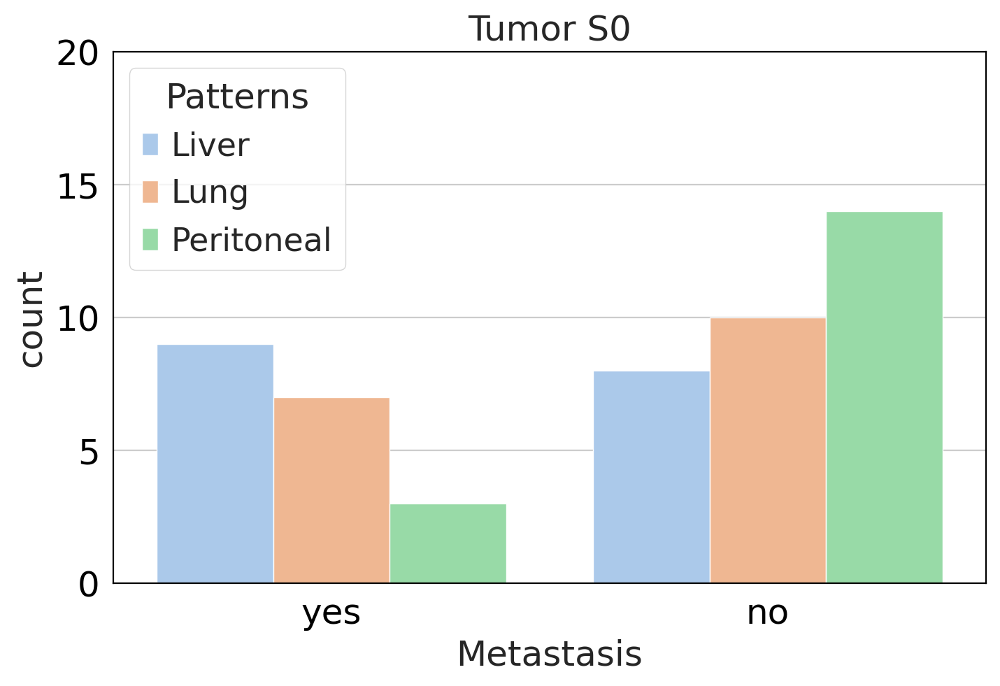

yes    18
no      8
Name: Mets_liver_C, dtype: int64
no     19
yes     7
Name: Mets_lung_C, dtype: int64
no     14
yes    11
Name: Mets_PS_C, dtype: int64


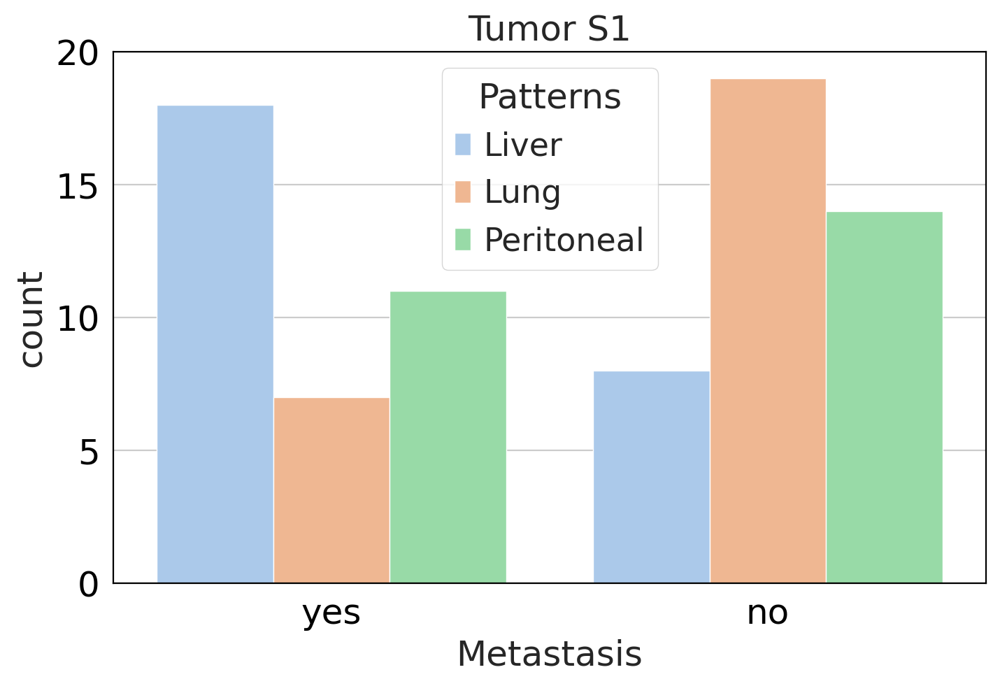

In [198]:
met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
plt.title('Tumor S0')
plt.ylim((0,20))
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
print(met['Mets_liver_C'].value_counts())
print(met['Mets_lung_C'].value_counts())
print(met['Mets_PS_C'].value_counts())
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
plt.title('Tumor S1')
plt.ylim((0,20))
plt.show()

In [199]:
# met = with_stage_sel1.loc[:,['CTx_response_FFX']]

# df_met = pd.melt(met, value_vars=['CTx_response_FFX'], value_name='Metastasis', var_name='Patterns')
# df_met.dropna(inplace=True)
# df_met
# df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
# df_met
# g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
# plt.title('Tumor S0')
# plt.ylim((0,20))
# plt.show()

# met = with_stage_sel2.loc[:,['CTx_response_FFX']]

# df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
# df_met.dropna(inplace=True)
# df_met
# df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
# df_met
# g = sns.countplot(x="Metastasis", hue="Patterns", data=df_met, palette='pastel')
# plt.title('Tumor S1')
# plt.ylim((0,20))
# plt.show()

In [835]:
grouped = with_stage.loc[:,['stage_C','FinalType']].groupby('FinalType')
for key, df_ in grouped:
    print(key)
    print(df_['stage_C'].value_counts())
    print()

S0-S0
Localized     23
Metastatic    13
Name: stage_C, dtype: int64

S0-S1
Localized     12
Metastatic     4
Name: stage_C, dtype: int64

S1-S0
Metastatic    22
Localized     13
Name: stage_C, dtype: int64

S1-S1
Metastatic    4
Localized     2
Name: stage_C, dtype: int64



S0-S0
            stage
Localized      23
Metastatic     13


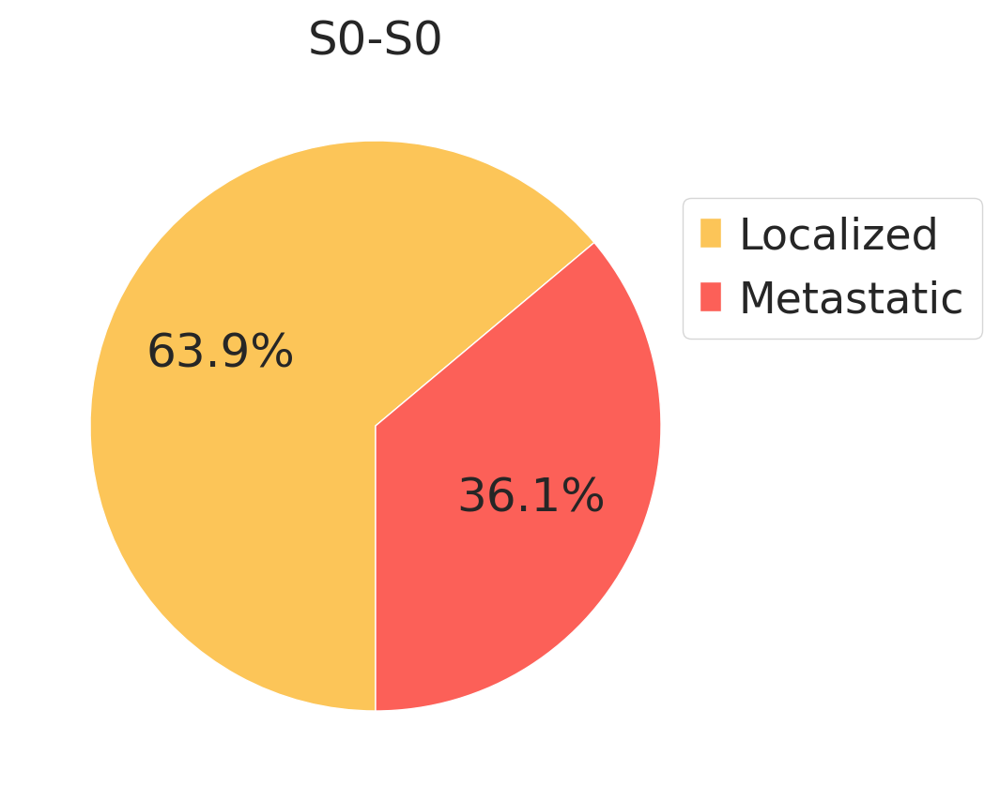

S0-S1
            stage
Localized      12
Metastatic      4


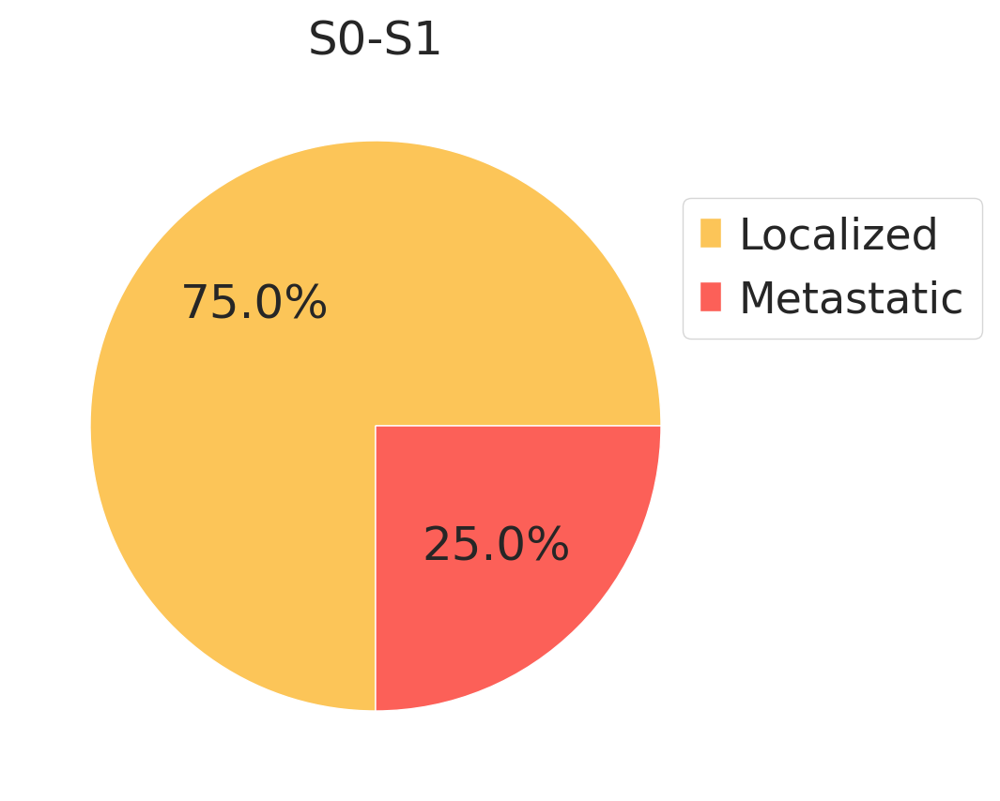

S1-S0
            stage
Metastatic     22
Localized      13


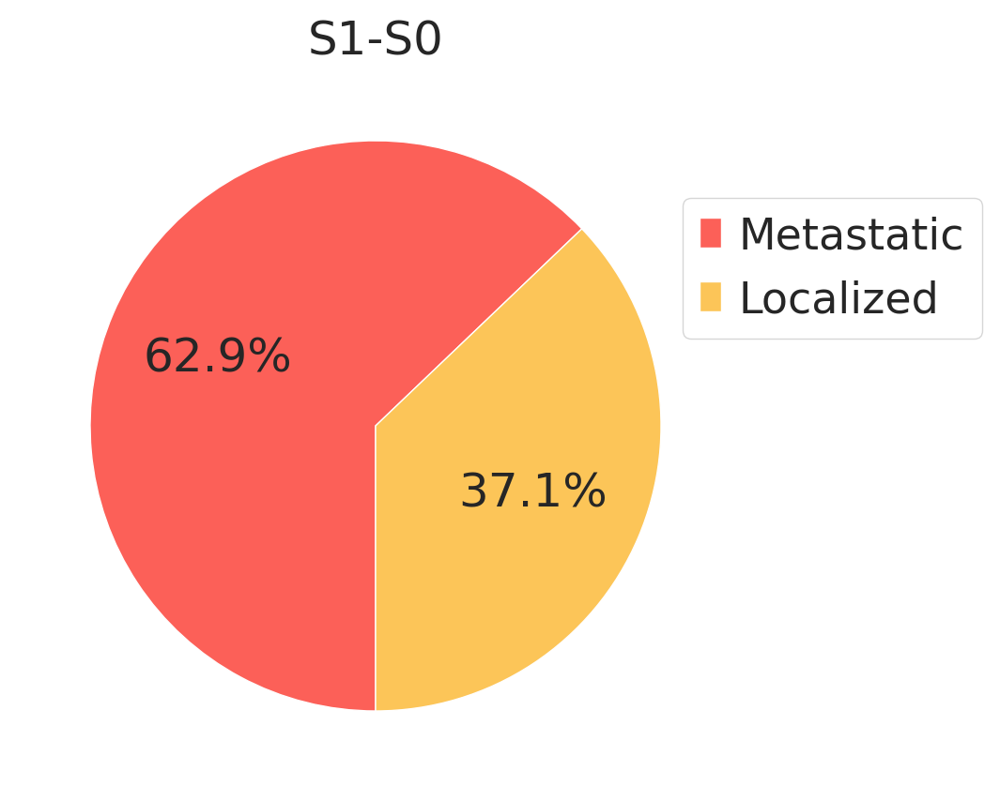

S1-S1
            stage
Metastatic      4
Localized       2


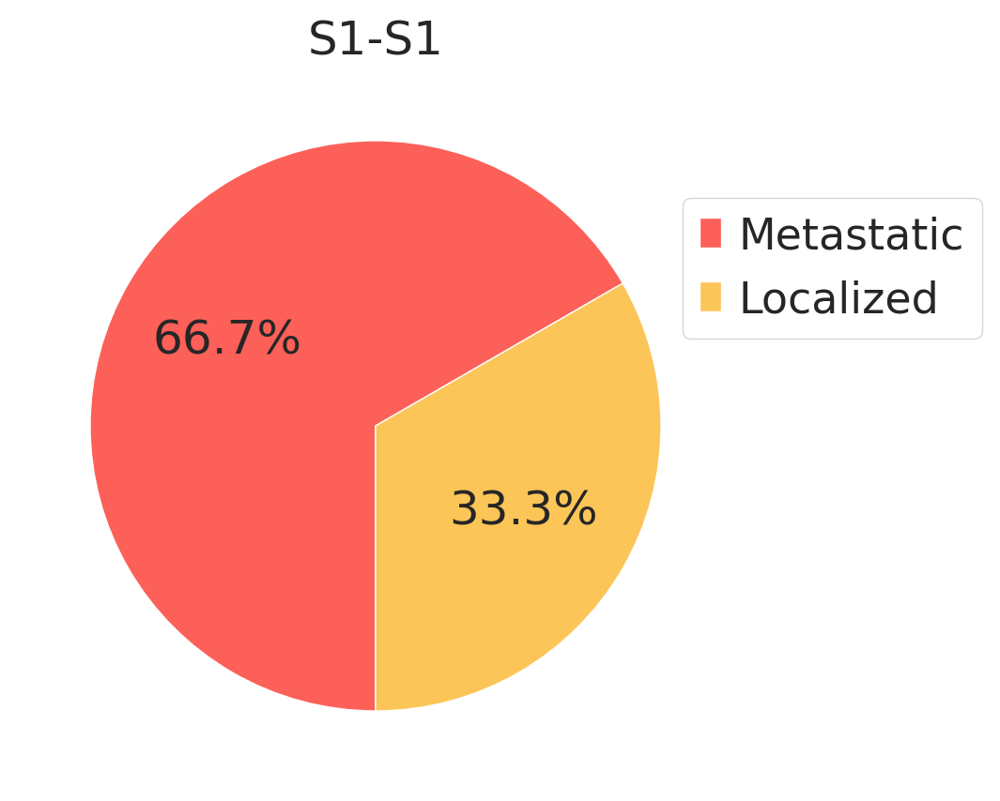

In [845]:


m1 = with_stage['FinalType'] == 'S0-S0'
m2 = with_stage['FinalType'] == 'S0-S1'
m3 = with_stage['FinalType'] == 'S1-S0'
m4 = with_stage['FinalType'] == 'S1-S1'

with_stage_sel1 = with_stage[m1]
with_stage_sel2 = with_stage[m2]
with_stage_sel3 = with_stage[m3]
with_stage_sel4 = with_stage[m4]


stage = with_stage_sel1['stage_C'].value_counts().to_frame('stage')
print('S0-S0')
print(stage)
stage = stage/with_stage_sel1['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('S0-S0')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel2['stage_C'].value_counts().to_frame('stage')
print('S0-S1')
print(stage)
stage = stage/with_stage_sel2['stage_C'].value_counts().sum() *100
colors =['#fcc558', '#fc6058'] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('S0-S1')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel3['stage_C'].value_counts().to_frame('stage')
print('S1-S0')
print(stage)
stage = stage/with_stage_sel3['stage_C'].value_counts().sum() *100
colors =['#fc6058','#fcc558',] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('S1-S0')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

stage = with_stage_sel4['stage_C'].value_counts().to_frame('stage')
print('S1-S1')
print(stage)
stage = stage/with_stage_sel4['stage_C'].value_counts().sum() *100
colors =['#fc6058','#fcc558',] 
ratio = stage.values.reshape(-1)
stage2 = list(stage.index)
patches, texts, autotexts = plt.pie(ratio, labels=stage2, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('S1-S1')
plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

S0-S0    36
S1-S0    35
S0-S1    16
S1-S1     6
Name: FinalType, dtype: int64
S0-S0    107
S0-S1     32
S1-S0     28
S1-S1      8
Name: FinalType, dtype: int64
S0-S0    47
S1-S0    28
S0-S1    18
S1-S1     3
Name: FinalType, dtype: int64


Text(0.5, 1.0, 'PDAC Final subtype')

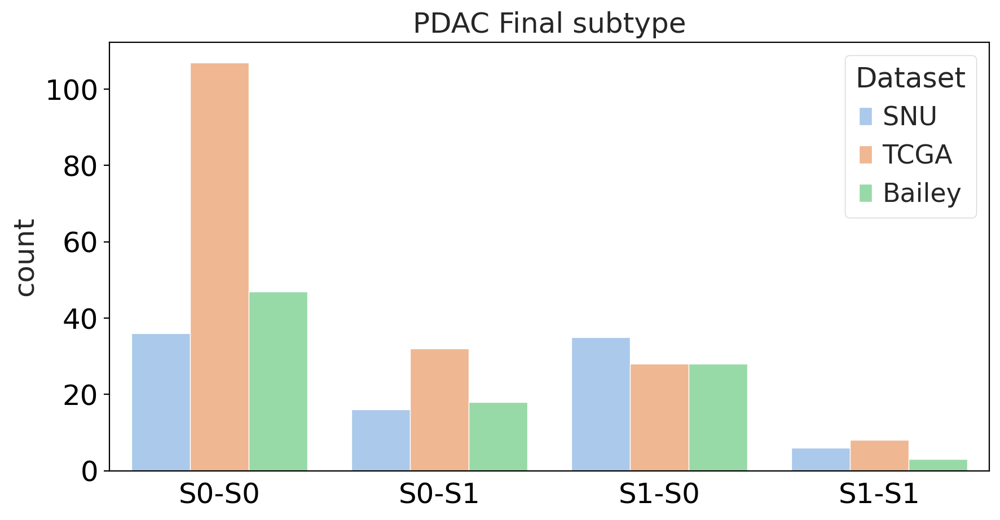

In [829]:
sc.settings.set_figure_params(dpi=100, figsize=(10,5), fontsize=18)
SNU_annot['Dataset']='SNU'
print(SNU_annot['FinalType'].value_counts())
TCGA_annot['Dataset']='TCGA'
print(TCGA_annot['FinalType'].value_counts())
Bailey_annot['Dataset']='Bailey'
print(Bailey_annot['FinalType'].value_counts())

mg_annot = pd.concat([SNU_annot, TCGA_annot, Bailey_annot],axis=0)
mg_annot = mg_annot.loc[:,['FinalType','Dataset']]

sns.countplot(x='FinalType', hue='Dataset', order=['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1'], data=mg_annot, palette='pastel')
plt.grid(False)
plt.xlabel('')
plt.title('PDAC Final subtype')

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


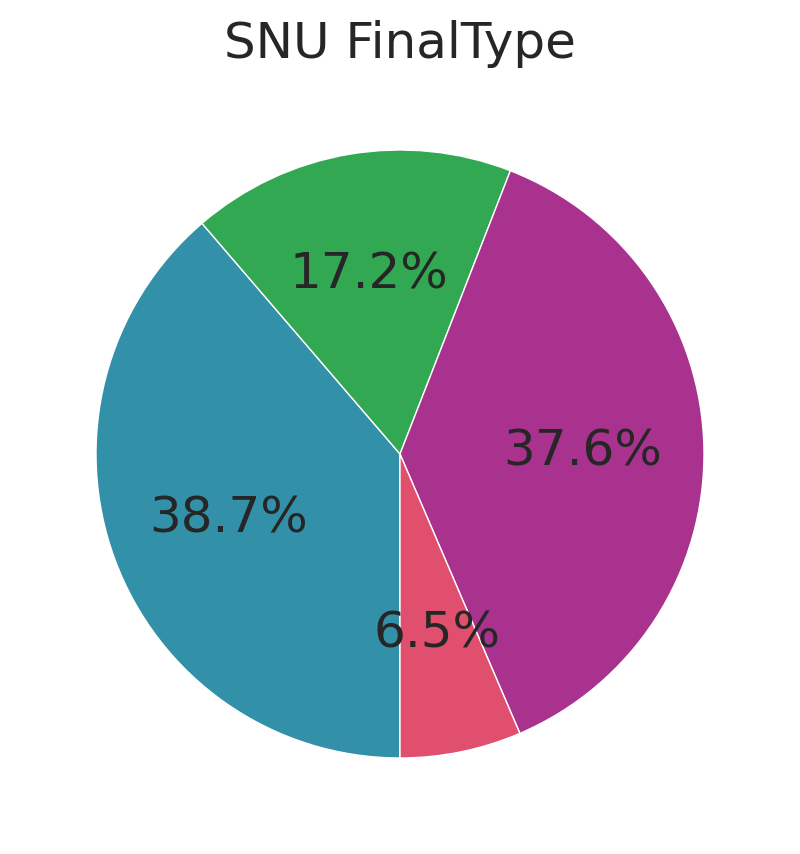

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


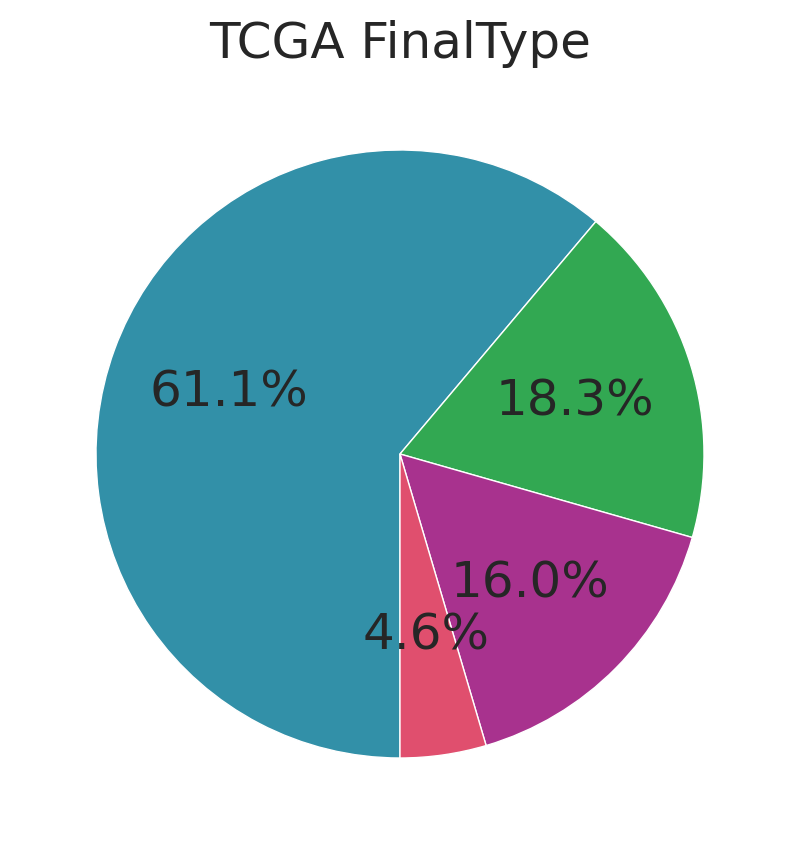

['S0-S0', 'S0-S1', 'S1-S0', 'S1-S1']


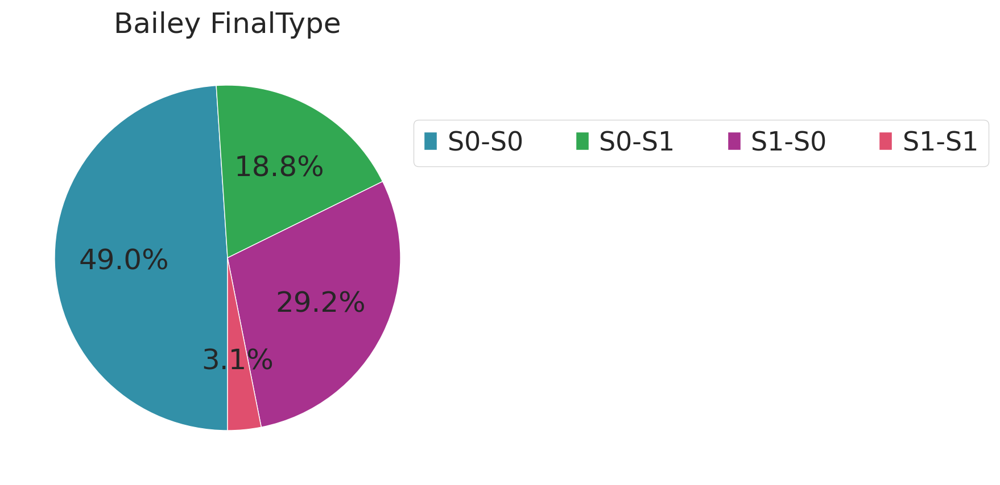

In [827]:
subtype = SNU_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('SNU FinalType')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = TCGA_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('TCGA FinalType')
#plt.legend(bbox_to_anchor=(0.9, .85))
plt.show()

subtype = Bailey_annot['FinalType'].value_counts().to_frame('FinalType')
subtype = subtype.loc[list(list(final_lut.keys())),:]
subtype = subtype/subtype['FinalType'].sum() *100
subtype
colors =list(final_lut.values())
ratio = subtype.values.reshape(-1)
labels = list(subtype.index)
print(labels)
patches, texts, autotexts = plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=270, counterclock=False, 
                                    colors=colors, labeldistance=None)
plt.title('Bailey FinalType')
plt.legend(bbox_to_anchor=(0.9, .85),ncol=4)
plt.show()

In [836]:
grouped = with_stage.groupby('FinalType')
for key, df in grouped:
    print(key)
    print(df['stage_C'].value_counts())
    print()

S0-S0
Localized     23
Metastatic    13
Name: stage_C, dtype: int64

S0-S1
Localized     12
Metastatic     4
Name: stage_C, dtype: int64

S1-S0
Metastatic    22
Localized     13
Name: stage_C, dtype: int64

S1-S1
Metastatic    4
Localized     2
Name: stage_C, dtype: int64



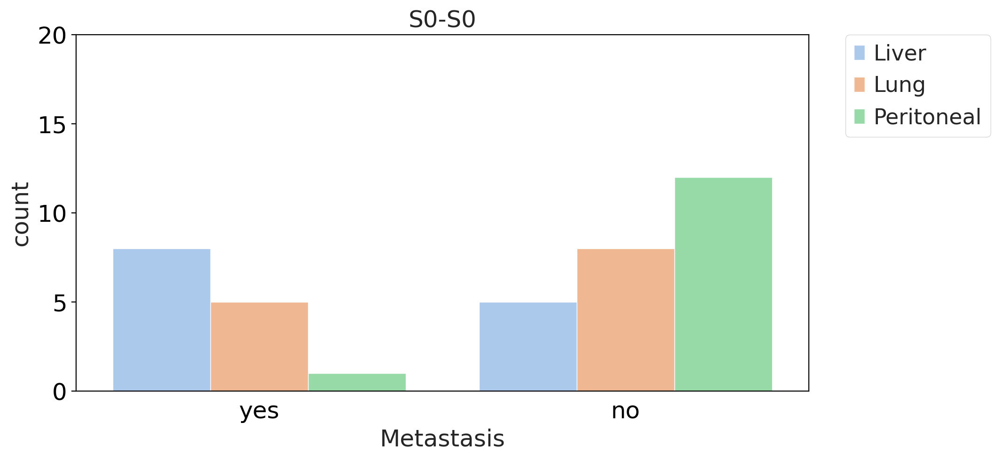

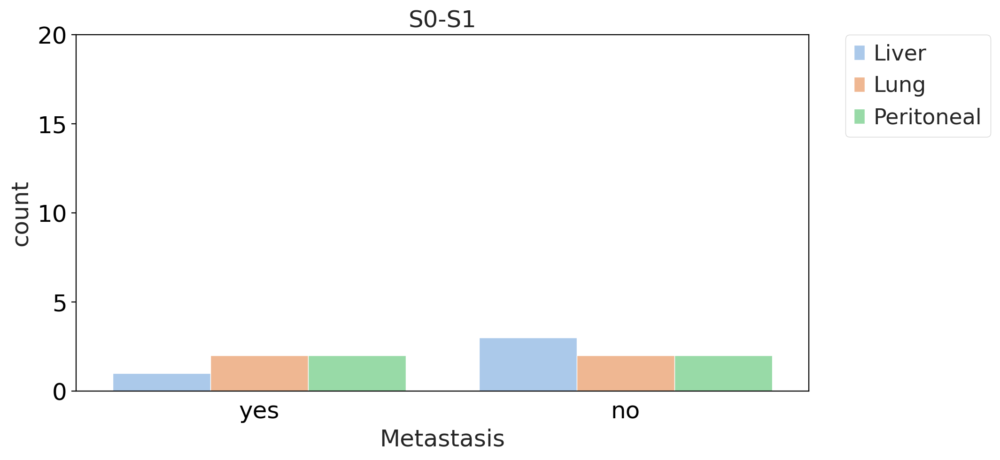

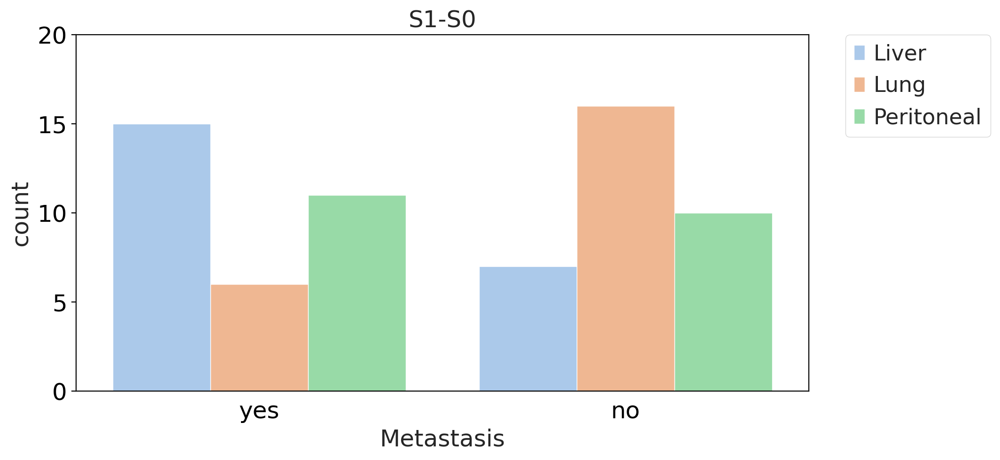

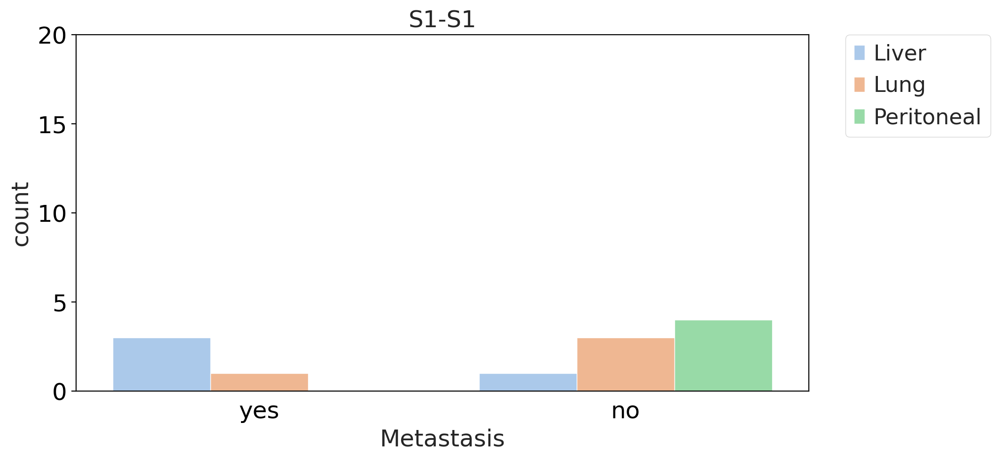

In [848]:

met = with_stage_sel1.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('S0-S0')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel2.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('S0-S1')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel3.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('S1-S0')
plt.ylim((0,20))
plt.grid(False)
plt.show()

met = with_stage_sel4.loc[:,['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C']]
df_met = pd.melt(met, value_vars=['Mets_liver_C', 'Mets_lung_C', 'Mets_PS_C'], value_name='Metastasis', var_name='Patterns')
df_met.dropna(inplace=True)
df_met
df_met['Patterns'] = df_met['Patterns'].map(mets_dict)
df_met
g = sns.countplot(x="Metastasis", hue="Patterns", order=['yes','no'], data=df_met, palette='pastel')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
plt.title('S1-S1')
plt.ylim((0,20))
plt.grid(False)
plt.show()

In [204]:
met

,Mets_liver_C,Mets_lung_C,Mets_PS_C
Snubh_TB,,,
20-T00330_FO-01,NaN,NaN,NaN
19-T00062_FO-01,NaN,NaN,NaN
19-T00201_FO-01,yes,no,no
21-T00687_FT-01,yes,no,no
21-T00771_FT-01,NaN,NaN,NaN
18-01500_FO-01,NaN,NaN,NaN
21-T00611_FT-01,yes,no,no
19-T00545_FO-01,yes,no,yes
19-T00073_FO-01,NaN,NaN,NaN


In [205]:
grouped = df_met.groupby('Patterns')
for key,df in grouped:
    print(key)
    print(df['Metastasis'].value_counts())
    print()

Liver
yes    18
no      8
Name: Metastasis, dtype: int64

Lung
no     19
yes     7
Name: Metastasis, dtype: int64

Peritoneal
no     14
yes    11
Name: Metastasis, dtype: int64



In [ ]:
with_stage['FinalType'].value_counts()

In [ ]:
list(final_lut.values())

# DEG & GSEA

In [209]:
SNU_adata = sc.read_h5ad('SNU_AnnDataForm_20220814.h5ad')
sc.pp.log1p(SNU_adata)

SNU_annot = pd.read_csv('SNU_TumorType.csv',index_col=0)

In [210]:
res_save_folder = './DEG_Res'
if not os.path.isdir(res_save_folder):
    os.mkdir(res_save_folder)

In [211]:
SNU_adata.obs['TumorType'] = SNU_annot['Tumor2Type_2nd'].astype('category')
SNU_adata.obs['TMEType'] = SNU_annot['TME2Type_2nd'].astype('category')


In [262]:
target_group = 'TMEType'
test = SNU_adata.obs[target_group].cat.categories[0]
print('test: {}'.format(test))
control = SNU_adata.obs[target_group].cat.categories[1]
print('control: {}'.format(control))

test_method = 't-test' # wilcoxon / t-test
groups = [test, control]
sc.tl.rank_genes_groups(SNU_adata, target_group, groups=[test], reference=control, method=test_method)

result = SNU_adata.uns['rank_genes_groups']
df_deg = pd.DataFrame( index = result['names'][test] )
for key in ['logfoldchanges', 'pvals', 'pvals_adj', 'scores']:
    df_deg[key] = result[key][test]
#df_wilcoxon.columns = ['logfoldchanges', 'wilcoxon-pvals', 'wilcoxon-pvals_adj', 'wilcoxon-scores']
df_deg = df_deg.sort_values(by='pvals')
m = df_deg['pvals'] < 0.05
df_deg = df_deg[m]
sv_file = os.path.join(res_save_folder,'DEG_{}_{}.csv'.format(target_group,test_method))
df_deg.to_csv(sv_file)
print('{}'.format(sum(df_deg['pvals_adj']<0.05)))
df_deg

test: S0
control: S1
1822


,logfoldchanges,pvals,pvals_adj,scores
MS4A14,2.352552,4.246947e-19,8.488373e-15,11.464903
NCKAP1L,1.838622,2.674053e-16,2.672315e-12,11.626183
MYO1G,1.736668,1.574308e-14,1.048857e-10,10.133415
MS4A6A,1.682815,3.639554e-13,1.818594e-09,9.532481
RASAL3,1.655138,1.920639e-12,6.688775e-09,8.524631
...,...,...,...,...
TMEM257,25.821754,4.986254e-02,2.273086e-01,1.995669
USP5,-0.270353,4.986983e-02,2.273086e-01,-2.013247
C12orf49,-0.404971,4.995714e-02,2.276547e-01,-2.023230
GABRG3,26.038454,4.997448e-02,2.276818e-01,1.994666


In [263]:
DEG_files = os.listdir(res_save_folder)
DEG_dict = dict()
for file in DEG_files:
    key_ = file.split('.')[0]
    file_dir = os.path.join(res_save_folder,file)
    val = pd.read_csv(file_dir, index_col=0)
    DEG_dict[key_] = val
sorted(DEG_dict.keys())

['DEG_CTx_response_FFX_t-test',
 'DEG_CTx_response_GNP_t-test',
 'DEG_Mets_PS_C_t-test',
 'DEG_Mets_PS_t-test',
 'DEG_Mets_liver_C_t-test',
 'DEG_Mets_liver_t-test',
 'DEG_Mets_lung_C_t-test',
 'DEG_Mets_lung_t-test',
 'DEG_TMEType_t-test',
 'DEG_TumorType_t-test',
 'DEG_stage_A_t-test',
 'DEG_stage_B_t-test',
 'DEG_stage_C_t-test']

In [264]:
dkey = 'DEG_'+target_group+'_t-test'

df_deg = DEG_dict[dkey]
m = df_deg['logfoldchanges'] > 0
up_genes = list(df_deg[m].index)[:200]
down_genes = list(df_deg[~m].index)[:200]

m = df_deg['pvals_adj'] < 0.05
df_deg[m]

,logfoldchanges,pvals,pvals_adj,scores
MS4A14,2.352552,4.246947e-19,8.488373e-15,11.464903
NCKAP1L,1.838622,2.674053e-16,2.672315e-12,11.626183
MYO1G,1.736668,1.574308e-14,1.048857e-10,10.133415
MS4A6A,1.682815,3.639554e-13,1.818594e-09,9.532481
RASAL3,1.655138,1.920639e-12,6.688775e-09,8.524631
...,...,...,...,...
HIST1H2BN,-0.558589,4.529501e-03,4.979710e-02,-3.011096
PDE8B,0.569165,4.534818e-03,4.982815e-02,2.989965
NOTCH1,0.550638,4.545745e-03,4.992077e-02,3.024603
TIAM1,0.990427,4.549235e-03,4.992384e-02,3.091838


In [259]:
import matplotlib.patches as mpatches
import matplotlib
import textwrap


def PS_plot(df, test, control, ytickwidth=0.65, title=''):
    
    try:
        palette ={"Up-regulated": "#f54922", "Down-regulated": "#2261f5"}
        red_patch = mpatches.Patch(color='#f54922', label=test)
        blue_patch = mpatches.Patch(color='#2261f5', label=control)
        sorting_args = ['Type', 'Pathway-Score(Negative Log)']    
        df = df.sort_values(by=sorting_args,ascending = [False]*len(sorting_args))
        df_sel = df.iloc[:25,:]
        colors = list(df_sel['Type'].map(palette))
        ylen = df_sel.shape[0]
        plt.figure(figsize=(10,ylen*ytickwidth), dpi=100)
        ax = sns.barplot(x="Pathway-Score(Negative Log)", y="Pathways",
                    data=df_sel, color="salmon", saturation=.9, palette=colors)
        f = lambda x: textwrap.fill(x.get_text(), 55)
        ax.set_yticklabels(map(f, ax.get_yticklabels()))
        plt.legend(handles=[red_patch, blue_patch],loc='lower right', fontsize=12)
        #ax.legend(loc='lower right', labels=["Up-regulated","Down-regulated"], fontsize=15)
        plt.title(title,fontsize=18)
        plt.yticks(fontsize=12)
        plt.xlabel('Pathway-Score(Negative Log)', fontsize=15)
        plt.ylabel('')
        #plt.xlim((0,15))
        plt.tight_layout()
        plt.show()
    except:
        print('Cannot show figure')
    return df_sel


def Term_name(df):
    if df['Gene_set'].find('GO_Bio') == -1:
        return '{}\n({})'.format(df['Term'], df['Gene_set'])
    else:
        return '{}'.format(df['Term'])
    

def ln(x):
    return -np.log(x)

def GSEA_custom(gene_list, dataset_list, organism='Human', adj_p_threshold=0.05):
    
    enr_res = gseapy.enrichr(gene_list=gene_list,organism=organism,
                         gene_sets=dataset_list,description='pathway', cutoff = 0.9)
    gsea_df = enr_res.results
    gsea_df['Pathways'] = gsea_df.apply(Term_name, axis=1)
    gsea_df = gsea_df.sort_values(by='Adjusted P-value')
    m = gsea_df['Adjusted P-value'] < adj_p_threshold
    gsea_df_sel = gsea_df[m]
    gsea_df_sel['Pathway-Score(Negative Log)'] = gsea_df_sel['Adjusted P-value'].map(ln)
    #res_df['-log10 p value'] = res_df['P-value'].map(log10)
    return gsea_df_sel

# def PS_plot(df, title=''):
#     df_sel = df.iloc[:20,:]
#     ylen = df_sel.shape[0]
#     plt.figure(figsize=(8,ylen*0.7))
#     sns.barplot(x="Pathway-Score(Negative Log)", y="Pathways", data=df_sel, color="salmon", saturation=.8)
#     plt.title(title,fontsize=20)
#     plt.yticks(fontsize=15)
#     plt.show()
    

In [257]:
save_folder = './GSEA_Res'
if not os.path.isdir(save_folder):
    os.mkdir(save_folder)
    

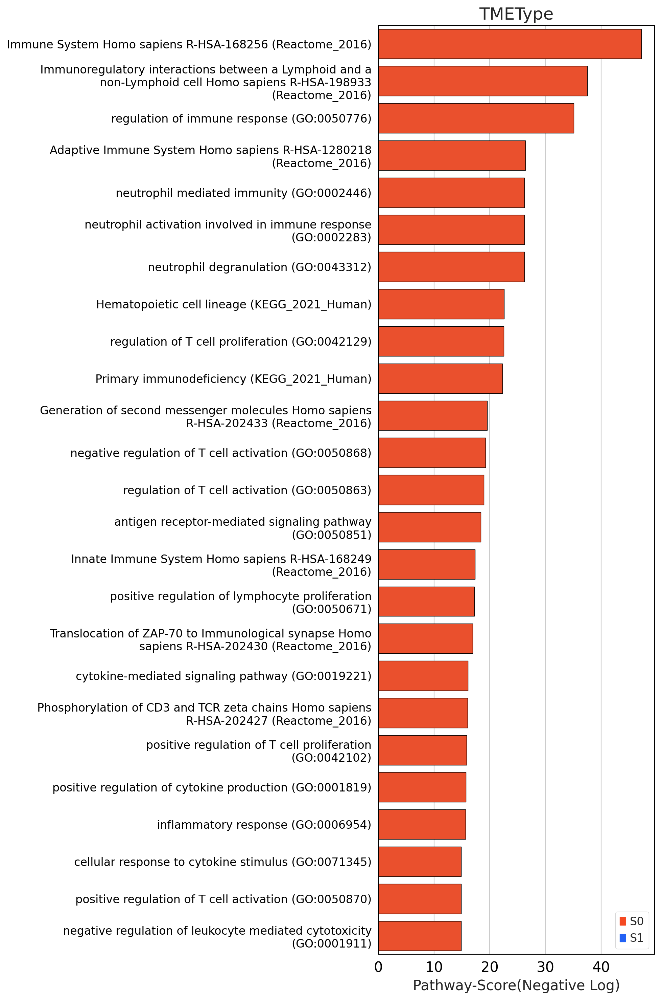

In [267]:
#geneset_list = ['MSigDB_Hallmark_2020', 'KEGG_2021_Human', 'GO_Biological_Process_2021', 'Reactome_2016']
geneset_list = ['KEGG_2021_Human', 'GO_Biological_Process_2021', 'Reactome_2016']

gsea_res = GSEA_custom(gene_list=up_genes,dataset_list=geneset_list)
file_dir = os.path.join(save_folder,'GSEA_{}_up.csv'.format(dkey))
gsea_res.to_csv(file_dir)

gsea_res = GSEA_custom(gene_list=down_genes,dataset_list=geneset_list)
file_dir = os.path.join(save_folder,'GSEA_{}_down.csv'.format(dkey))
gsea_res.to_csv(file_dir)

up_df = pd.read_csv(save_folder+'/GSEA_{}_up.csv'.format(dkey),index_col=0)
up_df['Type'] = "Up-regulated"
down_df = pd.read_csv(save_folder+'/GSEA_{}_down.csv'.format(dkey),index_col=0)
down_df['Type'] = "Down-regulated"
df2plot = up_df.append(down_df)
df_sel = PS_plot(df=df2plot, test=test, control=control, ytickwidth=0.6, title='{}'.format(target_group))


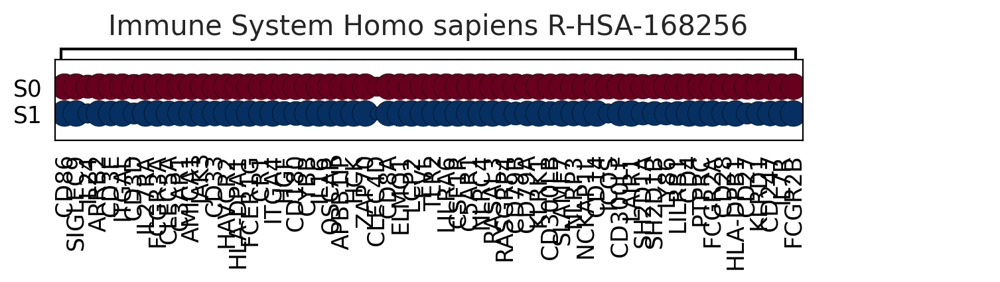

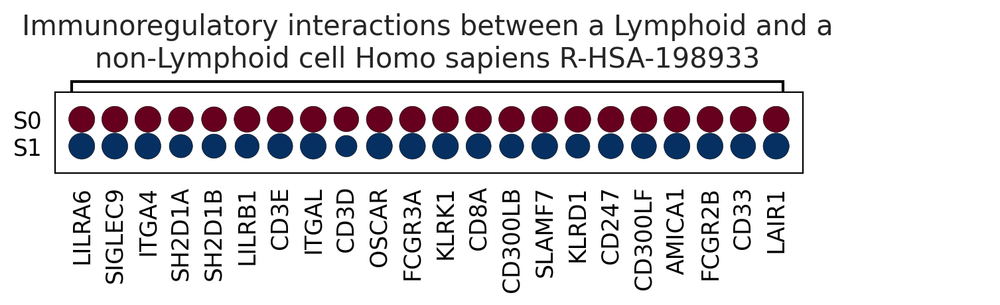

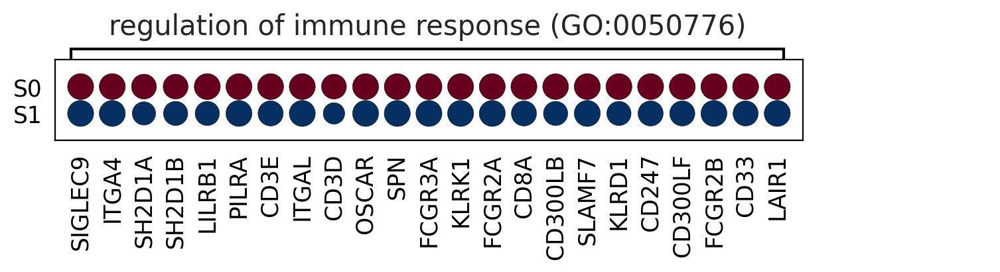

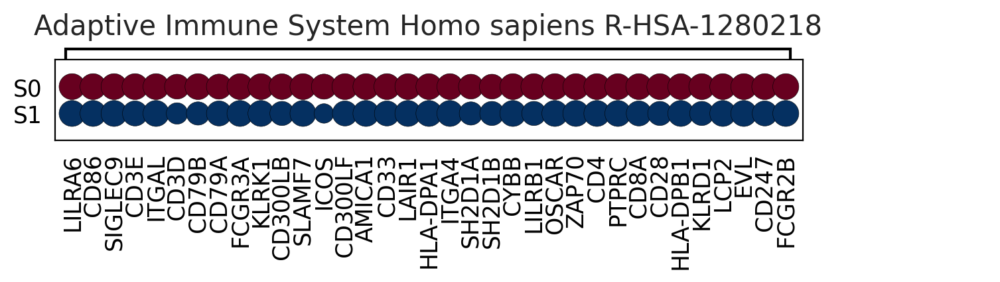

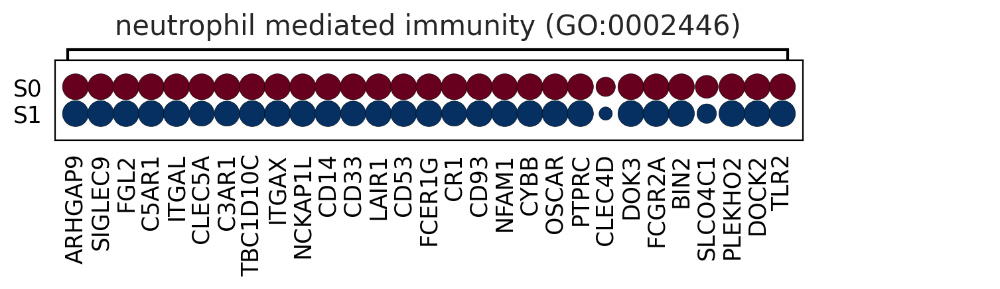

...

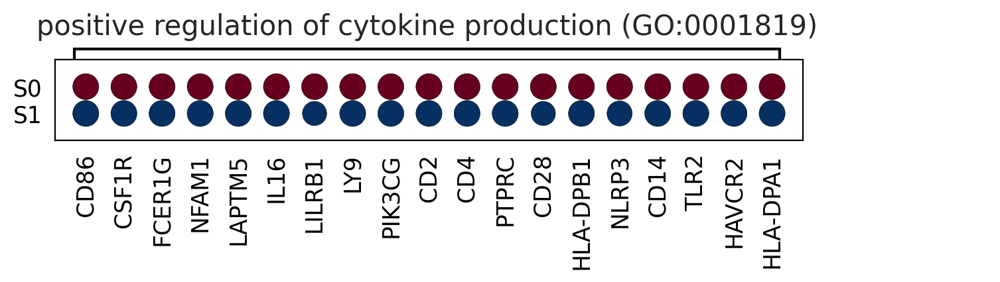

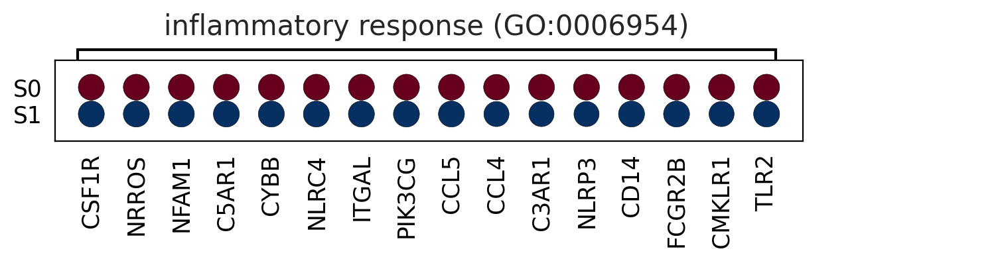

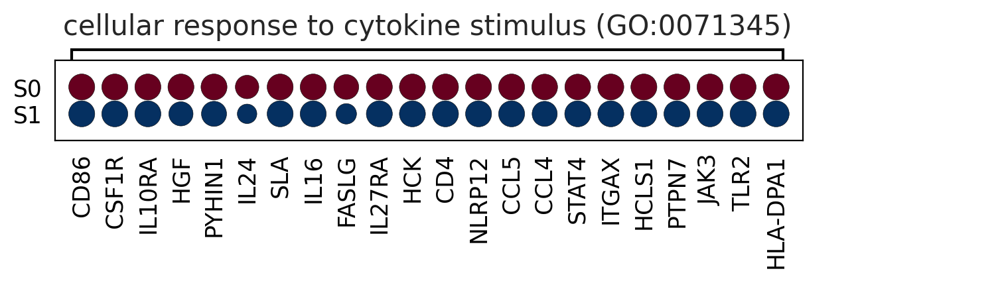

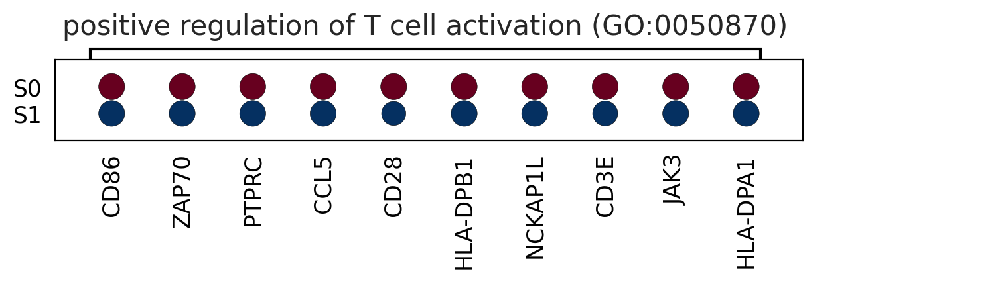

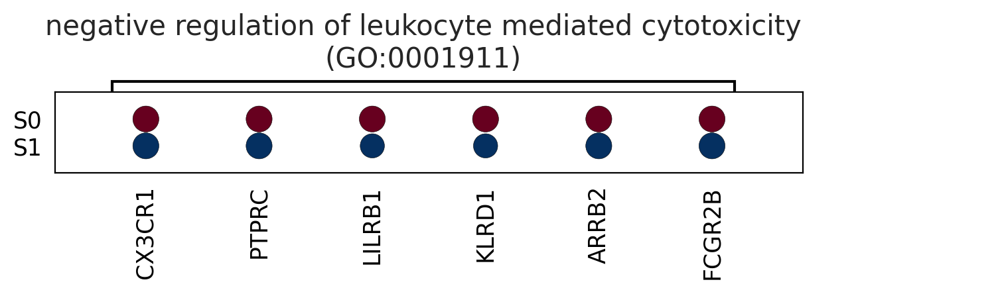

In [269]:
m = ~SNU_adata.obs[target_group].isna()
SNU_adata_sel = SNU_adata[m]

Terms = list(df_sel['Term'])
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(5, 5), facecolor='white', fontsize=15)
matplotlib.rcParams['patch.edgecolor'] = 'black'

pathway_geneset_dict = dict()
for term in Terms:
    m = df_sel['Term'] == term
    geneset = [gene for gene in df_sel.loc[m,'Genes'].values.item().split(';')]
    title = textwrap.fill(term, 55)
    ax = sc.pl.dotplot(SNU_adata, {title:geneset}, target_group,
                    dendrogram=False, var_group_rotation=0, figsize=(9,0.8), standard_scale='var', swap_axes=False,
                  vmin=0, vmax=1, return_fig=True).style(cmap='RdBu_r')
    axes_dict = ax.get_axes()
    axes_dict['size_legend_ax'].set_visible(False)
    axes_dict['color_legend_ax'].set_visible(False)
    plt.show()




# Subtype ALL SNU

In [869]:
SNU_annot

,Tumor2Type_1st,Tumor2Type_2nd,TME2Type_2nd,FinalType,F
Snubh_TB,,,,,
20-T00330_FO-01,Subtype_1,S1,S0,S1,Subtype_1-Subtype_0
19-T00062_FO-01,Subtype_1,S1,S0,S1,Subtype_1-Subtype_0
20-T00814_FT-01,Subtype_1,S0,S0,S0-S0,Subtype_0-Subtype_0
19-T00201_FO-01,Subtype_1,S1,S1,S1,Subtype_1-Subtype_1
19-T00505_FO-01,Subtype_0,S0,S0,S0-S0,Subtype_0-Subtype_0
...,...,...,...,...,...
21-T00576_FT-01,Subtype_1,S0,S0,S0-S0,Subtype_0-Subtype_0
19-T00620_FO-01,Subtype_1,S1,S0,S1,Subtype_1-Subtype_0
19-T00413_FO-01,Subtype_0,S0,S1,S0-S1,Subtype_0-Subtype_1


In [903]:
annot = pd.read_csv('ALL_TYPE2.csv',index_col=0)
tmp1 = annot.loc[:,['MoffittType','BaileyType','MichelleType']]
snu_tumor = SNU_annot.loc[:,['Tumor2Type_2nd','TME2Type_2nd','FinalType']]
#snu_tumor['FinalType'] = snu_tumor['Tumor2Type_2nd'].map(simple_name)+'-'+snu_tumor['TME2Type_2nd'].map(simple_name)
snu_tumor.columns = ['TumorType','TMEType','FinalType']


SNU_drug = SNU_adata.obs.loc[:,['CTx_response_FFX', 'CTx_response_GNP', 'total_CTx_response']]
SNU_drug['total_CTx_response'] = np.nan
m = ~SNU_drug['CTx_response_FFX'].isna()
SNU_drug.loc[m, 'total_CTx_response'] = SNU_drug.loc[m,'CTx_response_FFX']
m = ~SNU_drug['CTx_response_GNP'].isna()
SNU_drug.loc[m, 'total_CTx_response'] = SNU_drug.loc[m,'CTx_response_GNP']

annotation = pd.concat([tmp1,snu_tumor, SNU_drug],axis=1)
CNV = pd.read_csv('CNV.csv', index_col=0)
annotation = pd.merge(annotation, CNV, left_index=True, right_index=True, how='left')
annotation = annotation.sort_values(by='FinalType')
annotation




,MoffittType,BaileyType,MichelleType,TumorType,TMEType,FinalType,CTx_response_FFX,CTx_response_GNP,total_CTx_response,TP63,SMAD4,KRAS
Snubh_TB,,,,,,,,,,,,
19-T00489_FO-01,BasalLike,Squamous,Calssical-A,S0,S0,S0-S0,responder,NaN,responder,Neutral,Neutral,Neutral
19-T00192_FO-01,Classical,Immunogenic,Hybrid,S0,S0,S0-S0,responder,non-responder,non-responder,Neutral,Neutral,Neutral
21-T01006_FT-01,Classical,ADEX,Calssical-A,S0,S0,S0-S0,NaN,NaN,NaN,NaN,NaN,NaN
21-T00749_FT-01,Classical,Pancreatic Progenitor,Calssical-B,S0,S0,S0-S0,non-responder,NaN,non-responder,NaN,NaN,NaN
21-T00054_FT-01,Classical,Pancreatic Progenitor,Calssical-A,S0,S0,S0-S0,non-responder,non-responder,non-responder,Neutral,Neutral,Neutral
...,...,...,...,...,...,...,...,...,...,...,...,...
20-T00311_FO-01,BasalLike,Squamous,Basallike-A,S1,S0,S1,non-responder,responder,responder,Neutral,Neutral,Neutral
19-T00737_FO-01,BasalLike,Immunogenic,Basallike-A,S1,S0,S1,responder,NaN,responder,Neutral,Neutral,Neutral
21-T00277_FT-01,BasalLike,Squamous,Hybrid,S1,S0,S1,responder,NaN,responder,Neutral,Neutral,Neutral


['S0-S0', 'S0-S1', 'S1']


[]

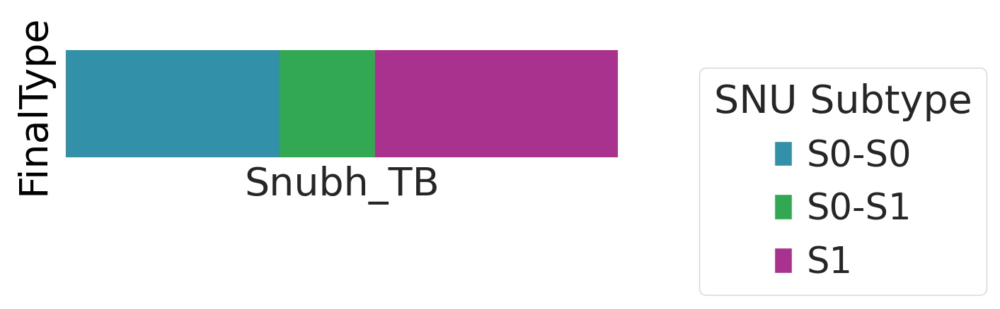

In [904]:
sc.set_figure_params(figsize=(5, 1), dpi=100, fontsize=20)


SNU_type = annotation['FinalType'].map(final_int_map).astype(int).to_frame('FinalType').T

ax=sns.heatmap(SNU_type, cmap=list(final_lut.values()), cbar=False)

print( [name for name in final_lut])
handles1 = [mpatches.Patch(facecolor=final_lut[name]) for name in final_lut]
ax.legend(handles1, final_lut, title='SNU Subtype',
           bbox_to_anchor=(1.7, 1))
ax.set_xticks([])


[]

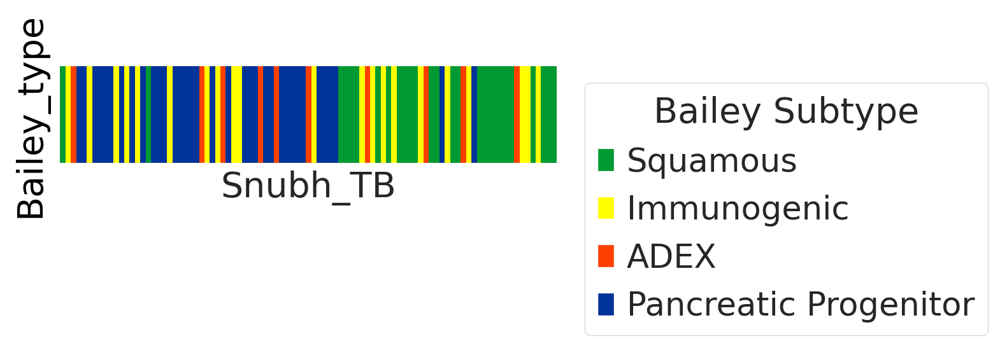

In [905]:
Bailey_map = dict(zip(annotation['BaileyType'].unique(),range(annotation['BaileyType'].nunique())))
Bailey_color = ['#009933','#ffff00','#ff4000', '#003399']
lut2 = dict(zip(annotation['BaileyType'].unique(), Bailey_color))
Bailey_type = annotation['BaileyType'].map(Bailey_map).astype(int).to_frame('Bailey_type').T
ax=sns.heatmap(Bailey_type, cmap=Bailey_color, cbar=False)


handles2 = [mpatches.Patch(facecolor=lut2[name]) for name in lut2]
ax.legend(handles2, lut2, title='Bailey Subtype',
           bbox_to_anchor=(1.9, 1))
ax.set_xticks([])

[]

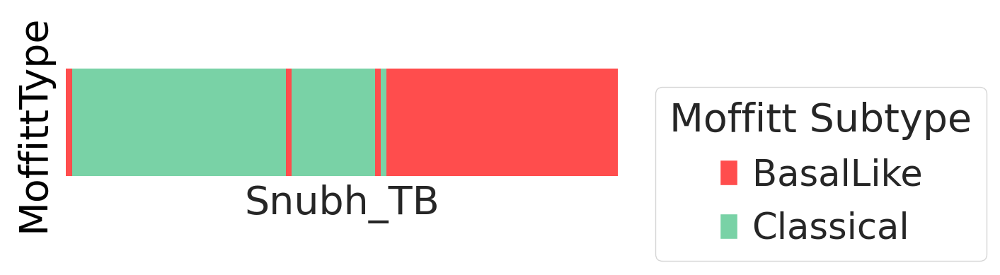

In [906]:
sc.set_figure_params(figsize=(5, 1), dpi=100, fontsize=20)
Moffitt_map = dict(zip(annotation['MoffittType'].unique(),range(annotation['MoffittType'].nunique())))
Moffitt_color = ['#ff4d4d','#79d2a6']
lut3 = dict(zip(annotation['MoffittType'].unique(), Moffitt_color))
Moffitt_type = annotation['MoffittType'].map(Moffitt_map).astype(int).to_frame('MoffittType').T
ax=sns.heatmap(Moffitt_type, cmap=Moffitt_color, cbar=False)


handles3 = [mpatches.Patch(facecolor=lut3[name]) for name in lut3]
ax.legend(handles3, lut3, title='Moffitt Subtype',
           bbox_to_anchor=(1.7, 1))
ax.set_xticks([])

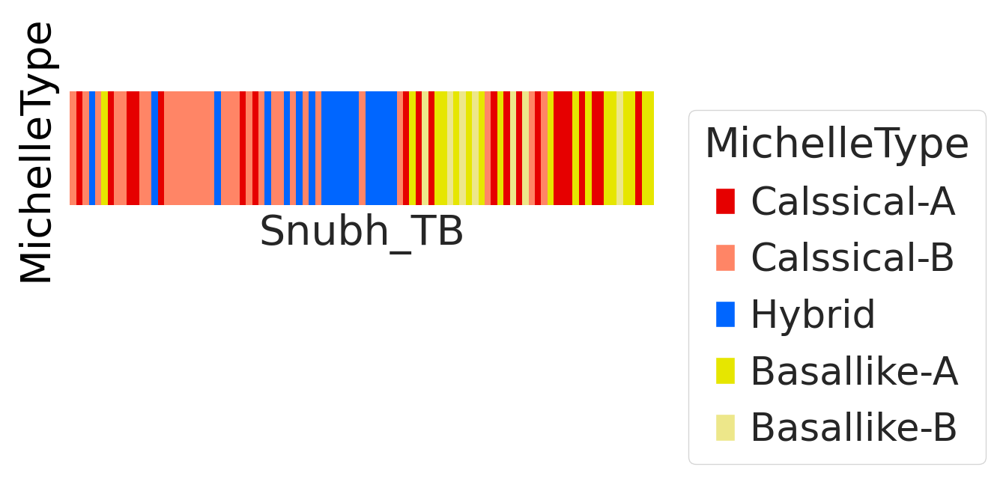

In [907]:
MichelleType_map = dict(zip(annotation['MichelleType'].unique(),range(5)))
MichelleType_map
MichelleType_color = ['#ff8566','#e60000','#0066ff','#e6e600','#ede78a']
lut4 = dict(zip(annotation['MichelleType'].unique(), MichelleType_color))
lut4 = {'Calssical-A': '#e60000',
     'Calssical-B': '#ff8566',
     'Hybrid': '#0066ff',
     'Basallike-A': '#e6e600',
     'Basallike-B': '#ede78a'}

MichelleType = annotation['MichelleType'].map(MichelleType_map).astype(int).to_frame('MichelleType').T
ax=sns.heatmap(MichelleType, cmap=MichelleType_color, cbar=False)


handles4 = [mpatches.Patch(facecolor=lut4[name]) for name in lut4]
ax.legend(handles4, lut4, title='MichelleType',bbox_to_anchor=(1.6, 1))
ax.set_xticks([])
plt.show()

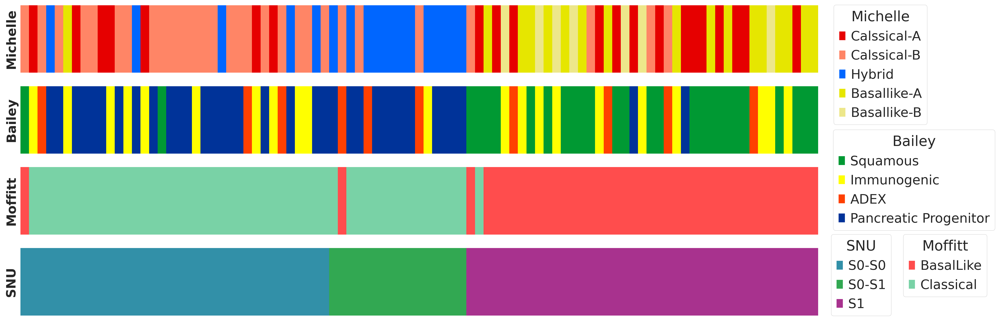

In [908]:
fig = plt.figure(figsize=(20, 8), dpi= 150)
#plt.subplots_adjust(wspace = 0.2, hspace = 0.05)
widths = [1]
heights = [1, 1, 1, 1]
gs = GridSpec(nrows=len(heights), ncols=len(widths), hspace=0.2, wspace=0.01, width_ratios=widths, height_ratios=heights)


ax0 = fig.add_subplot(gs[0, 0])
sns.heatmap(MichelleType, ax=ax0, cmap=MichelleType_color, cbar=False)
ax0.set_ylabel('Michelle', fontsize=18, fontdict=dict(weight='bold'))
ax0.set_xlabel('')
ax0.set_yticks([])
ax0.set_xticks([])
ax0.margins(0)
ax0.legend(handles4, lut4, title='Michelle', bbox_to_anchor=(1.145, 1.1))


ax1 = fig.add_subplot(gs[2, 0])
sns.heatmap(Moffitt_type, ax=ax1, cmap=Moffitt_color, cbar=False)
ax1.set_ylabel('Moffitt', fontsize=18, fontdict=dict(weight='bold'))
ax1.set_xlabel('')
ax1.set_yticks([])
ax1.set_xticks([])
ax1.margins(0)
ax1.legend(handles3, lut3, title='Moffitt', bbox_to_anchor=(1.22, 0.1))


ax2 = fig.add_subplot(gs[1, 0])
sns.heatmap(Bailey_type, ax=ax2, cmap=Bailey_color, cbar=False)
ax2.set_ylabel('Bailey', fontsize=18, fontdict=dict(weight='bold'))
ax2.set_xlabel('')
ax2.set_yticks([])
ax2.set_xticks([])
ax2.margins(0)
ax2.legend(handles2, lut2, title='Bailey', bbox_to_anchor=(1.23, 0.45))


ax3 = fig.add_subplot(gs[3, 0])
sns.heatmap(SNU_type, ax=ax3, cmap=list(final_lut.values()), cbar=False)
ax3.set_ylabel('SNU', fontsize=18, fontdict=dict(weight='bold'))
ax3.set_xlabel('')
ax3.set_yticks([])
ax3.set_xticks([])
ax3.margins(0)
ax3.legend(handles1, final_lut, title='SNU', bbox_to_anchor=(1.1, 1.3))

<AxesSubplot:xlabel='Snubh_TB'>

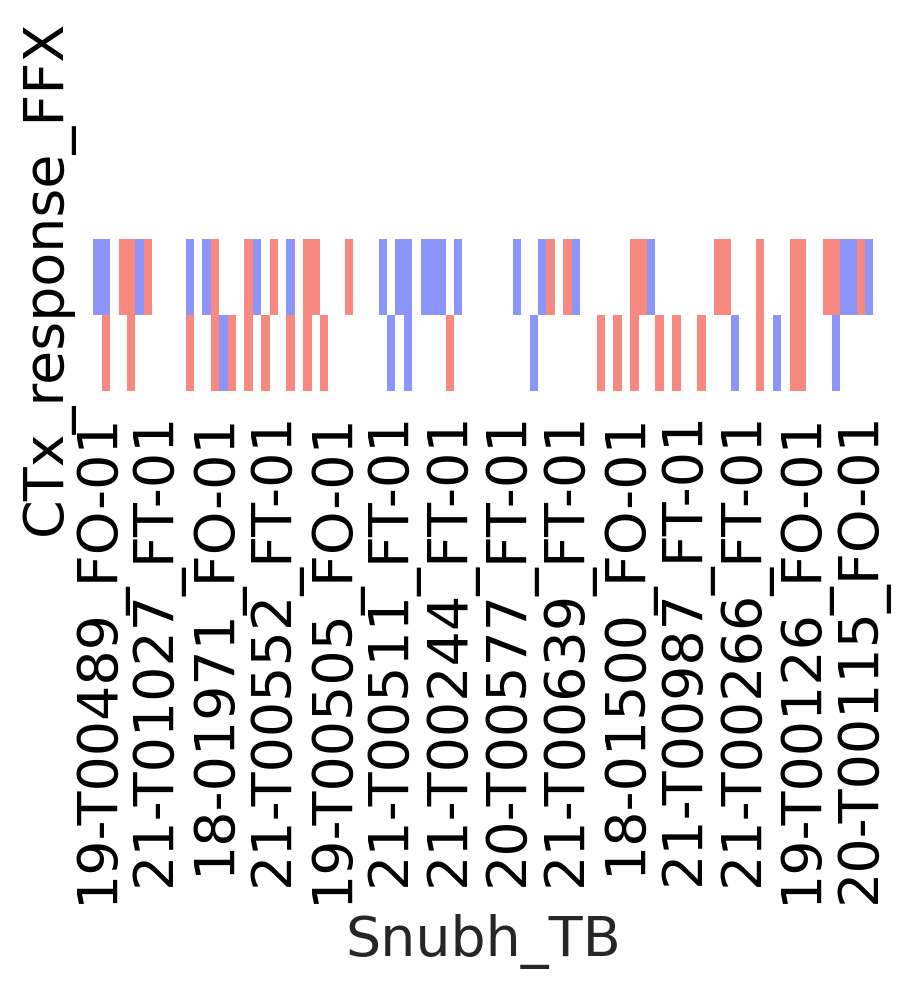

In [919]:
drug_heatmap = annotation.loc[:,['CTx_response_FFX', 'CTx_response_GNP']]
drug_heatmap

D2int = dict()
D2int['non-responder'] = 1
D2int['responder'] = -1
heatmap_color = ['#8c95fa','#f78981']

sns.heatmap(drug_heatmap.replace(D2int).T.astype(float), cmap=heatmap_color, cbar=False)


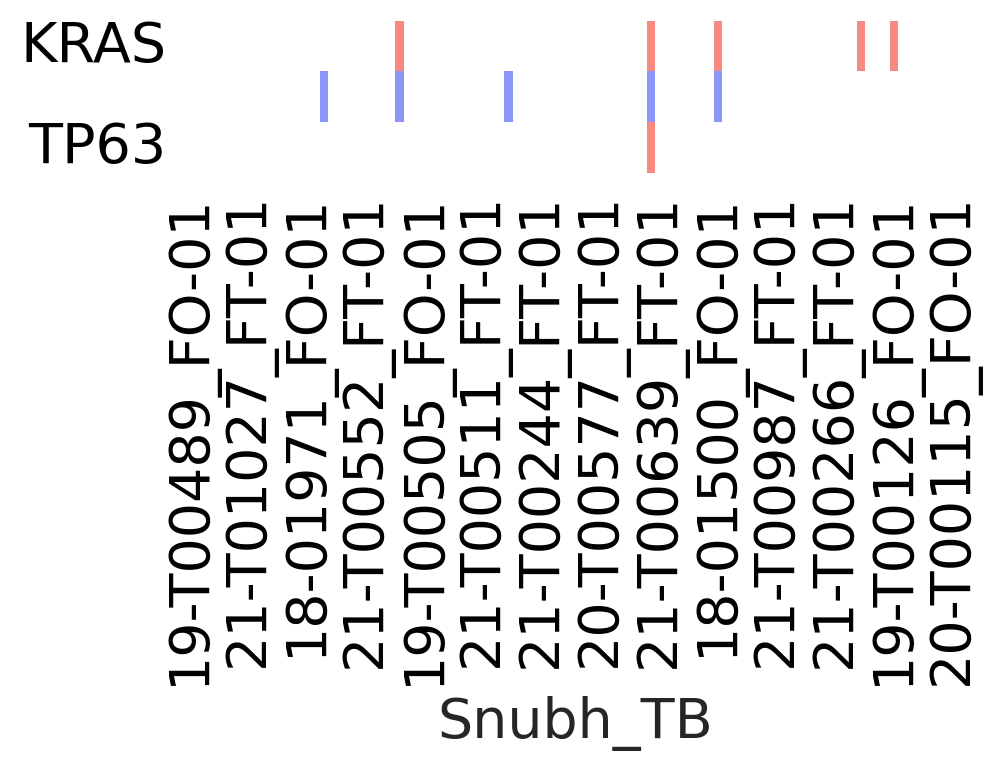

In [910]:
CNV_heatmap = annotation.loc[:,['KRAS','SMAD4','TP63']]
CNV_heatmap

C2int = dict()
C2int['Amp'] = 1
C2int['Neutral'] = 0
C2int['Del'] = -1

heatmap_color = ['#8c95fa', '#FFFFFF', '#f78981']
sns.heatmap(CNV_heatmap.replace(C2int).T, cmap=heatmap_color, cbar=False)

cnv_dict = {}
cnv_dict['Amp'] = '#f78981'
cnv_dict['Del'] = '#8c95fa'